## Setup for Neural Networks Implementations & Inferences

In [1]:
from sklearn.experimental import enable_iterative_imputer
import torch.nn.functional as F
from typing import cast, Union
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import seaborn as sns
import csv
from sklearn.model_selection import train_test_split
import warnings
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.feature_selection import SelectPercentile, mutual_info_classif
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import RobustScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset
from copy import deepcopy
from typing import List
from sklearn.metrics import accuracy_score
from scipy.sparse import csr_matrix

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f'Running code @ {device}')

Running code @ cuda


## Exploratory Data Analysis for MIT-BIH Arrhythmia Database and PTBDB

In [2]:
warnings.filterwarnings("ignore")

def dataSetClassesFrequenciesBarPlot(target):
    labels = {
        0: "Normal",
        1: "Artial Premature",
        2: "Premature ventricular contraction",
        3: "Fusion of ventricular and normal",
        4: "Fusion of paced and normal",
    }

    value_counts = target.value_counts().rename(labels)

    bar_fig = px.bar(
        x=value_counts.index,
        y=value_counts.values,
        labels={"x": "Labels", "y": "Counts"},
        text_auto=True,
        title="The Count of Each Label in The Train Dataset",
    )

    bar_fig.update_layout(title_x=0.5, width=800, height=600)

    bar_fig.show()


def print_class_distribution(num_samples, class_val, set_type):
    print(
        "Number of examples in class '{}' ('{}' Set) : ".format(class_val, set_type)
        + str(num_samples)
    )


def print_and_get_dataset_info(dataset_train_path, dataset_test_path, dataset_name):
    print("{} Dataset".format(dataset_name))

    train_data = pd.read_csv(dataset_train_path, header=None)
    test_data = pd.read_csv(dataset_test_path, header=None)

    _data = pd.concat([train_data, test_data])

    _data.rename(columns={_data.columns[-1]: "Class"}, inplace=True)

    X_train, X_test, y_train, y_test = train_test_split(
        _data.loc[:, _data.columns[:-1]],
        _data.loc[:, _data.columns[-1]],
        random_state=10,
        train_size=0.8,
    )

    _data_classes_count = {}
    _data_classes_count["Train"] = []
    _data_classes_count["Test"] = []

    for elem in range(_data.iloc[:, -1].nunique()):
        _data_classes_count["Train"].append(len(y_train[y_train == elem]))
        _data_classes_count["Test"].append(len(y_test[y_test == elem]))

    print(
        "Classes are "
        + str(["Class: " + str(x) for x in range(_data.iloc[:, -1].nunique())])
        + "\n"
    )

    print("*" * 50)

    for i in range(_data.iloc[:, -1].nunique()):
        print_class_distribution(_data_classes_count["Train"][i], i, "Train")

    print("\n")

    for i in range(_data.iloc[:, -1].nunique()):
        print_class_distribution(_data_classes_count["Test"][i], i, "Test")

    print("*" * 50 + "\n")

    return (
        X_train,
        X_test,
        y_train,
        y_test,
        _data_classes_count,
        train_data,
        test_data,
        _data,
    )


def prepareDataSet(dataSetName):

    dataset_file = dataSetName.lower()

    f_in = open(dataset_file, "r")
    csv_reader = csv.reader(f_in, delimiter=",")

    row = next(csv_reader)

    attributeNames = row[:-1]

    examples = []
    classes = set()

    for row in csv_reader:
        *attributes, label = row

        classes.add(label)

        example = dict(zip(attributeNames, attributes))
        example["CLASS"] = label
        examples.append(example)

    f_in.close()
    return classes, attributeNames, examples

def diff(first, second):
        second = set(second)
        return [item for item in first if item not in second]

def plot_cov_matrix(dataset, lst):
    cov = np.cov(pd.DataFrame([dataset[elem] for elem in lst]), bias=True)
    labs = [elem for elem in lst]
    
    plt.figure(figsize = (21, 12))
    sns.heatmap(cov, annot=True, fmt='g', xticklabels=labs, yticklabels=labs)
    plt.show()
    
def get_parameters(X, y, parameters, model):
    clf = GridSearchCV(model, parameters, n_jobs=-1)
    clf.fit(X, y)
    return clf.best_params_, clf.best_score_

def convert_to_float(value):
    if isinstance(value, str):
        return float(value.replace(",", ""))
    else:
        return float(value)

Classes are ['Class D0', 'Class D1', 'Class D2', 'Class D3', 'Class D4', 'Class D5', 'Class D6']

**************************************************
Number of 'D0' values in Training Set : 132
Number of 'D0' values in Testing Set : 114
**************************************************

**************************************************
Number of 'D1' values in Training Set : 126
Number of 'D1' values in Testing Set : 136
**************************************************

**************************************************
Number of 'D2' values in Training Set : 124
Number of 'D2' values in Testing Set : 134
**************************************************

**************************************************
Number of 'D3' values in Training Set : 132
Number of 'D3' values in Testing Set : 137
**************************************************

**************************************************
Number of 'D4' values in Training Set : 164
Number of 'D4' values in Testing Set : 156
****

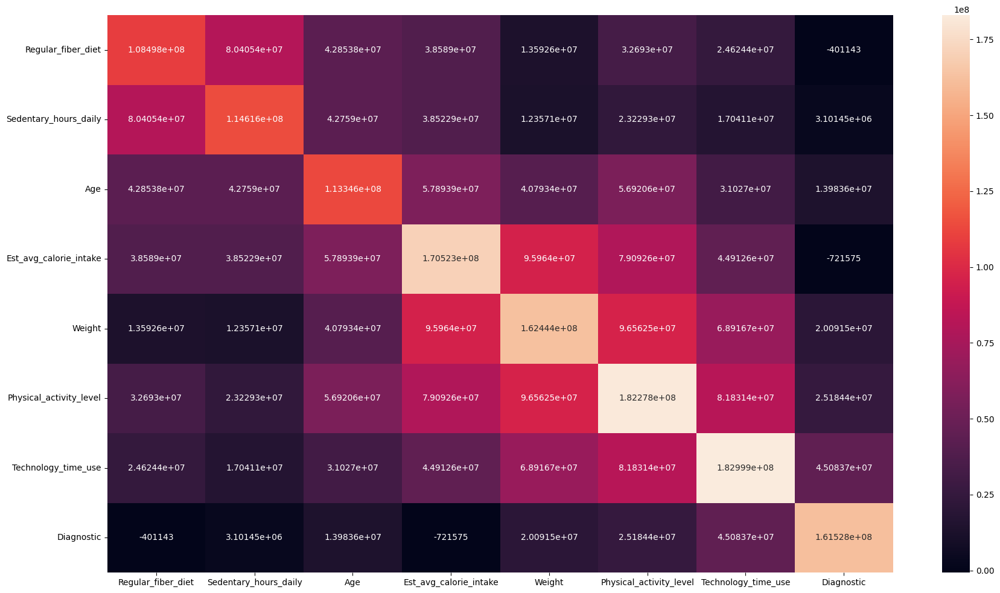

In [3]:
data = pd.read_csv("date_tema_1_iaut_2024.csv")

classes, attributes, examples = prepareDataSet("date_tema_1_iaut_2024.csv")

classes = sorted(list(classes))

categorical_attributes = [
    ("Diagnostic", 18),
    ("Gender", 17),
    ("Technology_time_use", 16),
    ("Calorie_monitoring", 15),
    ("Smoker", 14),
    ("Snacks", 13),
    ("Alcohol", 12),
    ("High_calorie_diet", 11),
    ("Diagnostic_in_family_history", 10),
    ("Transportation", 9),
]

attrs = attributes.copy()

for elem in categorical_attributes:
    if elem[0] in [
        "Gender",
        "Calorie_monitoring",
        "Smoker",
        "Snacks",
        "Alcohol",
        "High_calorie_diet",
        "Diagnostic_in_family_history",
        "Transportation",
    ]:
        attrs.pop(attrs.index(elem[0]))

numerical_attributes = attrs

for elem in numerical_attributes:
    data[elem] = data[elem].apply(convert_to_float)

X = data.loc[:, data.columns[:-1]]
y = data.loc[:, ["Diagnostic"]]

train_count = []
test_count = []

classes_values = {}
for elem in range(len(classes)):
    classes_values[classes[elem]] = {}
    classes_values[classes[elem]]["train"] = []
    classes_values[classes[elem]]["test"] = []

for step in range(10, 100, 10):
    _, _, T_train, T_test = train_test_split(
        X, y, random_state=10, train_size=step / 100
    )
    train_count.append(T_train.value_counts())
    test_count.append(T_test.value_counts())

    for elem in range(len(classes)):
        classes_values[classes[elem]]["train"].append(train_count[-1][classes[elem]])
        classes_values[classes[elem]]["test"].append(test_count[-1][classes[elem]])

data["Diagnostic"] = LabelEncoder().fit_transform(data["Diagnostic"])

ml_dic_div = {}

print("Classes are " + str(["Class D" + str(x) for x in range(len(classes))]) + "\n")

for i in range(len(classes)):

    print("*" * 50)

    print(
        "Number of '{}' values in Training Set : ".format(classes[i])
        + str(
            round(
                sum(classes_values[classes[i]]["train"])
                / len(classes_values[classes[i]]["train"])
            )
        )
    )

    print(
        "Number of '{}' values in Testing Set : ".format(classes[i])
        + str(
            round(
                sum(classes_values[classes[i]]["test"])
                / len(classes_values[classes[i]]["test"])
            )
        )
    )
    print("*" * 50 + "\n")


imp = IterativeImputer(
    missing_values=-1,
    sample_posterior=True,
    max_iter=int(1e10),
    random_state=0,
    tol=1e-10,
    imputation_order="random",
)

data["Weight"] = pd.DataFrame(imp.fit_transform(pd.DataFrame(data["Weight"])))

num_lines = data.shape[0]

scaler = RobustScaler(with_centering=False)

encoder = OneHotEncoder()

selector = SelectPercentile(score_func=mutual_info_classif, percentile=35)

X = data.loc[:, data.columns[:-1]]

y = data.loc[:, ["Diagnostic"]]

X = encoder.fit_transform(X, y)

X = scaler.fit_transform(X, y)

X = selector.fit_transform(X, y)

mask_attr = selector.get_support(indices=False)

rem_features = [
    selected_feature[0]
    for selected_feature in zip(attributes, mask_attr)
    if selected_feature[1] == False
]

attr_lst = diff(numerical_attributes + ["Diagnostic"], rem_features)

num_col = len(attr_lst)

print("\nRemoved features:\n" + str(rem_features))

X_train, X_test, y_train, y_test = train_test_split(
        X, y, random_state=elem * 10, train_size=0.8
    )

ml_dic_div["T"] = {}
ml_dic_div["X"] = {}
ml_dic_div["X"]["train"] = X_train
ml_dic_div["T"]["train"] = y_train
ml_dic_div["X"]["test"] = X_test
ml_dic_div["T"]["test"] = y_test

plot_cov_matrix(
    pd.DataFrame(
        scaler.fit_transform([data[elem] for elem in attr_lst], y).reshape(
            num_lines, num_col
        ),
        columns=attr_lst,
    ),
    attr_lst,
)

In [4]:
X_mitbih_train, X_mitbih_test, y_mitbih_train, y_mitbih_test, mitbih_data_classes_count, mitbih_train_data, mitbih_test_data, mitbih_data = \
    print_and_get_dataset_info("mitbih_train.csv", "mitbih_test.csv", "MIT-BIH Arrhythmia")


X_ptbdb_train, X_ptbdb_test, y_ptbdb_train, y_ptbdb_test, ptbdb_data_classes_count, ptbdb_abnormal_data, ptbdb_normal_data, ptbdb_data = \
    print_and_get_dataset_info("ptbdb_abnormal.csv", "ptbdb_normal.csv", "PTBDB")

MIT-BIH Arrhythmia Dataset
Classes are ['Class: 0', 'Class: 1', 'Class: 2', 'Class: 3', 'Class: 4']

**************************************************
Number of examples in class '0' ('Train' Set) : 72490
Number of examples in class '1' ('Train' Set) : 2258
Number of examples in class '2' ('Train' Set) : 5755
Number of examples in class '3' ('Train' Set) : 633
Number of examples in class '4' ('Train' Set) : 6420


Number of examples in class '0' ('Test' Set) : 18099
Number of examples in class '1' ('Test' Set) : 521
Number of examples in class '2' ('Test' Set) : 1481
Number of examples in class '3' ('Test' Set) : 170
Number of examples in class '4' ('Test' Set) : 1619
**************************************************

PTBDB Dataset
Classes are ['Class: 0', 'Class: 1']

**************************************************
Number of examples in class '0' ('Train' Set) : 3227
Number of examples in class '1' ('Train' Set) : 8414


Number of examples in class '0' ('Test' Set) : 819
Number o

In [6]:
print("Frequencies for Training Set (MIT-BIH)")
dataSetClassesFrequenciesBarPlot(y_mitbih_train)

Frequencies for Training Set (MIT-BIH)


In [7]:
print("Frequencies for Test Set (MIT-BIH)")
dataSetClassesFrequenciesBarPlot(y_mitbih_test)

Frequencies for Test Set (MIT-BIH)


In [8]:
print("Frequencies for Train Set (PTBDB)")
dataSetClassesFrequenciesBarPlot(y_ptbdb_test)

Frequencies for Train Set (PTBDB)


In [9]:
print("Frequencies for Test Set (PTBDB)")
dataSetClassesFrequenciesBarPlot(y_ptbdb_test)

Frequencies for Test Set (PTBDB)


In [10]:
mitbih_data.describe()

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,Class
count,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,...,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000,109446.000000
mean,0.891170,0.758909,0.424503,0.219602,0.201237,0.210298,0.205607,0.201617,0.198480,0.196610,...,0.004937,0.004568,0.004237,0.003914,0.003673,0.003469,0.003210,0.002956,0.002835,0.473439
std,0.239657,0.221190,0.227561,0.207248,0.177191,0.171965,0.178374,0.177020,0.171469,0.168028,...,0.043951,0.042109,0.040471,0.038801,0.037465,0.036552,0.035015,0.033413,0.032620,1.143232
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.922252,0.682648,0.251014,0.048853,0.082418,0.088300,0.073171,0.066093,0.064893,0.068615,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.991202,0.826560,0.430174,0.166355,0.147842,0.158640,0.145078,0.144465,0.150073,0.148849,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,0.910868,0.579832,0.342707,0.259045,0.287500,0.298343,0.295235,0.290623,0.283465,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000


In [11]:
mitbih_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 109446 entries, 0 to 21891
Columns: 188 entries, 0 to Class
dtypes: float64(188)
memory usage: 157.8 MB


In [12]:
ptbdb_data.describe()

,0,1,2,3,4,5,6,7,8,9,...,178,179,180,181,182,183,184,185,186,Class
count,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,...,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.000000,14552.0,14552.000000
mean,0.976637,0.721663,0.403099,0.242893,0.207218,0.216453,0.221752,0.224486,0.227349,0.229704,...,0.001190,0.001133,0.000900,0.000739,0.000661,0.000475,0.000177,0.000185,0.0,0.721963
std,0.034532,0.195690,0.249794,0.249519,0.218097,0.192412,0.180740,0.176943,0.176674,0.176579,...,0.021361,0.021012,0.017316,0.014640,0.014033,0.012289,0.006545,0.006835,0.0,0.448047
min,0.624227,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
25%,0.959377,0.584589,0.212300,0.052269,0.061875,0.090487,0.096503,0.097095,0.097231,0.097144,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000
50%,1.000000,0.740148,0.371911,0.168148,0.136082,0.159451,0.167479,0.171541,0.177380,0.180337,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000
75%,1.000000,0.881483,0.557785,0.336232,0.264104,0.264633,0.286484,0.302255,0.311664,0.325292,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.985523,0.993213,0.997738,...,0.791899,0.773743,0.789804,0.628177,0.602033,0.644880,0.371502,0.376668,0.0,1.000000


In [13]:
ptbdb_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14552 entries, 0 to 4045
Columns: 188 entries, 0 to Class
dtypes: float64(188)
memory usage: 21.0 MB


Example from Normal Class (PTBDB)


<Axes: title={'center': 'ECG of First Person'}>

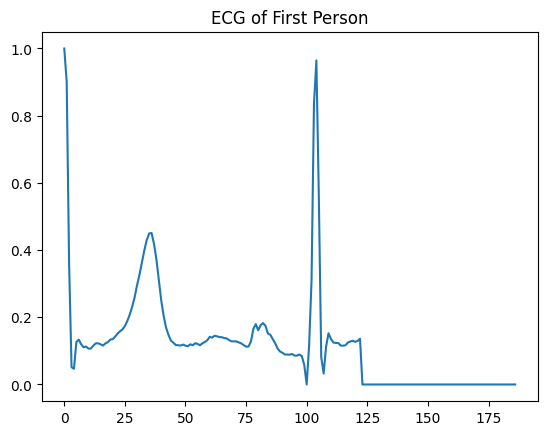

In [14]:
print("Example from Normal Class (PTBDB)")
ptbdb_normal_data.iloc[0, :187].plot(title='ECG of First Person')

Example from Artial Premature Class (PTBDB)


<Axes: title={'center': 'ECG of First Person'}>

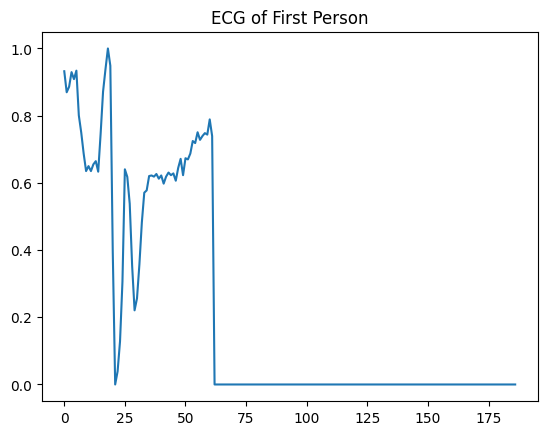

In [15]:
print("Example from Artial Premature Class (PTBDB)")
ptbdb_abnormal_data.iloc[0, :187].plot(title='ECG of First Person')

In [16]:
n = random_index = np.random.randint(100)

ecg_0 = ptbdb_normal_data.loc[ptbdb_normal_data[187] == 0, :].iloc[n, :187]
ecg_1 = ptbdb_abnormal_data.loc[ptbdb_abnormal_data[187] == 1, :].iloc[n, :187]

ecg_df = pd.DataFrame(
    {
        "Normal": ecg_0,
        "Artial Premature": ecg_1,
    }
)

ecg_plot = px.line(
    ecg_df,
    labels={
        "index": "Time Intervals",
        "value": "Amplitude (mV)",
        "variable": "Categories",
    },
    title="One ECG form Each Category (PTBDB)",
)
ecg_plot.update_layout(title_x=0.25, width=1000, height=500)
ecg_plot.show()

In [17]:
n = random_index = np.random.randint(100)

ecg_df = pd.DataFrame(
    {
        "Normal": mitbih_train_data.loc[mitbih_train_data[187] == 0, :].iloc[n, :187],
        "Artial Premature": mitbih_train_data.loc[mitbih_train_data[187] == 1, :].iloc[n, :187],
        "Premature ventricular contraction": mitbih_train_data.loc[mitbih_train_data[187] == 2, :].iloc[n, :187],
        "Fusion of ventricular and normal": mitbih_train_data.loc[mitbih_train_data[187] == 3, :].iloc[n, :187],
        "Fusion of paced and normal": mitbih_train_data.loc[mitbih_train_data[187] == 4, :].iloc[n, :187],
    }
)

ecg_plot = px.line(
    ecg_df,
    labels={
        "index": "Time Intervals",
        "value": "Amplitude (mV)",
        "variable": "Categories",
    },
    title="One ECG form Each Category (MIT-BIH)",
)
ecg_plot.update_layout(title_x=0.25, width=1000, height=500)
ecg_plot.show()

In [23]:
def plot_mean_std_per_class(data, title):

    class_column = data.columns[-1]

    mean_std_per_class = data.groupby(class_column).agg(["mean", "std"])

    means = mean_std_per_class.xs('mean', axis=1, level=1)
    stds = mean_std_per_class.xs('std', axis=1, level=1)

    fig, ax = plt.subplots(1, 2, figsize=(20, 10))

    means.transpose().plot(ax=ax[0], title="Mean per Time Interval for Each Class ({})".format(title))
    
    stds.transpose().plot(ax=ax[1], title="Standard Deviation per Time Interval for Each Class ({})".format(title))
    
    plt.show()

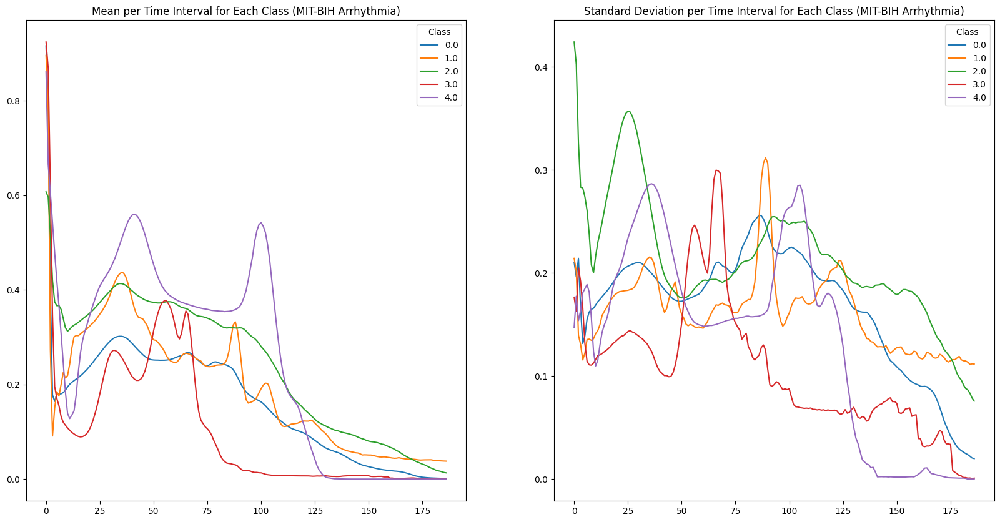

In [24]:
plot_mean_std_per_class(mitbih_data, "MIT-BIH Arrhythmia")

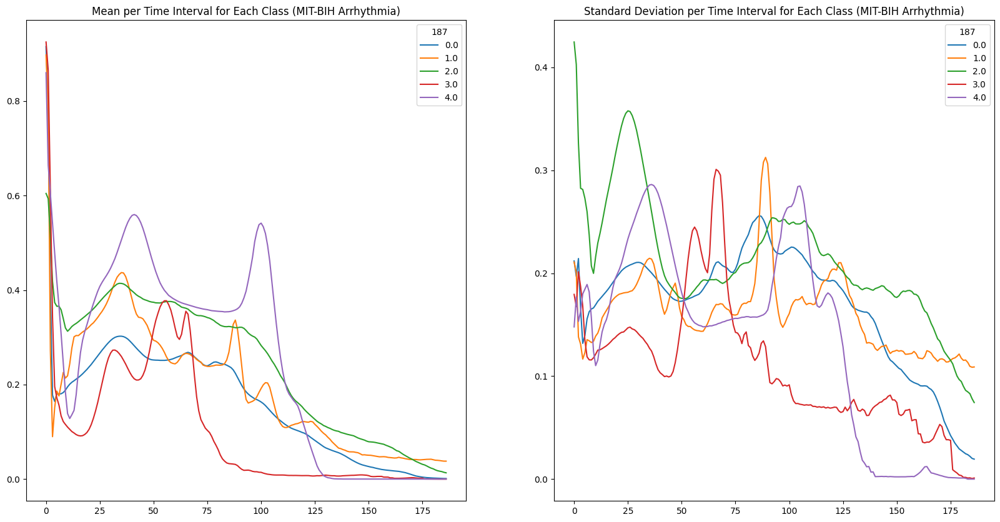

In [19]:
plot_mean_std_per_class(mitbih_train_data, "MIT-BIH Arrhythmia")

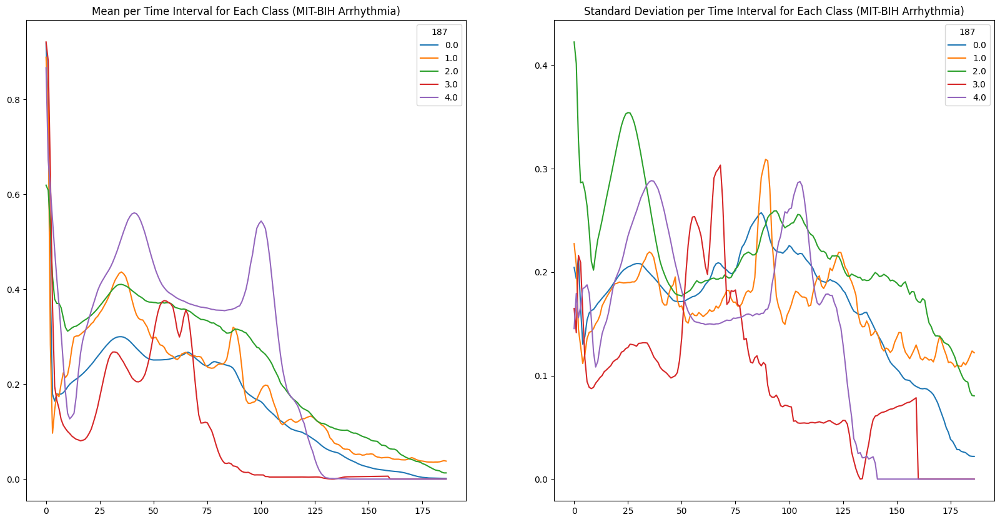

In [20]:
plot_mean_std_per_class(mitbih_test_data, "MIT-BIH Arrhythmia")

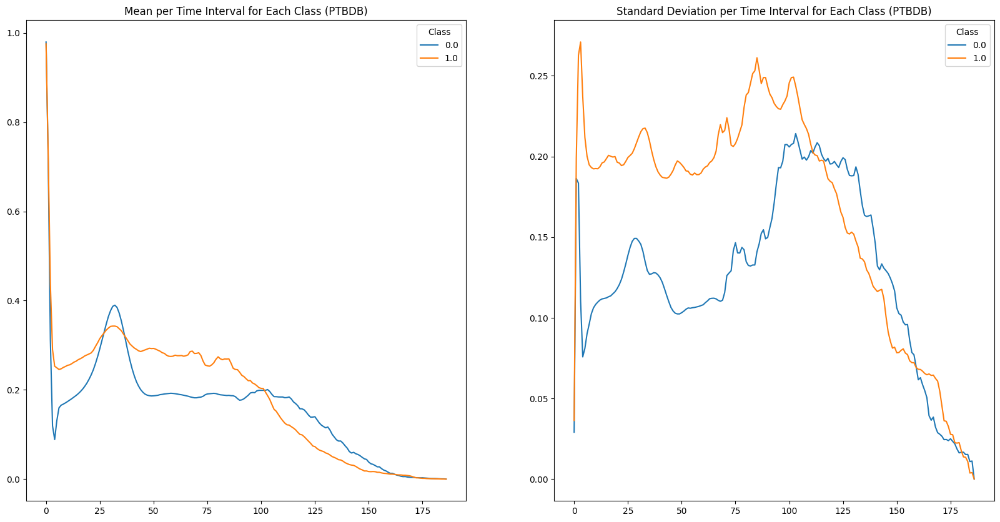

In [25]:
plot_mean_std_per_class(ptbdb_data, "PTBDB")

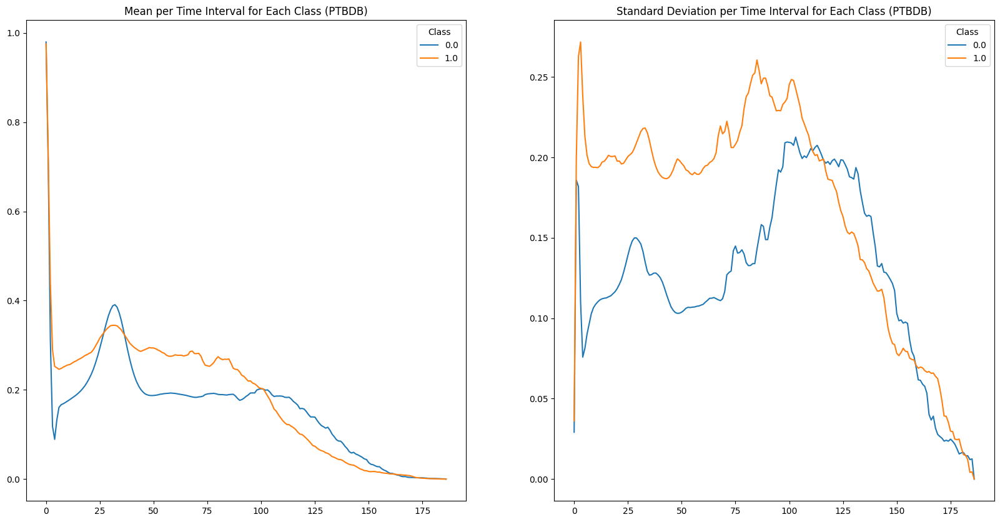

In [21]:
plot_mean_std_per_class(pd.concat([X_ptbdb_train, y_ptbdb_train], axis=1), "PTBDB")

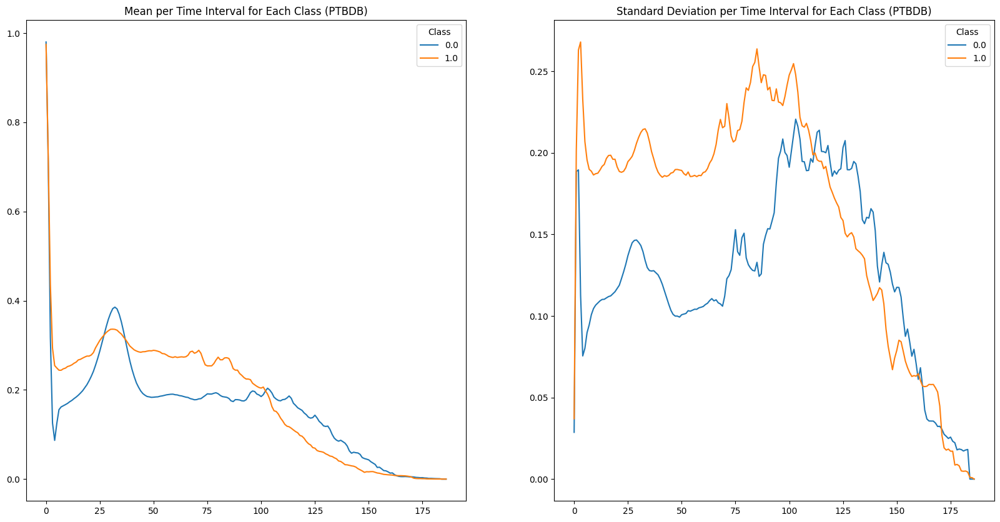

In [22]:
plot_mean_std_per_class(pd.concat([X_ptbdb_test, y_ptbdb_test], axis=1), "PTBDB")

## MLP Implementation & Training & Testing

In [5]:
BATCH_SIZE = [500, 1000, 2000]
EPOCHS_NO = [50, 100, 150, 200]

In [6]:
class ComplexPyTorchMLP(nn.Module):
     def __init__(self, input_size, hidden_size, activation=nn.ReLU, num_classes=2):
        super(ComplexPyTorchMLP, self).__init__()

        self.fc1 = nn.Linear(input_size, hidden_size)
        self.activation1 = nn.ReLU()

        self.fc2 = nn.Linear(hidden_size, 32)
        self.activation2 = nn.ReLU()

        self.fc3 = nn.Linear(32, num_classes)
        self.activation3 = activation

     def forward(self, x):
        x = torch.flatten(x, 1)

        x = self.fc1(x)
        x = self.activation1(x)

        x = self.fc2(x)
        x = self.activation2(x)

        x = self.fc3(x)
        x = self.activation3(x)

        return x

class SimplePytorchMLP(nn.Module):
    def __init__(self, input_size, hidden_size, activation=nn.ReLU, num_classes=2):
        super(SimplePytorchMLP, self).__init__()
        
        self.fc1 = nn.Linear(input_size, hidden_size)
        self.activation1 = nn.ReLU()

        self.fc2 = nn.Linear(hidden_size, num_classes)
        self.activation2 = activation

    def forward(self, x):
        x = torch.flatten(x, 1)
        
        x = self.fc1(x)
        x = self.activation1(x)
        
        x = self.fc2(x)
        x = self.activation2(x)
        
        return x

In [7]:
class Layer:
    def forward(self, x: np.ndarray) -> np.ndarray:
        raise NotImplementedError

    def backward(self, x: np.ndarray, dy: np.ndarray) -> np.ndarray:
        raise NotImplementedError

    def update(self, *args, **kwargs):
        pass

class FeedForwardNetwork:
    def __init__(self, layers: List[Layer]):
        self.layers = layers

    def forward(self, x: np.ndarray, train: bool = True) -> np.ndarray:
        self._inputs = []
        for layer in self.layers:
            if train:
                self._inputs.append(x)
            x = layer.forward(x)
        return x

    def backward(self, dy: np.ndarray) -> np.ndarray:
        dx = dy
        for i in reversed(range(len(self.layers))):
            dx = self.layers[i].backward(self._inputs[i], dx)
        del self._inputs
        return dx

    def update(self, *args, **kwargs):
        for layer in self.layers:
            layer.update(*args, **kwargs)

class Linear(Layer):
    def __init__(self, insize: int, outsize: int) -> None:
        bound = np.sqrt(6.0 / insize)
        self.weight = np.random.uniform(-bound, bound, (insize, outsize))
        self.bias = np.zeros((outsize,))
        self.dweight = np.zeros_like(self.weight)
        self.dbias = np.zeros_like(self.bias)
        self.wv = 0
        self.bv = 0

    def forward(self, x: np.ndarray) -> np.ndarray:
        return x @ self.weight + self.bias

    def backward(self, x: np.ndarray, dy: np.ndarray) -> np.ndarray:
        self.dweight = x.T @ dy
        self.dbias = np.sum(dy, axis=0)
        return dy @ self.weight.T

    def update(self, mode="SGD", lr=0.001, mu=0.9):
        if mode == "SGD":
            self.weight -= lr * self.dweight
            self.bias -= lr * self.dbias
        elif mode == "momentum":
            self.wv = mu * self.wv + lr * self.dweight
            self.weight -= self.wv
            self.bv = mu * self.bv + lr * self.dbias
            self.bias -= self.bv
        else:
            raise ValueError("mode should be SGD or momentum, not " + str(mode))

class ReLU(Layer):
    def forward(self, x: np.ndarray) -> np.ndarray:
        return np.maximum(x, 0)

    def backward(self, x: np.ndarray, dy: np.ndarray) -> np.ndarray:
        dx = deepcopy(dy)
        dx[x <= 0] = 0
        return dx

class CrossEntropy:
    def __init__(self):
        pass

    def _softmax(self, y, t):
        e_t = np.exp([y[i][t[i]] for i in range(len(t))])
        return e_t / np.exp(y).sum(axis=1)

    def forward(self, y: np.ndarray, t: np.ndarray) -> float:
        return -np.mean(np.log(self._softmax(y, t)))

    def backward(self, y: np.ndarray, t: np.ndarray) -> np.ndarray:
        diff = [[yj == y[i][t[i]] for yj in y[i]] for i in range(y.shape[0])]
        return [
            [
                (np.exp(y[i][j]) / np.sum(np.exp(y[i])) - diff[i][j]) / y.shape[0]
                for j in range(len(y[i]))
            ]
            for i in range(len(y))
        ]
        
def plot_loss_curves(train_losses, test_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(train_losses, label='Training Loss')
    plt.plot(test_losses, label='Testing Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curves')
    plt.legend()
    plt.show()

def accuracy(y: np.ndarray, t: np.ndarray) -> float:
    return accuracy_score(t, np.argmax(y, axis=1))

In [8]:
def train_test_PyTorch_MLP(model, loss_fn, optimizer, X_train, T_train, X_test, T_test,
                        train_losses, test_losses, EPOCHS_NO = [150], BATCH_SIZE = [100], num_classes = 2):
    T_train = T_train.values.ravel()
    T_test = T_test.values.ravel()

    X_train_tensor = torch.tensor(X_train.toarray(), dtype=torch.float32).to(device)
    T_train_tensor = torch.tensor(T_train, dtype=torch.long).to(device)
    X_test_tensor = torch.tensor(X_test.toarray(), dtype=torch.float32).to(device)
    T_test_tensor = torch.tensor(T_test, dtype=torch.long).to(device)

    train_dataset = TensorDataset(X_train_tensor, T_train_tensor)
    test_dataset = TensorDataset(X_test_tensor, T_test_tensor)

    lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=10, T_mult=2, eta_min=0.01, last_epoch=-1)

    for epoch_elem in EPOCHS_NO:
        for batch_elem in BATCH_SIZE:
            print(f"EPOCH : {epoch_elem} & BATCH SIZE : {batch_elem}\n")

            train_loader = DataLoader(train_dataset, batch_size=batch_elem, shuffle=True)
            test_loader = DataLoader(test_dataset, batch_size=batch_elem, shuffle=False)

            for epoch in range(epoch_elem):
                model.train()
                epoch_train_loss = 0
                correct_train_predictions = 0
                total_train_samples = 0

                for X_batch, T_batch in train_loader:
                    optimizer.zero_grad()
                    outputs = model(X_batch)
                    loss = loss_fn(outputs, T_batch)
                    loss.backward()
                    optimizer.step()

                    epoch_train_loss += loss.item()

                    preds = torch.argmax(outputs, dim=1)
                    correct_train_predictions += (preds == T_batch).sum().item()
                    total_train_samples += T_batch.size(0)

                train_accuracy = correct_train_predictions / total_train_samples
                train_losses.append(epoch_train_loss / len(train_loader))

                model.eval()
                with torch.no_grad():
                    test_loss = 0
                    correct_test_predictions = 0
                    total_test_samples = 0
                    all_preds = []
                    all_labels = []

                    for X_batch, T_batch in test_loader:
                        outputs = model(X_batch)
                        loss = loss_fn(outputs, T_batch)
                        test_loss += loss.item()

                        preds = torch.argmax(outputs, dim=1)
                        correct_test_predictions += (preds == T_batch).sum().item()
                        total_test_samples += T_batch.size(0)

                        all_preds.append(preds.cpu().numpy())
                        all_labels.append(T_batch.cpu().numpy())

                    test_accuracy = correct_test_predictions / total_test_samples
                    test_losses.append(test_loss / len(test_loader))

                    all_preds = np.concatenate(all_preds)
                    all_labels = np.concatenate(all_labels)

                    print(f'Epoch {epoch + 1:02d} '
                        f'| Train NLL: {train_losses[-1]:.3f} '
                        f'| Train Acc: {train_accuracy * 100:.2f}% '
                        f'| Test NLL: {test_losses[-1]:.3f} '
                        f'| Test Acc: {test_accuracy * 100:.2f}%')

                lr_scheduler.step()

            print(classification_report(all_labels, all_preds))

            cm = confusion_matrix(all_labels, all_preds, labels=np.arange(num_classes))
            disp = ConfusionMatrixDisplay(confusion_matrix=cm)
            disp.plot()
            plt.show()

            plot_loss_curves(train_losses, test_losses)

            train_losses.clear()
            test_losses.clear()

            print("*" * 50 + "\n")


In [9]:
def train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, 
                            train_losses, test_losses, EPOCHS_NO = [150], BATCH_SIZE = [100], num_classes = 2):
    T_train = T_train.values.ravel().astype(int)
    T_test = T_test.values.ravel().astype(int)

    for epoch_elem in EPOCHS_NO:
        for batch_elem in BATCH_SIZE:
            print("EPOCH : {} & BATCH SIZE : {}\n".format(epoch_elem, batch_elem))
            for epoch in range(epoch_elem):
                epoch_train_loss = 0
                for b_no, idx in enumerate(range(0, X_train.shape[0], batch_elem)):

                    if num_classes == 7:
                        x = X_train[idx:idx + batch_elem,:].reshape(-1, X_train.shape[1])
                    else:
                        x = X_train[idx:idx + batch_elem, :].toarray()

                    t = T_train[idx:idx + batch_elem]

                    y = net.forward(x, True)
                    loss = cost_function.forward(y, t)
                    dy = cost_function.backward(y, t)
                    dx = net.backward(dy)
        
                    epoch_train_loss += loss

                    net.update(**optimize_args)

                    print(f'\rEpoch {epoch + 1:02d} '
                        f'| Batch {b_no:03d} '
                        f'| Train NLL: {loss:6.3f} '
                        f'| Train Acc: {accuracy(y, t) * 100:6.2f}% ', end='')

                train_losses.append(epoch_train_loss / (X_train.shape[0] // batch_elem))

                y = net.forward(X_test.reshape(-1, X_test.shape[1]), train=False)
                y = net.forward(X_test.toarray(), train=False)

                test_nll = cost_function.forward(y, T_test)
                test_losses.append(test_nll)

                print(f'| Test NLL: {test_nll:6.3f} '
                    f'| Test Acc: {accuracy(y, T_test) * 100:3.2f}%')

            y_pred = np.argmax(y, axis=1)
            print("\n")
            print(classification_report(T_test, y_pred))

            plot_loss_curves(train_losses, test_losses)

            cm = confusion_matrix(T_test, y_pred, labels=np.arange(num_classes))
            disp = ConfusionMatrixDisplay(confusion_matrix=cm)
            disp.plot()
            plt.show()

            train_losses = []
            test_losses = []

            print("*" * 50 + "\n")


EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.970 | Train Acc:  11.11% | Test NLL:  1.942 | Test Acc: 14.55%
Epoch 02 | Batch 003 | Train NLL:  1.963 | Train Acc:  13.89% | Test NLL:  1.939 | Test Acc: 16.10%
Epoch 03 | Batch 003 | Train NLL:  1.957 | Train Acc:  13.89% | Test NLL:  1.936 | Test Acc: 17.14%
Epoch 04 | Batch 003 | Train NLL:  1.950 | Train Acc:  16.67% | Test NLL:  1.934 | Test Acc: 18.70%
Epoch 05 | Batch 003 | Train NLL:  1.944 | Train Acc:  22.22% | Test NLL:  1.931 | Test Acc: 20.78%
Epoch 06 | Batch 003 | Train NLL:  1.938 | Train Acc:  22.22% | Test NLL:  1.928 | Test Acc: 21.30%
Epoch 07 | Batch 003 | Train NLL:  1.931 | Train Acc:  30.56% | Test NLL:  1.925 | Test Acc: 23.12%
Epoch 08 | Batch 003 | Train NLL:  1.925 | Train Acc:  33.33% | Test NLL:  1.922 | Test Acc: 24.94%
Epoch 09 | Batch 003 | Train NLL:  1.919 | Train Acc:  33.33% | Test NLL:  1.919 | Test Acc: 25.71%
Epoch 10 | Batch 003 | Train NLL:  1.914 | Train Acc:  33.33% | Test 

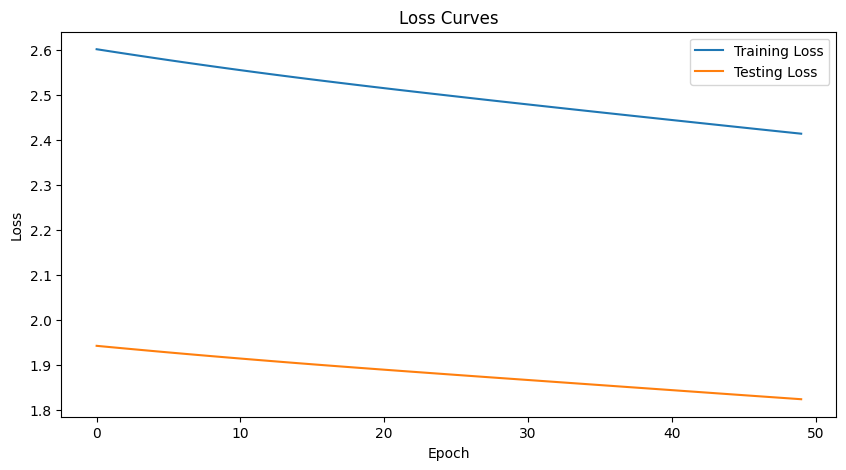

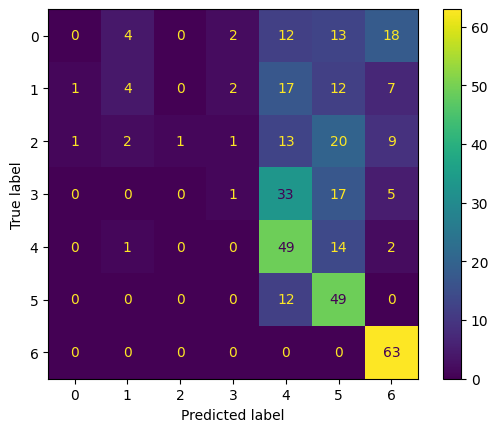

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.834 | Train Acc:  38.99% | Test NLL:  1.822 | Test Acc: 43.38%
Epoch 02 | Batch 001 | Train NLL:  1.833 | Train Acc:  39.18% | Test NLL:  1.821 | Test Acc: 43.38%
Epoch 03 | Batch 001 | Train NLL:  1.832 | Train Acc:  39.18% | Test NLL:  1.820 | Test Acc: 43.38%
Epoch 04 | Batch 001 | Train NLL:  1.831 | Train Acc:  39.18% | Test NLL:  1.819 | Test Acc: 42.86%
Epoch 05 | Batch 001 | Train NLL:  1.830 | Train Acc:  39.18% | Test NLL:  1.818 | Test Acc: 42.86%
Epoch 06 | Batch 001 | Train NLL:  1.829 | Train Acc:  39.37% | Test NLL:  1.817 | Test Acc: 42.86%
Epoch 07 | Batch 001 | Train NLL:  1.828 | Train Acc:  39.37% | Test NLL:  1.816 | Test Acc: 43.12%
Epoch 08 | Batch 001 | Train NLL:  1.827 | Train Acc:  39.55% | Test NLL:  1.815 | Test Acc: 42.86%
Epoch 09 | Batch 001 | Train NLL:  1.826 | Train Acc:  39.55% | Test NLL:  1.814 | Test Acc: 42.60%
Epoch 10 | Batch

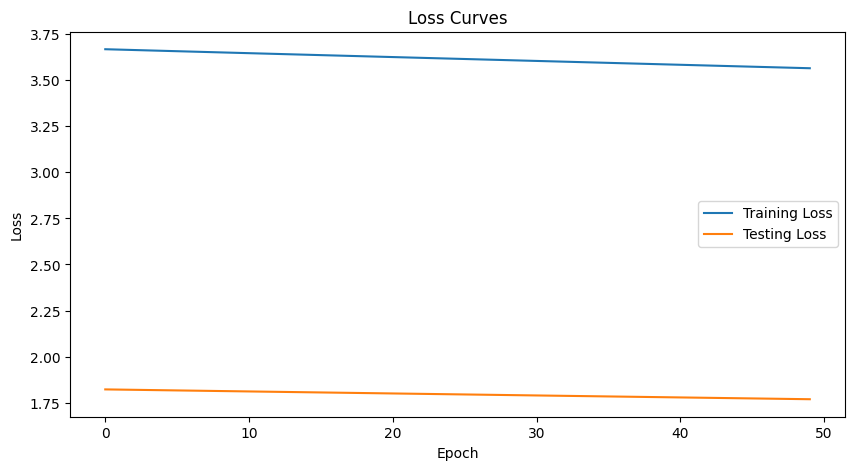

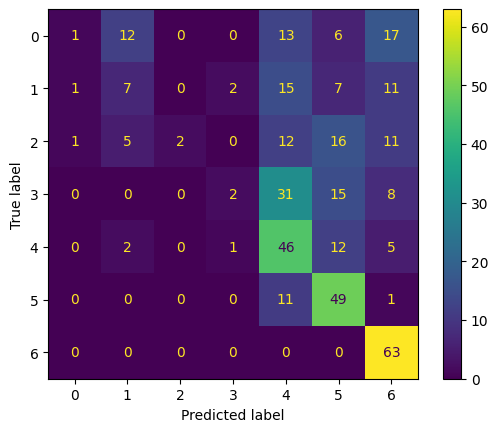

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.781 | Train Acc:  41.54% | Test NLL:  1.769 | Test Acc: 44.42%
Epoch 02 | Batch 000 | Train NLL:  1.780 | Train Acc:  41.54% | Test NLL:  1.768 | Test Acc: 44.42%
Epoch 03 | Batch 000 | Train NLL:  1.780 | Train Acc:  41.54% | Test NLL:  1.768 | Test Acc: 44.42%
Epoch 04 | Batch 000 | Train NLL:  1.779 | Train Acc:  41.67% | Test NLL:  1.767 | Test Acc: 44.42%
Epoch 05 | Batch 000 | Train NLL:  1.779 | Train Acc:  41.67% | Test NLL:  1.766 | Test Acc: 44.68%
Epoch 06 | Batch 000 | Train NLL:  1.778 | Train Acc:  41.67% | Test NLL:  1.766 | Test Acc: 44.68%
Epoch 07 | Batch 000 | Train NLL:  1.778 | Train Acc:  41.80% | Test NLL:  1.765 | Test Acc: 44.68%
Epoch 08 | Batch 000 | Train NLL:  1.777 | Train Acc:  41.80% | Test NLL:  1.765 | Test Acc: 44.94%
Epoch 09 | Batch 000 | Train NLL:  1.777 | Train Acc:  41.73% | Test NLL:  1.764 | Test Acc: 44.94%
Epoch 10 | Batch

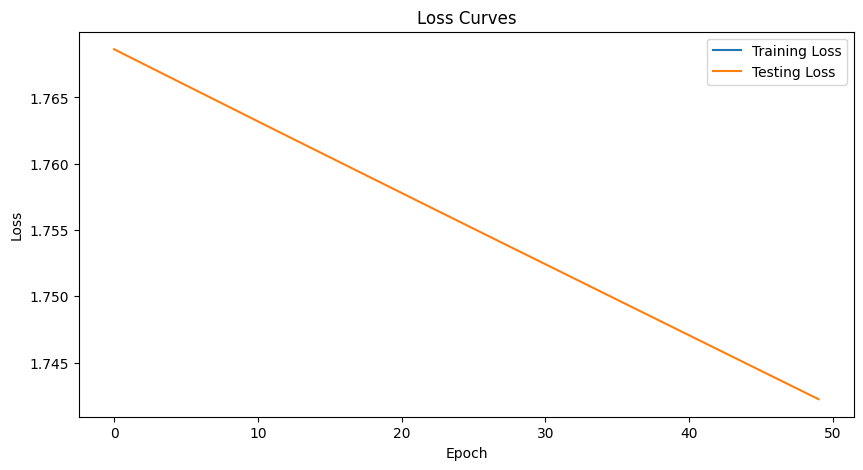

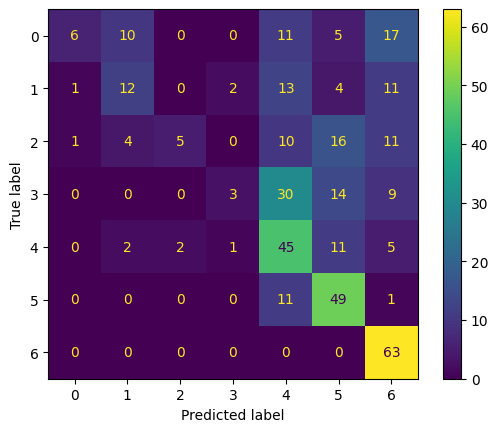

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.652 | Train Acc:  66.67% | Test NLL:  1.740 | Test Acc: 47.27%
Epoch 02 | Batch 003 | Train NLL:  1.647 | Train Acc:  66.67% | Test NLL:  1.738 | Test Acc: 47.27%
Epoch 03 | Batch 003 | Train NLL:  1.643 | Train Acc:  69.44% | Test NLL:  1.736 | Test Acc: 47.27%
Epoch 04 | Batch 003 | Train NLL:  1.638 | Train Acc:  69.44% | Test NLL:  1.733 | Test Acc: 47.27%
Epoch 05 | Batch 003 | Train NLL:  1.634 | Train Acc:  72.22% | Test NLL:  1.731 | Test Acc: 47.27%
Epoch 06 | Batch 003 | Train NLL:  1.629 | Train Acc:  72.22% | Test NLL:  1.729 | Test Acc: 47.01%
Epoch 07 | Batch 003 | Train NLL:  1.625 | Train Acc:  72.22% | Test NLL:  1.727 | Test Acc: 47.27%
Epoch 08 | Batch 003 | Train NLL:  1.620 | Train Acc:  72.22% | Test NLL:  1.725 | Test Acc: 47.27%
Epoch 09 | Batch 003 | Train NLL:  1.616 | Train Acc:  69.44% | Test NLL:  1.722 | Test Acc: 47.27%
Epoch 10 | Batch

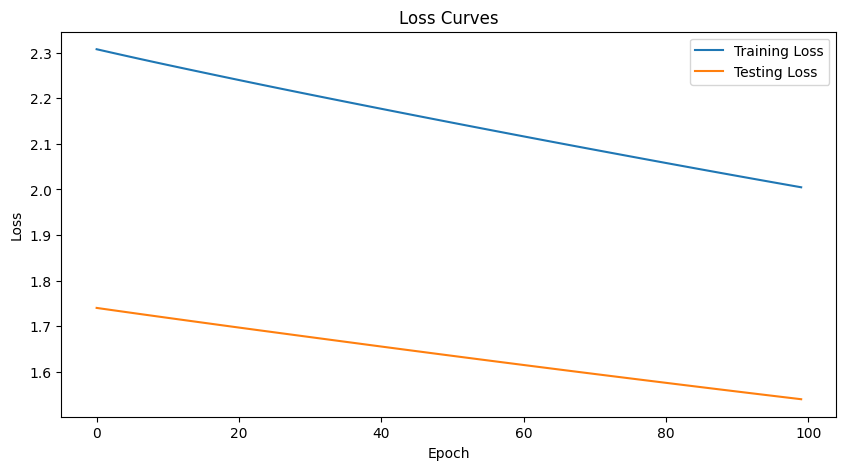

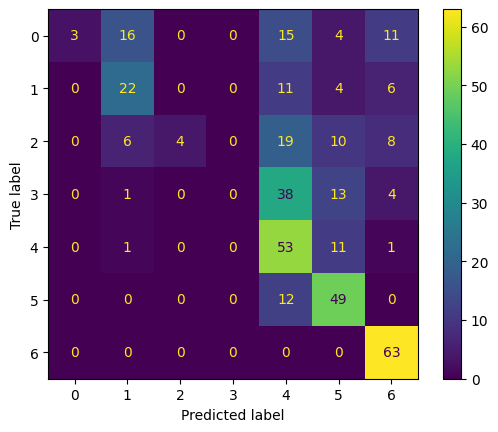

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.561 | Train Acc:  48.51% | Test NLL:  1.539 | Test Acc: 51.17%
Epoch 02 | Batch 001 | Train NLL:  1.560 | Train Acc:  48.51% | Test NLL:  1.538 | Test Acc: 51.69%
Epoch 03 | Batch 001 | Train NLL:  1.559 | Train Acc:  48.88% | Test NLL:  1.536 | Test Acc: 51.69%
Epoch 04 | Batch 001 | Train NLL:  1.558 | Train Acc:  48.88% | Test NLL:  1.535 | Test Acc: 51.69%
Epoch 05 | Batch 001 | Train NLL:  1.557 | Train Acc:  49.07% | Test NLL:  1.534 | Test Acc: 51.69%
Epoch 06 | Batch 001 | Train NLL:  1.556 | Train Acc:  49.44% | Test NLL:  1.533 | Test Acc: 51.95%
Epoch 07 | Batch 001 | Train NLL:  1.555 | Train Acc:  49.44% | Test NLL:  1.532 | Test Acc: 51.95%
Epoch 08 | Batch 001 | Train NLL:  1.554 | Train Acc:  49.63% | Test NLL:  1.531 | Test Acc: 51.95%
Epoch 09 | Batch 001 | Train NLL:  1.553 | Train Acc:  50.00% | Test NLL:  1.530 | Test Acc: 51.69%
Epoch 10 | Batc

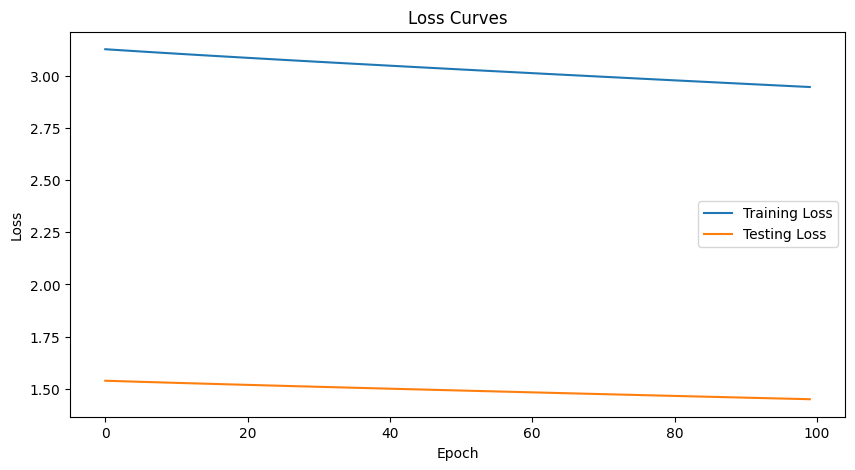

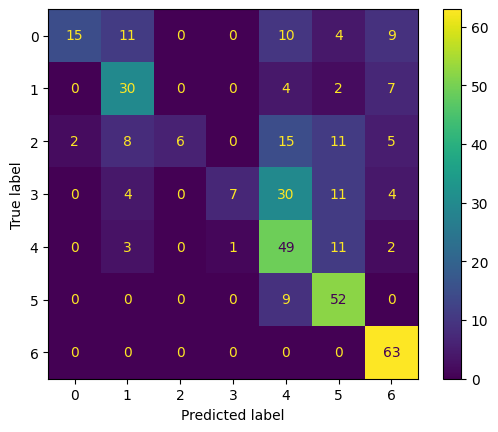

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.472 | Train Acc:  54.23% | Test NLL:  1.450 | Test Acc: 57.66%
Epoch 02 | Batch 000 | Train NLL:  1.472 | Train Acc:  54.23% | Test NLL:  1.449 | Test Acc: 57.66%
Epoch 03 | Batch 000 | Train NLL:  1.471 | Train Acc:  54.23% | Test NLL:  1.449 | Test Acc: 57.40%
Epoch 04 | Batch 000 | Train NLL:  1.471 | Train Acc:  54.23% | Test NLL:  1.448 | Test Acc: 57.40%
Epoch 05 | Batch 000 | Train NLL:  1.470 | Train Acc:  54.30% | Test NLL:  1.448 | Test Acc: 57.40%
Epoch 06 | Batch 000 | Train NLL:  1.470 | Train Acc:  54.30% | Test NLL:  1.447 | Test Acc: 57.40%
Epoch 07 | Batch 000 | Train NLL:  1.470 | Train Acc:  54.30% | Test NLL:  1.447 | Test Acc: 57.40%
Epoch 08 | Batch 000 | Train NLL:  1.469 | Train Acc:  54.30% | Test NLL:  1.447 | Test Acc: 57.40%
Epoch 09 | Batch 000 | Train NLL:  1.469 | Train Acc:  54.36% | Test NLL:  1.446 | Test Acc: 57.40%
Epoch 10 | Batc

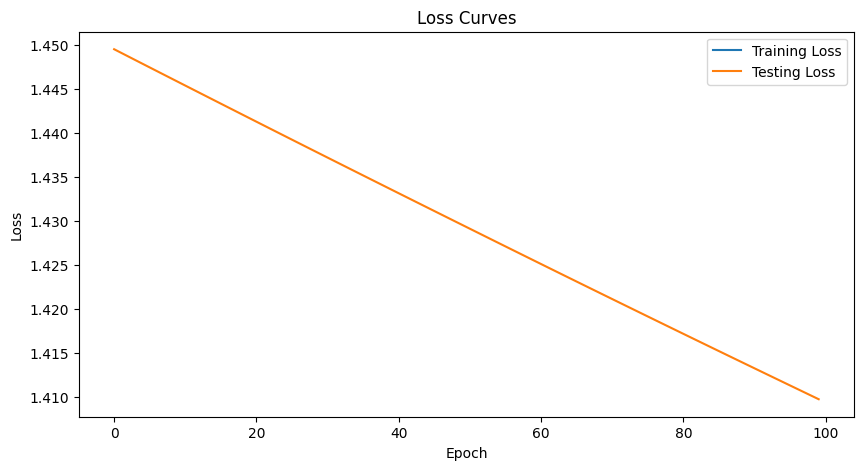

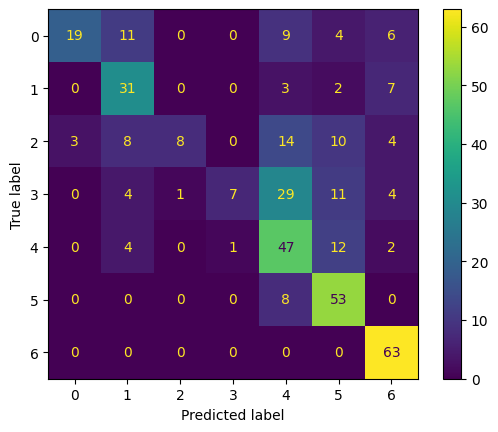

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.215 | Train Acc:  77.78% | Test NLL:  1.408 | Test Acc: 59.22%
Epoch 02 | Batch 003 | Train NLL:  1.210 | Train Acc:  77.78% | Test NLL:  1.406 | Test Acc: 58.70%
Epoch 03 | Batch 003 | Train NLL:  1.205 | Train Acc:  77.78% | Test NLL:  1.405 | Test Acc: 58.70%
Epoch 04 | Batch 003 | Train NLL:  1.200 | Train Acc:  77.78% | Test NLL:  1.403 | Test Acc: 58.70%
Epoch 05 | Batch 003 | Train NLL:  1.196 | Train Acc:  77.78% | Test NLL:  1.402 | Test Acc: 58.96%
Epoch 06 | Batch 003 | Train NLL:  1.192 | Train Acc:  77.78% | Test NLL:  1.400 | Test Acc: 58.70%
Epoch 07 | Batch 003 | Train NLL:  1.187 | Train Acc:  77.78% | Test NLL:  1.399 | Test Acc: 58.18%
Epoch 08 | Batch 003 | Train NLL:  1.183 | Train Acc:  77.78% | Test NLL:  1.397 | Test Acc: 57.92%
Epoch 09 | Batch 003 | Train NLL:  1.179 | Train Acc:  77.78% | Test NLL:  1.396 | Test Acc: 57.66%
Epoch 10 | Batch

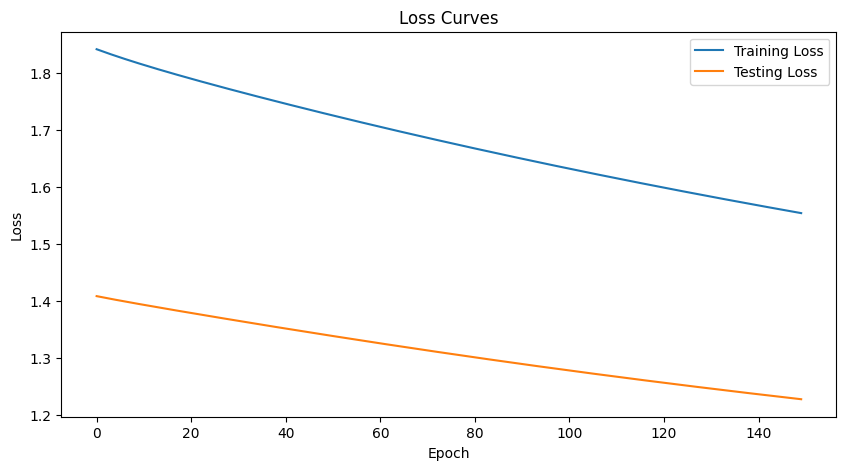

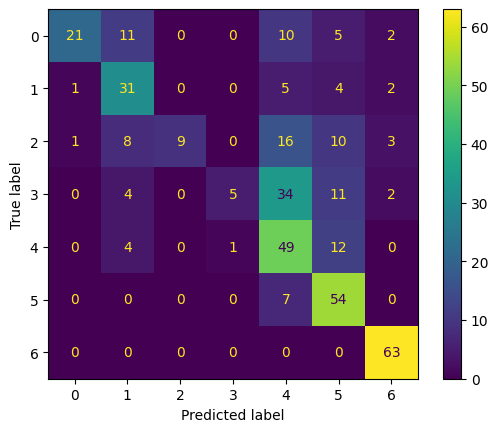

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.245 | Train Acc:  62.13% | Test NLL:  1.227 | Test Acc: 60.52%
Epoch 02 | Batch 001 | Train NLL:  1.245 | Train Acc:  62.13% | Test NLL:  1.226 | Test Acc: 60.78%
Epoch 03 | Batch 001 | Train NLL:  1.244 | Train Acc:  61.94% | Test NLL:  1.225 | Test Acc: 60.78%
Epoch 04 | Batch 001 | Train NLL:  1.243 | Train Acc:  62.13% | Test NLL:  1.225 | Test Acc: 61.04%
Epoch 05 | Batch 001 | Train NLL:  1.242 | Train Acc:  62.13% | Test NLL:  1.224 | Test Acc: 61.04%
Epoch 06 | Batch 001 | Train NLL:  1.242 | Train Acc:  62.13% | Test NLL:  1.223 | Test Acc: 61.82%
Epoch 07 | Batch 001 | Train NLL:  1.241 | Train Acc:  62.50% | Test NLL:  1.223 | Test Acc: 61.82%
Epoch 08 | Batch 001 | Train NLL:  1.240 | Train Acc:  62.50% | Test NLL:  1.222 | Test Acc: 61.82%
Epoch 09 | Batch 001 | Train NLL:  1.240 | Train Acc:  62.69% | Test NLL:  1.221 | Test Acc: 62.08%
Epoch 10 | Batc

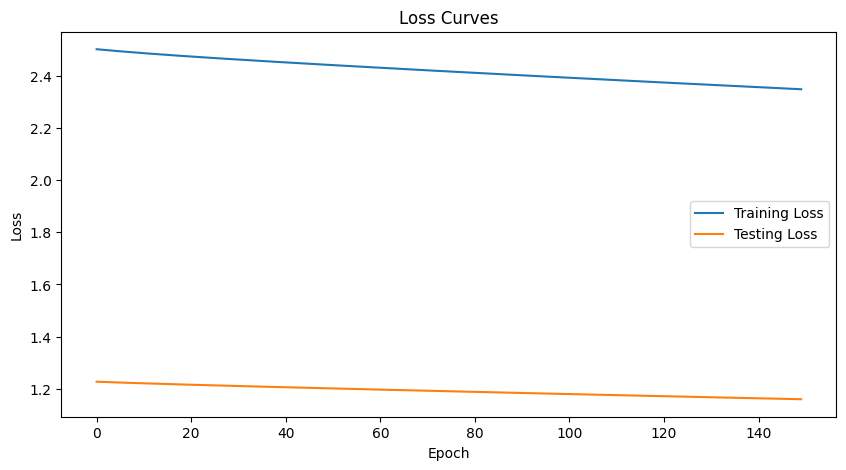

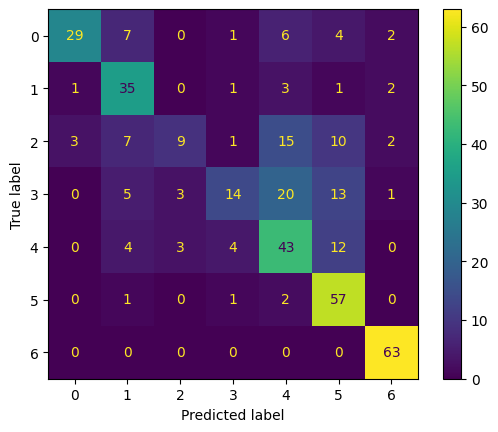

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.176 | Train Acc:  63.28% | Test NLL:  1.159 | Test Acc: 64.94%
Epoch 02 | Batch 000 | Train NLL:  1.176 | Train Acc:  63.28% | Test NLL:  1.159 | Test Acc: 64.94%
Epoch 03 | Batch 000 | Train NLL:  1.176 | Train Acc:  63.28% | Test NLL:  1.159 | Test Acc: 64.94%
Epoch 04 | Batch 000 | Train NLL:  1.176 | Train Acc:  63.28% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 05 | Batch 000 | Train NLL:  1.175 | Train Acc:  63.28% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 06 | Batch 000 | Train NLL:  1.175 | Train Acc:  63.28% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 07 | Batch 000 | Train NLL:  1.175 | Train Acc:  63.28% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 08 | Batch 000 | Train NLL:  1.175 | Train Acc:  63.22% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 09 | Batch 000 | Train NLL:  1.174 | Train Acc:  63.22% | Test NLL:  1.158 | Test Acc: 64.94%
Epoch 10 | Batc

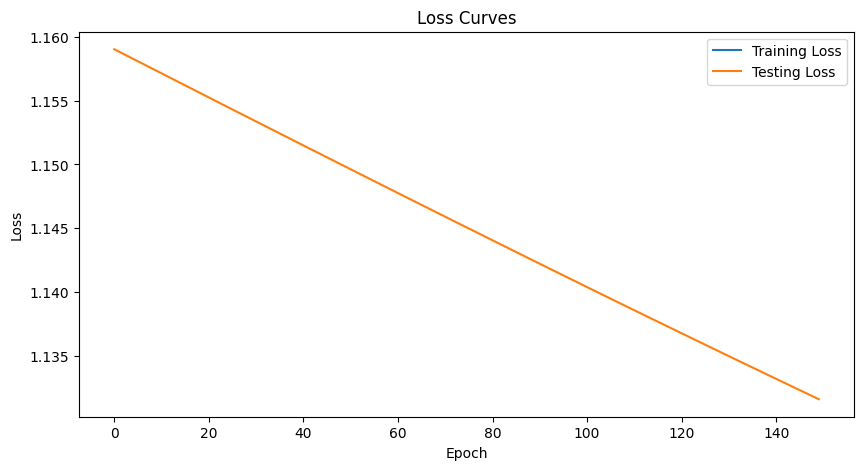

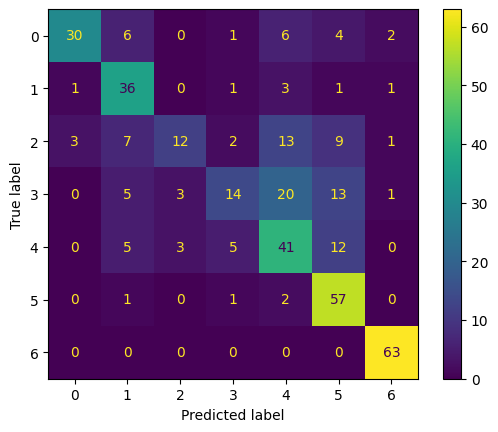

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.849 | Train Acc:  77.78% | Test NLL:  1.131 | Test Acc: 65.71%
Epoch 02 | Batch 003 | Train NLL:  0.845 | Train Acc:  77.78% | Test NLL:  1.130 | Test Acc: 65.45%
Epoch 03 | Batch 003 | Train NLL:  0.841 | Train Acc:  80.56% | Test NLL:  1.129 | Test Acc: 65.45%
Epoch 04 | Batch 003 | Train NLL:  0.837 | Train Acc:  80.56% | Test NLL:  1.128 | Test Acc: 65.45%
Epoch 05 | Batch 003 | Train NLL:  0.833 | Train Acc:  80.56% | Test NLL:  1.127 | Test Acc: 65.45%
Epoch 06 | Batch 003 | Train NLL:  0.829 | Train Acc:  80.56% | Test NLL:  1.127 | Test Acc: 65.71%
Epoch 07 | Batch 003 | Train NLL:  0.826 | Train Acc:  80.56% | Test NLL:  1.126 | Test Acc: 65.71%
Epoch 08 | Batch 003 | Train NLL:  0.823 | Train Acc:  80.56% | Test NLL:  1.125 | Test Acc: 65.19%
Epoch 09 | Batch 003 | Train NLL:  0.820 | Train Acc:  80.56% | Test NLL:  1.125 | Test Acc: 65.45%
Epoch 10 | Batch

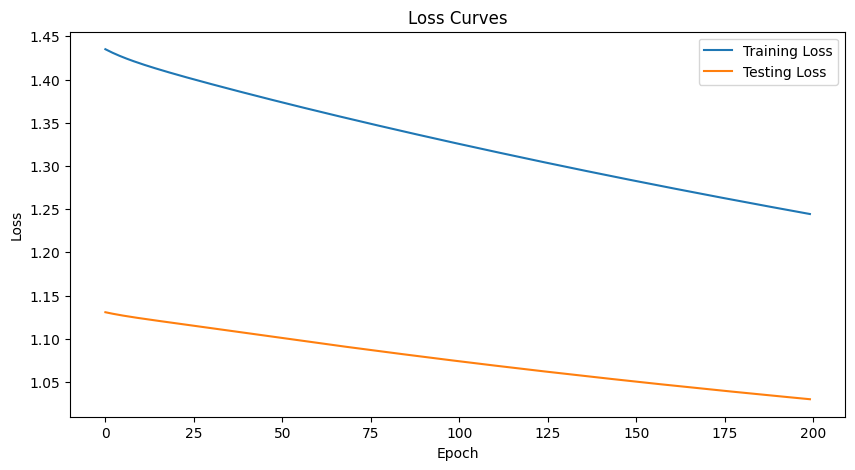

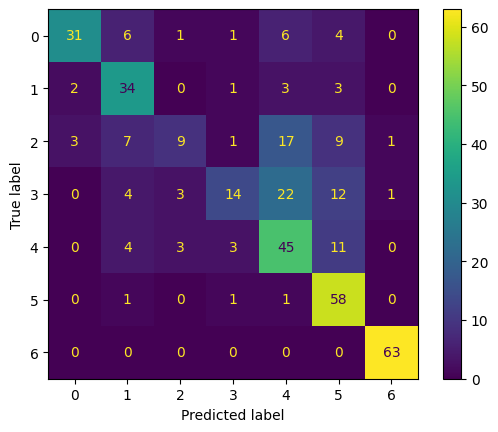

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.020 | Train Acc:  69.22% | Test NLL:  1.030 | Test Acc: 65.71%
Epoch 02 | Batch 001 | Train NLL:  1.019 | Train Acc:  69.03% | Test NLL:  1.029 | Test Acc: 65.71%
Epoch 03 | Batch 001 | Train NLL:  1.019 | Train Acc:  69.22% | Test NLL:  1.029 | Test Acc: 65.45%
Epoch 04 | Batch 001 | Train NLL:  1.018 | Train Acc:  69.22% | Test NLL:  1.028 | Test Acc: 65.71%
Epoch 05 | Batch 001 | Train NLL:  1.018 | Train Acc:  69.22% | Test NLL:  1.028 | Test Acc: 65.71%
Epoch 06 | Batch 001 | Train NLL:  1.017 | Train Acc:  69.22% | Test NLL:  1.028 | Test Acc: 65.97%
Epoch 07 | Batch 001 | Train NLL:  1.017 | Train Acc:  69.22% | Test NLL:  1.027 | Test Acc: 66.23%
Epoch 08 | Batch 001 | Train NLL:  1.016 | Train Acc:  69.03% | Test NLL:  1.027 | Test Acc: 66.23%
Epoch 09 | Batch 001 | Train NLL:  1.016 | Train Acc:  69.03% | Test NLL:  1.027 | Test Acc: 66.23%
Epoch 10 | Batc

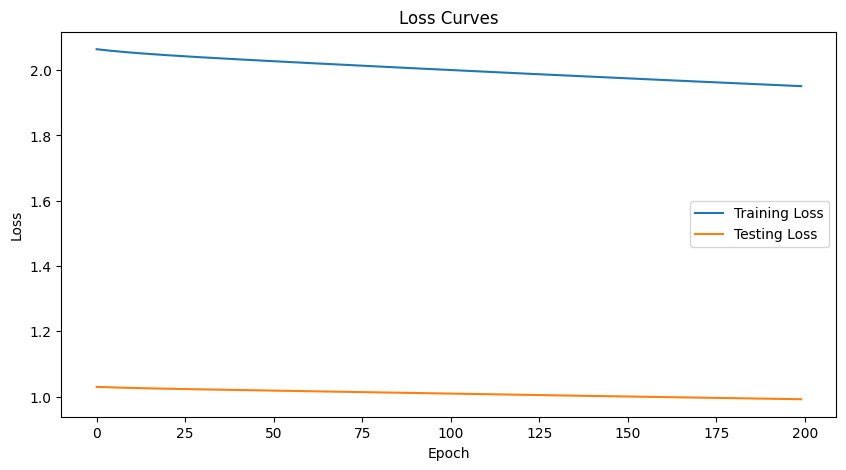

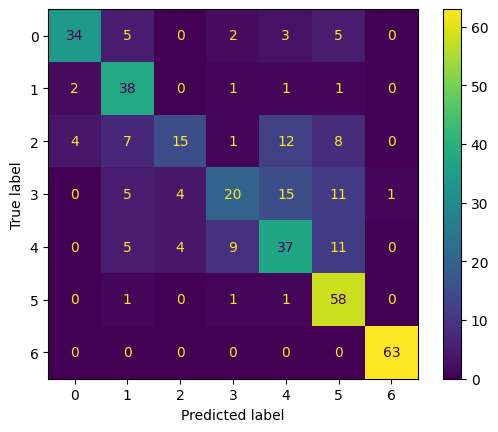

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.12% | Test NLL:  0.992 | Test Acc: 68.83%
Epoch 02 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.19% | Test NLL:  0.992 | Test Acc: 68.83%
Epoch 03 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.19% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 04 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.19% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 05 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.25% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 06 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.38% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 07 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.38% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 08 | Batch 000 | Train NLL:  0.979 | Train Acc:  67.38% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 09 | Batch 000 | Train NLL:  0.978 | Train Acc:  67.38% | Test NLL:  0.991 | Test Acc: 68.83%
Epoch 10 | Batc

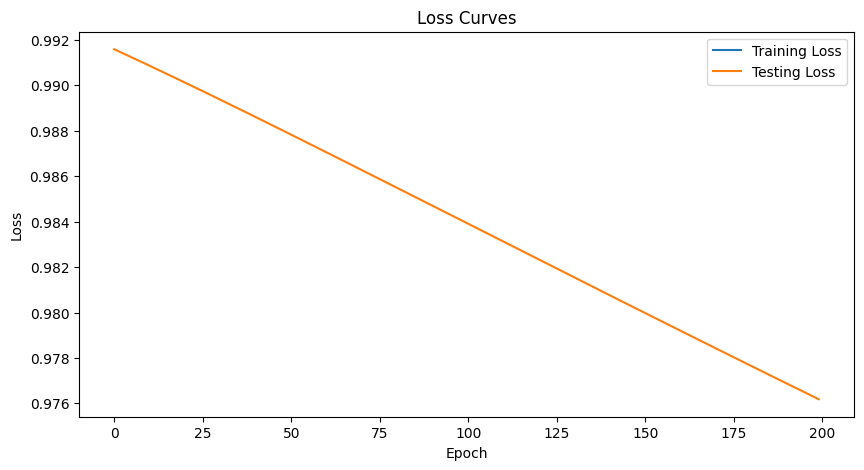

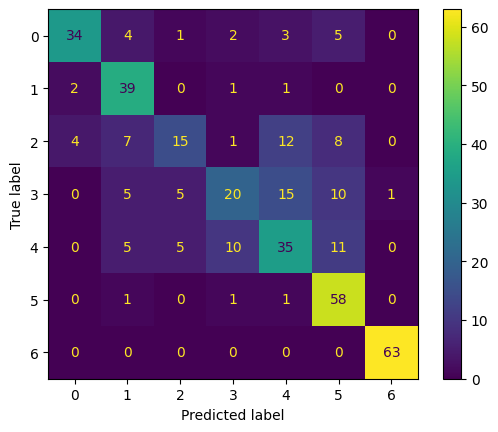

**************************************************



In [28]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 128

num_classes = 7

optimize_args = {"mode": "SGD", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 7)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, 
            BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.959 | Train Acc:  16.67% | Test NLL:  1.950 | Test Acc: 15.06%
Epoch 02 | Batch 003 | Train NLL:  1.935 | Train Acc:  25.00% | Test NLL:  1.937 | Test Acc: 22.60%
Epoch 03 | Batch 003 | Train NLL:  1.901 | Train Acc:  30.56% | Test NLL:  1.920 | Test Acc: 27.27%
Epoch 04 | Batch 003 | Train NLL:  1.860 | Train Acc:  38.89% | Test NLL:  1.902 | Test Acc: 30.13%
Epoch 05 | Batch 003 | Train NLL:  1.818 | Train Acc:  47.22% | Test NLL:  1.883 | Test Acc: 33.51%
Epoch 06 | Batch 003 | Train NLL:  1.777 | Train Acc:  47.22% | Test NLL:  1.863 | Test Acc: 34.03%
Epoch 07 | Batch 003 | Train NLL:  1.738 | Train Acc:  47.22% | Test NLL:  1.844 | Test Acc: 35.06%
Epoch 08 | Batch 003 | Train NLL:  1.700 | Train Acc:  50.00% | Test NLL:  1.825 | Test Acc: 35.32%
Epoch 09 | Batch 003 | Train NLL:  1.665 | Train Acc:  52.78% | Test NLL:  1.806 | Test Acc: 35.58%
Epoch 10 | Batch 003 | Train NLL:  1.631 | Train Acc:  58.33% | Test 

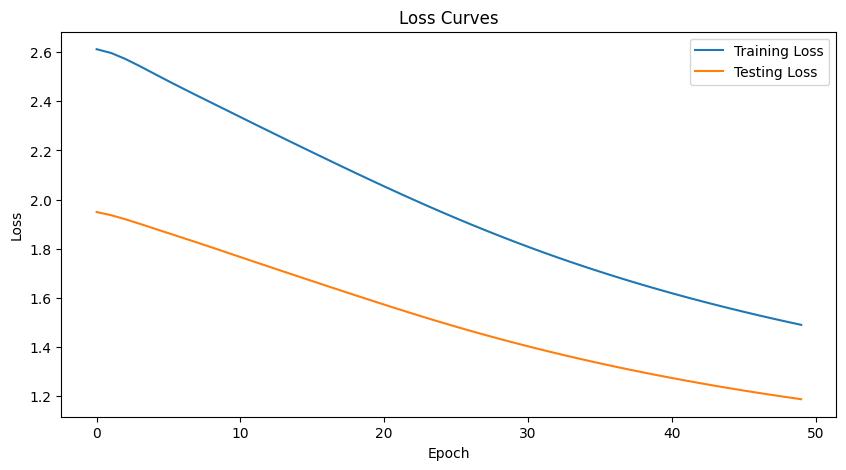

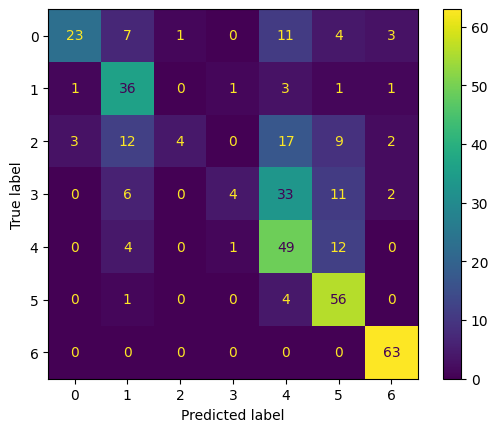

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.208 | Train Acc:  60.63% | Test NLL:  1.184 | Test Acc: 61.30%
Epoch 02 | Batch 001 | Train NLL:  1.203 | Train Acc:  61.19% | Test NLL:  1.179 | Test Acc: 61.30%
Epoch 03 | Batch 001 | Train NLL:  1.198 | Train Acc:  61.38% | Test NLL:  1.175 | Test Acc: 62.34%
Epoch 04 | Batch 001 | Train NLL:  1.193 | Train Acc:  61.75% | Test NLL:  1.170 | Test Acc: 63.38%
Epoch 05 | Batch 001 | Train NLL:  1.189 | Train Acc:  62.13% | Test NLL:  1.165 | Test Acc: 64.68%
Epoch 06 | Batch 001 | Train NLL:  1.184 | Train Acc:  63.06% | Test NLL:  1.161 | Test Acc: 65.45%
Epoch 07 | Batch 001 | Train NLL:  1.179 | Train Acc:  62.87% | Test NLL:  1.157 | Test Acc: 65.71%
Epoch 08 | Batch 001 | Train NLL:  1.175 | Train Acc:  62.87% | Test NLL:  1.153 | Test Acc: 65.97%
Epoch 09 | Batch 001 | Train NLL:  1.171 | Train Acc:  63.62% | Test NLL:  1.150 | Test Acc: 66.49%
Epoch 10 | Batch

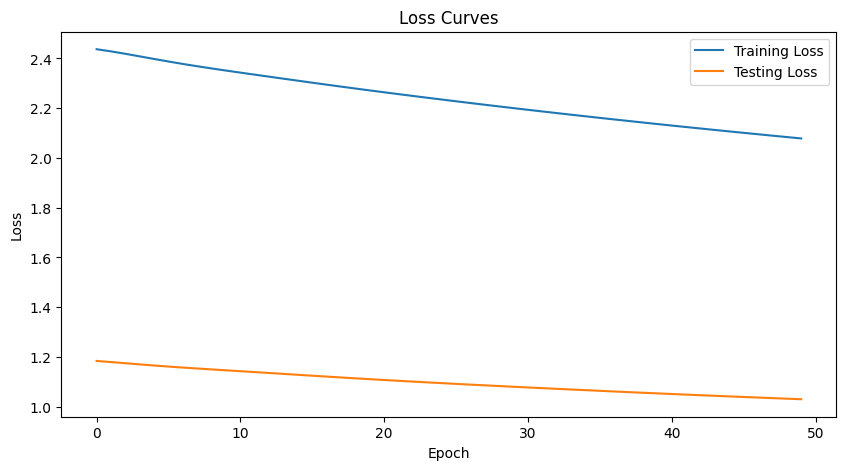

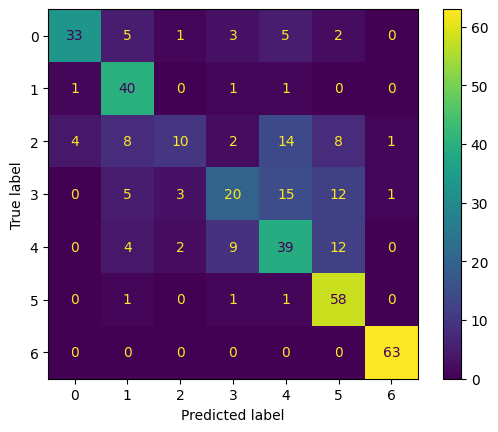

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.041 | Train Acc:  66.02% | Test NLL:  1.029 | Test Acc: 68.31%
Epoch 02 | Batch 000 | Train NLL:  1.039 | Train Acc:  66.08% | Test NLL:  1.028 | Test Acc: 68.57%
Epoch 03 | Batch 000 | Train NLL:  1.038 | Train Acc:  66.08% | Test NLL:  1.027 | Test Acc: 68.57%
Epoch 04 | Batch 000 | Train NLL:  1.037 | Train Acc:  66.15% | Test NLL:  1.026 | Test Acc: 68.57%
Epoch 05 | Batch 000 | Train NLL:  1.035 | Train Acc:  66.08% | Test NLL:  1.025 | Test Acc: 68.57%
Epoch 06 | Batch 000 | Train NLL:  1.034 | Train Acc:  66.02% | Test NLL:  1.024 | Test Acc: 68.57%
Epoch 07 | Batch 000 | Train NLL:  1.033 | Train Acc:  66.08% | Test NLL:  1.023 | Test Acc: 68.57%
Epoch 08 | Batch 000 | Train NLL:  1.031 | Train Acc:  66.15% | Test NLL:  1.022 | Test Acc: 68.57%
Epoch 09 | Batch 000 | Train NLL:  1.030 | Train Acc:  66.15% | Test NLL:  1.021 | Test Acc: 68.31%
Epoch 10 | Batch

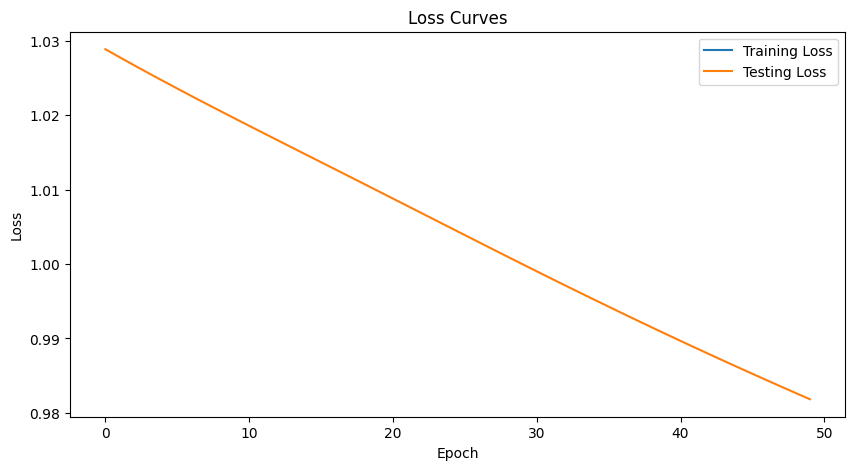

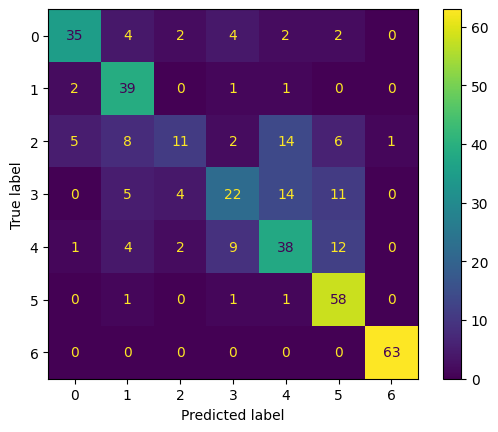

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.656 | Train Acc:  83.33% | Test NLL:  0.978 | Test Acc: 68.83%
Epoch 02 | Batch 003 | Train NLL:  0.641 | Train Acc:  86.11% | Test NLL:  0.974 | Test Acc: 69.09%
Epoch 03 | Batch 003 | Train NLL:  0.621 | Train Acc:  88.89% | Test NLL:  0.972 | Test Acc: 69.09%
Epoch 04 | Batch 003 | Train NLL:  0.601 | Train Acc:  88.89% | Test NLL:  0.970 | Test Acc: 69.09%
Epoch 05 | Batch 003 | Train NLL:  0.586 | Train Acc:  91.67% | Test NLL:  0.968 | Test Acc: 68.57%
Epoch 06 | Batch 003 | Train NLL:  0.574 | Train Acc:  91.67% | Test NLL:  0.965 | Test Acc: 68.57%
Epoch 07 | Batch 003 | Train NLL:  0.565 | Train Acc:  91.67% | Test NLL:  0.962 | Test Acc: 69.09%
Epoch 08 | Batch 003 | Train NLL:  0.559 | Train Acc:  91.67% | Test NLL:  0.958 | Test Acc: 69.61%
Epoch 09 | Batch 003 | Train NLL:  0.553 | Train Acc:  88.89% | Test NLL:  0.955 | Test Acc: 69.61%
Epoch 10 | Batch

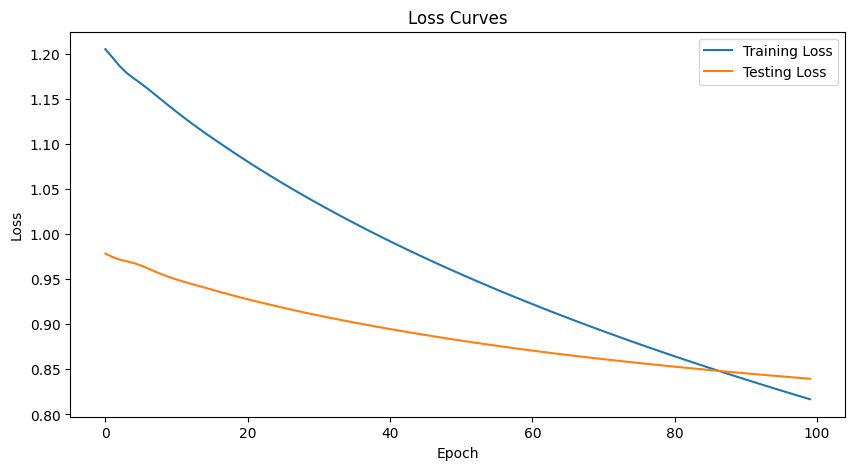

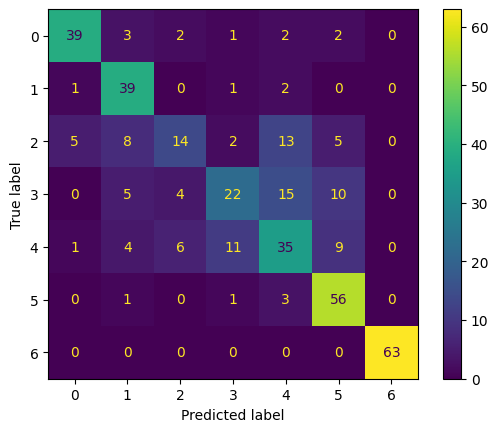

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.711 | Train Acc:  77.05% | Test NLL:  0.839 | Test Acc: 69.61%
Epoch 02 | Batch 001 | Train NLL:  0.709 | Train Acc:  76.87% | Test NLL:  0.839 | Test Acc: 69.87%
Epoch 03 | Batch 001 | Train NLL:  0.708 | Train Acc:  76.49% | Test NLL:  0.838 | Test Acc: 71.17%
Epoch 04 | Batch 001 | Train NLL:  0.707 | Train Acc:  76.31% | Test NLL:  0.838 | Test Acc: 71.43%
Epoch 05 | Batch 001 | Train NLL:  0.705 | Train Acc:  76.31% | Test NLL:  0.838 | Test Acc: 71.95%
Epoch 06 | Batch 001 | Train NLL:  0.704 | Train Acc:  76.49% | Test NLL:  0.838 | Test Acc: 71.95%
Epoch 07 | Batch 001 | Train NLL:  0.703 | Train Acc:  76.49% | Test NLL:  0.838 | Test Acc: 72.21%
Epoch 08 | Batch 001 | Train NLL:  0.701 | Train Acc:  76.68% | Test NLL:  0.838 | Test Acc: 72.47%
Epoch 09 | Batch 001 | Train NLL:  0.700 | Train Acc:  76.87% | Test NLL:  0.837 | Test Acc: 72.47%
Epoch 10 | Batc

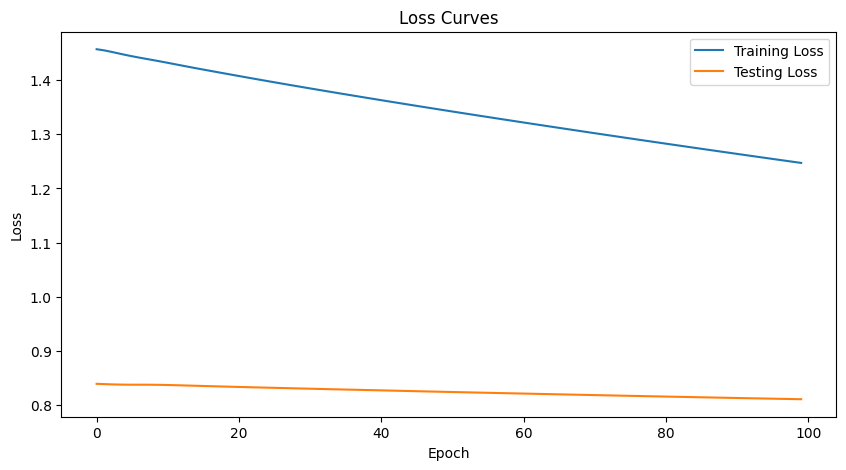

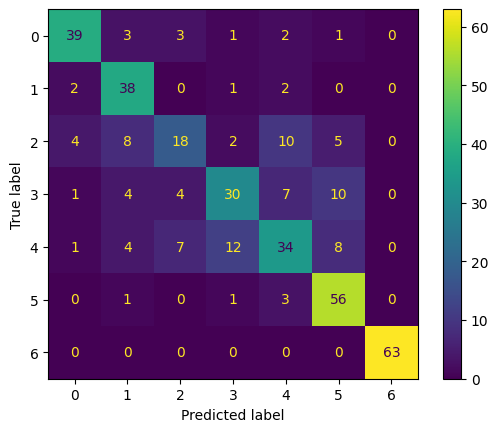

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.633 | Train Acc:  78.45% | Test NLL:  0.811 | Test Acc: 72.21%
Epoch 02 | Batch 000 | Train NLL:  0.633 | Train Acc:  78.45% | Test NLL:  0.811 | Test Acc: 72.21%
Epoch 03 | Batch 000 | Train NLL:  0.632 | Train Acc:  78.45% | Test NLL:  0.810 | Test Acc: 72.21%
Epoch 04 | Batch 000 | Train NLL:  0.632 | Train Acc:  78.45% | Test NLL:  0.810 | Test Acc: 72.21%
Epoch 05 | Batch 000 | Train NLL:  0.632 | Train Acc:  78.45% | Test NLL:  0.810 | Test Acc: 72.21%
Epoch 06 | Batch 000 | Train NLL:  0.631 | Train Acc:  78.65% | Test NLL:  0.810 | Test Acc: 71.95%
Epoch 07 | Batch 000 | Train NLL:  0.631 | Train Acc:  78.58% | Test NLL:  0.810 | Test Acc: 71.95%
Epoch 08 | Batch 000 | Train NLL:  0.630 | Train Acc:  78.65% | Test NLL:  0.810 | Test Acc: 71.95%
Epoch 09 | Batch 000 | Train NLL:  0.630 | Train Acc:  78.65% | Test NLL:  0.810 | Test Acc: 71.95%
Epoch 10 | Batc

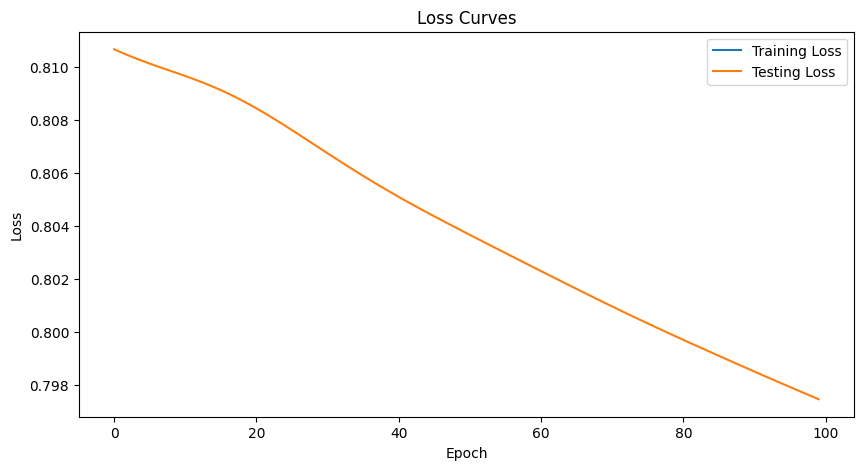

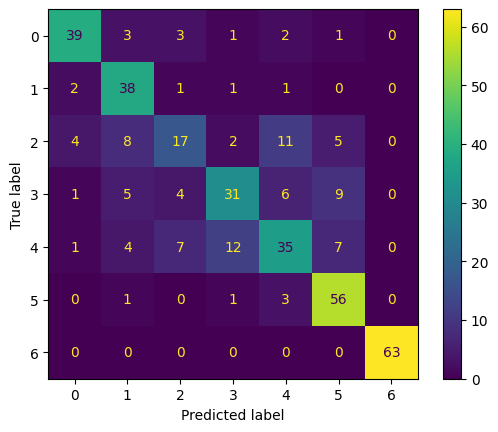

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.213 | Train Acc:  97.22% | Test NLL:  0.797 | Test Acc: 72.21%
Epoch 02 | Batch 003 | Train NLL:  0.208 | Train Acc:  97.22% | Test NLL:  0.796 | Test Acc: 71.95%
Epoch 03 | Batch 003 | Train NLL:  0.201 | Train Acc:  97.22% | Test NLL:  0.795 | Test Acc: 71.69%
Epoch 04 | Batch 003 | Train NLL:  0.195 | Train Acc:  97.22% | Test NLL:  0.795 | Test Acc: 71.43%
Epoch 05 | Batch 003 | Train NLL:  0.191 | Train Acc:  97.22% | Test NLL:  0.794 | Test Acc: 71.43%
Epoch 06 | Batch 003 | Train NLL:  0.188 | Train Acc:  97.22% | Test NLL:  0.793 | Test Acc: 71.69%
Epoch 07 | Batch 003 | Train NLL:  0.186 | Train Acc:  97.22% | Test NLL:  0.793 | Test Acc: 71.69%
Epoch 08 | Batch 003 | Train NLL:  0.185 | Train Acc:  97.22% | Test NLL:  0.792 | Test Acc: 71.69%
Epoch 09 | Batch 003 | Train NLL:  0.182 | Train Acc:  97.22% | Test NLL:  0.792 | Test Acc: 71.43%
Epoch 10 | Batch

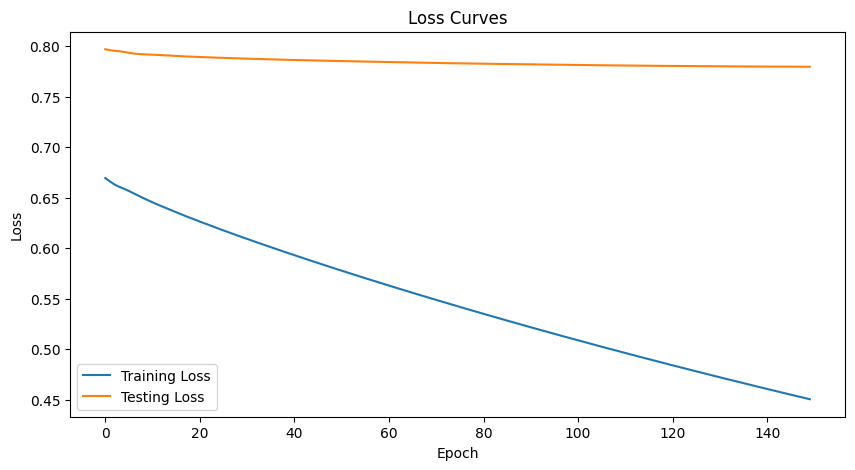

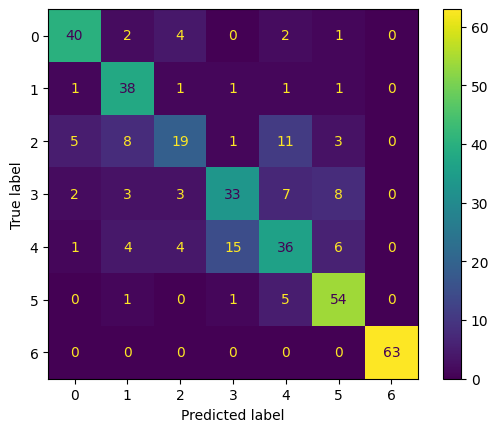

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.394 | Train Acc:  90.30% | Test NLL:  0.779 | Test Acc: 73.77%
Epoch 02 | Batch 001 | Train NLL:  0.393 | Train Acc:  90.11% | Test NLL:  0.779 | Test Acc: 73.25%
Epoch 03 | Batch 001 | Train NLL:  0.392 | Train Acc:  90.49% | Test NLL:  0.779 | Test Acc: 73.51%
Epoch 04 | Batch 001 | Train NLL:  0.392 | Train Acc:  90.49% | Test NLL:  0.779 | Test Acc: 73.77%
Epoch 05 | Batch 001 | Train NLL:  0.391 | Train Acc:  90.49% | Test NLL:  0.779 | Test Acc: 73.77%
Epoch 06 | Batch 001 | Train NLL:  0.390 | Train Acc:  90.67% | Test NLL:  0.779 | Test Acc: 73.77%
Epoch 07 | Batch 001 | Train NLL:  0.389 | Train Acc:  90.86% | Test NLL:  0.780 | Test Acc: 74.03%
Epoch 08 | Batch 001 | Train NLL:  0.388 | Train Acc:  91.04% | Test NLL:  0.780 | Test Acc: 74.03%
Epoch 09 | Batch 001 | Train NLL:  0.387 | Train Acc:  91.04% | Test NLL:  0.780 | Test Acc: 74.03%
Epoch 10 | Batc

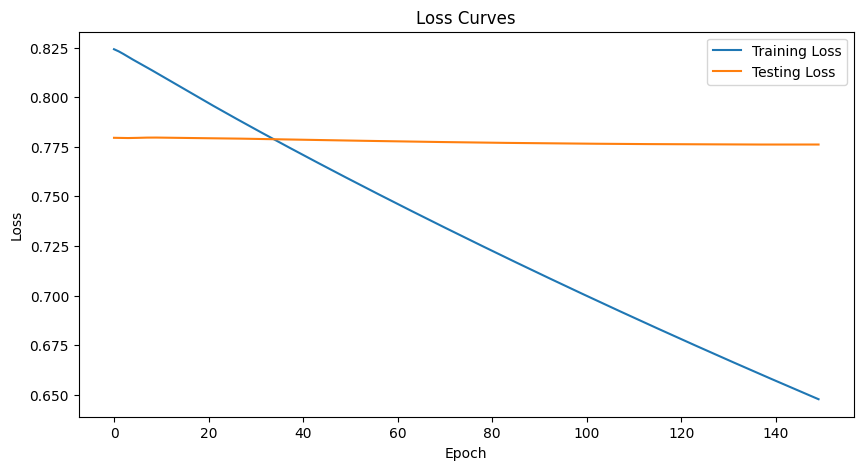

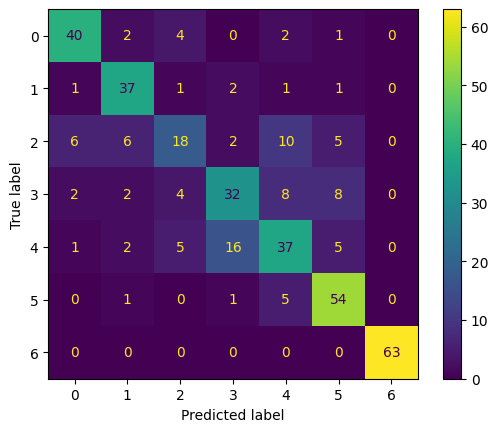

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.334 | Train Acc:  91.93% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 02 | Batch 000 | Train NLL:  0.334 | Train Acc:  91.93% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 03 | Batch 000 | Train NLL:  0.334 | Train Acc:  91.93% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 04 | Batch 000 | Train NLL:  0.333 | Train Acc:  91.99% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 05 | Batch 000 | Train NLL:  0.333 | Train Acc:  91.99% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 06 | Batch 000 | Train NLL:  0.333 | Train Acc:  91.99% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 07 | Batch 000 | Train NLL:  0.333 | Train Acc:  92.06% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 08 | Batch 000 | Train NLL:  0.332 | Train Acc:  92.06% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 09 | Batch 000 | Train NLL:  0.332 | Train Acc:  92.06% | Test NLL:  0.776 | Test Acc: 72.99%
Epoch 10 | Batc

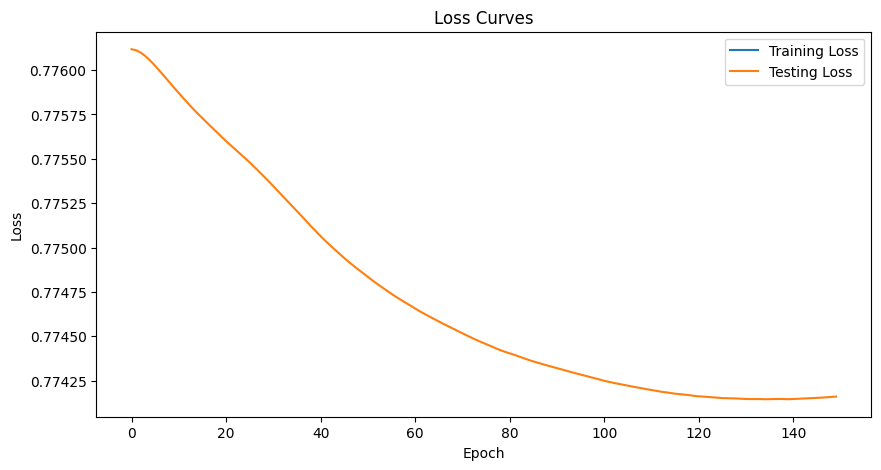

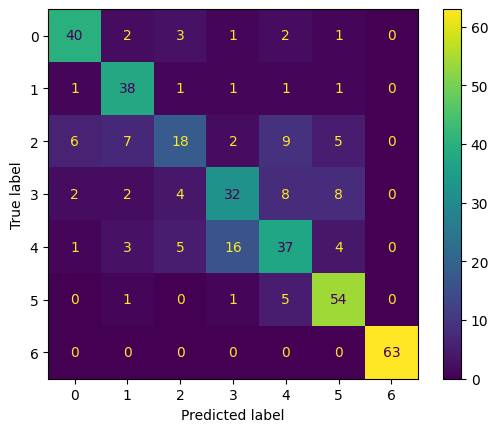

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.080 | Train Acc:  97.22% | Test NLL:  0.774 | Test Acc: 73.25%
Epoch 02 | Batch 003 | Train NLL:  0.078 | Train Acc:  97.22% | Test NLL:  0.774 | Test Acc: 73.51%
Epoch 03 | Batch 003 | Train NLL:  0.075 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.77%
Epoch 04 | Batch 003 | Train NLL:  0.073 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.77%
Epoch 05 | Batch 003 | Train NLL:  0.072 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.77%
Epoch 06 | Batch 003 | Train NLL:  0.072 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.77%
Epoch 07 | Batch 003 | Train NLL:  0.072 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.51%
Epoch 08 | Batch 003 | Train NLL:  0.071 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.51%
Epoch 09 | Batch 003 | Train NLL:  0.071 | Train Acc:  97.22% | Test NLL:  0.775 | Test Acc: 73.51%
Epoch 10 | Batch

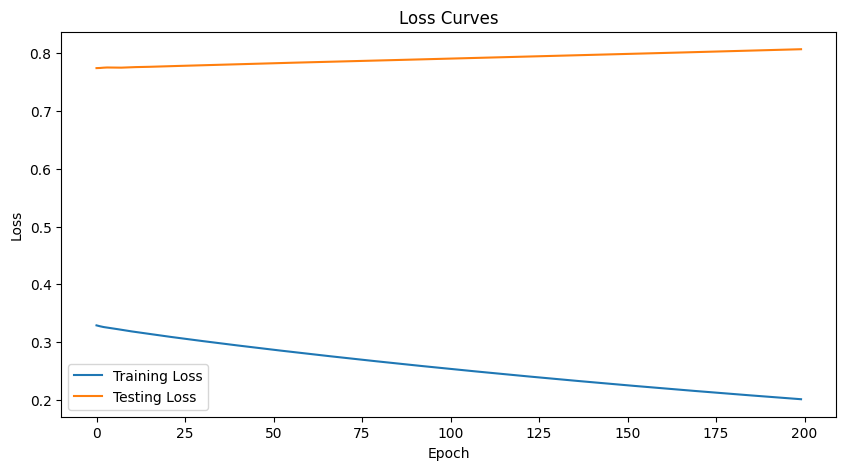

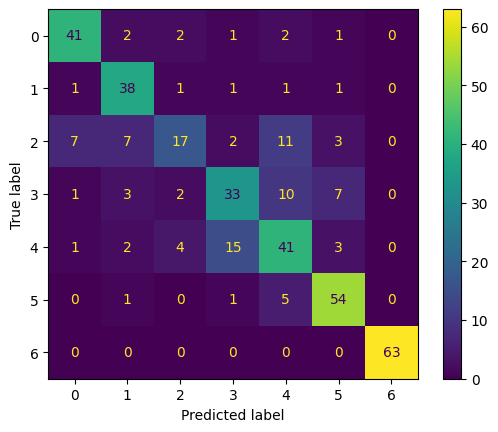

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.171 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.55%
Epoch 02 | Batch 001 | Train NLL:  0.171 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.55%
Epoch 03 | Batch 001 | Train NLL:  0.171 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.55%
Epoch 04 | Batch 001 | Train NLL:  0.171 | Train Acc:  97.39% | Test NLL:  0.807 | Test Acc: 74.55%
Epoch 05 | Batch 001 | Train NLL:  0.170 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.29%
Epoch 06 | Batch 001 | Train NLL:  0.170 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.29%
Epoch 07 | Batch 001 | Train NLL:  0.169 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.29%
Epoch 08 | Batch 001 | Train NLL:  0.169 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.29%
Epoch 09 | Batch 001 | Train NLL:  0.169 | Train Acc:  97.57% | Test NLL:  0.807 | Test Acc: 74.29%
Epoch 10 | Batc

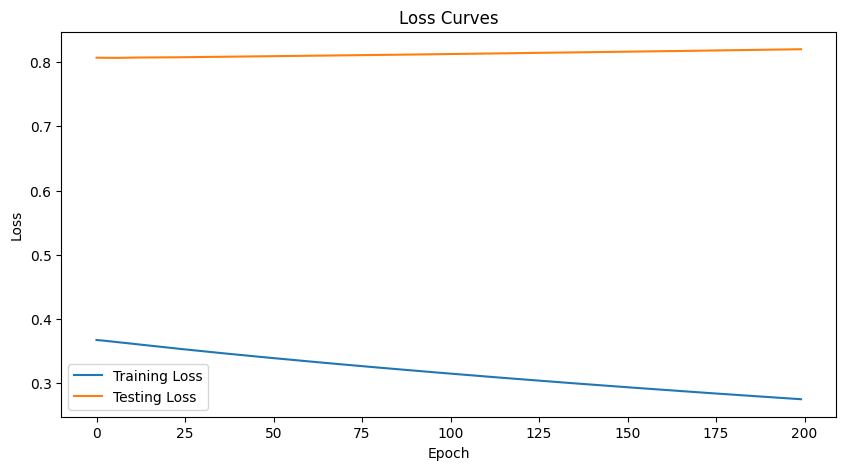

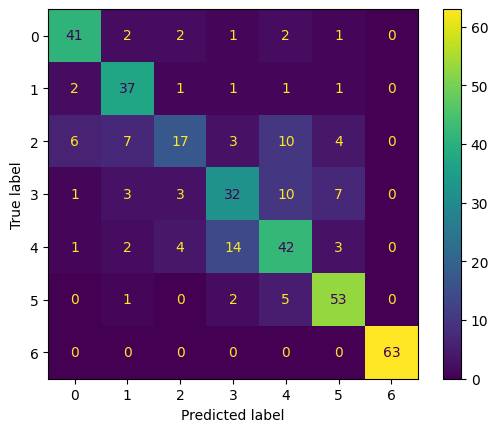

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.144 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 02 | Batch 000 | Train NLL:  0.144 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 03 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 04 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 05 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 06 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 07 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 08 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 09 | Batch 000 | Train NLL:  0.143 | Train Acc:  98.96% | Test NLL:  0.820 | Test Acc: 74.03%
Epoch 10 | Batc

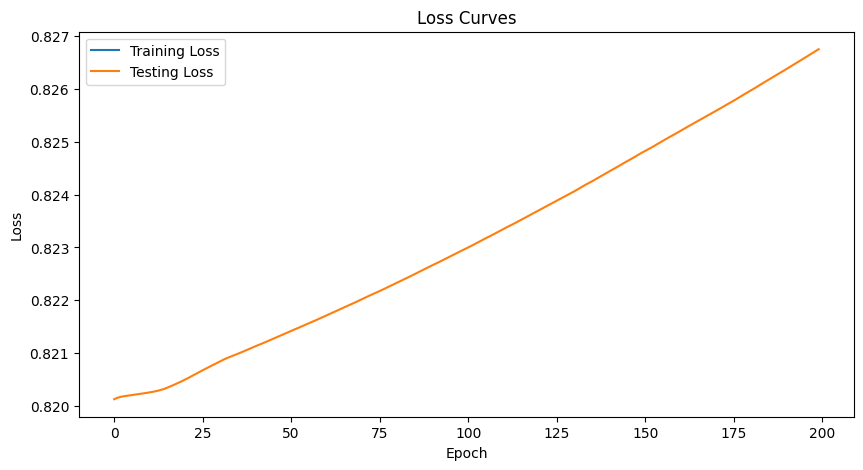

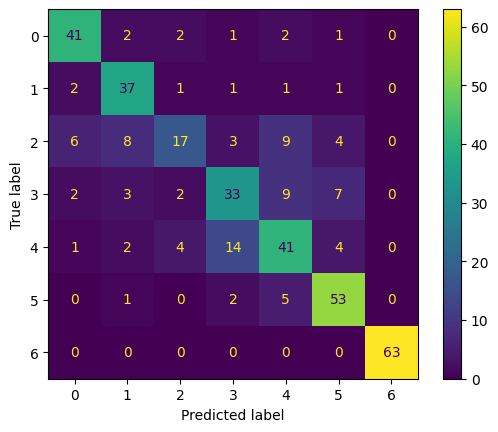

**************************************************



In [29]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 128

num_classes = 7

optimize_args = {"mode": "momentum", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 7)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO,
            BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.938 | Train Acc:  13.89% | Test NLL:  1.977 | Test Acc: 12.21%
Epoch 02 | Batch 003 | Train NLL:  1.932 | Train Acc:  13.89% | Test NLL:  1.973 | Test Acc: 11.95%
Epoch 03 | Batch 003 | Train NLL:  1.927 | Train Acc:  13.89% | Test NLL:  1.970 | Test Acc: 12.21%
Epoch 04 | Batch 003 | Train NLL:  1.922 | Train Acc:  13.89% | Test NLL:  1.967 | Test Acc: 12.21%
Epoch 05 | Batch 003 | Train NLL:  1.918 | Train Acc:  13.89% | Test NLL:  1.964 | Test Acc: 12.47%
Epoch 06 | Batch 003 | Train NLL:  1.913 | Train Acc:  13.89% | Test NLL:  1.961 | Test Acc: 12.99%
Epoch 07 | Batch 003 | Train NLL:  1.909 | Train Acc:  13.89% | Test NLL:  1.958 | Test Acc: 13.25%
Epoch 08 | Batch 003 | Train NLL:  1.905 | Train Acc:  13.89% | Test NLL:  1.956 | Test Acc: 13.77%
Epoch 09 | Batch 003 | Train NLL:  1.900 | Train Acc:  16.67% | Test NLL:  1.953 | Test Acc: 13.51%
Epoch 10 | Batch 003 | Train NLL:  1.896 | Train Acc:  16.67% | Test 

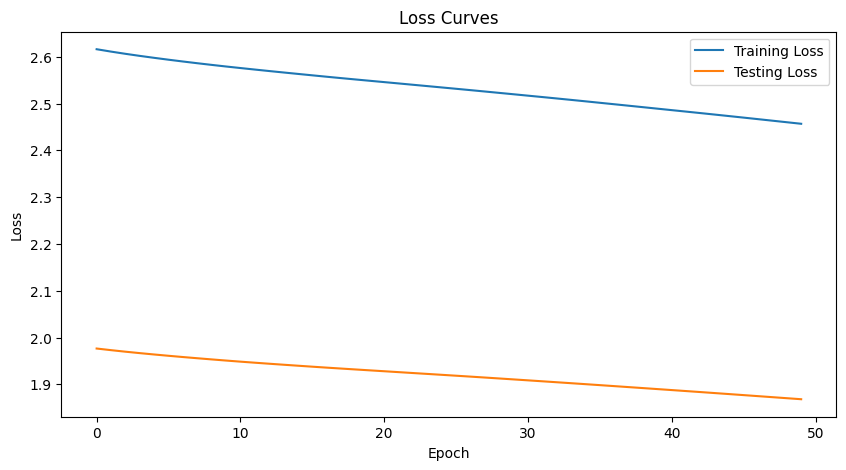

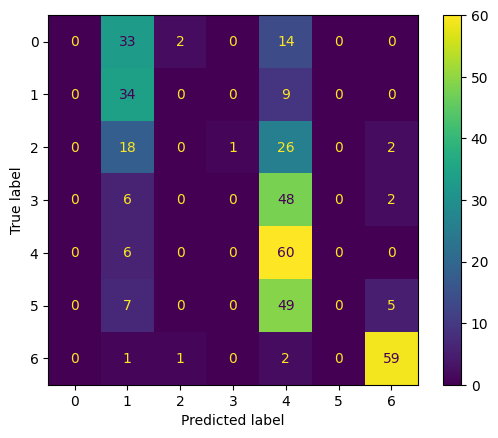

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.863 | Train Acc:  39.37% | Test NLL:  1.867 | Test Acc: 40.00%
Epoch 02 | Batch 001 | Train NLL:  1.862 | Train Acc:  39.37% | Test NLL:  1.866 | Test Acc: 40.00%
Epoch 03 | Batch 001 | Train NLL:  1.861 | Train Acc:  39.37% | Test NLL:  1.865 | Test Acc: 40.00%
Epoch 04 | Batch 001 | Train NLL:  1.860 | Train Acc:  39.55% | Test NLL:  1.864 | Test Acc: 40.00%
Epoch 05 | Batch 001 | Train NLL:  1.859 | Train Acc:  39.55% | Test NLL:  1.863 | Test Acc: 40.00%
Epoch 06 | Batch 001 | Train NLL:  1.858 | Train Acc:  39.55% | Test NLL:  1.862 | Test Acc: 40.00%
Epoch 07 | Batch 001 | Train NLL:  1.857 | Train Acc:  39.55% | Test NLL:  1.860 | Test Acc: 40.26%
Epoch 08 | Batch 001 | Train NLL:  1.856 | Train Acc:  39.74% | Test NLL:  1.859 | Test Acc: 40.52%
Epoch 09 | Batch 001 | Train NLL:  1.855 | Train Acc:  39.74% | Test NLL:  1.858 | Test Acc: 40.78%
Epoch 10 | Batch

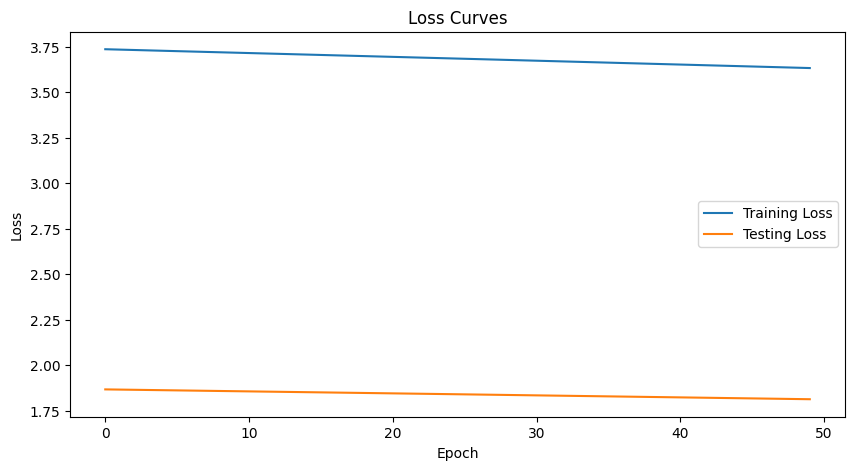

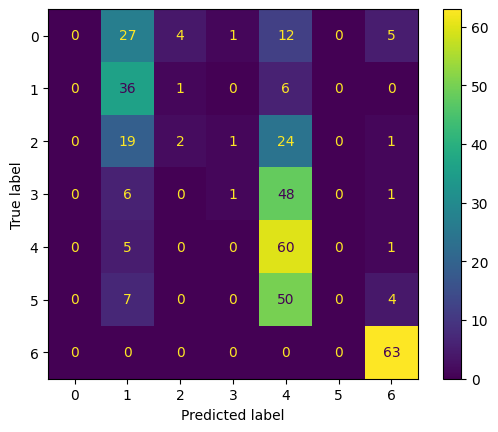

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.817 | Train Acc:  40.17% | Test NLL:  1.812 | Test Acc: 42.08%
Epoch 02 | Batch 000 | Train NLL:  1.817 | Train Acc:  40.10% | Test NLL:  1.812 | Test Acc: 42.08%
Epoch 03 | Batch 000 | Train NLL:  1.816 | Train Acc:  40.17% | Test NLL:  1.811 | Test Acc: 42.08%
Epoch 04 | Batch 000 | Train NLL:  1.816 | Train Acc:  40.17% | Test NLL:  1.811 | Test Acc: 42.34%
Epoch 05 | Batch 000 | Train NLL:  1.815 | Train Acc:  40.17% | Test NLL:  1.810 | Test Acc: 42.34%
Epoch 06 | Batch 000 | Train NLL:  1.815 | Train Acc:  40.17% | Test NLL:  1.810 | Test Acc: 42.34%
Epoch 07 | Batch 000 | Train NLL:  1.814 | Train Acc:  40.23% | Test NLL:  1.809 | Test Acc: 42.34%
Epoch 08 | Batch 000 | Train NLL:  1.814 | Train Acc:  40.23% | Test NLL:  1.808 | Test Acc: 42.34%
Epoch 09 | Batch 000 | Train NLL:  1.813 | Train Acc:  40.23% | Test NLL:  1.808 | Test Acc: 42.34%
Epoch 10 | Batch

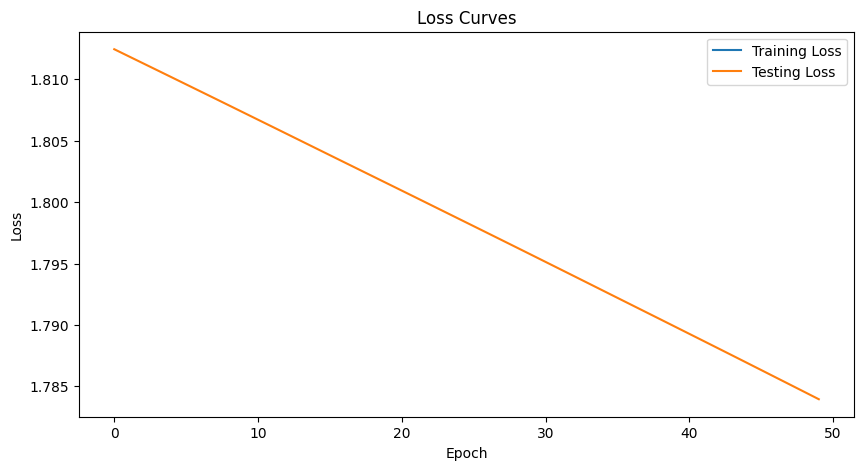

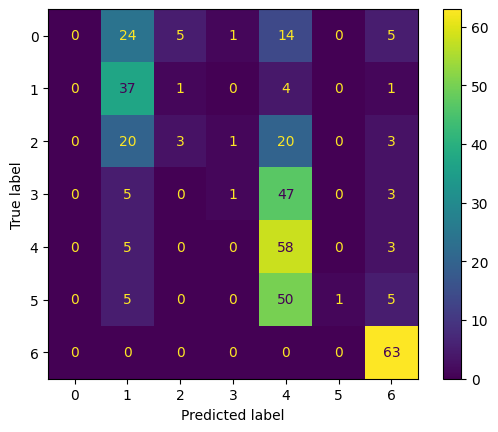

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.667 | Train Acc:  61.11% | Test NLL:  1.781 | Test Acc: 42.60%
Epoch 02 | Batch 003 | Train NLL:  1.661 | Train Acc:  61.11% | Test NLL:  1.779 | Test Acc: 42.86%
Epoch 03 | Batch 003 | Train NLL:  1.655 | Train Acc:  61.11% | Test NLL:  1.777 | Test Acc: 42.60%
Epoch 04 | Batch 003 | Train NLL:  1.650 | Train Acc:  61.11% | Test NLL:  1.774 | Test Acc: 42.60%
Epoch 05 | Batch 003 | Train NLL:  1.644 | Train Acc:  61.11% | Test NLL:  1.772 | Test Acc: 42.60%
Epoch 06 | Batch 003 | Train NLL:  1.639 | Train Acc:  61.11% | Test NLL:  1.769 | Test Acc: 42.60%
Epoch 07 | Batch 003 | Train NLL:  1.634 | Train Acc:  61.11% | Test NLL:  1.767 | Test Acc: 42.60%
Epoch 08 | Batch 003 | Train NLL:  1.629 | Train Acc:  61.11% | Test NLL:  1.765 | Test Acc: 42.60%
Epoch 09 | Batch 003 | Train NLL:  1.624 | Train Acc:  61.11% | Test NLL:  1.762 | Test Acc: 42.60%
Epoch 10 | Batch

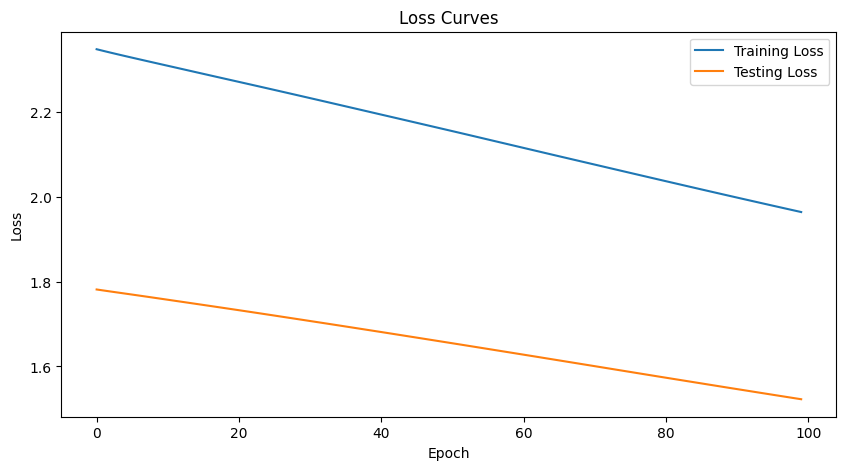

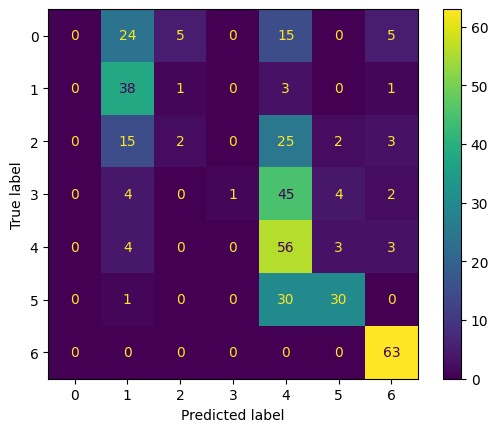

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.536 | Train Acc:  47.95% | Test NLL:  1.521 | Test Acc: 49.61%
Epoch 02 | Batch 001 | Train NLL:  1.534 | Train Acc:  48.13% | Test NLL:  1.520 | Test Acc: 49.87%
Epoch 03 | Batch 001 | Train NLL:  1.533 | Train Acc:  48.32% | Test NLL:  1.518 | Test Acc: 49.87%
Epoch 04 | Batch 001 | Train NLL:  1.532 | Train Acc:  48.69% | Test NLL:  1.517 | Test Acc: 50.13%
Epoch 05 | Batch 001 | Train NLL:  1.530 | Train Acc:  48.88% | Test NLL:  1.516 | Test Acc: 50.13%
Epoch 06 | Batch 001 | Train NLL:  1.529 | Train Acc:  48.88% | Test NLL:  1.514 | Test Acc: 50.39%
Epoch 07 | Batch 001 | Train NLL:  1.527 | Train Acc:  48.88% | Test NLL:  1.513 | Test Acc: 50.39%
Epoch 08 | Batch 001 | Train NLL:  1.526 | Train Acc:  48.88% | Test NLL:  1.511 | Test Acc: 50.39%
Epoch 09 | Batch 001 | Train NLL:  1.525 | Train Acc:  48.69% | Test NLL:  1.510 | Test Acc: 50.65%
Epoch 10 | Batc

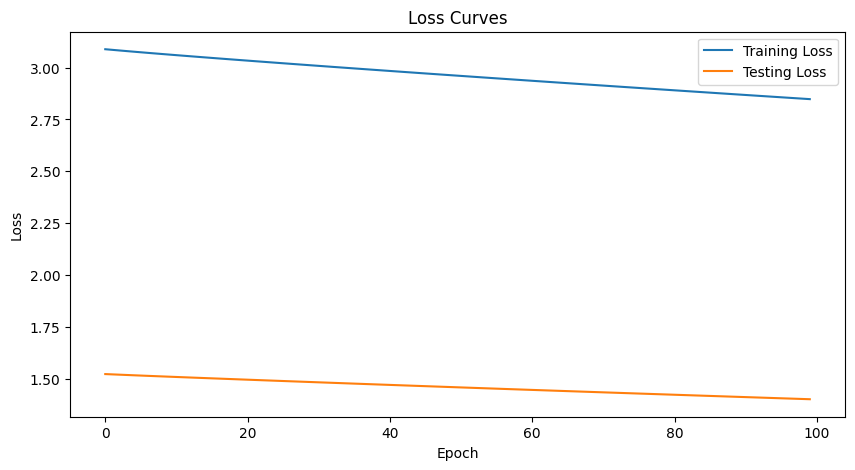

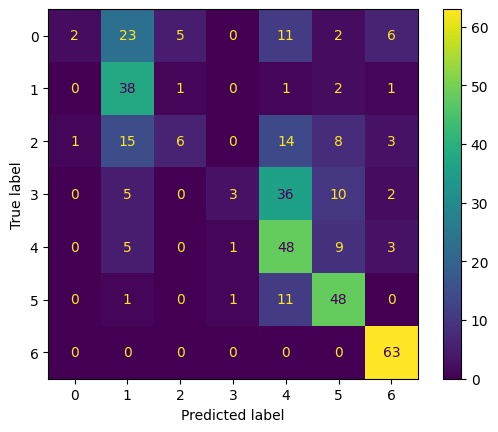

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.425 | Train Acc:  52.54% | Test NLL:  1.400 | Test Acc: 54.03%
Epoch 02 | Batch 000 | Train NLL:  1.425 | Train Acc:  52.54% | Test NLL:  1.399 | Test Acc: 54.03%
Epoch 03 | Batch 000 | Train NLL:  1.424 | Train Acc:  52.67% | Test NLL:  1.398 | Test Acc: 54.03%
Epoch 04 | Batch 000 | Train NLL:  1.424 | Train Acc:  52.67% | Test NLL:  1.398 | Test Acc: 54.03%
Epoch 05 | Batch 000 | Train NLL:  1.423 | Train Acc:  52.67% | Test NLL:  1.397 | Test Acc: 54.03%
Epoch 06 | Batch 000 | Train NLL:  1.422 | Train Acc:  52.73% | Test NLL:  1.397 | Test Acc: 54.03%
Epoch 07 | Batch 000 | Train NLL:  1.422 | Train Acc:  52.73% | Test NLL:  1.396 | Test Acc: 54.03%
Epoch 08 | Batch 000 | Train NLL:  1.421 | Train Acc:  52.73% | Test NLL:  1.396 | Test Acc: 54.29%
Epoch 09 | Batch 000 | Train NLL:  1.421 | Train Acc:  52.80% | Test NLL:  1.395 | Test Acc: 54.29%
Epoch 10 | Batc

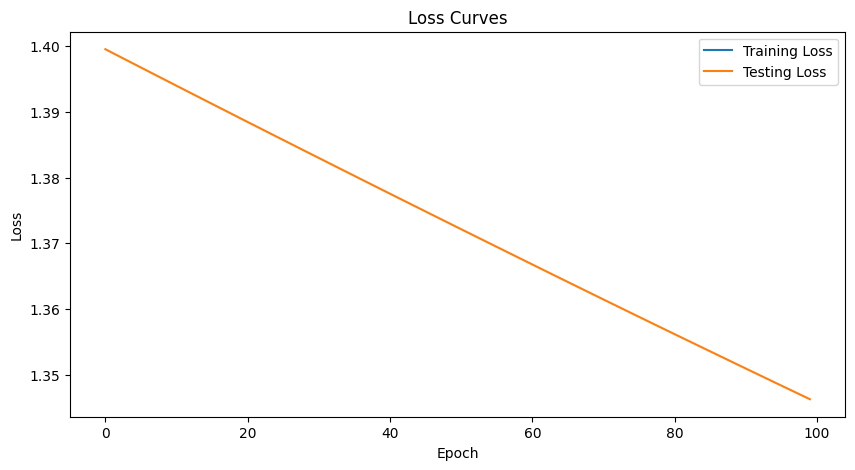

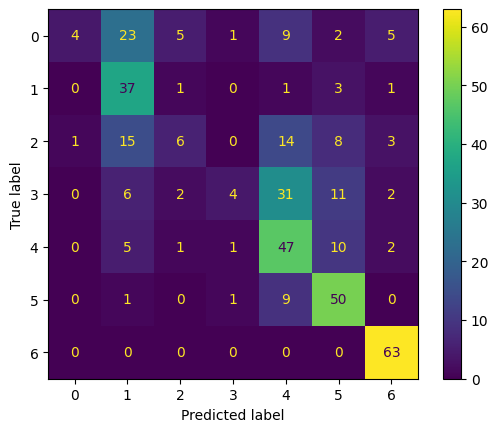

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  1.096 | Train Acc:  77.78% | Test NLL:  1.344 | Test Acc: 54.55%
Epoch 02 | Batch 003 | Train NLL:  1.088 | Train Acc:  77.78% | Test NLL:  1.341 | Test Acc: 54.55%
Epoch 03 | Batch 003 | Train NLL:  1.081 | Train Acc:  77.78% | Test NLL:  1.339 | Test Acc: 54.55%
Epoch 04 | Batch 003 | Train NLL:  1.074 | Train Acc:  77.78% | Test NLL:  1.337 | Test Acc: 54.03%
Epoch 05 | Batch 003 | Train NLL:  1.068 | Train Acc:  77.78% | Test NLL:  1.335 | Test Acc: 54.29%
Epoch 06 | Batch 003 | Train NLL:  1.062 | Train Acc:  77.78% | Test NLL:  1.333 | Test Acc: 54.29%
Epoch 07 | Batch 003 | Train NLL:  1.056 | Train Acc:  77.78% | Test NLL:  1.331 | Test Acc: 54.03%
Epoch 08 | Batch 003 | Train NLL:  1.050 | Train Acc:  77.78% | Test NLL:  1.329 | Test Acc: 53.77%
Epoch 09 | Batch 003 | Train NLL:  1.045 | Train Acc:  77.78% | Test NLL:  1.327 | Test Acc: 53.51%
Epoch 10 | Batch

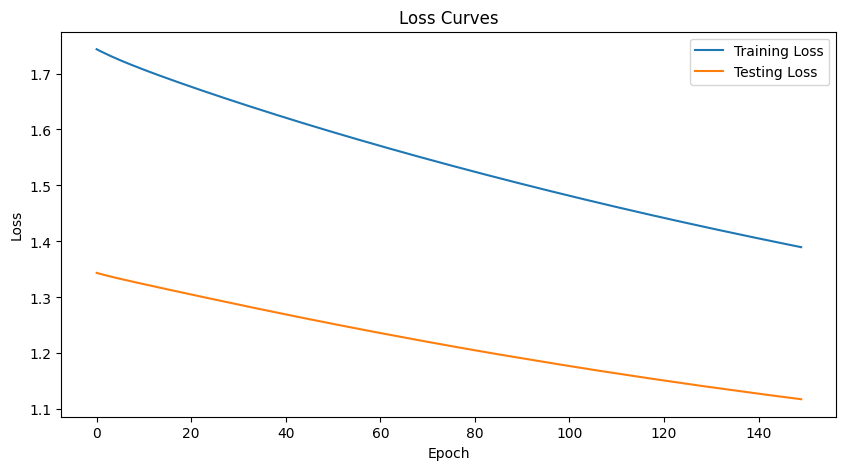

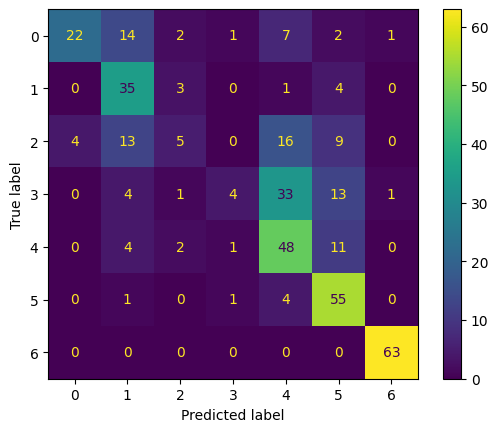

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.133 | Train Acc:  62.87% | Test NLL:  1.117 | Test Acc: 60.52%
Epoch 02 | Batch 001 | Train NLL:  1.132 | Train Acc:  63.25% | Test NLL:  1.116 | Test Acc: 61.30%
Epoch 03 | Batch 001 | Train NLL:  1.131 | Train Acc:  63.25% | Test NLL:  1.116 | Test Acc: 61.30%
Epoch 04 | Batch 001 | Train NLL:  1.130 | Train Acc:  63.43% | Test NLL:  1.115 | Test Acc: 61.30%
Epoch 05 | Batch 001 | Train NLL:  1.129 | Train Acc:  63.43% | Test NLL:  1.114 | Test Acc: 61.30%
Epoch 06 | Batch 001 | Train NLL:  1.128 | Train Acc:  63.81% | Test NLL:  1.113 | Test Acc: 61.04%
Epoch 07 | Batch 001 | Train NLL:  1.127 | Train Acc:  63.99% | Test NLL:  1.113 | Test Acc: 61.30%
Epoch 08 | Batch 001 | Train NLL:  1.126 | Train Acc:  64.37% | Test NLL:  1.112 | Test Acc: 61.82%
Epoch 09 | Batch 001 | Train NLL:  1.126 | Train Acc:  64.18% | Test NLL:  1.111 | Test Acc: 61.82%
Epoch 10 | Batc

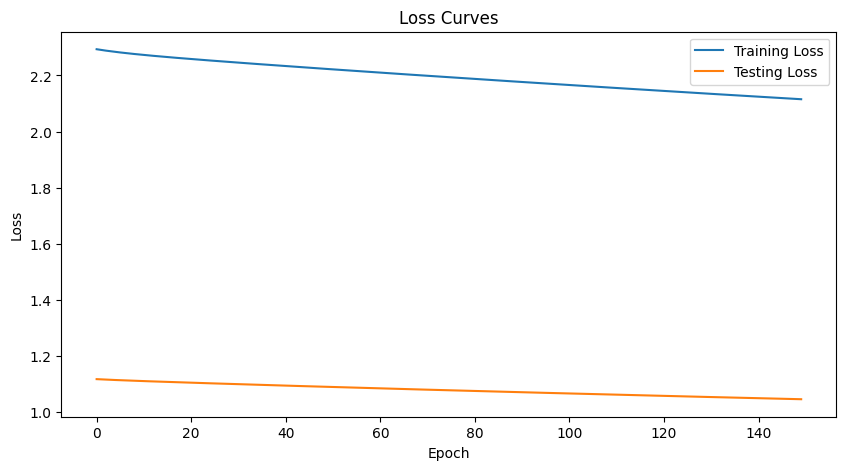

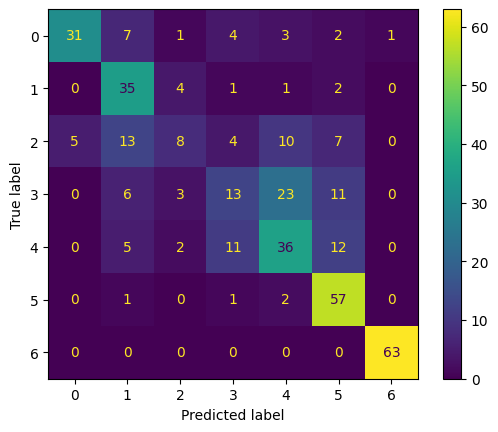

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  1.061 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 63.12%
Epoch 02 | Batch 000 | Train NLL:  1.061 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 63.12%
Epoch 03 | Batch 000 | Train NLL:  1.061 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 63.12%
Epoch 04 | Batch 000 | Train NLL:  1.060 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 62.86%
Epoch 05 | Batch 000 | Train NLL:  1.060 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 62.86%
Epoch 06 | Batch 000 | Train NLL:  1.060 | Train Acc:  63.41% | Test NLL:  1.045 | Test Acc: 62.86%
Epoch 07 | Batch 000 | Train NLL:  1.060 | Train Acc:  63.48% | Test NLL:  1.044 | Test Acc: 62.86%
Epoch 08 | Batch 000 | Train NLL:  1.059 | Train Acc:  63.48% | Test NLL:  1.044 | Test Acc: 62.86%
Epoch 09 | Batch 000 | Train NLL:  1.059 | Train Acc:  63.54% | Test NLL:  1.044 | Test Acc: 62.86%
Epoch 10 | Batc

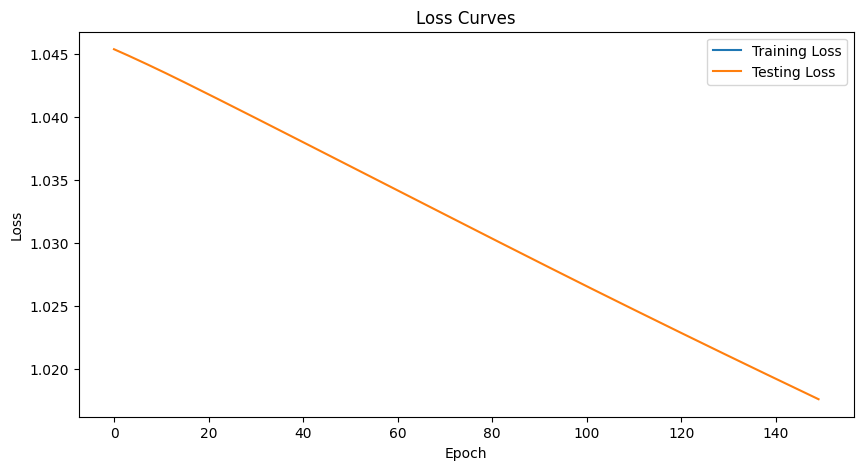

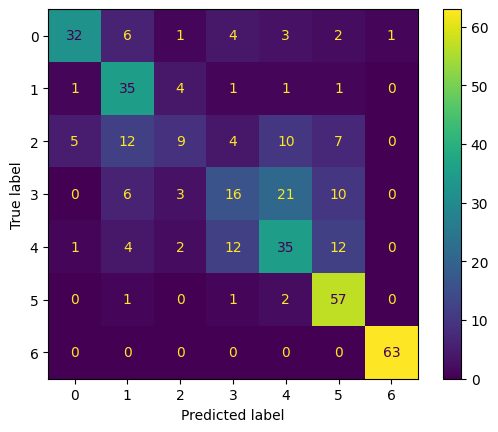

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.662 | Train Acc:  80.56% | Test NLL:  1.016 | Test Acc: 63.64%
Epoch 02 | Batch 003 | Train NLL:  0.653 | Train Acc:  83.33% | Test NLL:  1.015 | Test Acc: 63.64%
Epoch 03 | Batch 003 | Train NLL:  0.645 | Train Acc:  83.33% | Test NLL:  1.014 | Test Acc: 63.64%
Epoch 04 | Batch 003 | Train NLL:  0.639 | Train Acc:  83.33% | Test NLL:  1.013 | Test Acc: 63.38%
Epoch 05 | Batch 003 | Train NLL:  0.633 | Train Acc:  86.11% | Test NLL:  1.013 | Test Acc: 63.12%
Epoch 06 | Batch 003 | Train NLL:  0.628 | Train Acc:  88.89% | Test NLL:  1.012 | Test Acc: 63.64%
Epoch 07 | Batch 003 | Train NLL:  0.623 | Train Acc:  88.89% | Test NLL:  1.012 | Test Acc: 63.64%
Epoch 08 | Batch 003 | Train NLL:  0.619 | Train Acc:  88.89% | Test NLL:  1.011 | Test Acc: 63.90%
Epoch 09 | Batch 003 | Train NLL:  0.615 | Train Acc:  88.89% | Test NLL:  1.011 | Test Acc: 63.90%
Epoch 10 | Batch

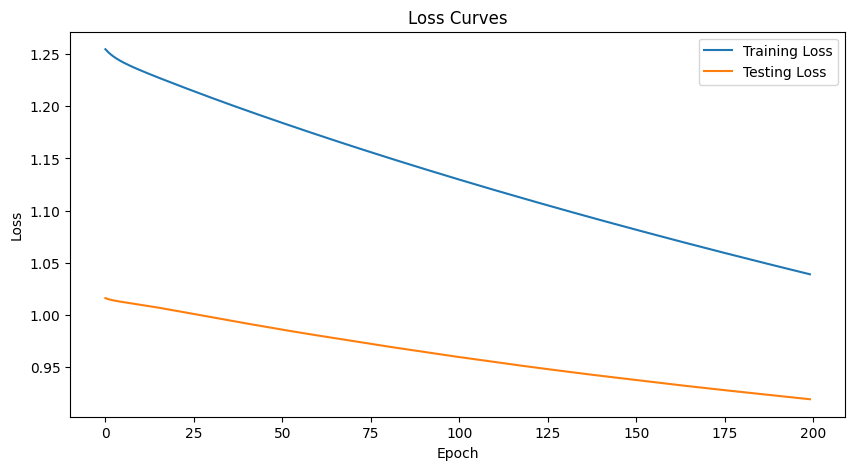

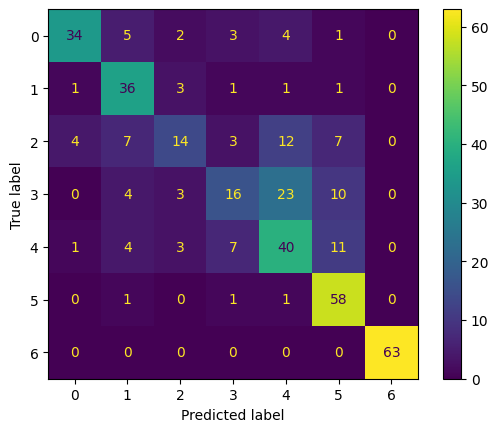

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.878 | Train Acc:  71.83% | Test NLL:  0.918 | Test Acc: 67.27%
Epoch 02 | Batch 001 | Train NLL:  0.877 | Train Acc:  71.27% | Test NLL:  0.918 | Test Acc: 67.53%
Epoch 03 | Batch 001 | Train NLL:  0.876 | Train Acc:  71.08% | Test NLL:  0.917 | Test Acc: 67.53%
Epoch 04 | Batch 001 | Train NLL:  0.875 | Train Acc:  71.08% | Test NLL:  0.917 | Test Acc: 67.79%
Epoch 05 | Batch 001 | Train NLL:  0.875 | Train Acc:  71.08% | Test NLL:  0.917 | Test Acc: 68.05%
Epoch 06 | Batch 001 | Train NLL:  0.874 | Train Acc:  71.27% | Test NLL:  0.916 | Test Acc: 68.31%
Epoch 07 | Batch 001 | Train NLL:  0.874 | Train Acc:  71.08% | Test NLL:  0.916 | Test Acc: 68.57%
Epoch 08 | Batch 001 | Train NLL:  0.873 | Train Acc:  71.08% | Test NLL:  0.916 | Test Acc: 68.57%
Epoch 09 | Batch 001 | Train NLL:  0.873 | Train Acc:  71.08% | Test NLL:  0.916 | Test Acc: 68.57%
Epoch 10 | Batc

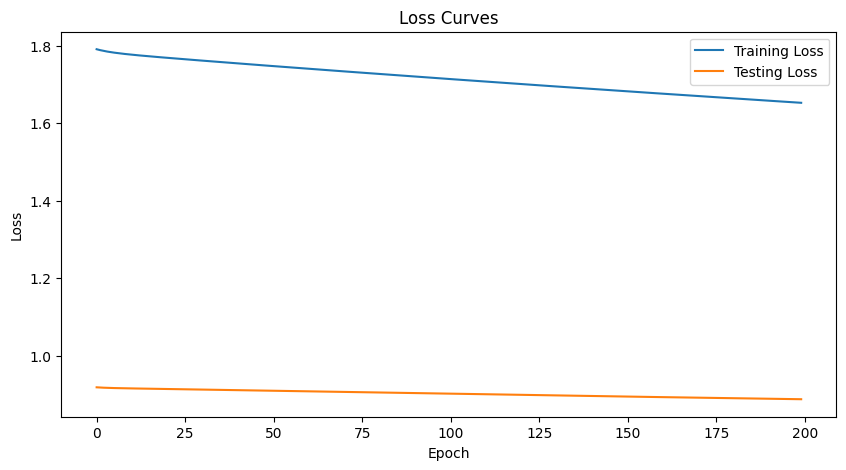

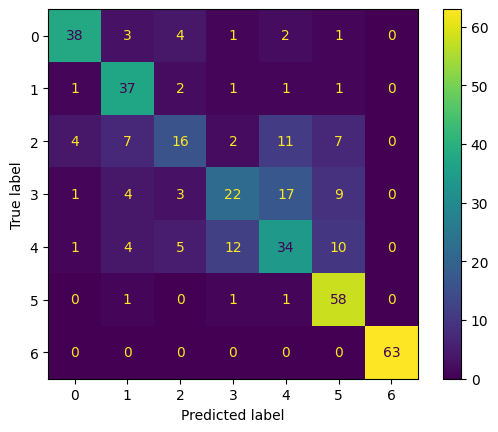

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.833 | Train Acc:  71.88% | Test NLL:  0.888 | Test Acc: 69.61%
Epoch 02 | Batch 000 | Train NLL:  0.833 | Train Acc:  71.88% | Test NLL:  0.888 | Test Acc: 69.61%
Epoch 03 | Batch 000 | Train NLL:  0.833 | Train Acc:  71.88% | Test NLL:  0.888 | Test Acc: 69.61%
Epoch 04 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.88% | Test NLL:  0.888 | Test Acc: 69.61%
Epoch 05 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.88% | Test NLL:  0.887 | Test Acc: 69.87%
Epoch 06 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.94% | Test NLL:  0.887 | Test Acc: 69.61%
Epoch 07 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.94% | Test NLL:  0.887 | Test Acc: 69.61%
Epoch 08 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.94% | Test NLL:  0.887 | Test Acc: 69.61%
Epoch 09 | Batch 000 | Train NLL:  0.832 | Train Acc:  71.94% | Test NLL:  0.887 | Test Acc: 69.87%
Epoch 10 | Batc

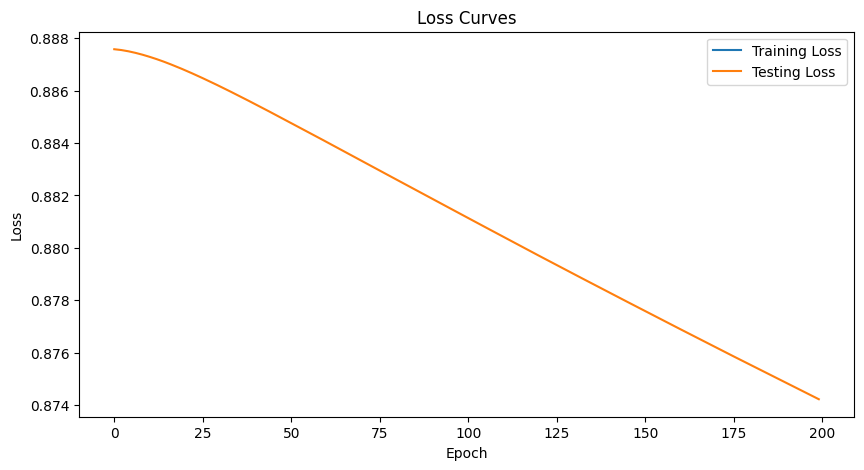

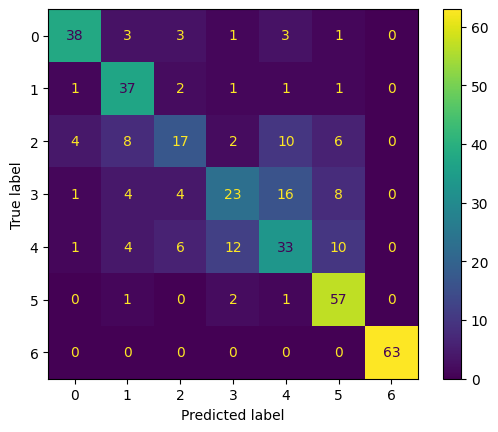

**************************************************



In [30]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 64

num_classes = 7

optimize_args = {"mode": "SGD", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 32), ReLU(), Linear(32, 7)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO,
            BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

EPOCH : 50 & BATCH SIZE : 500



Epoch 01 | Batch 003 | Train NLL:  1.958 | Train Acc:   5.56% | Test NLL:  1.954 | Test Acc: 10.91%
Epoch 02 | Batch 003 | Train NLL:  1.938 | Train Acc:   8.33% | Test NLL:  1.940 | Test Acc: 16.36%
Epoch 03 | Batch 003 | Train NLL:  1.910 | Train Acc:  25.00% | Test NLL:  1.924 | Test Acc: 28.57%
Epoch 04 | Batch 003 | Train NLL:  1.881 | Train Acc:  47.22% | Test NLL:  1.908 | Test Acc: 32.73%
Epoch 05 | Batch 003 | Train NLL:  1.854 | Train Acc:  44.44% | Test NLL:  1.893 | Test Acc: 34.03%
Epoch 06 | Batch 003 | Train NLL:  1.826 | Train Acc:  44.44% | Test NLL:  1.878 | Test Acc: 35.06%
Epoch 07 | Batch 003 | Train NLL:  1.797 | Train Acc:  47.22% | Test NLL:  1.862 | Test Acc: 36.62%
Epoch 08 | Batch 003 | Train NLL:  1.767 | Train Acc:  58.33% | Test NLL:  1.846 | Test Acc: 37.40%
Epoch 09 | Batch 003 | Train NLL:  1.735 | Train Acc:  58.33% | Test NLL:  1.830 | Test Acc: 37.40%
Epoch 10 | Batch 003 | Train NLL:  1.703 | Train Acc:  61.11% | Test NLL:  1.813 | Test Acc: 37.66%


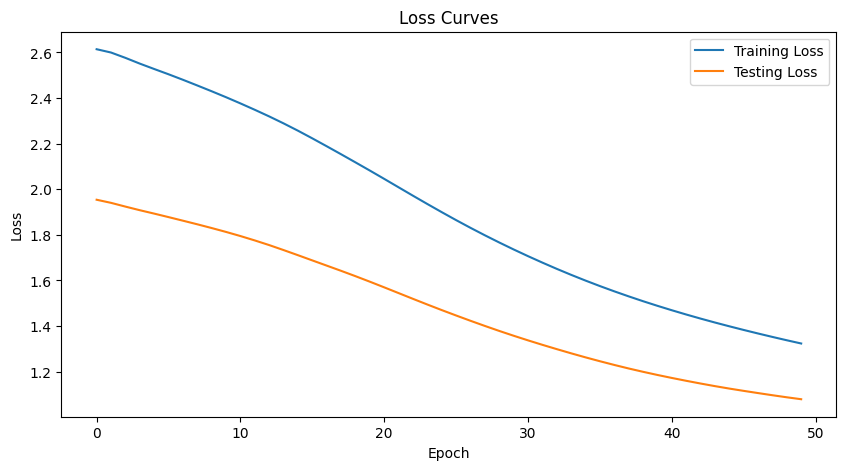

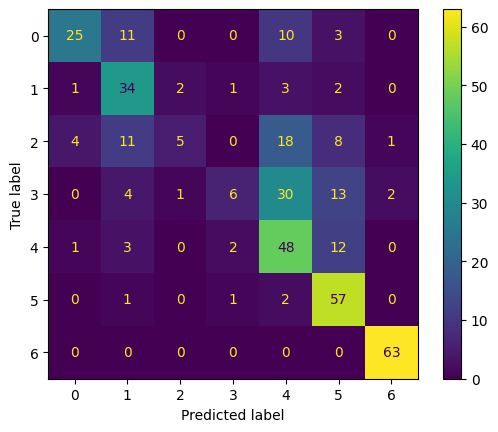

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  1.091 | Train Acc:  62.87% | Test NLL:  1.075 | Test Acc: 61.82%
Epoch 02 | Batch 001 | Train NLL:  1.086 | Train Acc:  63.06% | Test NLL:  1.071 | Test Acc: 62.34%
Epoch 03 | Batch 001 | Train NLL:  1.080 | Train Acc:  62.87% | Test NLL:  1.066 | Test Acc: 63.12%
Epoch 04 | Batch 001 | Train NLL:  1.074 | Train Acc:  63.43% | Test NLL:  1.062 | Test Acc: 65.19%
Epoch 05 | Batch 001 | Train NLL:  1.069 | Train Acc:  64.18% | Test NLL:  1.058 | Test Acc: 66.23%
Epoch 06 | Batch 001 | Train NLL:  1.065 | Train Acc:  64.93% | Test NLL:  1.055 | Test Acc: 66.49%
Epoch 07 | Batch 001 | Train NLL:  1.060 | Train Acc:  65.67% | Test NLL:  1.052 | Test Acc: 66.75%
Epoch 08 | Batch 001 | Train NLL:  1.055 | Train Acc:  65.49% | Test NLL:  1.048 | Test Acc: 66.75%
Epoch 09 | Batch 001 | Train NLL:  1.050 | Train Acc:  66.23% | Test NLL:  1.044 | Test Acc: 66.75%
Epoch 10 | Batch

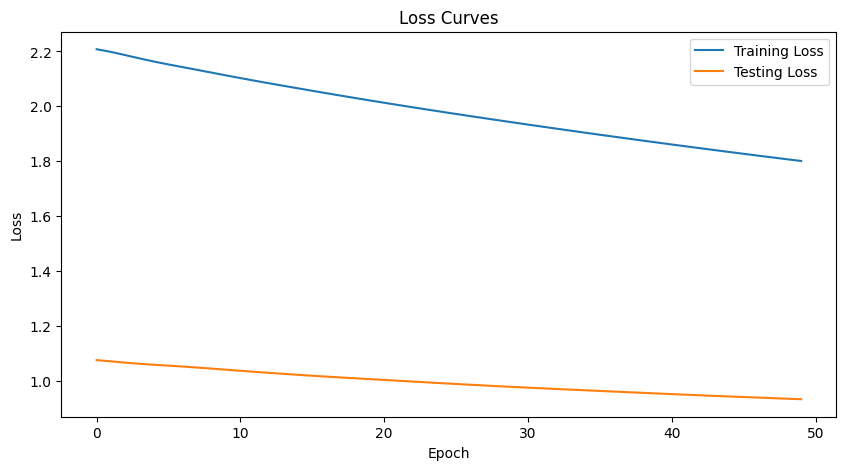

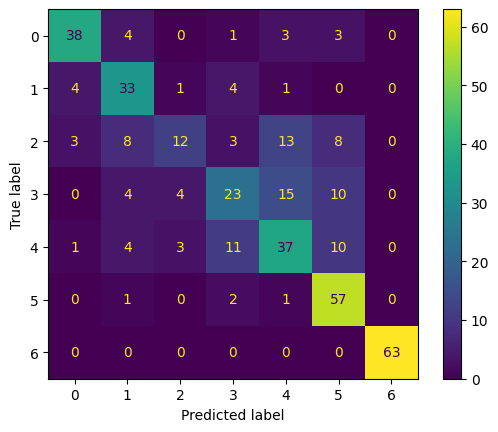

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.904 | Train Acc:  68.55% | Test NLL:  0.932 | Test Acc: 68.31%
Epoch 02 | Batch 000 | Train NLL:  0.903 | Train Acc:  68.55% | Test NLL:  0.931 | Test Acc: 68.31%
Epoch 03 | Batch 000 | Train NLL:  0.901 | Train Acc:  68.62% | Test NLL:  0.930 | Test Acc: 68.31%
Epoch 04 | Batch 000 | Train NLL:  0.899 | Train Acc:  68.68% | Test NLL:  0.929 | Test Acc: 68.31%
Epoch 05 | Batch 000 | Train NLL:  0.898 | Train Acc:  68.82% | Test NLL:  0.928 | Test Acc: 68.31%
Epoch 06 | Batch 000 | Train NLL:  0.896 | Train Acc:  68.82% | Test NLL:  0.927 | Test Acc: 68.31%
Epoch 07 | Batch 000 | Train NLL:  0.895 | Train Acc:  68.82% | Test NLL:  0.927 | Test Acc: 68.31%
Epoch 08 | Batch 000 | Train NLL:  0.893 | Train Acc:  68.68% | Test NLL:  0.926 | Test Acc: 68.57%
Epoch 09 | Batch 000 | Train NLL:  0.892 | Train Acc:  68.75% | Test NLL:  0.925 | Test Acc: 68.57%
Epoch 10 | Batch

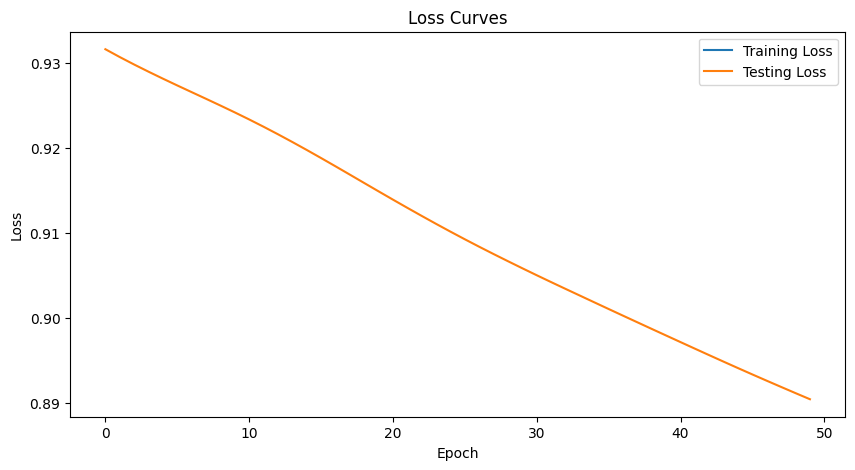

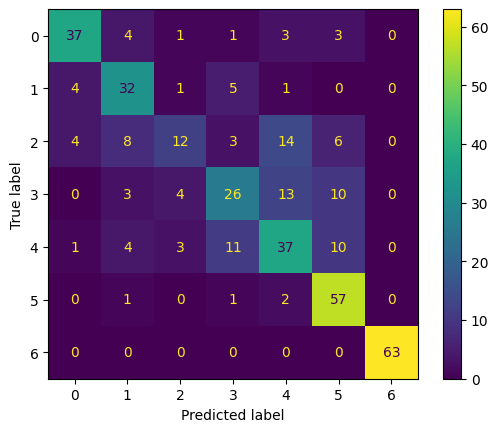

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.501 | Train Acc:  91.67% | Test NLL:  0.887 | Test Acc: 68.83%
Epoch 02 | Batch 003 | Train NLL:  0.474 | Train Acc:  91.67% | Test NLL:  0.883 | Test Acc: 69.35%
Epoch 03 | Batch 003 | Train NLL:  0.447 | Train Acc:  91.67% | Test NLL:  0.881 | Test Acc: 68.83%
Epoch 04 | Batch 003 | Train NLL:  0.429 | Train Acc:  91.67% | Test NLL:  0.877 | Test Acc: 69.09%
Epoch 05 | Batch 003 | Train NLL:  0.419 | Train Acc:  91.67% | Test NLL:  0.873 | Test Acc: 69.09%
Epoch 06 | Batch 003 | Train NLL:  0.409 | Train Acc:  91.67% | Test NLL:  0.871 | Test Acc: 69.61%
Epoch 07 | Batch 003 | Train NLL:  0.394 | Train Acc:  91.67% | Test NLL:  0.869 | Test Acc: 69.35%
Epoch 08 | Batch 003 | Train NLL:  0.379 | Train Acc:  94.44% | Test NLL:  0.867 | Test Acc: 69.87%
Epoch 09 | Batch 003 | Train NLL:  0.366 | Train Acc:  94.44% | Test NLL:  0.865 | Test Acc: 69.61%
Epoch 10 | Batch

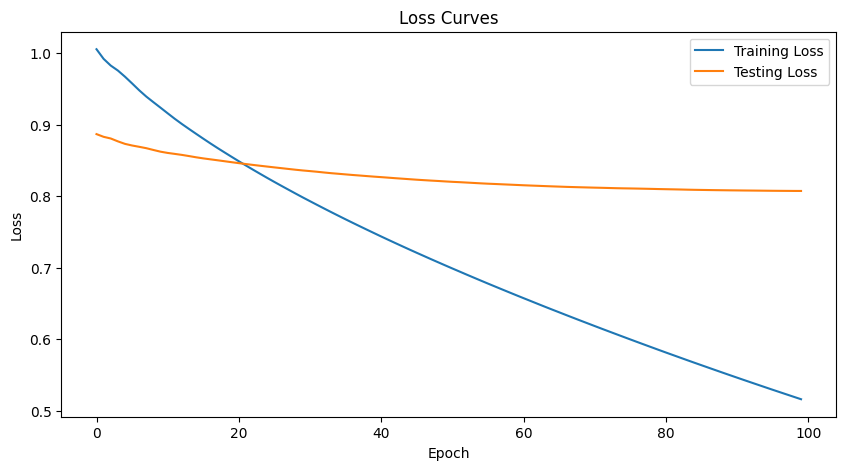

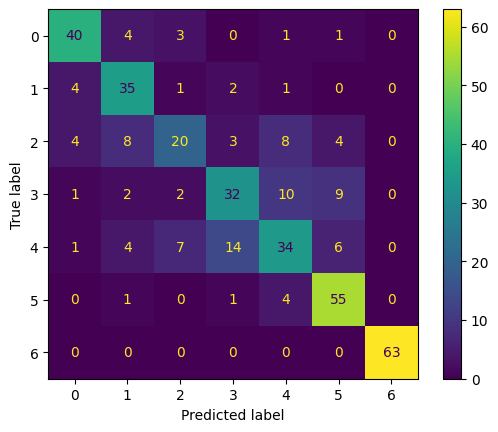

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.458 | Train Acc:  86.01% | Test NLL:  0.807 | Test Acc: 72.47%
Epoch 02 | Batch 001 | Train NLL:  0.457 | Train Acc:  86.19% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 03 | Batch 001 | Train NLL:  0.455 | Train Acc:  85.82% | Test NLL:  0.808 | Test Acc: 72.21%
Epoch 04 | Batch 001 | Train NLL:  0.452 | Train Acc:  86.38% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 05 | Batch 001 | Train NLL:  0.450 | Train Acc:  86.94% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 06 | Batch 001 | Train NLL:  0.448 | Train Acc:  87.13% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 07 | Batch 001 | Train NLL:  0.445 | Train Acc:  87.50% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 08 | Batch 001 | Train NLL:  0.443 | Train Acc:  87.69% | Test NLL:  0.808 | Test Acc: 72.47%
Epoch 09 | Batch 001 | Train NLL:  0.440 | Train Acc:  87.87% | Test NLL:  0.808 | Test Acc: 72.21%
Epoch 10 | Batc

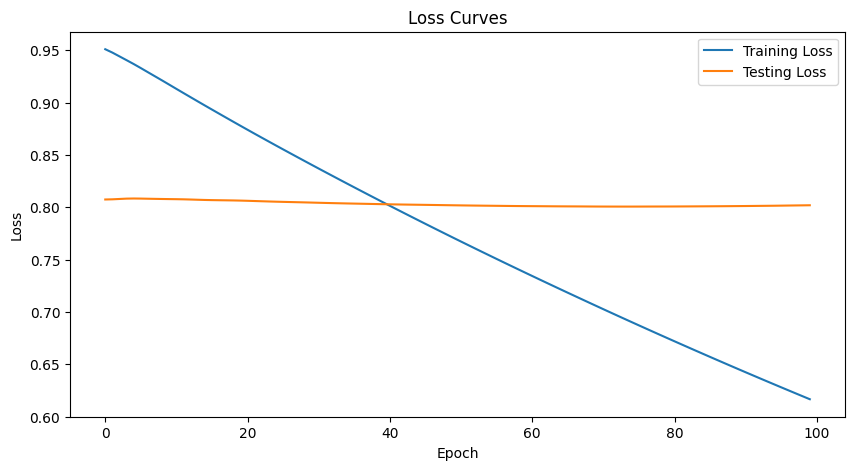

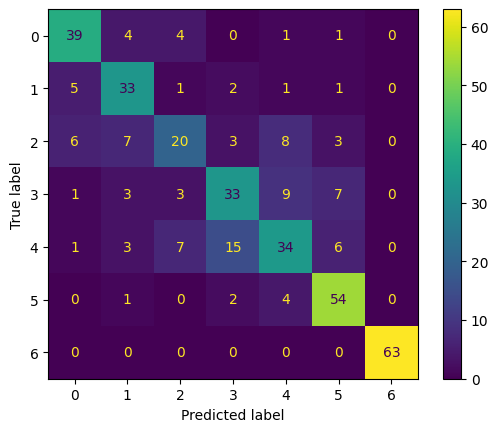

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.321 | Train Acc:  92.19% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 02 | Batch 000 | Train NLL:  0.320 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 03 | Batch 000 | Train NLL:  0.319 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 04 | Batch 000 | Train NLL:  0.318 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 05 | Batch 000 | Train NLL:  0.318 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 06 | Batch 000 | Train NLL:  0.317 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 07 | Batch 000 | Train NLL:  0.316 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 08 | Batch 000 | Train NLL:  0.316 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 09 | Batch 000 | Train NLL:  0.315 | Train Acc:  92.25% | Test NLL:  0.802 | Test Acc: 71.69%
Epoch 10 | Batc

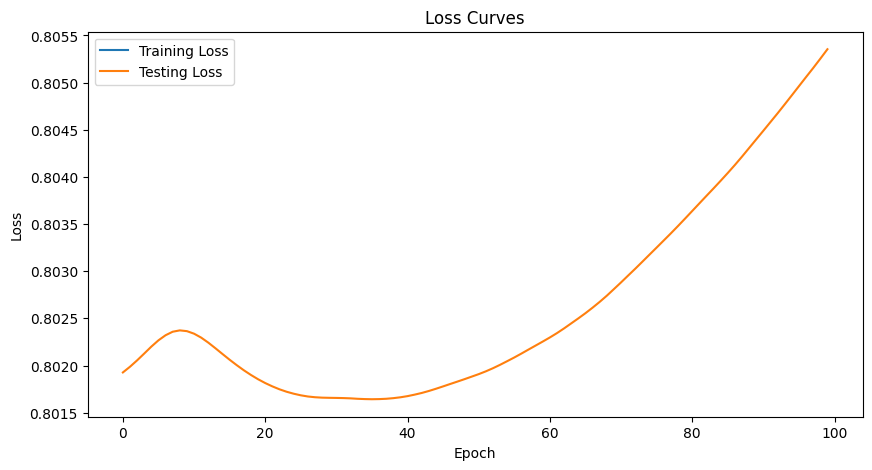

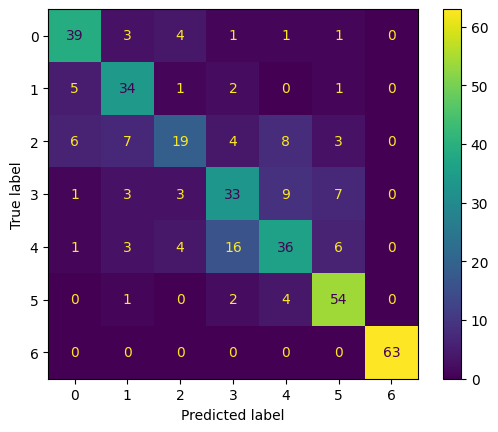

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.067 | Train Acc: 100.00% | Test NLL:  0.806 | Test Acc: 71.95%
Epoch 02 | Batch 003 | Train NLL:  0.062 | Train Acc: 100.00% | Test NLL:  0.807 | Test Acc: 72.21%
Epoch 03 | Batch 003 | Train NLL:  0.060 | Train Acc: 100.00% | Test NLL:  0.808 | Test Acc: 72.21%
Epoch 04 | Batch 003 | Train NLL:  0.060 | Train Acc: 100.00% | Test NLL:  0.808 | Test Acc: 71.95%
Epoch 05 | Batch 003 | Train NLL:  0.057 | Train Acc: 100.00% | Test NLL:  0.809 | Test Acc: 72.21%
Epoch 06 | Batch 003 | Train NLL:  0.054 | Train Acc: 100.00% | Test NLL:  0.810 | Test Acc: 71.95%
Epoch 07 | Batch 003 | Train NLL:  0.052 | Train Acc: 100.00% | Test NLL:  0.811 | Test Acc: 72.21%
Epoch 08 | Batch 003 | Train NLL:  0.051 | Train Acc: 100.00% | Test NLL:  0.812 | Test Acc: 71.95%
Epoch 09 | Batch 003 | Train NLL:  0.049 | Train Acc: 100.00% | Test NLL:  0.813 | Test Acc: 72.21%
Epoch 10 | Batch

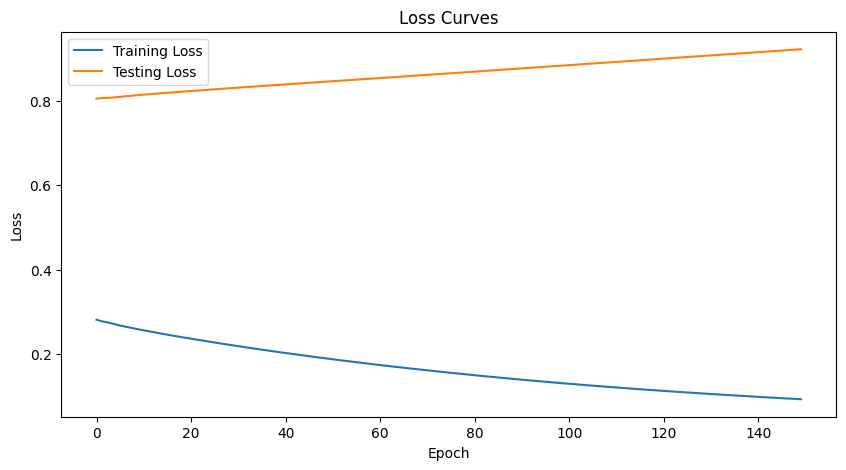

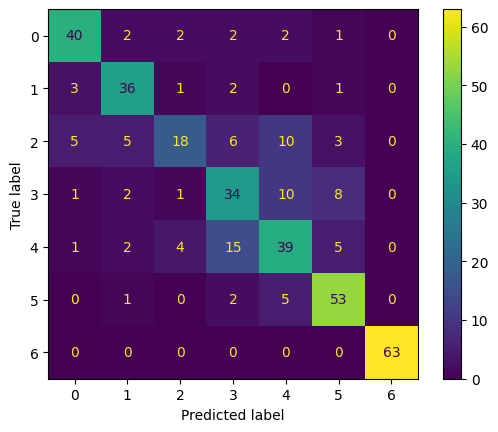

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.078 | Train Acc:  99.63% | Test NLL:  0.924 | Test Acc: 73.77%
Epoch 02 | Batch 001 | Train NLL:  0.078 | Train Acc:  99.63% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 03 | Batch 001 | Train NLL:  0.077 | Train Acc:  99.63% | Test NLL:  0.924 | Test Acc: 73.77%
Epoch 04 | Batch 001 | Train NLL:  0.077 | Train Acc:  99.63% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 05 | Batch 001 | Train NLL:  0.076 | Train Acc:  99.81% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 06 | Batch 001 | Train NLL:  0.076 | Train Acc:  99.81% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 07 | Batch 001 | Train NLL:  0.075 | Train Acc:  99.81% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 08 | Batch 001 | Train NLL:  0.075 | Train Acc:  99.81% | Test NLL:  0.924 | Test Acc: 73.51%
Epoch 09 | Batch 001 | Train NLL:  0.074 | Train Acc:  99.81% | Test NLL:  0.925 | Test Acc: 73.77%
Epoch 10 | Batc

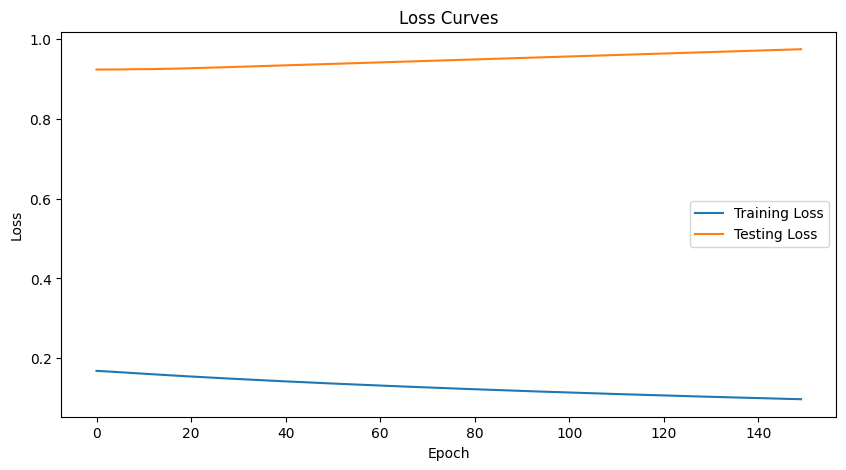

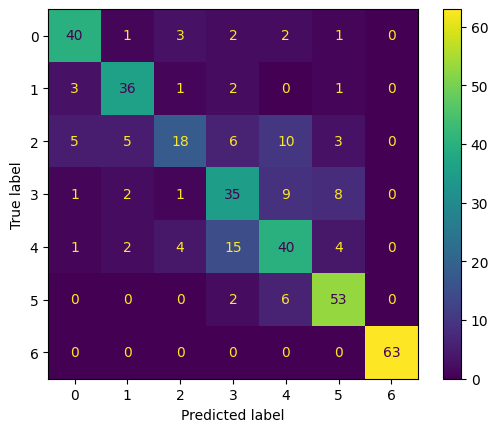

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.975 | Test Acc: 74.03%
Epoch 02 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.975 | Test Acc: 74.03%
Epoch 03 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.975 | Test Acc: 74.03%
Epoch 04 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.975 | Test Acc: 74.03%
Epoch 05 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.976 | Test Acc: 74.29%
Epoch 06 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.976 | Test Acc: 74.55%
Epoch 07 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.976 | Test Acc: 74.55%
Epoch 08 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.976 | Test Acc: 74.55%
Epoch 09 | Batch 000 | Train NLL:  0.051 | Train Acc:  99.87% | Test NLL:  0.977 | Test Acc: 74.81%
Epoch 10 | Batc

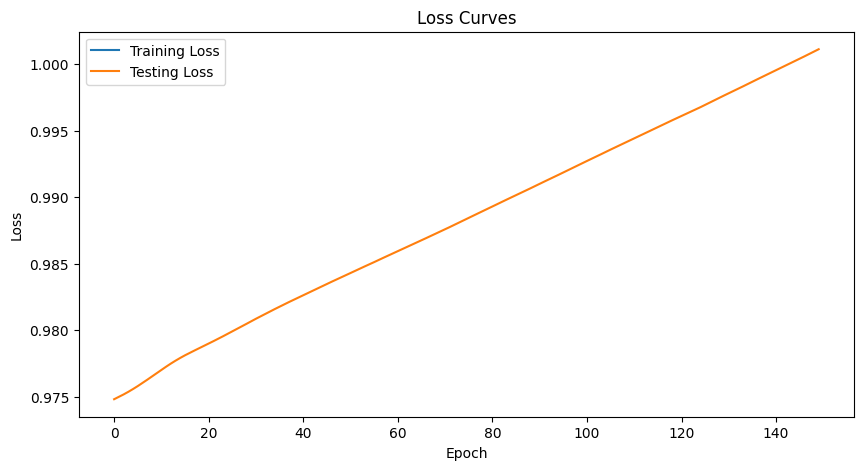

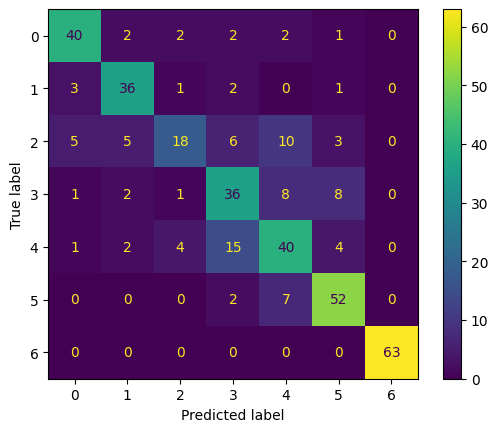

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Batch 003 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.003 | Test Acc: 74.03%
Epoch 02 | Batch 003 | Train NLL:  0.012 | Train Acc: 100.00% | Test NLL:  1.006 | Test Acc: 74.29%
Epoch 03 | Batch 003 | Train NLL:  0.011 | Train Acc: 100.00% | Test NLL:  1.007 | Test Acc: 74.55%
Epoch 04 | Batch 003 | Train NLL:  0.011 | Train Acc: 100.00% | Test NLL:  1.006 | Test Acc: 74.03%
Epoch 05 | Batch 003 | Train NLL:  0.011 | Train Acc: 100.00% | Test NLL:  1.007 | Test Acc: 74.03%
Epoch 06 | Batch 003 | Train NLL:  0.011 | Train Acc: 100.00% | Test NLL:  1.009 | Test Acc: 74.29%
Epoch 07 | Batch 003 | Train NLL:  0.010 | Train Acc: 100.00% | Test NLL:  1.012 | Test Acc: 74.29%
Epoch 08 | Batch 003 | Train NLL:  0.010 | Train Acc: 100.00% | Test NLL:  1.014 | Test Acc: 74.29%
Epoch 09 | Batch 003 | Train NLL:  0.010 | Train Acc: 100.00% | Test NLL:  1.014 | Test Acc: 74.03%
Epoch 10 | Batch

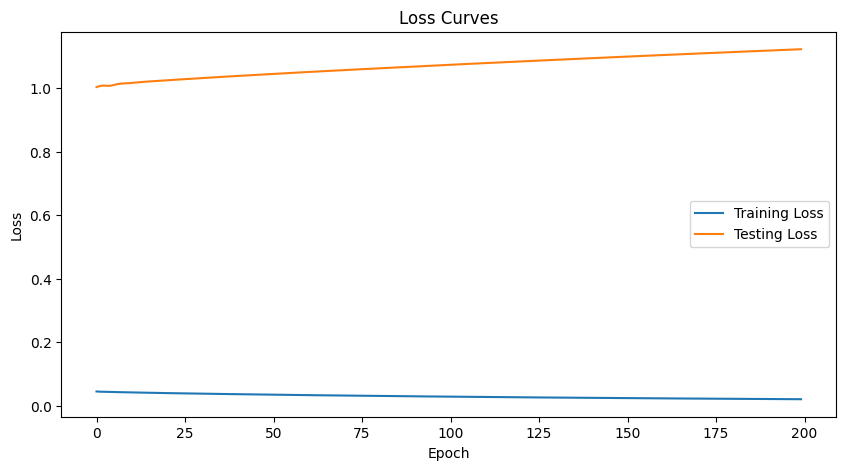

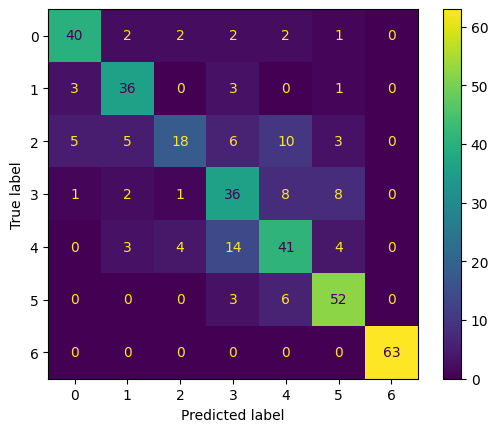

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.122 | Test Acc: 74.29%
Epoch 02 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.122 | Test Acc: 74.29%
Epoch 03 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 04 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 05 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 06 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 07 | Batch 001 | Train NLL:  0.018 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 08 | Batch 001 | Train NLL:  0.017 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 09 | Batch 001 | Train NLL:  0.017 | Train Acc: 100.00% | Test NLL:  1.121 | Test Acc: 74.29%
Epoch 10 | Batc

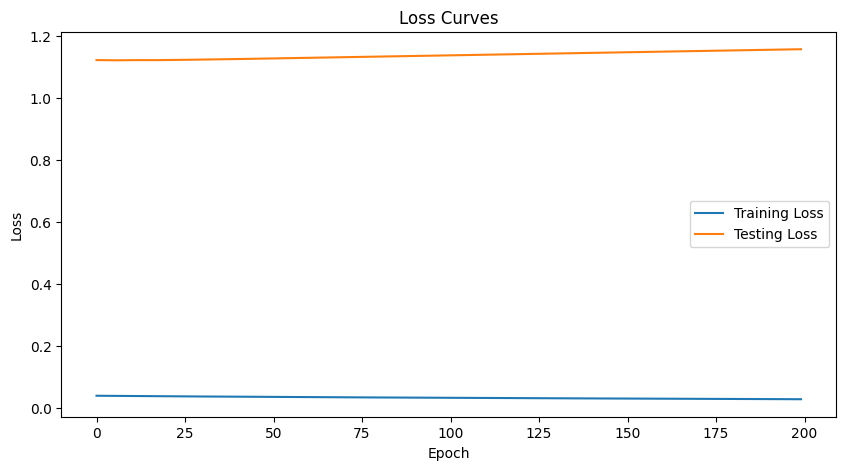

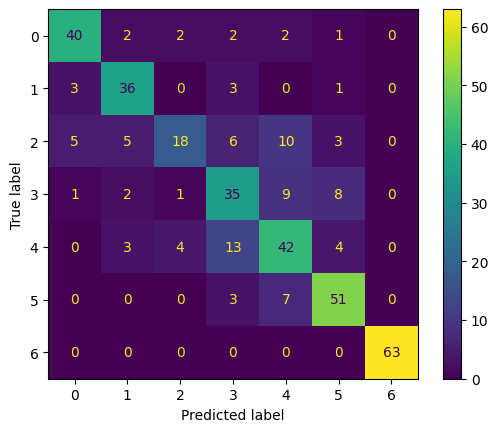

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.157 | Test Acc: 74.03%
Epoch 02 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.157 | Test Acc: 74.03%
Epoch 03 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.157 | Test Acc: 74.03%
Epoch 04 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.157 | Test Acc: 74.03%
Epoch 05 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.157 | Test Acc: 74.03%
Epoch 06 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.158 | Test Acc: 74.03%
Epoch 07 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.158 | Test Acc: 74.03%
Epoch 08 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.158 | Test Acc: 74.03%
Epoch 09 | Batch 000 | Train NLL:  0.014 | Train Acc: 100.00% | Test NLL:  1.158 | Test Acc: 74.03%
Epoch 10 | Batc

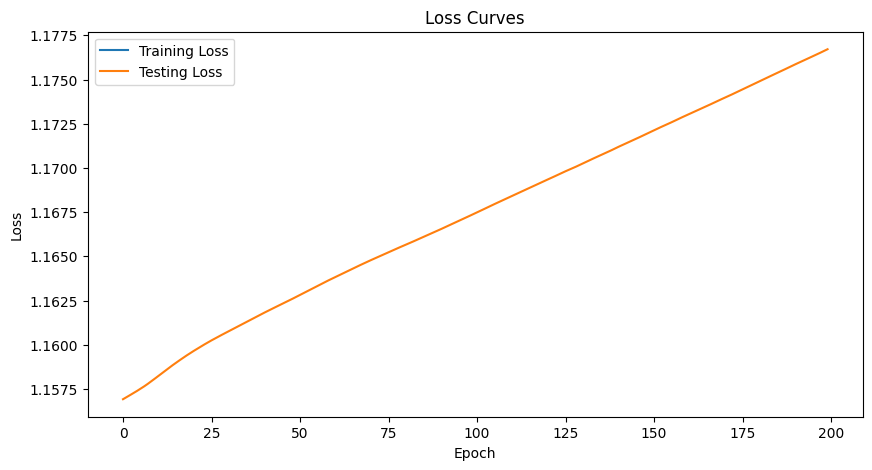

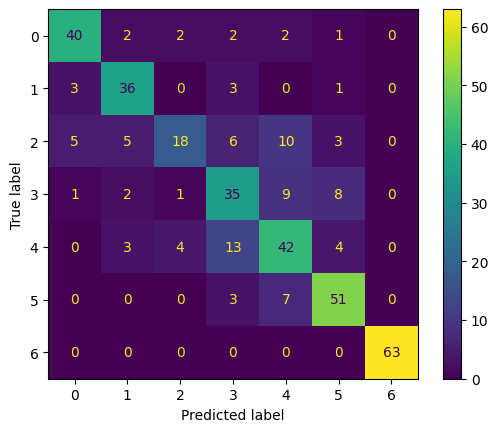

**************************************************



In [31]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 64

num_classes = 7

optimize_args = {"mode": "momentum", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 32), ReLU(), Linear(32, 7)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO,
            BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

EPOCH : 150 & BATCH SIZE : 100

Epoch 01 | Batch 116 | Train NLL:  0.543 | Train Acc:  68.29% | Test NLL:  0.461 | Test Acc: 77.74%
Epoch 02 | Batch 116 | Train NLL:  0.499 | Train Acc:  70.73% | Test NLL:  0.430 | Test Acc: 79.22%
Epoch 03 | Batch 116 | Train NLL:  0.474 | Train Acc:  75.61% | Test NLL:  0.414 | Test Acc: 79.70%
Epoch 04 | Batch 116 | Train NLL:  0.454 | Train Acc:  78.05% | Test NLL:  0.403 | Test Acc: 80.87%
Epoch 05 | Batch 116 | Train NLL:  0.439 | Train Acc:  78.05% | Test NLL:  0.393 | Test Acc: 81.69%
Epoch 06 | Batch 116 | Train NLL:  0.425 | Train Acc:  78.05% | Test NLL:  0.384 | Test Acc: 82.38%
Epoch 07 | Batch 116 | Train NLL:  0.412 | Train Acc:  80.49% | Test NLL:  0.376 | Test Acc: 82.82%
Epoch 08 | Batch 116 | Train NLL:  0.399 | Train Acc:  80.49% | Test NLL:  0.369 | Test Acc: 83.13%
Epoch 09 | Batch 116 | Train NLL:  0.387 | Train Acc:  82.93% | Test NLL:  0.362 | Test Acc: 83.58%
Epoch 10 | Batch 116 | Train NLL:  0.374 | Train Acc:  82.93% | Test

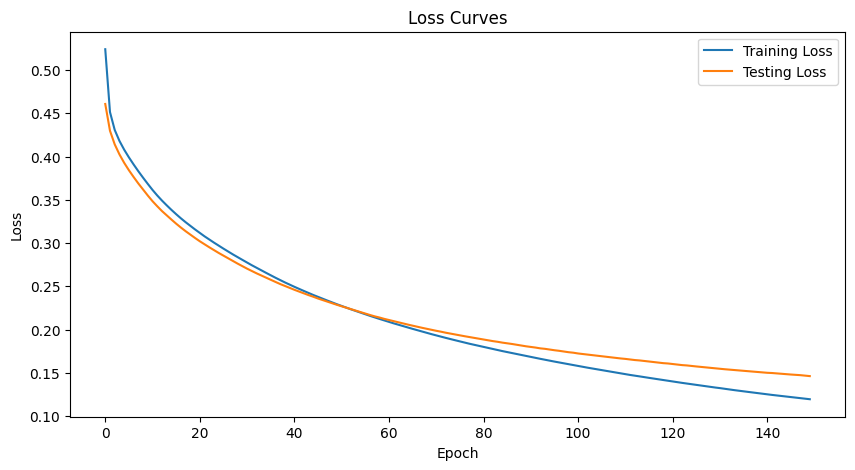

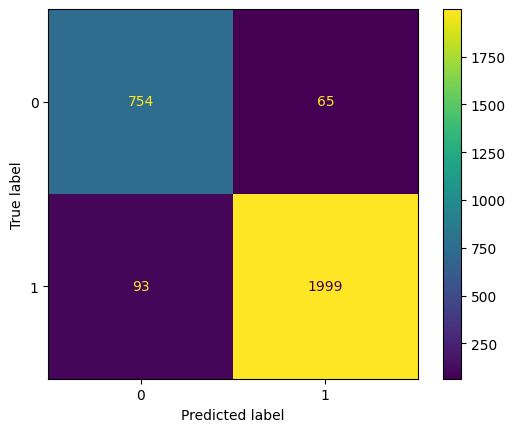

**************************************************



In [32]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 128

optimize_args = {"mode": "momentum", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 2)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses)

EPOCH : 150 & BATCH SIZE : 100

Epoch 01 | Batch 116 | Train NLL:  0.617 | Train Acc:  73.17% | Test NLL:  0.565 | Test Acc: 71.87%
Epoch 02 | Batch 116 | Train NLL:  0.607 | Train Acc:  73.17% | Test NLL:  0.548 | Test Acc: 71.90%
Epoch 03 | Batch 116 | Train NLL:  0.599 | Train Acc:  73.17% | Test NLL:  0.534 | Test Acc: 72.07%
Epoch 04 | Batch 116 | Train NLL:  0.591 | Train Acc:  73.17% | Test NLL:  0.523 | Test Acc: 72.38%
Epoch 05 | Batch 116 | Train NLL:  0.584 | Train Acc:  73.17% | Test NLL:  0.513 | Test Acc: 72.90%
Epoch 06 | Batch 116 | Train NLL:  0.577 | Train Acc:  70.73% | Test NLL:  0.504 | Test Acc: 73.58%
Epoch 07 | Batch 116 | Train NLL:  0.571 | Train Acc:  68.29% | Test NLL:  0.496 | Test Acc: 74.48%
Epoch 08 | Batch 116 | Train NLL:  0.565 | Train Acc:  65.85% | Test NLL:  0.489 | Test Acc: 74.96%
Epoch 09 | Batch 116 | Train NLL:  0.558 | Train Acc:  63.41% | Test NLL:  0.483 | Test Acc: 75.68%
Epoch 10 | Batch 116 | Train NLL:  0.552 | Train Acc:  68.29% | Test

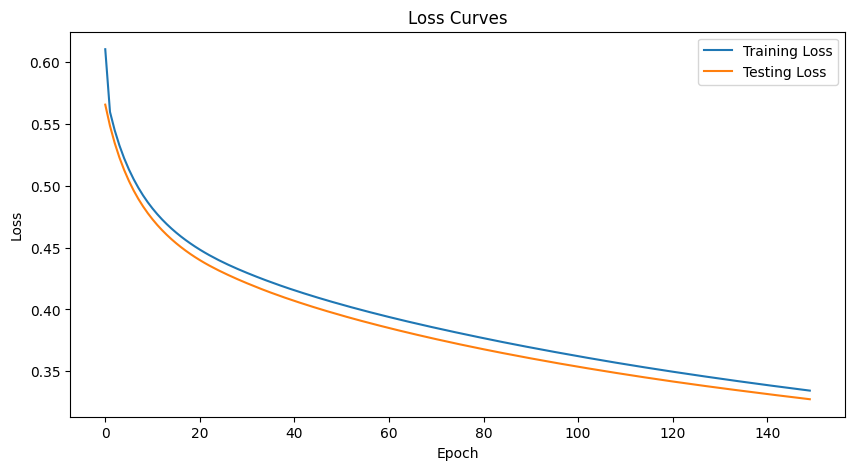

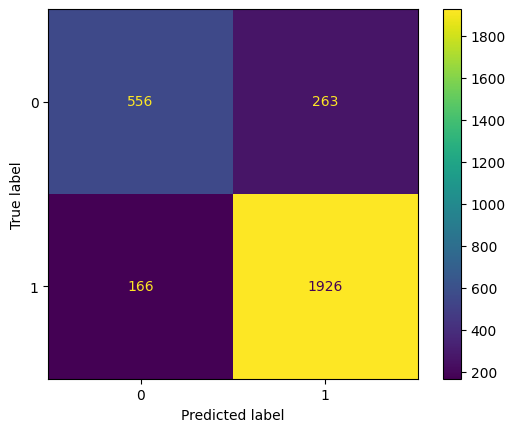

**************************************************



In [33]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 128

optimize_args = {"mode": "SGD", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 2)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses)

EPOCH : 150 & BATCH SIZE : 100

Epoch 01 | Batch 116 | Train NLL:  0.543 | Train Acc:  73.17% | Test NLL:  0.489 | Test Acc: 72.21%
Epoch 02 | Batch 116 | Train NLL:  0.468 | Train Acc:  73.17% | Test NLL:  0.441 | Test Acc: 78.15%
Epoch 03 | Batch 116 | Train NLL:  0.414 | Train Acc:  80.49% | Test NLL:  0.415 | Test Acc: 79.08%
Epoch 04 | Batch 116 | Train NLL:  0.387 | Train Acc:  82.93% | Test NLL:  0.401 | Test Acc: 79.53%
Epoch 05 | Batch 116 | Train NLL:  0.374 | Train Acc:  82.93% | Test NLL:  0.389 | Test Acc: 80.38%
Epoch 06 | Batch 116 | Train NLL:  0.366 | Train Acc:  82.93% | Test NLL:  0.379 | Test Acc: 81.14%
Epoch 07 | Batch 116 | Train NLL:  0.360 | Train Acc:  82.93% | Test NLL:  0.368 | Test Acc: 82.21%
Epoch 08 | Batch 116 | Train NLL:  0.355 | Train Acc:  82.93% | Test NLL:  0.357 | Test Acc: 83.27%
Epoch 09 | Batch 116 | Train NLL:  0.356 | Train Acc:  80.49% | Test NLL:  0.346 | Test Acc: 83.82%
Epoch 10 | Batch 116 | Train NLL:  0.345 | Train Acc:  80.49% | Test

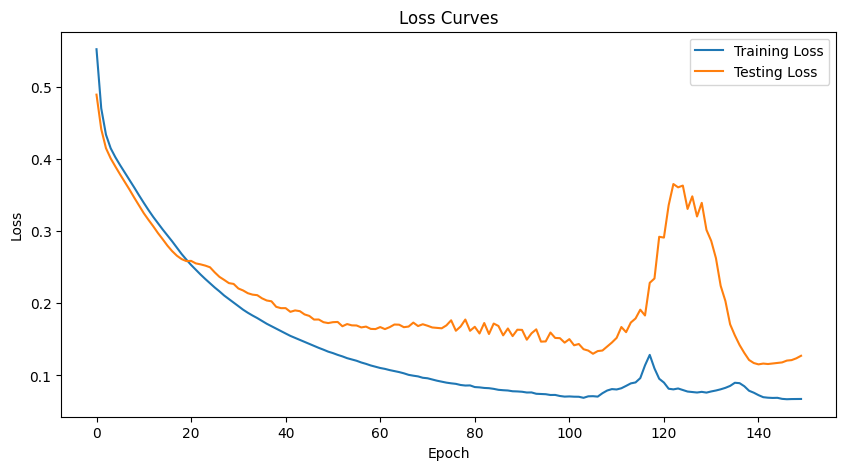

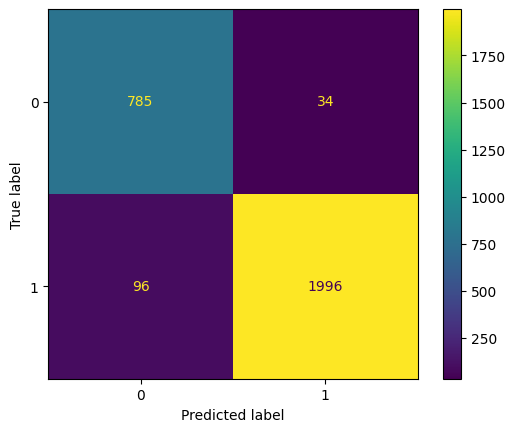

**************************************************



In [34]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 64

optimize_args = {"mode": "momentum", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 10), ReLU(), Linear(10, 2)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses)

EPOCH : 150 & BATCH SIZE : 100

Epoch 01 | Batch 116 | Train NLL:  0.587 | Train Acc:  73.17% | Test NLL:  0.566 | Test Acc: 71.87%
Epoch 02 | Batch 116 | Train NLL:  0.578 | Train Acc:  73.17% | Test NLL:  0.551 | Test Acc: 71.87%
Epoch 03 | Batch 116 | Train NLL:  0.569 | Train Acc:  73.17% | Test NLL:  0.536 | Test Acc: 71.87%
Epoch 04 | Batch 116 | Train NLL:  0.562 | Train Acc:  73.17% | Test NLL:  0.522 | Test Acc: 71.93%
Epoch 05 | Batch 116 | Train NLL:  0.559 | Train Acc:  73.17% | Test NLL:  0.508 | Test Acc: 72.86%
Epoch 06 | Batch 116 | Train NLL:  0.554 | Train Acc:  68.29% | Test NLL:  0.494 | Test Acc: 73.69%
Epoch 07 | Batch 116 | Train NLL:  0.548 | Train Acc:  68.29% | Test NLL:  0.483 | Test Acc: 74.85%
Epoch 08 | Batch 116 | Train NLL:  0.542 | Train Acc:  70.73% | Test NLL:  0.474 | Test Acc: 75.85%
Epoch 09 | Batch 116 | Train NLL:  0.535 | Train Acc:  70.73% | Test NLL:  0.466 | Test Acc: 76.92%
Epoch 10 | Batch 116 | Train NLL:  0.528 | Train Acc:  70.73% | Test

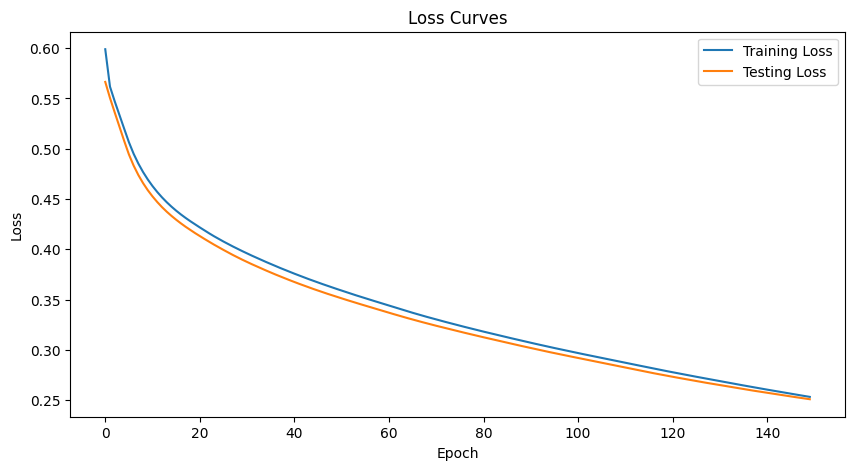

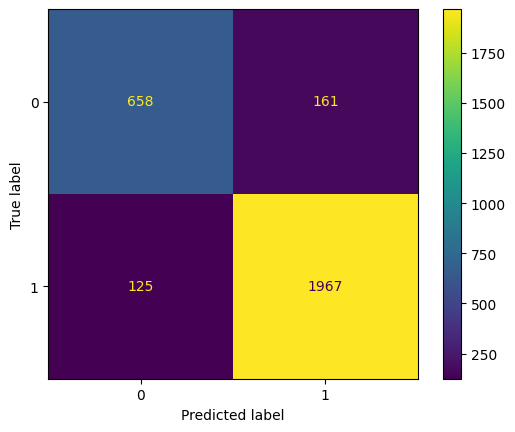

**************************************************



In [35]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 64

optimize_args = {"mode": "SGD", "lr": 0.005}

net = FeedForwardNetwork([Linear(X_train.shape[1], HIDDEN_UNITS), ReLU(), Linear(HIDDEN_UNITS, 10), ReLU(), Linear(10, 2)])
cost_function = CrossEntropy()

train_losses = []
test_losses = []

train_test_MLP(net, cost_function, optimize_args, X_train, T_train, X_test, T_test, train_losses, test_losses)

SimplePytorchMLP(
  (fc1): Linear(in_features=2621, out_features=128, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=128, out_features=7, bias=True)
  (activation2): ReLU()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.905 | Train Acc: 28.45% | Test NLL: 1.831 | Test Acc: 39.22%
Epoch 02 | Train NLL: 1.722 | Train Acc: 49.80% | Test NLL: 1.680 | Test Acc: 42.34%
Epoch 03 | Train NLL: 1.508 | Train Acc: 53.19% | Test NLL: 1.543 | Test Acc: 43.64%
Epoch 04 | Train NLL: 1.285 | Train Acc: 58.07% | Test NLL: 1.414 | Test Acc: 48.05%
Epoch 05 | Train NLL: 1.049 | Train Acc: 71.61% | Test NLL: 1.337 | Test Acc: 50.13%
Epoch 06 | Train NLL: 0.860 | Train Acc: 75.46% | Test NLL: 1.292 | Test Acc: 52.73%
Epoch 07 | Train NLL: 0.669 | Train Acc: 78.84% | Test NLL: 1.282 | Test Acc: 51.95%
Epoch 08 | Train NLL: 0.640 | Train Acc: 79.95% | Test NLL: 1.285 | Test Acc: 53.77%
Epoch 09 | Train NLL: 0.561 | Train Acc: 81.71% | Test NLL: 1.275 | Test Acc: 53.25%
Epoch 10 | Tr

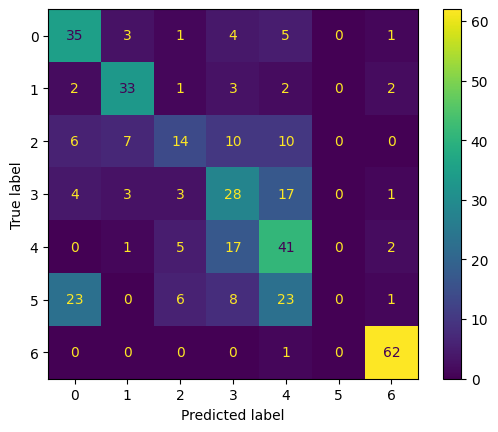

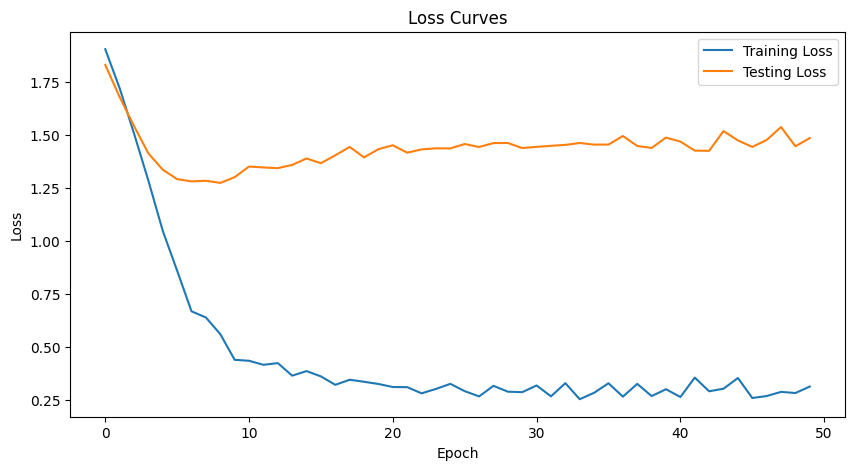

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.285 | Train Acc: 86.33% | Test NLL: 1.539 | Test Acc: 54.81%
Epoch 02 | Train NLL: 0.289 | Train Acc: 86.33% | Test NLL: 1.546 | Test Acc: 53.77%
Epoch 03 | Train NLL: 0.294 | Train Acc: 86.33% | Test NLL: 1.494 | Test Acc: 55.06%
Epoch 04 | Train NLL: 0.292 | Train Acc: 86.39% | Test NLL: 1.471 | Test Acc: 55.06%
Epoch 05 | Train NLL: 0.281 | Train Acc: 86.33% | Test NLL: 1.462 | Test Acc: 54.81%
Epoch 06 | Train NLL: 0.274 | Train Acc: 86.39% | Test NLL: 1.467 | Test Acc: 55.32%
Epoch 07 | Train NLL: 0.286 | Train Acc: 86.39% | Test NLL: 1.497 | Test Acc: 55.06%
Epoch 08 | Train NLL: 0.283 | Train Acc: 86.39% | Test NLL: 1.521 | Test Acc: 55.06%
Epoch 09 | Train NLL: 0.282 | Train Acc: 86.39% | Test NLL: 1.493 | Test Acc: 55.58%
Epoch 10 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.466 | Test Acc: 55.32%
Epoch 11 | Train NLL: 0.286 | Train Acc: 86.39% | Test NLL: 1.468 

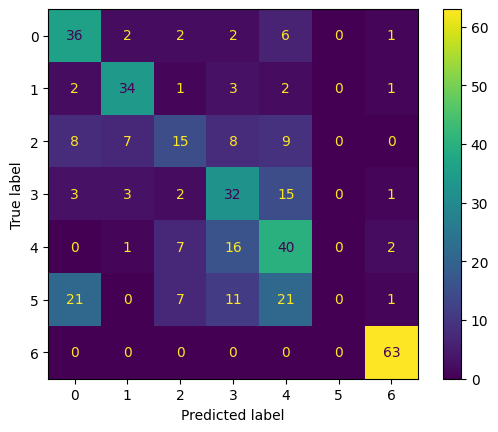

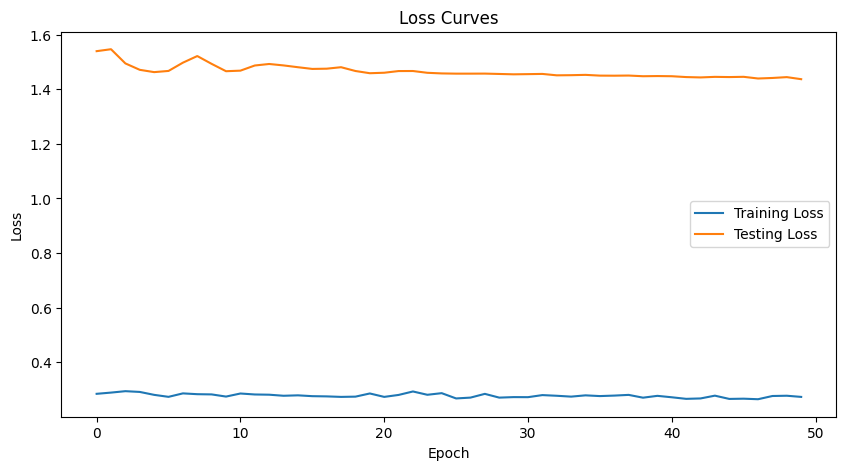

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.436 | Test Acc: 57.14%
Epoch 02 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.439 | Test Acc: 57.14%
Epoch 03 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.442 | Test Acc: 57.14%
Epoch 04 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.441 | Test Acc: 57.14%
Epoch 05 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.439 | Test Acc: 57.14%
Epoch 06 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.440 | Test Acc: 57.14%
Epoch 07 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.442 | Test Acc: 57.14%
Epoch 08 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.440 | Test Acc: 57.14%
Epoch 09 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.438 | Test Acc: 57.14%
Epoch 10 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.439 | Test Acc: 57.14%
Epoch 11 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.438 

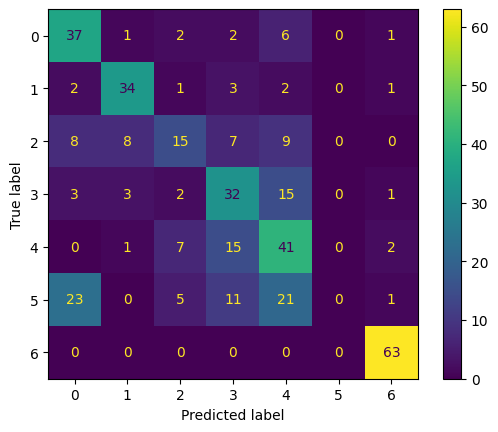

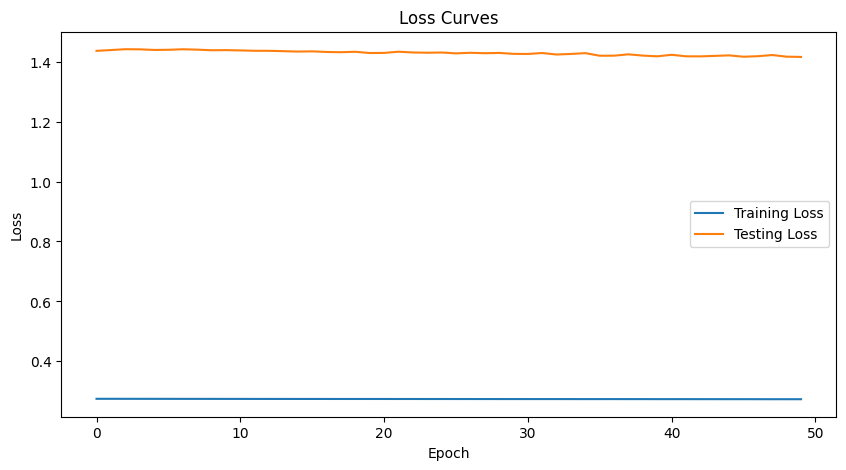

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.239 | Train Acc: 86.39% | Test NLL: 1.421 | Test Acc: 57.66%
Epoch 02 | Train NLL: 0.251 | Train Acc: 86.39% | Test NLL: 1.391 | Test Acc: 57.40%
Epoch 03 | Train NLL: 0.276 | Train Acc: 86.39% | Test NLL: 1.411 | Test Acc: 57.92%
Epoch 04 | Train NLL: 0.288 | Train Acc: 86.39% | Test NLL: 1.391 | Test Acc: 58.18%
Epoch 05 | Train NLL: 0.326 | Train Acc: 86.39% | Test NLL: 1.398 | Test Acc: 57.92%
Epoch 06 | Train NLL: 0.214 | Train Acc: 86.39% | Test NLL: 1.411 | Test Acc: 56.88%
Epoch 07 | Train NLL: 0.277 | Train Acc: 86.39% | Test NLL: 1.416 | Test Acc: 56.88%
Epoch 08 | Train NLL: 0.326 | Train Acc: 86.39% | Test NLL: 1.415 | Test Acc: 57.14%
Epoch 09 | Train NLL: 0.301 | Train Acc: 86.39% | Test NLL: 1.423 | Test Acc: 57.66%
Epoch 10 | Train NLL: 0.275 | Train Acc: 86.39% | Test NLL: 1.401 | Test Acc: 56.88%
Epoch 11 | Train NLL: 0.252 | Train Acc: 86.39% | Test NLL: 1.417 

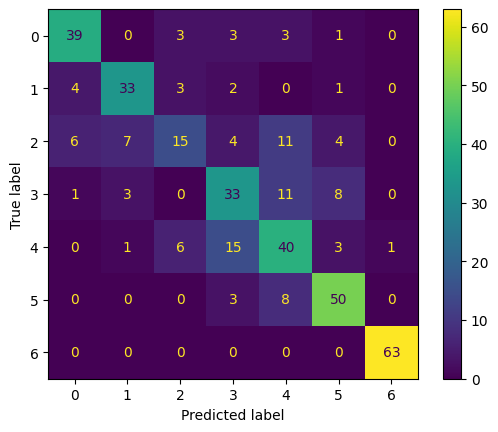

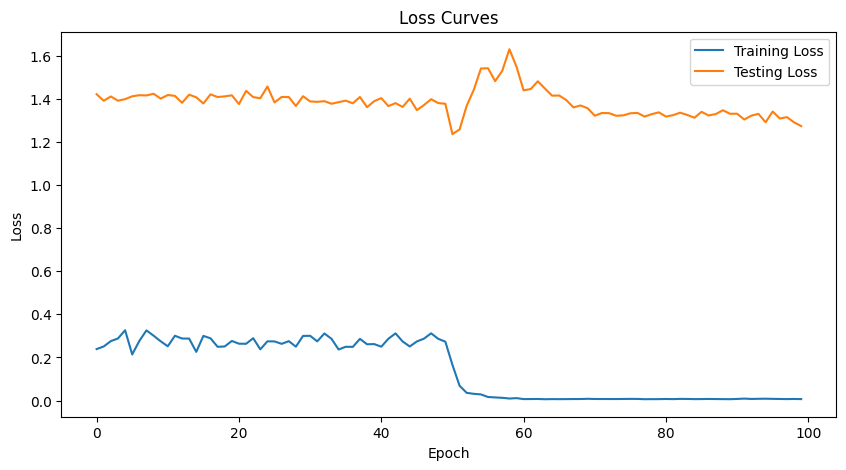

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.007 | Train Acc: 100.00% | Test NLL: 1.300 | Test Acc: 70.91%
Epoch 02 | Train NLL: 0.007 | Train Acc: 100.00% | Test NLL: 1.297 | Test Acc: 71.69%
Epoch 03 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.282 | Test Acc: 71.43%
Epoch 04 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.272 | Test Acc: 70.65%
Epoch 05 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.272 | Test Acc: 71.69%
Epoch 06 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.283 | Test Acc: 71.17%
Epoch 07 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.284 | Test Acc: 71.95%
Epoch 08 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.281 | Test Acc: 71.69%
Epoch 09 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.280 | Test Acc: 71.95%
Epoch 10 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.282 | Test Acc: 71.69%
Epoch 11 | Train NLL: 0.005 | Train Acc: 100.00% | Test

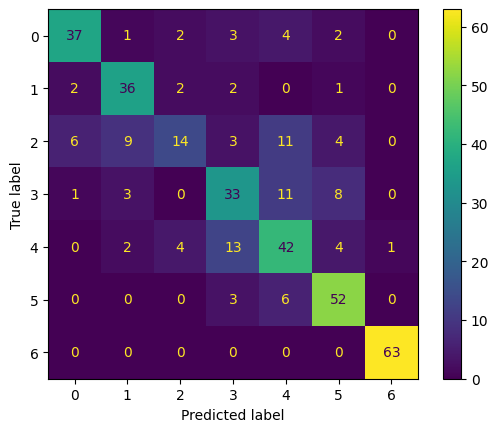

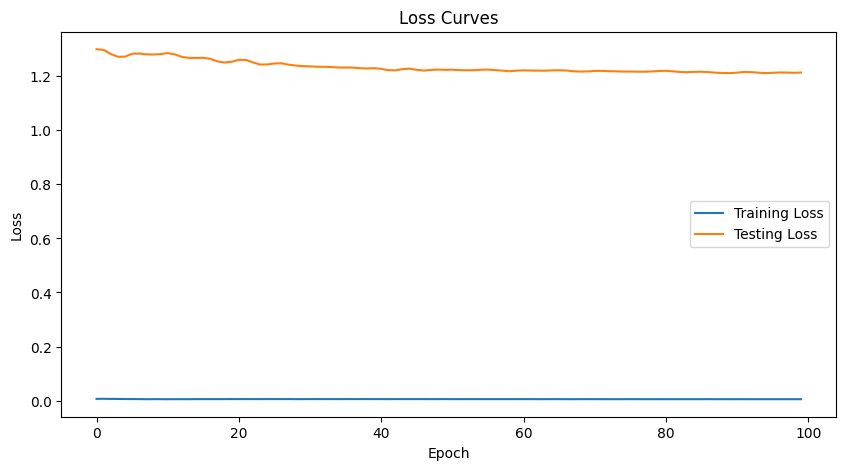

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.213 | Test Acc: 71.95%
Epoch 02 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.211 | Test Acc: 71.95%
Epoch 03 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.210 | Test Acc: 72.21%
Epoch 04 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.210 | Test Acc: 72.21%
Epoch 05 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.211 | Test Acc: 72.21%
Epoch 06 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.212 | Test Acc: 72.21%
Epoch 07 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.213 | Test Acc: 72.21%
Epoch 08 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.212 | Test Acc: 72.21%
Epoch 09 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.213 | Test Acc: 72.21%
Epoch 10 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.213 | Test Acc: 72.21%
Epoch 11 | Train NLL: 0.005 | Train Acc: 100.00% | Test

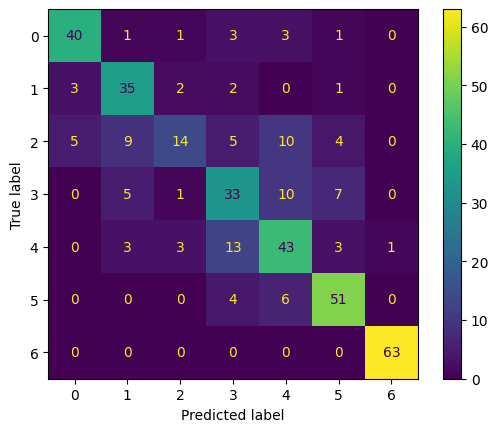

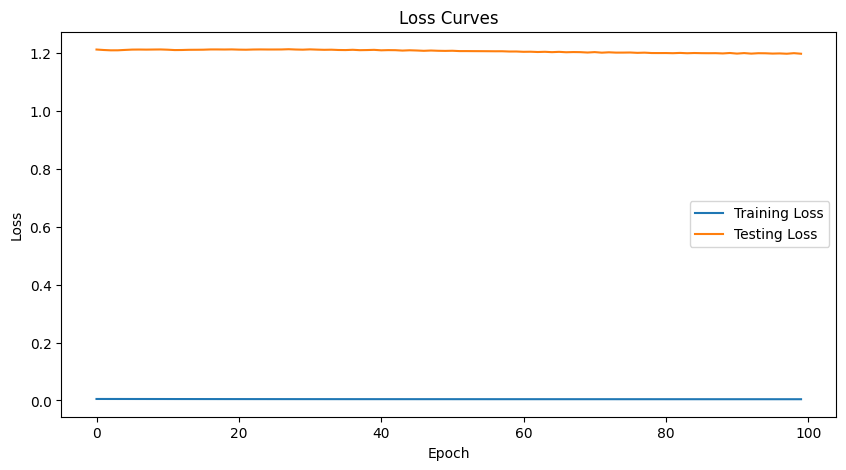

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.198 | Test Acc: 72.21%
Epoch 02 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.210 | Test Acc: 73.25%
Epoch 03 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.180 | Test Acc: 71.17%
Epoch 04 | Train NLL: 0.007 | Train Acc: 100.00% | Test NLL: 1.202 | Test Acc: 72.47%
Epoch 05 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.198 | Test Acc: 72.21%
Epoch 06 | Train NLL: 0.007 | Train Acc: 100.00% | Test NLL: 1.237 | Test Acc: 71.95%
Epoch 07 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.218 | Test Acc: 72.47%
Epoch 08 | Train NLL: 0.007 | Train Acc: 100.00% | Test NLL: 1.264 | Test Acc: 72.73%
Epoch 09 | Train NLL: 0.006 | Train Acc: 100.00% | Test NLL: 1.248 | Test Acc: 72.99%
Epoch 10 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.233 | Test Acc: 72.99%
Epoch 11 | Train NLL: 0.005 | Train Acc: 100.00% | Test 

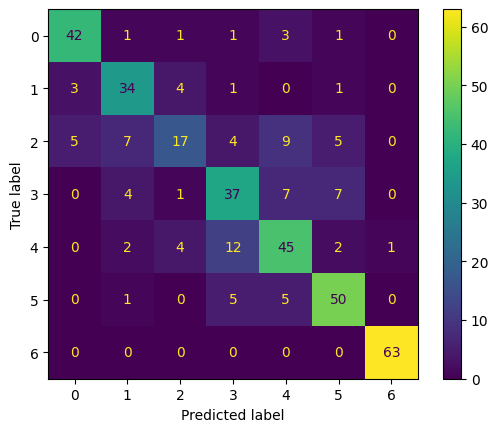

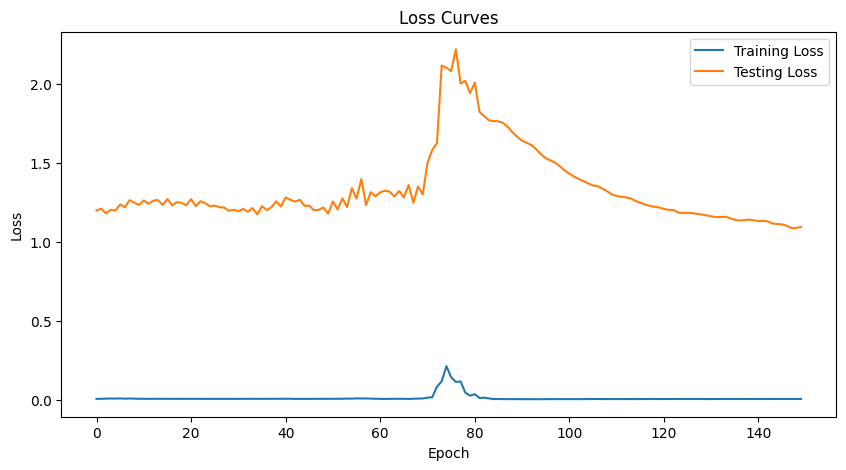

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.094 | Test Acc: 74.81%
Epoch 02 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.093 | Test Acc: 74.55%
Epoch 03 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.094 | Test Acc: 74.81%
Epoch 04 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.096 | Test Acc: 74.81%
Epoch 05 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.099 | Test Acc: 74.81%
Epoch 06 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.101 | Test Acc: 75.06%
Epoch 07 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.102 | Test Acc: 74.81%
Epoch 08 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.100 | Test Acc: 74.81%
Epoch 09 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.098 | Test Acc: 74.81%
Epoch 10 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.096 | Test Acc: 74.55%
Epoch 11 | Train NLL: 0.003 | Train Acc: 100.00% | Test

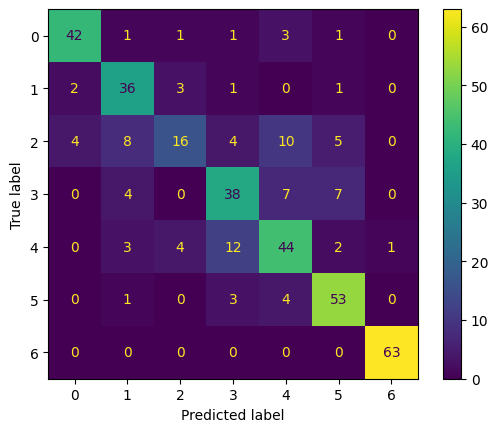

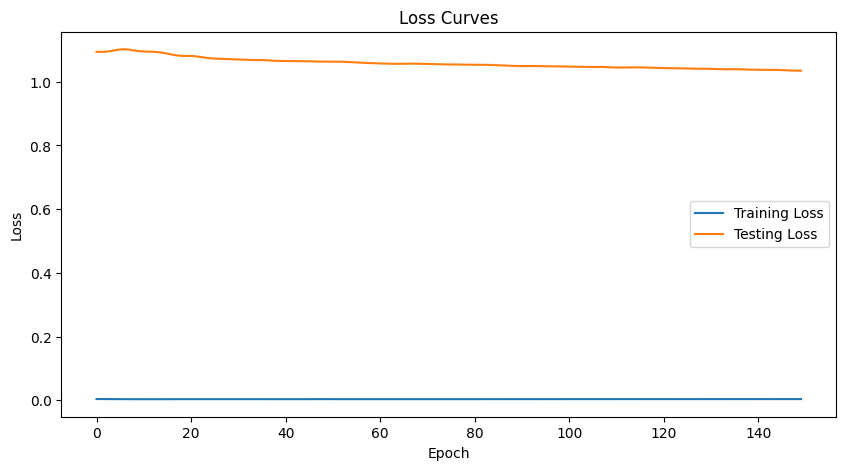

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 02 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 03 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 04 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 05 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 06 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 07 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.84%
Epoch 08 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.034 | Test Acc: 75.84%
Epoch 09 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.034 | Test Acc: 75.84%
Epoch 10 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.034 | Test Acc: 75.84%
Epoch 11 | Train NLL: 0.004 | Train Acc: 100.00% | Test

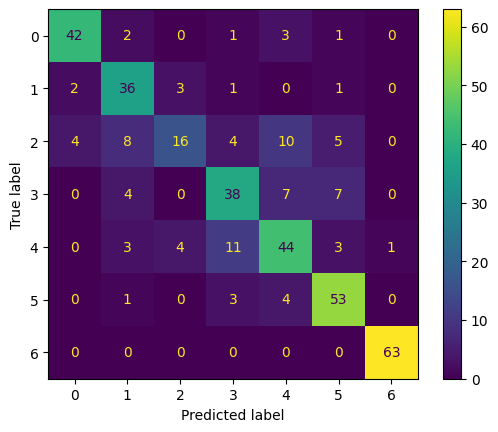

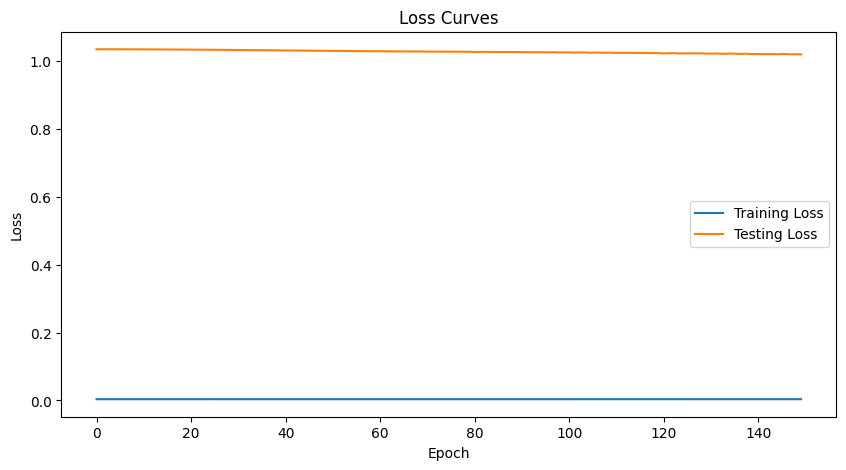

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.010 | Test Acc: 76.62%
Epoch 02 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.022 | Test Acc: 76.10%
Epoch 03 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.016 | Test Acc: 75.58%
Epoch 04 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.010 | Test Acc: 75.84%
Epoch 05 | Train NLL: 0.005 | Train Acc: 100.00% | Test NLL: 1.027 | Test Acc: 75.58%
Epoch 06 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.027 | Test Acc: 76.36%
Epoch 07 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.030 | Test Acc: 75.58%
Epoch 08 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.020 | Test Acc: 75.84%
Epoch 09 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.009 | Test Acc: 76.10%
Epoch 10 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.021 | Test Acc: 76.36%
Epoch 11 | Train NLL: 0.005 | Train Acc: 100.00% | Test 

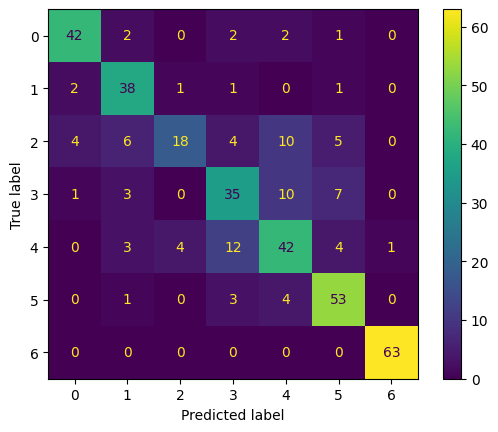

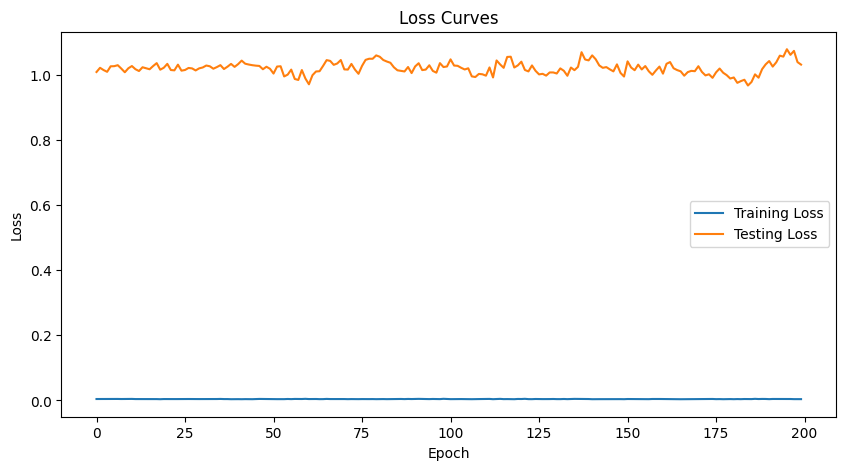

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.035 | Test Acc: 75.32%
Epoch 02 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.030 | Test Acc: 75.84%
Epoch 03 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 1.020 | Test Acc: 76.10%
Epoch 04 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.017 | Test Acc: 75.84%
Epoch 05 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.018 | Test Acc: 76.10%
Epoch 06 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.018 | Test Acc: 76.10%
Epoch 07 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.015 | Test Acc: 76.10%
Epoch 08 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.012 | Test Acc: 76.62%
Epoch 09 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.009 | Test Acc: 76.36%
Epoch 10 | Train NLL: 0.003 | Train Acc: 100.00% | Test NLL: 1.007 | Test Acc: 76.62%
Epoch 11 | Train NLL: 0.003 | Train Acc: 100.00% | Test

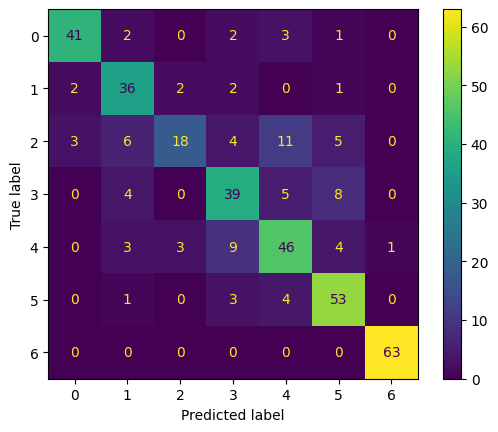

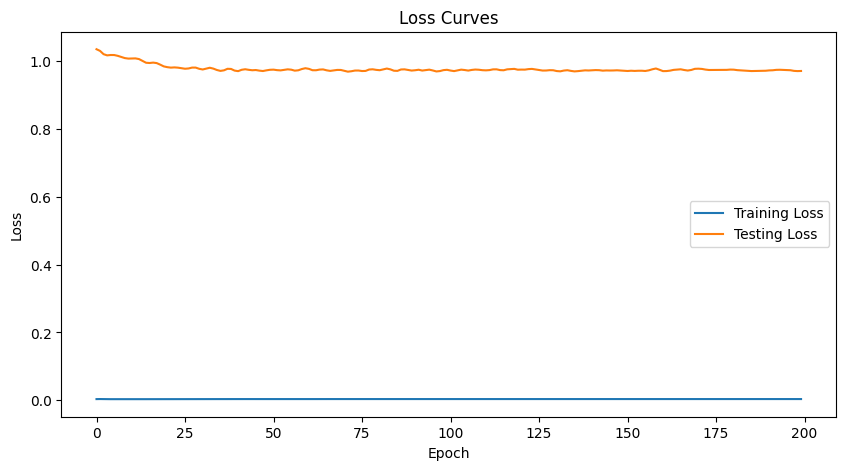

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 76.88%
Epoch 02 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 76.88%
Epoch 03 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.14%
Epoch 04 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.40%
Epoch 05 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.40%
Epoch 06 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.40%
Epoch 07 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.14%
Epoch 08 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.14%
Epoch 09 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.14%
Epoch 10 | Train NLL: 0.004 | Train Acc: 100.00% | Test NLL: 0.971 | Test Acc: 77.14%
Epoch 11 | Train NLL: 0.004 | Train Acc: 100.00% | Test

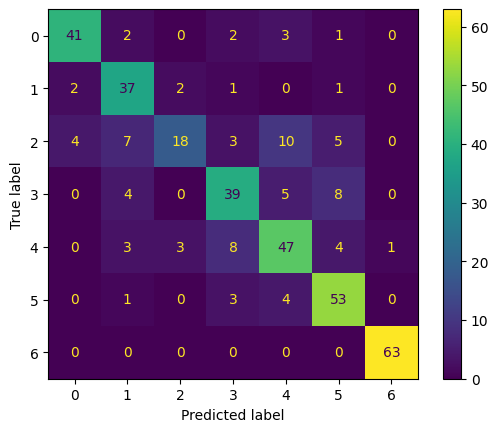

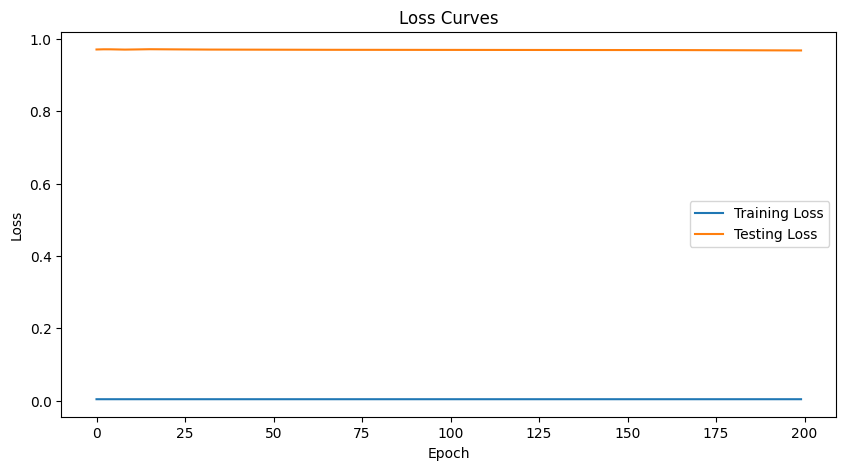

**************************************************



In [36]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 128

num_classes = 7

pytorchNet = SimplePytorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.ReLU(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

SimplePytorchMLP(
  (fc1): Linear(in_features=2621, out_features=128, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=128, out_features=7, bias=True)
  (activation2): Sigmoid()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.936 | Train Acc: 21.61% | Test NLL: 1.911 | Test Acc: 39.74%
Epoch 02 | Train NLL: 1.876 | Train Acc: 48.37% | Test NLL: 1.858 | Test Acc: 45.71%
Epoch 03 | Train NLL: 1.794 | Train Acc: 61.52% | Test NLL: 1.786 | Test Acc: 48.31%
Epoch 04 | Train NLL: 1.688 | Train Acc: 70.51% | Test NLL: 1.701 | Test Acc: 58.18%
Epoch 05 | Train NLL: 1.565 | Train Acc: 77.34% | Test NLL: 1.628 | Test Acc: 60.00%
Epoch 06 | Train NLL: 1.480 | Train Acc: 81.05% | Test NLL: 1.583 | Test Acc: 60.78%
Epoch 07 | Train NLL: 1.409 | Train Acc: 83.85% | Test NLL: 1.548 | Test Acc: 64.68%
Epoch 08 | Train NLL: 1.354 | Train Acc: 86.33% | Test NLL: 1.521 | Test Acc: 65.45%
Epoch 09 | Train NLL: 1.318 | Train Acc: 87.04% | Test NLL: 1.506 | Test Acc: 67.27%
Epoch 10 |

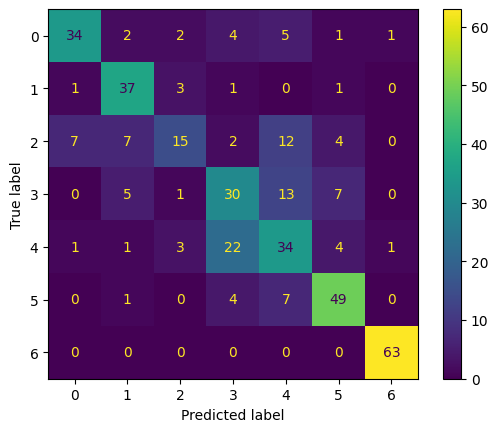

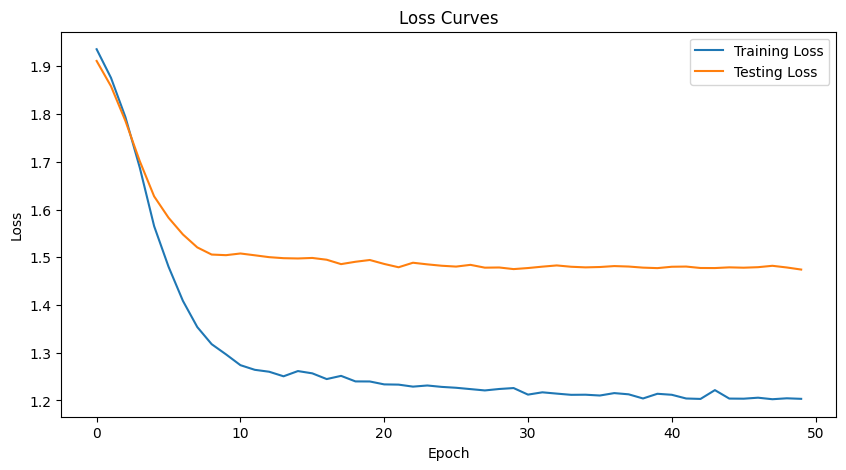

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.204 | Train Acc: 95.44% | Test NLL: 1.472 | Test Acc: 68.31%
Epoch 02 | Train NLL: 1.203 | Train Acc: 95.44% | Test NLL: 1.473 | Test Acc: 68.05%
Epoch 03 | Train NLL: 1.202 | Train Acc: 95.51% | Test NLL: 1.474 | Test Acc: 68.05%
Epoch 04 | Train NLL: 1.203 | Train Acc: 95.51% | Test NLL: 1.475 | Test Acc: 68.83%
Epoch 05 | Train NLL: 1.202 | Train Acc: 95.64% | Test NLL: 1.475 | Test Acc: 68.31%
Epoch 06 | Train NLL: 1.200 | Train Acc: 95.64% | Test NLL: 1.474 | Test Acc: 68.31%
Epoch 07 | Train NLL: 1.201 | Train Acc: 95.64% | Test NLL: 1.473 | Test Acc: 68.57%
Epoch 08 | Train NLL: 1.200 | Train Acc: 95.64% | Test NLL: 1.472 | Test Acc: 68.57%
Epoch 09 | Train NLL: 1.200 | Train Acc: 95.64% | Test NLL: 1.472 | Test Acc: 68.57%
Epoch 10 | Train NLL: 1.200 | Train Acc: 95.70% | Test NLL: 1.472 | Test Acc: 68.31%
Epoch 11 | Train NLL: 1.198 | Train Acc: 95.77% | Test NLL: 1.472 

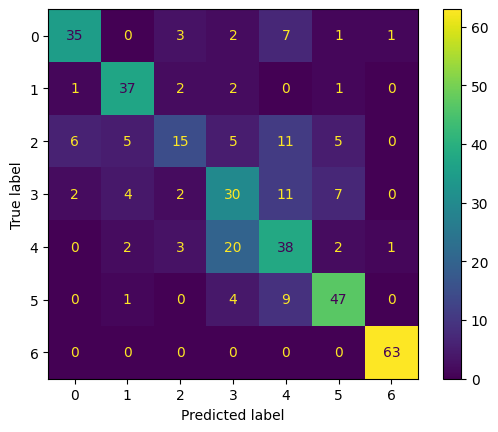

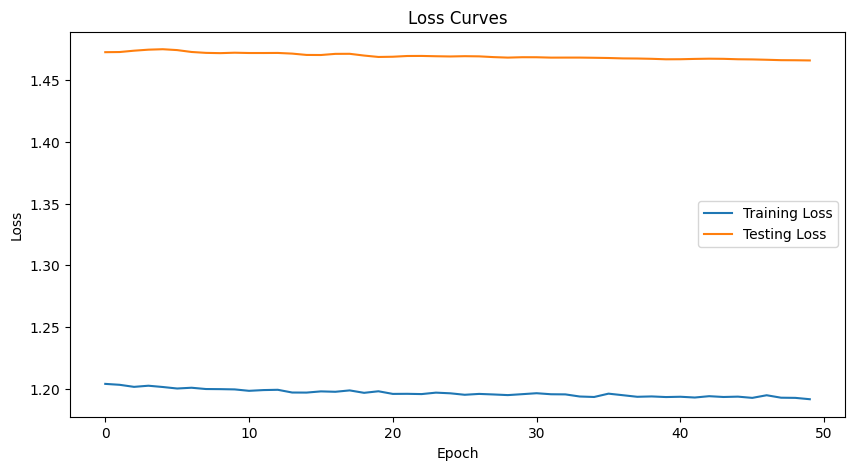

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.192 | Train Acc: 96.48% | Test NLL: 1.466 | Test Acc: 68.83%
Epoch 02 | Train NLL: 1.192 | Train Acc: 96.48% | Test NLL: 1.466 | Test Acc: 69.09%
Epoch 03 | Train NLL: 1.192 | Train Acc: 96.42% | Test NLL: 1.466 | Test Acc: 69.09%
Epoch 04 | Train NLL: 1.192 | Train Acc: 96.42% | Test NLL: 1.465 | Test Acc: 68.57%
Epoch 05 | Train NLL: 1.192 | Train Acc: 96.42% | Test NLL: 1.465 | Test Acc: 68.31%
Epoch 06 | Train NLL: 1.192 | Train Acc: 96.42% | Test NLL: 1.465 | Test Acc: 68.05%
Epoch 07 | Train NLL: 1.192 | Train Acc: 96.48% | Test NLL: 1.466 | Test Acc: 68.31%
Epoch 08 | Train NLL: 1.192 | Train Acc: 96.61% | Test NLL: 1.466 | Test Acc: 68.57%
Epoch 09 | Train NLL: 1.192 | Train Acc: 96.61% | Test NLL: 1.466 | Test Acc: 68.83%
Epoch 10 | Train NLL: 1.192 | Train Acc: 96.74% | Test NLL: 1.466 | Test Acc: 68.57%
Epoch 11 | Train NLL: 1.191 | Train Acc: 96.88% | Test NLL: 1.465 

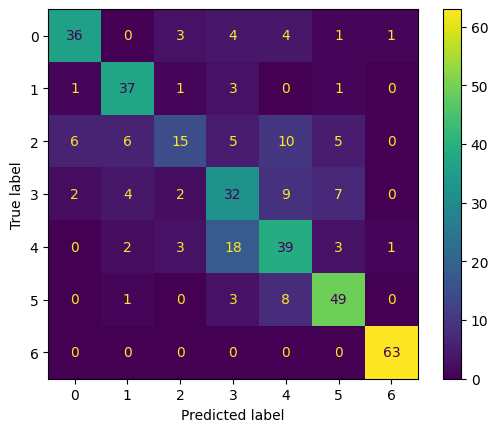

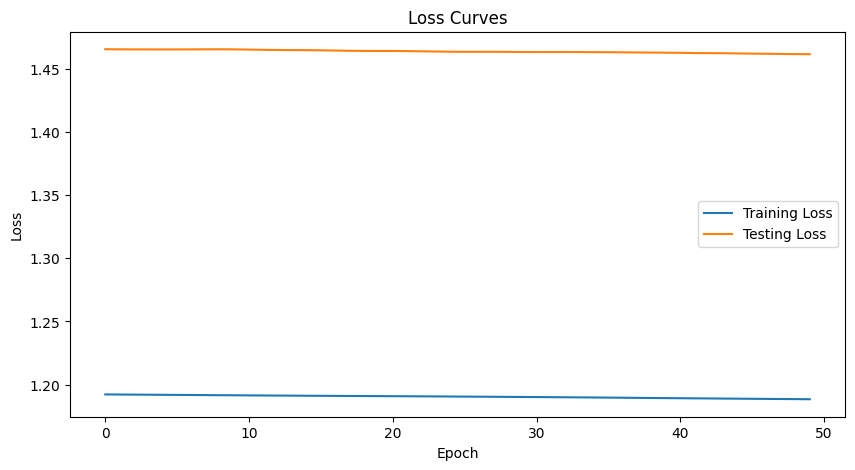

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.192 | Train Acc: 97.46% | Test NLL: 1.463 | Test Acc: 69.61%
Epoch 02 | Train NLL: 1.186 | Train Acc: 97.66% | Test NLL: 1.460 | Test Acc: 70.39%
Epoch 03 | Train NLL: 1.188 | Train Acc: 97.40% | Test NLL: 1.462 | Test Acc: 70.39%
Epoch 04 | Train NLL: 1.187 | Train Acc: 97.66% | Test NLL: 1.463 | Test Acc: 71.17%
Epoch 05 | Train NLL: 1.189 | Train Acc: 97.40% | Test NLL: 1.460 | Test Acc: 70.13%
Epoch 06 | Train NLL: 1.194 | Train Acc: 97.72% | Test NLL: 1.463 | Test Acc: 71.17%
Epoch 07 | Train NLL: 1.191 | Train Acc: 97.53% | Test NLL: 1.459 | Test Acc: 69.87%
Epoch 08 | Train NLL: 1.189 | Train Acc: 97.72% | Test NLL: 1.463 | Test Acc: 70.39%
Epoch 09 | Train NLL: 1.194 | Train Acc: 97.72% | Test NLL: 1.463 | Test Acc: 69.87%
Epoch 10 | Train NLL: 1.188 | Train Acc: 97.79% | Test NLL: 1.471 | Test Acc: 69.35%
Epoch 11 | Train NLL: 1.187 | Train Acc: 97.98% | Test NLL: 1.471 

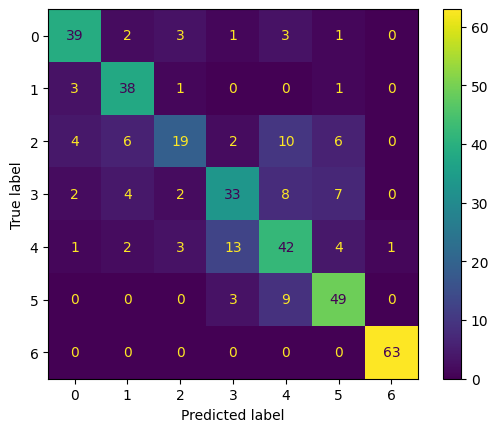

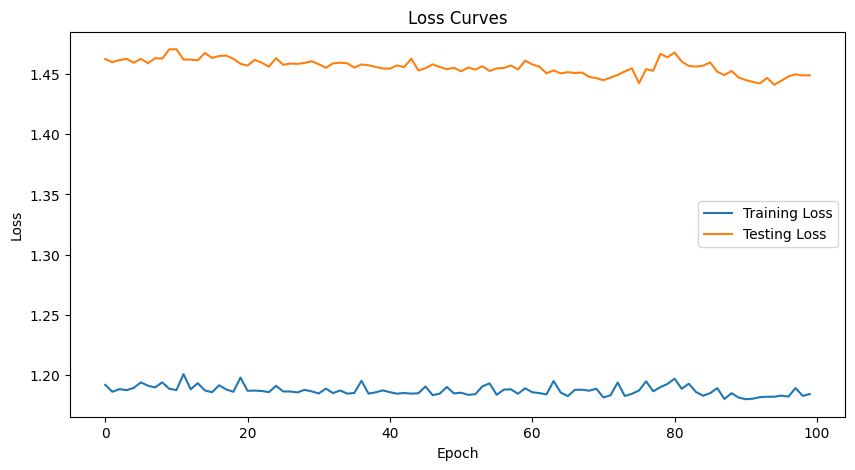

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.184 | Train Acc: 98.70% | Test NLL: 1.448 | Test Acc: 74.03%
Epoch 02 | Train NLL: 1.184 | Train Acc: 98.70% | Test NLL: 1.446 | Test Acc: 74.55%
Epoch 03 | Train NLL: 1.182 | Train Acc: 98.76% | Test NLL: 1.449 | Test Acc: 72.21%
Epoch 04 | Train NLL: 1.183 | Train Acc: 98.70% | Test NLL: 1.451 | Test Acc: 74.29%
Epoch 05 | Train NLL: 1.181 | Train Acc: 98.70% | Test NLL: 1.450 | Test Acc: 73.77%
Epoch 06 | Train NLL: 1.181 | Train Acc: 98.76% | Test NLL: 1.448 | Test Acc: 74.81%
Epoch 07 | Train NLL: 1.181 | Train Acc: 98.83% | Test NLL: 1.447 | Test Acc: 74.03%
Epoch 08 | Train NLL: 1.180 | Train Acc: 98.83% | Test NLL: 1.445 | Test Acc: 74.81%
Epoch 09 | Train NLL: 1.180 | Train Acc: 98.70% | Test NLL: 1.445 | Test Acc: 75.32%
Epoch 10 | Train NLL: 1.180 | Train Acc: 98.70% | Test NLL: 1.445 | Test Acc: 75.32%
Epoch 11 | Train NLL: 1.180 | Train Acc: 98.70% | Test NLL: 1.443

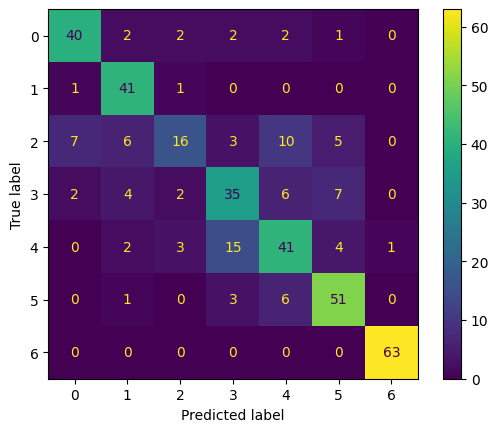

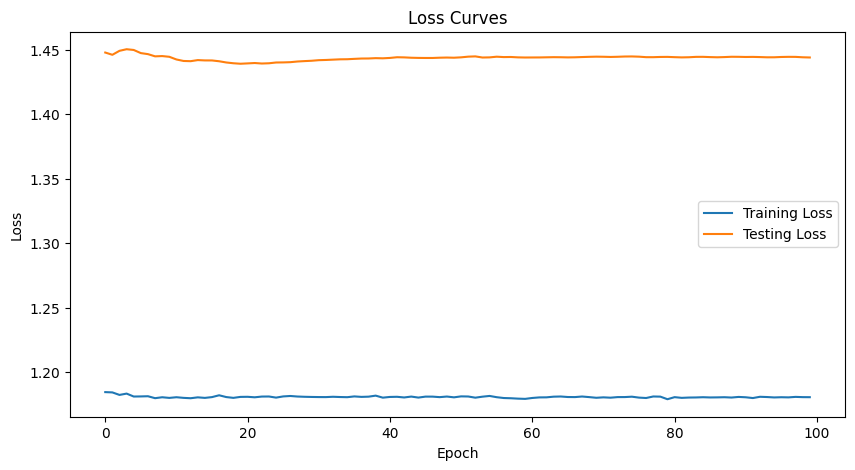

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.55%
Epoch 02 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 03 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 04 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 05 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 06 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 75.06%
Epoch 07 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 08 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 09 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 10 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444 | Test Acc: 75.06%
Epoch 11 | Train NLL: 1.180 | Train Acc: 98.89% | Test NLL: 1.444

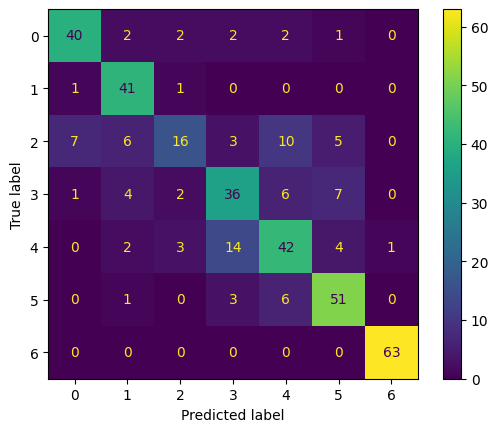

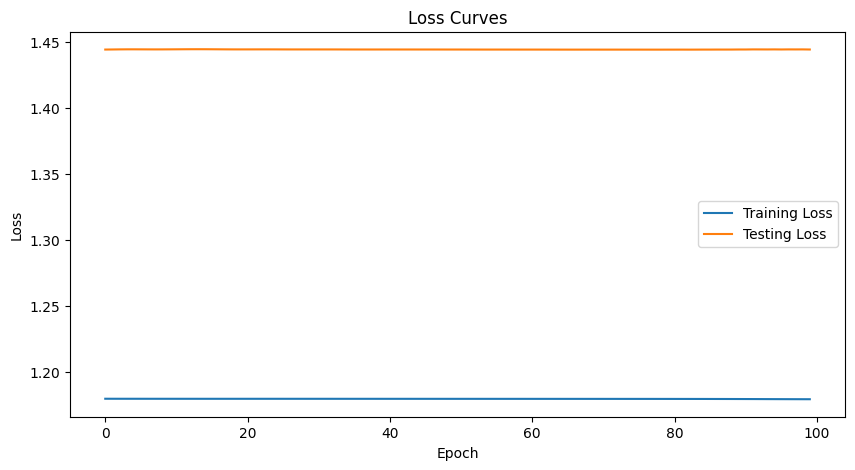

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.178 | Train Acc: 98.96% | Test NLL: 1.446 | Test Acc: 73.77%
Epoch 02 | Train NLL: 1.179 | Train Acc: 98.96% | Test NLL: 1.444 | Test Acc: 74.81%
Epoch 03 | Train NLL: 1.180 | Train Acc: 98.96% | Test NLL: 1.443 | Test Acc: 73.77%
Epoch 04 | Train NLL: 1.180 | Train Acc: 98.96% | Test NLL: 1.444 | Test Acc: 74.29%
Epoch 05 | Train NLL: 1.181 | Train Acc: 98.96% | Test NLL: 1.446 | Test Acc: 74.29%
Epoch 06 | Train NLL: 1.187 | Train Acc: 98.96% | Test NLL: 1.439 | Test Acc: 73.25%
Epoch 07 | Train NLL: 1.182 | Train Acc: 99.02% | Test NLL: 1.441 | Test Acc: 73.51%
Epoch 08 | Train NLL: 1.186 | Train Acc: 99.02% | Test NLL: 1.440 | Test Acc: 74.03%
Epoch 09 | Train NLL: 1.181 | Train Acc: 99.02% | Test NLL: 1.451 | Test Acc: 71.95%
Epoch 10 | Train NLL: 1.183 | Train Acc: 98.96% | Test NLL: 1.447 | Test Acc: 72.73%
Epoch 11 | Train NLL: 1.187 | Train Acc: 98.96% | Test NLL: 1.442 

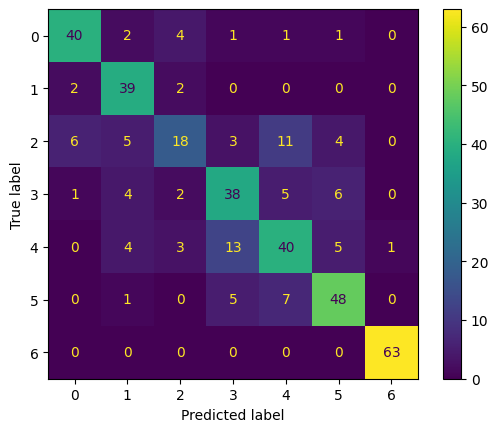

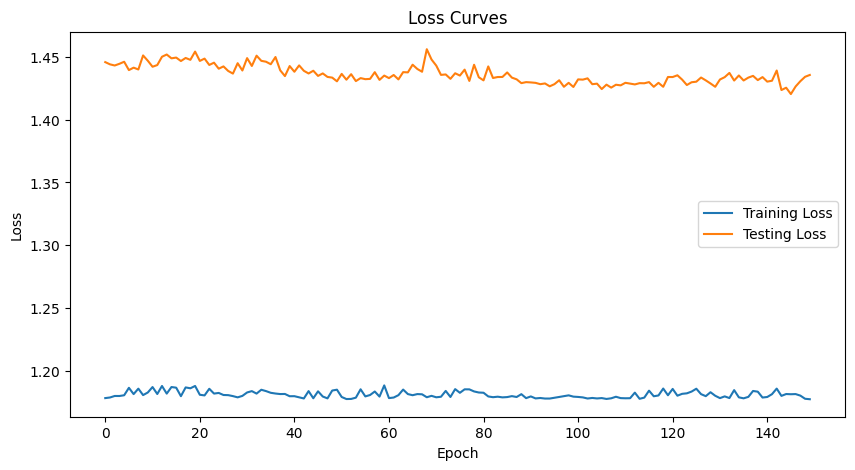

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.178 | Train Acc: 99.28% | Test NLL: 1.434 | Test Acc: 74.81%
Epoch 02 | Train NLL: 1.177 | Train Acc: 99.28% | Test NLL: 1.433 | Test Acc: 75.06%
Epoch 03 | Train NLL: 1.177 | Train Acc: 99.28% | Test NLL: 1.431 | Test Acc: 75.06%
Epoch 04 | Train NLL: 1.178 | Train Acc: 99.28% | Test NLL: 1.430 | Test Acc: 74.81%
Epoch 05 | Train NLL: 1.178 | Train Acc: 99.28% | Test NLL: 1.430 | Test Acc: 74.55%
Epoch 06 | Train NLL: 1.178 | Train Acc: 99.28% | Test NLL: 1.431 | Test Acc: 74.29%
Epoch 07 | Train NLL: 1.177 | Train Acc: 99.28% | Test NLL: 1.430 | Test Acc: 74.81%
Epoch 08 | Train NLL: 1.176 | Train Acc: 99.28% | Test NLL: 1.428 | Test Acc: 75.58%
Epoch 09 | Train NLL: 1.177 | Train Acc: 99.28% | Test NLL: 1.427 | Test Acc: 75.32%
Epoch 10 | Train NLL: 1.176 | Train Acc: 99.28% | Test NLL: 1.426 | Test Acc: 75.32%
Epoch 11 | Train NLL: 1.177 | Train Acc: 99.28% | Test NLL: 1.425

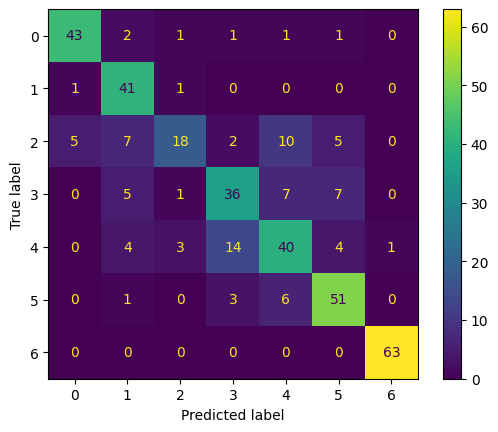

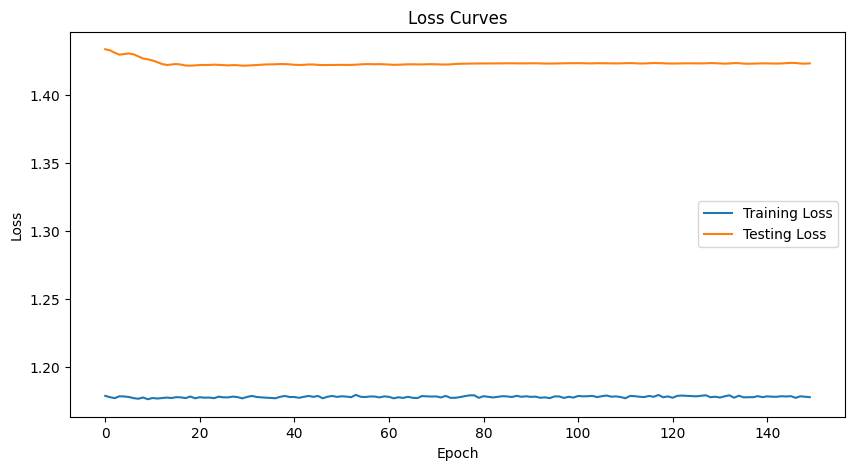

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 02 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 03 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 04 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 05 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 06 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 76.10%
Epoch 07 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.423 | Test Acc: 76.10%
Epoch 08 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.423 | Test Acc: 75.84%
Epoch 09 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.423 | Test Acc: 75.84%
Epoch 10 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 75.84%
Epoch 11 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424

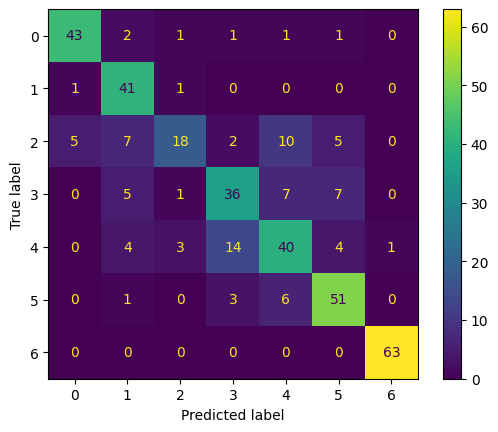

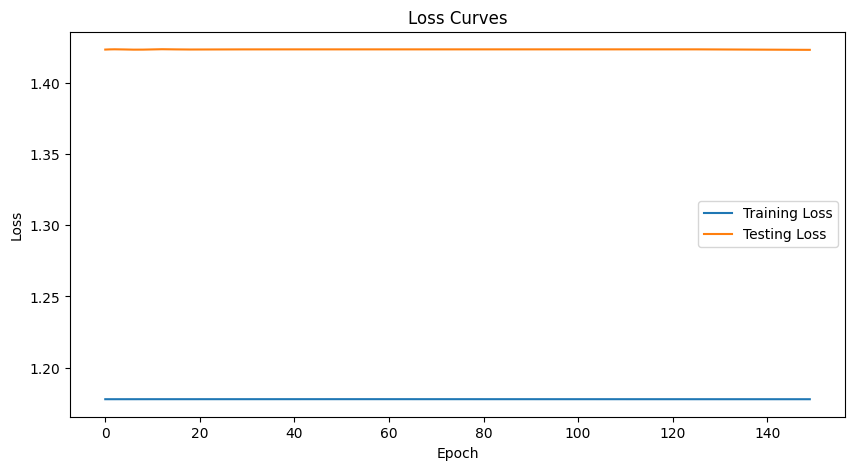

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.182 | Train Acc: 99.35% | Test NLL: 1.424 | Test Acc: 76.36%
Epoch 02 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.424 | Test Acc: 76.36%
Epoch 03 | Train NLL: 1.178 | Train Acc: 99.35% | Test NLL: 1.424 | Test Acc: 75.58%
Epoch 04 | Train NLL: 1.178 | Train Acc: 99.41% | Test NLL: 1.423 | Test Acc: 76.62%
Epoch 05 | Train NLL: 1.179 | Train Acc: 99.35% | Test NLL: 1.424 | Test Acc: 77.40%
Epoch 06 | Train NLL: 1.180 | Train Acc: 99.41% | Test NLL: 1.419 | Test Acc: 76.36%
Epoch 07 | Train NLL: 1.179 | Train Acc: 99.35% | Test NLL: 1.420 | Test Acc: 77.14%
Epoch 08 | Train NLL: 1.178 | Train Acc: 99.35% | Test NLL: 1.419 | Test Acc: 77.14%
Epoch 09 | Train NLL: 1.183 | Train Acc: 99.35% | Test NLL: 1.423 | Test Acc: 77.14%
Epoch 10 | Train NLL: 1.183 | Train Acc: 99.35% | Test NLL: 1.422 | Test Acc: 75.06%
Epoch 11 | Train NLL: 1.177 | Train Acc: 99.41% | Test NLL: 1.424 

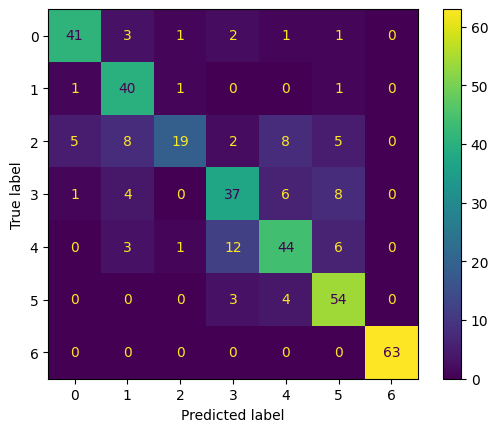

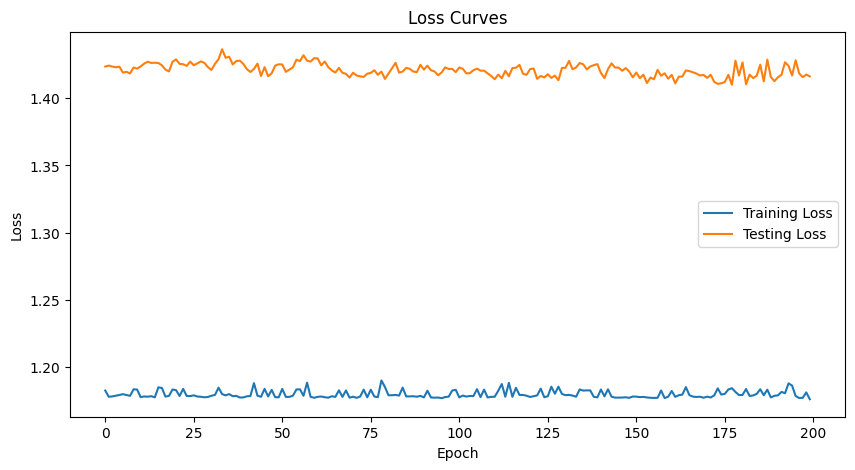

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.177 | Train Acc: 99.41% | Test NLL: 1.414 | Test Acc: 78.18%
Epoch 02 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.413 | Test Acc: 77.40%
Epoch 03 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.414 | Test Acc: 75.84%
Epoch 04 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.412 | Test Acc: 76.88%
Epoch 05 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.410 | Test Acc: 78.18%
Epoch 06 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.409 | Test Acc: 78.18%
Epoch 07 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.410 | Test Acc: 77.40%
Epoch 08 | Train NLL: 1.176 | Train Acc: 99.41% | Test NLL: 1.411 | Test Acc: 76.88%
Epoch 09 | Train NLL: 1.177 | Train Acc: 99.41% | Test NLL: 1.411 | Test Acc: 77.92%
Epoch 10 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.44%
Epoch 11 | Train NLL: 1.176 | Train Acc: 99.48% | Test NLL: 1.410

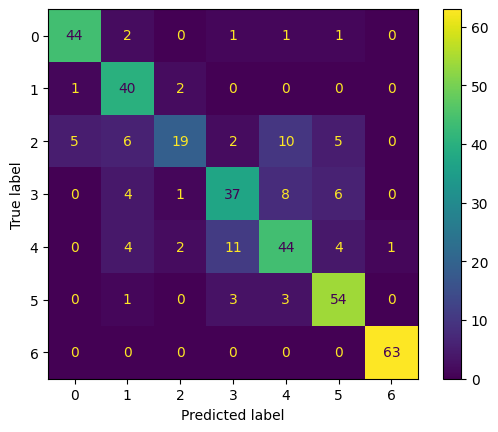

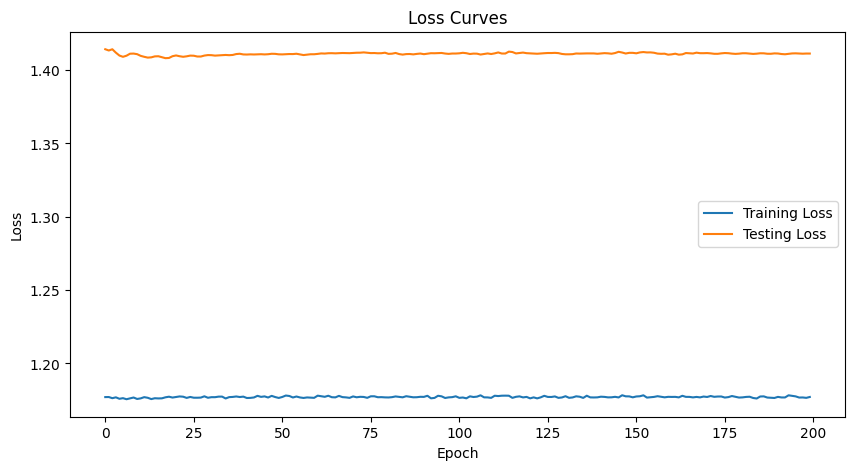

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 02 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 03 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 77.92%
Epoch 04 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 77.92%
Epoch 05 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 06 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 07 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 08 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.411 | Test Acc: 78.18%
Epoch 09 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.412 | Test Acc: 78.18%
Epoch 10 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.412 | Test Acc: 78.18%
Epoch 11 | Train NLL: 1.177 | Train Acc: 99.48% | Test NLL: 1.412

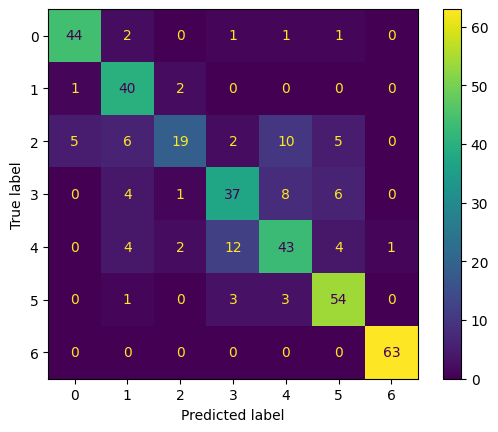

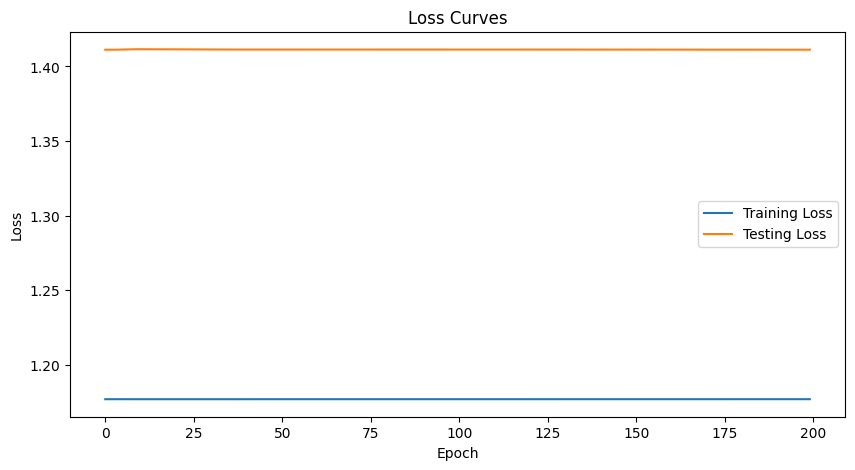

**************************************************



In [37]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 128

num_classes = 7

pytorchNet = SimplePytorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Sigmoid(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

SimplePytorchMLP(
  (fc1): Linear(in_features=2621, out_features=128, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=128, out_features=7, bias=True)
  (activation2): Tanh()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.947 | Train Acc: 16.28% | Test NLL: 1.949 | Test Acc: 20.52%
Epoch 02 | Train NLL: 1.946 | Train Acc: 16.93% | Test NLL: 1.948 | Test Acc: 20.78%
Epoch 03 | Train NLL: 1.953 | Train Acc: 17.64% | Test NLL: 1.948 | Test Acc: 21.04%
Epoch 04 | Train NLL: 1.958 | Train Acc: 18.49% | Test NLL: 1.948 | Test Acc: 22.08%
Epoch 05 | Train NLL: 1.949 | Train Acc: 18.68% | Test NLL: 1.947 | Test Acc: 23.64%
Epoch 06 | Train NLL: 1.954 | Train Acc: 19.47% | Test NLL: 1.946 | Test Acc: 23.38%
Epoch 07 | Train NLL: 1.948 | Train Acc: 19.86% | Test NLL: 1.946 | Test Acc: 23.90%
Epoch 08 | Train NLL: 1.948 | Train Acc: 19.92% | Test NLL: 1.945 | Test Acc: 21.04%
Epoch 09 | Train NLL: 1.945 | Train Acc: 19.21% | Test NLL: 1.944 | Test Acc: 20.26%
Epoch 10 | Tr

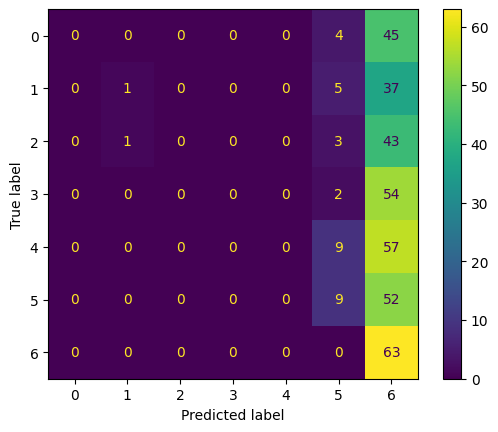

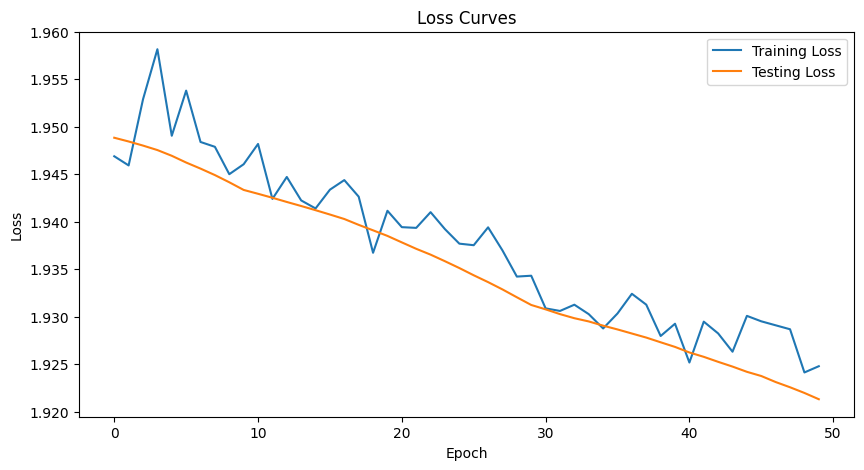

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.923 | Train Acc: 18.03% | Test NLL: 1.921 | Test Acc: 19.22%
Epoch 02 | Train NLL: 1.922 | Train Acc: 18.23% | Test NLL: 1.921 | Test Acc: 19.22%
Epoch 03 | Train NLL: 1.923 | Train Acc: 18.29% | Test NLL: 1.920 | Test Acc: 19.22%
Epoch 04 | Train NLL: 1.923 | Train Acc: 18.42% | Test NLL: 1.920 | Test Acc: 19.22%
Epoch 05 | Train NLL: 1.923 | Train Acc: 18.42% | Test NLL: 1.920 | Test Acc: 19.74%
Epoch 06 | Train NLL: 1.922 | Train Acc: 18.62% | Test NLL: 1.919 | Test Acc: 19.74%
Epoch 07 | Train NLL: 1.921 | Train Acc: 18.75% | Test NLL: 1.919 | Test Acc: 19.74%
Epoch 08 | Train NLL: 1.921 | Train Acc: 19.08% | Test NLL: 1.918 | Test Acc: 20.00%
Epoch 09 | Train NLL: 1.922 | Train Acc: 19.21% | Test NLL: 1.918 | Test Acc: 20.52%
Epoch 10 | Train NLL: 1.921 | Train Acc: 19.47% | Test NLL: 1.918 | Test Acc: 20.52%
Epoch 11 | Train NLL: 1.921 | Train Acc: 19.60% | Test NLL: 1.917 

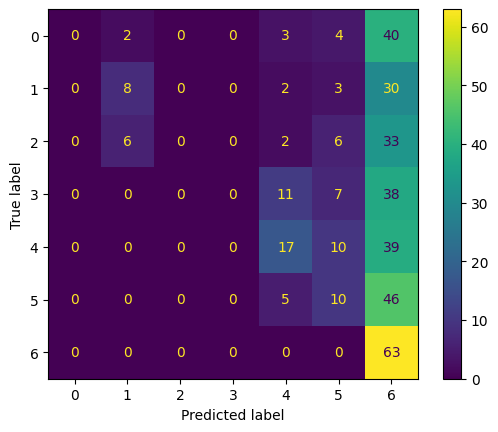

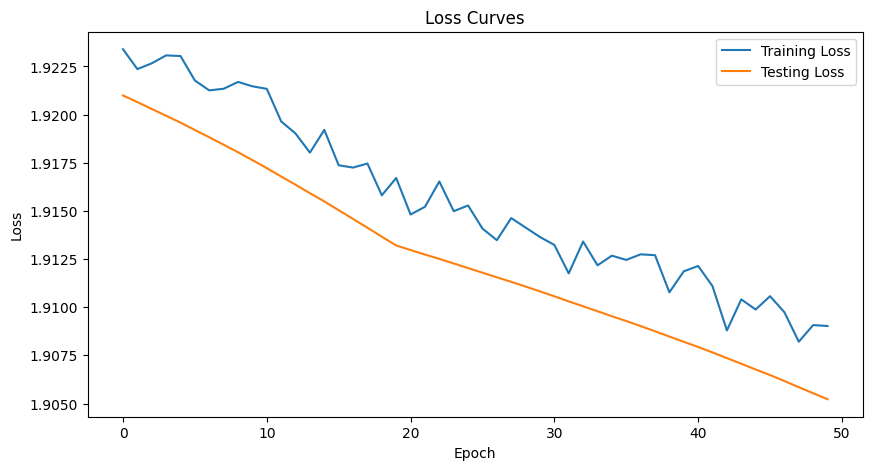

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.908 | Train Acc: 25.59% | Test NLL: 1.905 | Test Acc: 25.71%
Epoch 02 | Train NLL: 1.908 | Train Acc: 25.65% | Test NLL: 1.905 | Test Acc: 25.71%
Epoch 03 | Train NLL: 1.908 | Train Acc: 25.59% | Test NLL: 1.905 | Test Acc: 25.97%
Epoch 04 | Train NLL: 1.908 | Train Acc: 25.59% | Test NLL: 1.905 | Test Acc: 25.71%
Epoch 05 | Train NLL: 1.908 | Train Acc: 25.59% | Test NLL: 1.904 | Test Acc: 25.71%
Epoch 06 | Train NLL: 1.908 | Train Acc: 25.59% | Test NLL: 1.904 | Test Acc: 25.97%
Epoch 07 | Train NLL: 1.908 | Train Acc: 25.52% | Test NLL: 1.904 | Test Acc: 26.23%
Epoch 08 | Train NLL: 1.907 | Train Acc: 25.52% | Test NLL: 1.904 | Test Acc: 26.49%
Epoch 09 | Train NLL: 1.907 | Train Acc: 25.59% | Test NLL: 1.904 | Test Acc: 26.49%
Epoch 10 | Train NLL: 1.907 | Train Acc: 25.65% | Test NLL: 1.903 | Test Acc: 26.75%
Epoch 11 | Train NLL: 1.907 | Train Acc: 25.72% | Test NLL: 1.903 

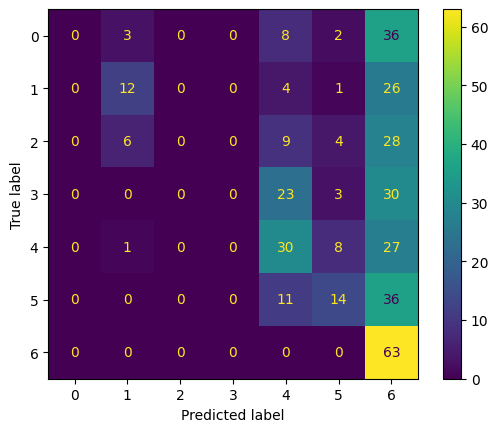

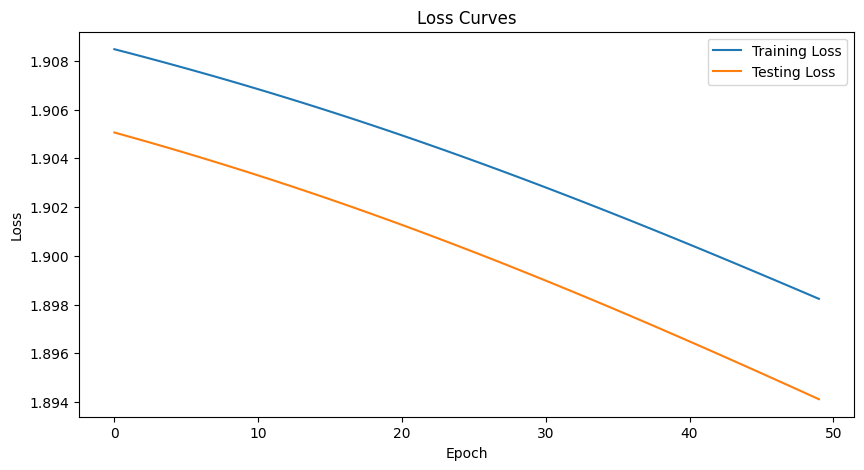

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.903 | Train Acc: 28.58% | Test NLL: 1.894 | Test Acc: 31.43%
Epoch 02 | Train NLL: 1.901 | Train Acc: 28.71% | Test NLL: 1.893 | Test Acc: 31.43%
Epoch 03 | Train NLL: 1.896 | Train Acc: 28.97% | Test NLL: 1.892 | Test Acc: 31.43%
Epoch 04 | Train NLL: 1.891 | Train Acc: 29.23% | Test NLL: 1.892 | Test Acc: 31.69%
Epoch 05 | Train NLL: 1.893 | Train Acc: 29.36% | Test NLL: 1.891 | Test Acc: 31.69%
Epoch 06 | Train NLL: 1.897 | Train Acc: 29.04% | Test NLL: 1.891 | Test Acc: 31.43%
Epoch 07 | Train NLL: 1.887 | Train Acc: 28.97% | Test NLL: 1.890 | Test Acc: 31.95%
Epoch 08 | Train NLL: 1.892 | Train Acc: 28.84% | Test NLL: 1.890 | Test Acc: 31.43%
Epoch 09 | Train NLL: 1.898 | Train Acc: 28.84% | Test NLL: 1.889 | Test Acc: 31.17%
Epoch 10 | Train NLL: 1.889 | Train Acc: 29.10% | Test NLL: 1.888 | Test Acc: 31.43%
Epoch 11 | Train NLL: 1.892 | Train Acc: 29.17% | Test NLL: 1.888 

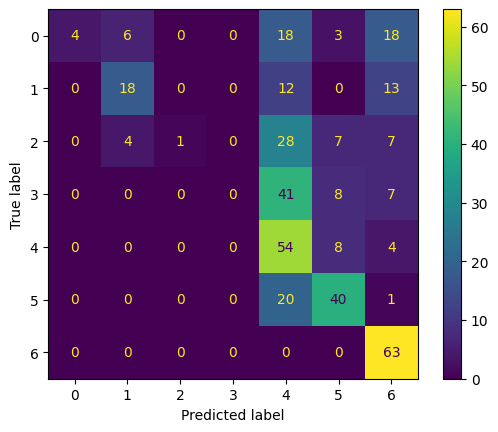

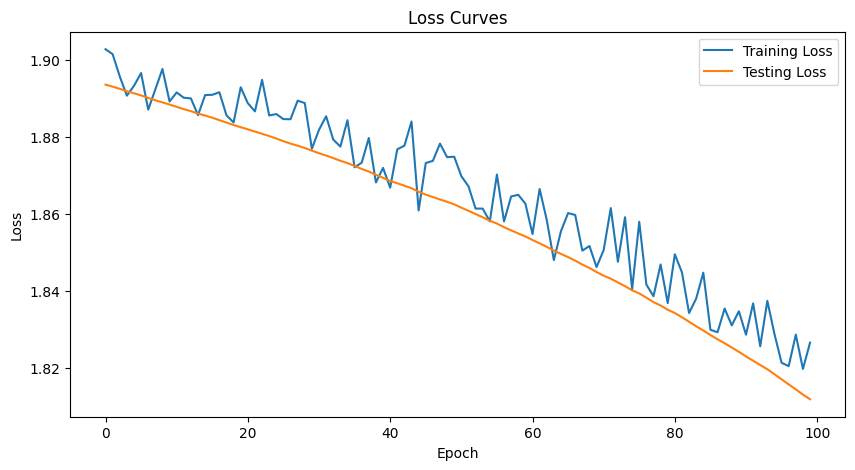

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.820 | Train Acc: 41.54% | Test NLL: 1.811 | Test Acc: 46.75%
Epoch 02 | Train NLL: 1.819 | Train Acc: 41.60% | Test NLL: 1.811 | Test Acc: 46.75%
Epoch 03 | Train NLL: 1.822 | Train Acc: 41.67% | Test NLL: 1.810 | Test Acc: 47.27%
Epoch 04 | Train NLL: 1.815 | Train Acc: 41.73% | Test NLL: 1.809 | Test Acc: 47.27%
Epoch 05 | Train NLL: 1.819 | Train Acc: 41.86% | Test NLL: 1.809 | Test Acc: 47.27%
Epoch 06 | Train NLL: 1.818 | Train Acc: 41.93% | Test NLL: 1.808 | Test Acc: 47.53%
Epoch 07 | Train NLL: 1.816 | Train Acc: 41.93% | Test NLL: 1.807 | Test Acc: 47.27%
Epoch 08 | Train NLL: 1.818 | Train Acc: 41.93% | Test NLL: 1.807 | Test Acc: 47.79%
Epoch 09 | Train NLL: 1.812 | Train Acc: 41.99% | Test NLL: 1.806 | Test Acc: 47.79%
Epoch 10 | Train NLL: 1.812 | Train Acc: 42.06% | Test NLL: 1.805 | Test Acc: 47.79%
Epoch 11 | Train NLL: 1.814 | Train Acc: 42.12% | Test NLL: 1.805

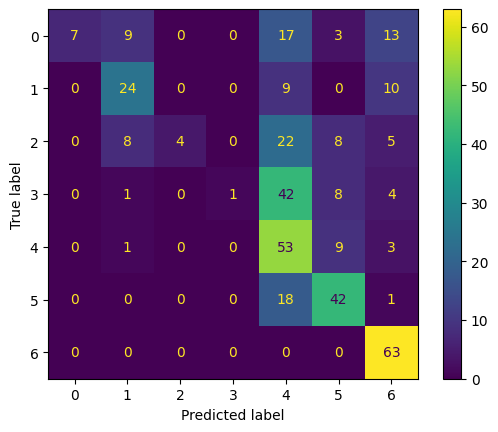

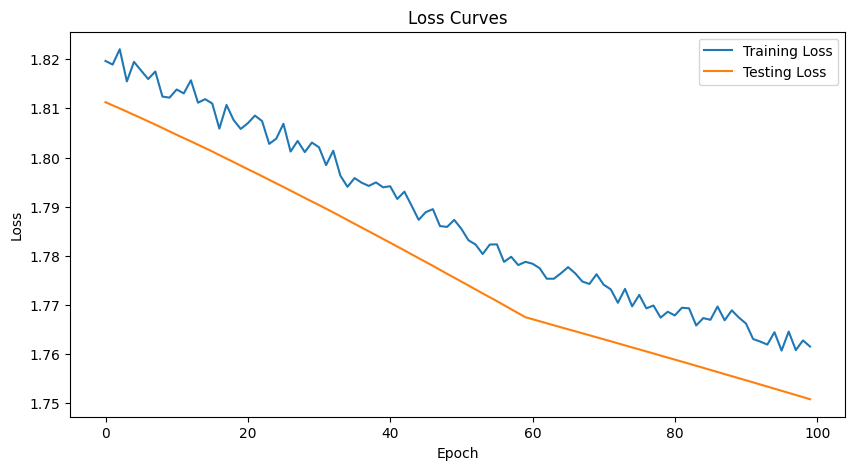

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.762 | Train Acc: 46.88% | Test NLL: 1.751 | Test Acc: 50.39%
Epoch 02 | Train NLL: 1.762 | Train Acc: 46.88% | Test NLL: 1.750 | Test Acc: 50.39%
Epoch 03 | Train NLL: 1.761 | Train Acc: 46.88% | Test NLL: 1.750 | Test Acc: 50.39%
Epoch 04 | Train NLL: 1.761 | Train Acc: 46.88% | Test NLL: 1.750 | Test Acc: 50.39%
Epoch 05 | Train NLL: 1.761 | Train Acc: 46.88% | Test NLL: 1.750 | Test Acc: 50.39%
Epoch 06 | Train NLL: 1.761 | Train Acc: 46.88% | Test NLL: 1.750 | Test Acc: 50.39%
Epoch 07 | Train NLL: 1.760 | Train Acc: 46.88% | Test NLL: 1.749 | Test Acc: 50.39%
Epoch 08 | Train NLL: 1.760 | Train Acc: 46.88% | Test NLL: 1.749 | Test Acc: 50.39%
Epoch 09 | Train NLL: 1.760 | Train Acc: 46.94% | Test NLL: 1.749 | Test Acc: 50.39%
Epoch 10 | Train NLL: 1.760 | Train Acc: 47.01% | Test NLL: 1.749 | Test Acc: 50.39%
Epoch 11 | Train NLL: 1.760 | Train Acc: 47.07% | Test NLL: 1.748

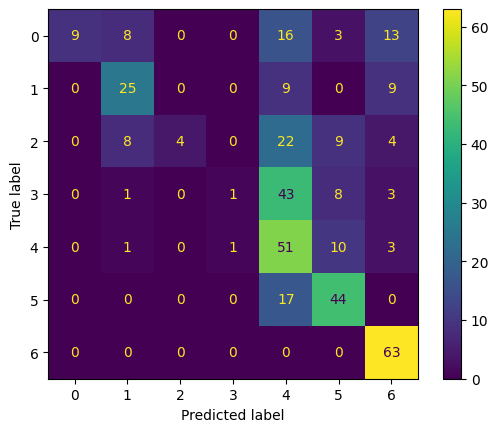

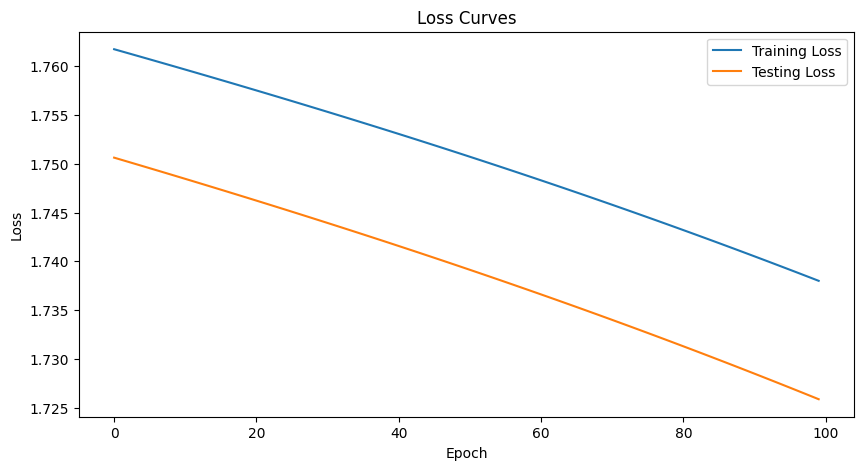

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.732 | Train Acc: 48.83% | Test NLL: 1.725 | Test Acc: 50.91%
Epoch 02 | Train NLL: 1.731 | Train Acc: 48.83% | Test NLL: 1.724 | Test Acc: 50.65%
Epoch 03 | Train NLL: 1.752 | Train Acc: 49.15% | Test NLL: 1.722 | Test Acc: 50.91%
Epoch 04 | Train NLL: 1.735 | Train Acc: 48.96% | Test NLL: 1.721 | Test Acc: 50.91%
Epoch 05 | Train NLL: 1.732 | Train Acc: 49.02% | Test NLL: 1.720 | Test Acc: 51.43%
Epoch 06 | Train NLL: 1.743 | Train Acc: 49.02% | Test NLL: 1.719 | Test Acc: 51.17%
Epoch 07 | Train NLL: 1.730 | Train Acc: 48.96% | Test NLL: 1.718 | Test Acc: 51.17%
Epoch 08 | Train NLL: 1.716 | Train Acc: 49.09% | Test NLL: 1.717 | Test Acc: 51.17%
Epoch 09 | Train NLL: 1.722 | Train Acc: 48.96% | Test NLL: 1.715 | Test Acc: 51.69%
Epoch 10 | Train NLL: 1.725 | Train Acc: 48.83% | Test NLL: 1.714 | Test Acc: 51.43%
Epoch 11 | Train NLL: 1.732 | Train Acc: 49.09% | Test NLL: 1.713 

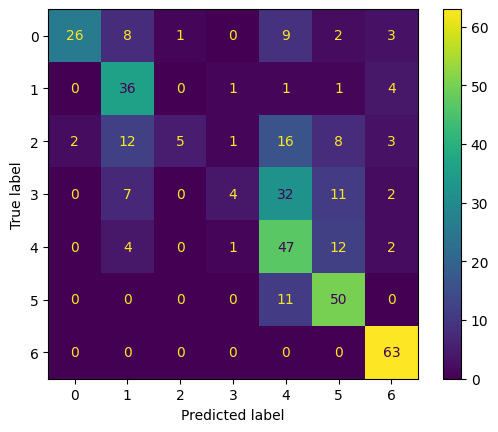

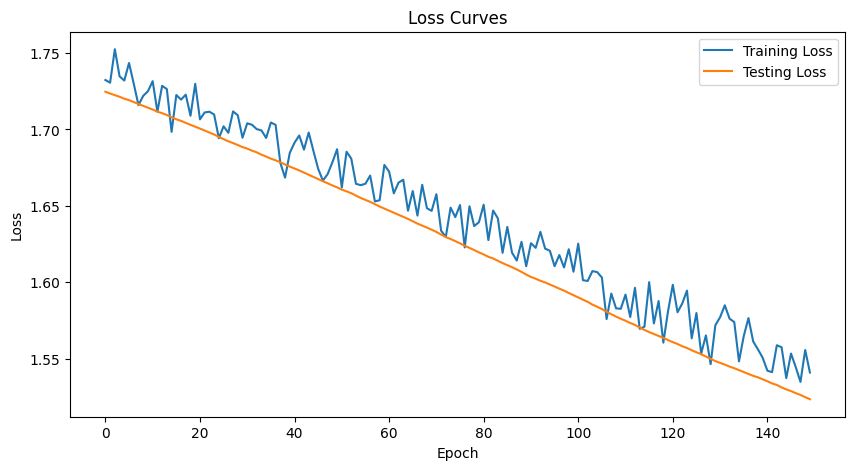

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.543 | Train Acc: 56.12% | Test NLL: 1.523 | Test Acc: 60.00%
Epoch 02 | Train NLL: 1.544 | Train Acc: 56.12% | Test NLL: 1.522 | Test Acc: 60.26%
Epoch 03 | Train NLL: 1.541 | Train Acc: 56.05% | Test NLL: 1.522 | Test Acc: 60.26%
Epoch 04 | Train NLL: 1.538 | Train Acc: 56.12% | Test NLL: 1.521 | Test Acc: 60.52%
Epoch 05 | Train NLL: 1.538 | Train Acc: 56.32% | Test NLL: 1.520 | Test Acc: 60.52%
Epoch 06 | Train NLL: 1.536 | Train Acc: 56.32% | Test NLL: 1.520 | Test Acc: 60.52%
Epoch 07 | Train NLL: 1.541 | Train Acc: 56.45% | Test NLL: 1.519 | Test Acc: 60.52%
Epoch 08 | Train NLL: 1.539 | Train Acc: 56.45% | Test NLL: 1.518 | Test Acc: 60.78%
Epoch 09 | Train NLL: 1.536 | Train Acc: 56.51% | Test NLL: 1.518 | Test Acc: 61.04%
Epoch 10 | Train NLL: 1.539 | Train Acc: 56.45% | Test NLL: 1.517 | Test Acc: 60.78%
Epoch 11 | Train NLL: 1.535 | Train Acc: 56.45% | Test NLL: 1.517

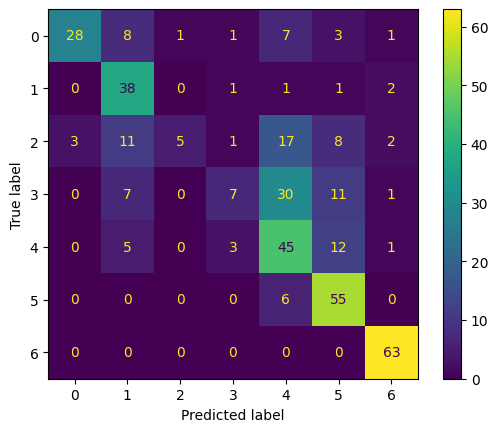

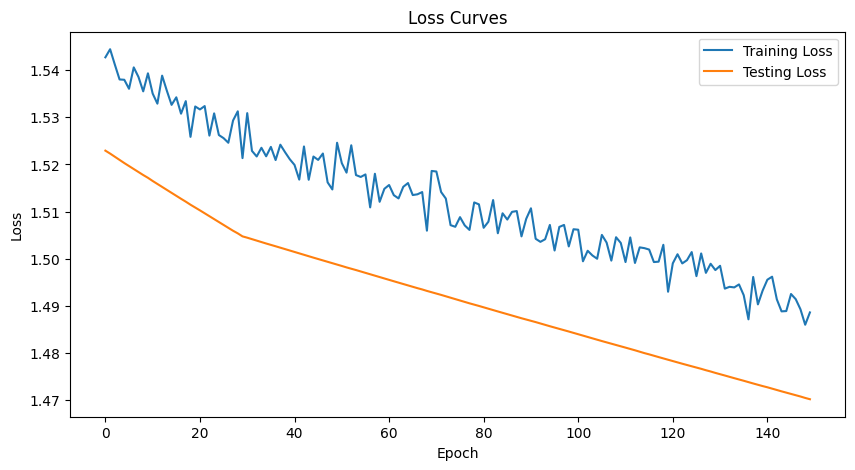

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.490 | Train Acc: 58.79% | Test NLL: 1.470 | Test Acc: 62.60%
Epoch 02 | Train NLL: 1.490 | Train Acc: 58.79% | Test NLL: 1.470 | Test Acc: 62.60%
Epoch 03 | Train NLL: 1.490 | Train Acc: 58.79% | Test NLL: 1.470 | Test Acc: 62.60%
Epoch 04 | Train NLL: 1.490 | Train Acc: 58.79% | Test NLL: 1.470 | Test Acc: 62.60%
Epoch 05 | Train NLL: 1.489 | Train Acc: 58.79% | Test NLL: 1.470 | Test Acc: 62.60%
Epoch 06 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469 | Test Acc: 62.60%
Epoch 07 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469 | Test Acc: 62.60%
Epoch 08 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469 | Test Acc: 62.60%
Epoch 09 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469 | Test Acc: 62.60%
Epoch 10 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469 | Test Acc: 62.60%
Epoch 11 | Train NLL: 1.489 | Train Acc: 58.85% | Test NLL: 1.469

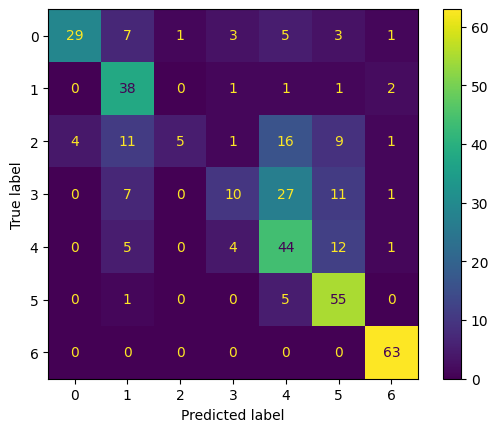

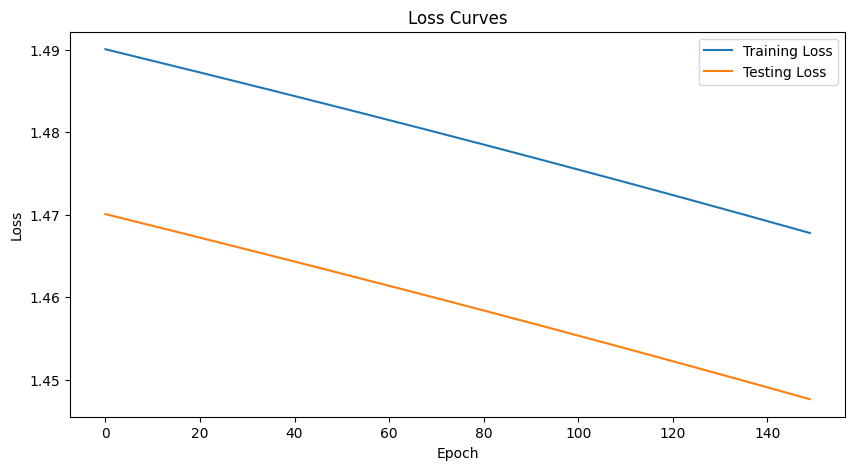

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.482 | Train Acc: 59.18% | Test NLL: 1.447 | Test Acc: 63.38%
Epoch 02 | Train NLL: 1.472 | Train Acc: 59.31% | Test NLL: 1.446 | Test Acc: 62.86%
Epoch 03 | Train NLL: 1.469 | Train Acc: 59.70% | Test NLL: 1.446 | Test Acc: 63.12%
Epoch 04 | Train NLL: 1.473 | Train Acc: 59.51% | Test NLL: 1.445 | Test Acc: 63.38%
Epoch 05 | Train NLL: 1.464 | Train Acc: 59.64% | Test NLL: 1.445 | Test Acc: 63.38%
Epoch 06 | Train NLL: 1.457 | Train Acc: 59.77% | Test NLL: 1.444 | Test Acc: 63.64%
Epoch 07 | Train NLL: 1.503 | Train Acc: 59.77% | Test NLL: 1.444 | Test Acc: 63.38%
Epoch 08 | Train NLL: 1.457 | Train Acc: 59.24% | Test NLL: 1.443 | Test Acc: 63.38%
Epoch 09 | Train NLL: 1.460 | Train Acc: 59.11% | Test NLL: 1.442 | Test Acc: 63.38%
Epoch 10 | Train NLL: 1.442 | Train Acc: 59.31% | Test NLL: 1.442 | Test Acc: 63.38%
Epoch 11 | Train NLL: 1.455 | Train Acc: 59.11% | Test NLL: 1.441 

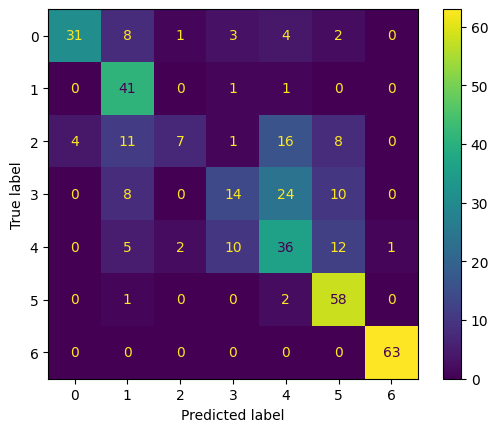

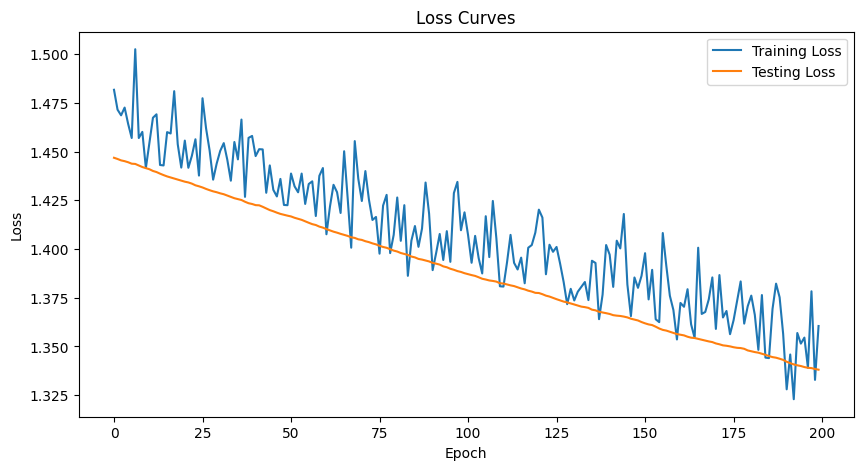

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.356 | Train Acc: 62.30% | Test NLL: 1.338 | Test Acc: 64.94%
Epoch 02 | Train NLL: 1.350 | Train Acc: 62.30% | Test NLL: 1.338 | Test Acc: 64.94%
Epoch 03 | Train NLL: 1.351 | Train Acc: 62.30% | Test NLL: 1.337 | Test Acc: 64.94%
Epoch 04 | Train NLL: 1.349 | Train Acc: 62.17% | Test NLL: 1.337 | Test Acc: 64.94%
Epoch 05 | Train NLL: 1.355 | Train Acc: 62.30% | Test NLL: 1.337 | Test Acc: 64.94%
Epoch 06 | Train NLL: 1.351 | Train Acc: 62.30% | Test NLL: 1.337 | Test Acc: 64.94%
Epoch 07 | Train NLL: 1.349 | Train Acc: 62.30% | Test NLL: 1.337 | Test Acc: 64.94%
Epoch 08 | Train NLL: 1.356 | Train Acc: 62.43% | Test NLL: 1.336 | Test Acc: 64.94%
Epoch 09 | Train NLL: 1.351 | Train Acc: 62.43% | Test NLL: 1.336 | Test Acc: 64.94%
Epoch 10 | Train NLL: 1.352 | Train Acc: 62.43% | Test NLL: 1.336 | Test Acc: 64.94%
Epoch 11 | Train NLL: 1.349 | Train Acc: 62.57% | Test NLL: 1.336

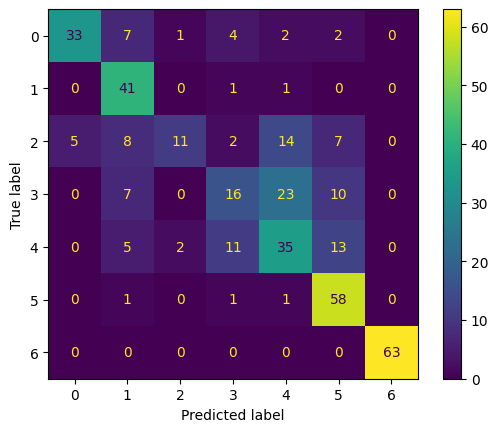

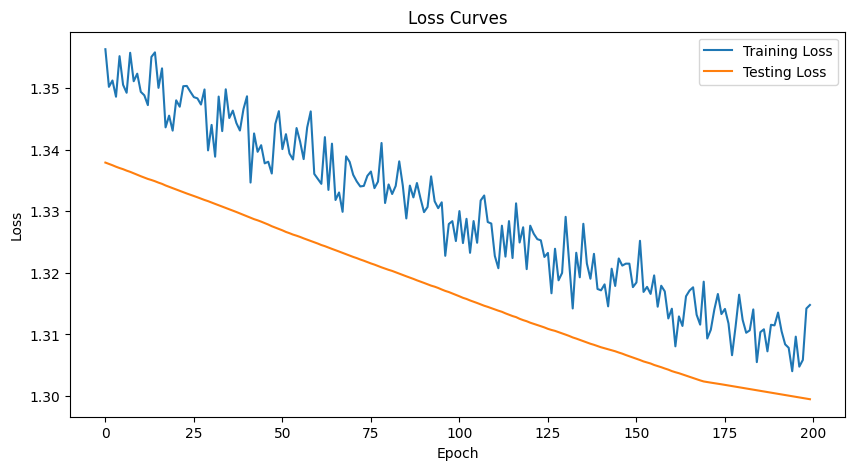

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.309 | Train Acc: 65.43% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 02 | Train NLL: 1.309 | Train Acc: 65.43% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 03 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 04 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 05 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 06 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 07 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 08 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 09 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 10 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299 | Test Acc: 66.75%
Epoch 11 | Train NLL: 1.309 | Train Acc: 65.49% | Test NLL: 1.299

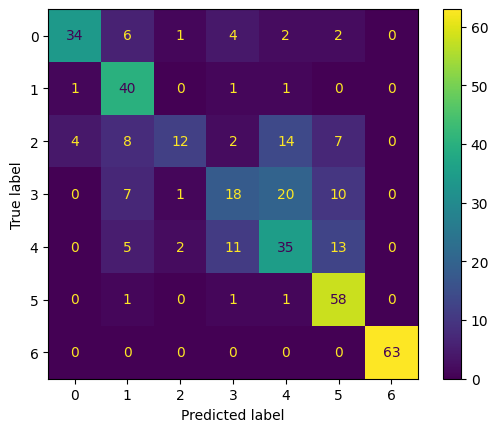

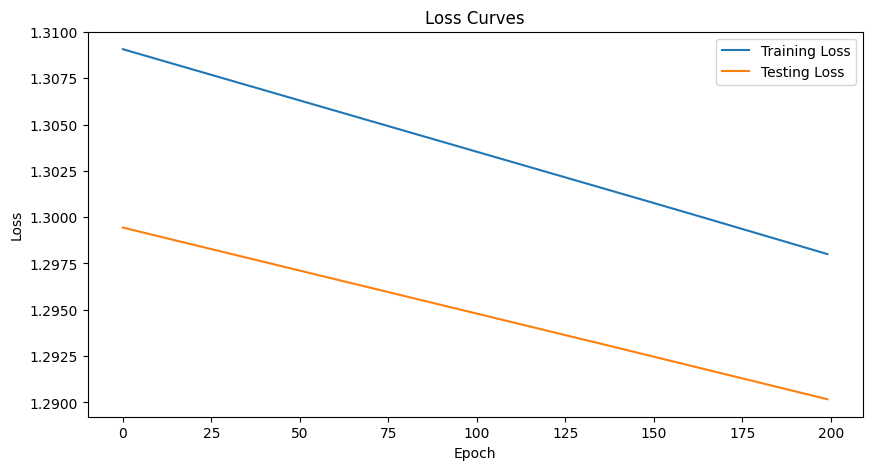

**************************************************



In [38]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 128

num_classes = 7

pytorchNet = SimplePytorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Tanh(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.SGD(pytorchNet.parameters(), lr=0.005),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=2621, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=7, bias=True)
  (activation3): ReLU()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.938 | Train Acc: 16.54% | Test NLL: 1.926 | Test Acc: 19.48%
Epoch 02 | Train NLL: 1.907 | Train Acc: 33.33% | Test NLL: 1.892 | Test Acc: 33.77%
Epoch 03 | Train NLL: 1.822 | Train Acc: 47.07% | Test NLL: 1.834 | Test Acc: 37.92%
Epoch 04 | Train NLL: 1.662 | Train Acc: 48.96% | Test NLL: 1.742 | Test Acc: 40.00%
Epoch 05 | Train NLL: 1.514 | Train Acc: 53.97% | Test NLL: 1.630 | Test Acc: 44.16%
Epoch 06 | Train NLL: 1.325 | Train Acc: 60.03% | Test NLL: 1.534 | Test Acc: 46.75%
Epoch 07 | Train NLL: 1.082 | Train Acc: 62.43% | Test NLL: 1.516 | Test Acc: 45.97%
Epoch 08 | Train NLL: 0.961 | Train Acc: 63.48% | Test NLL: 1.539 | Test Acc: 45.19%
Epoch 09 | Trai

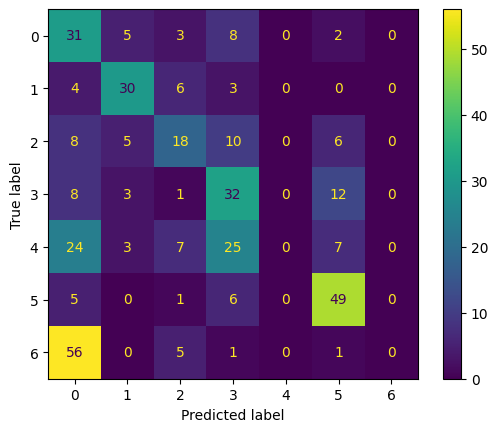

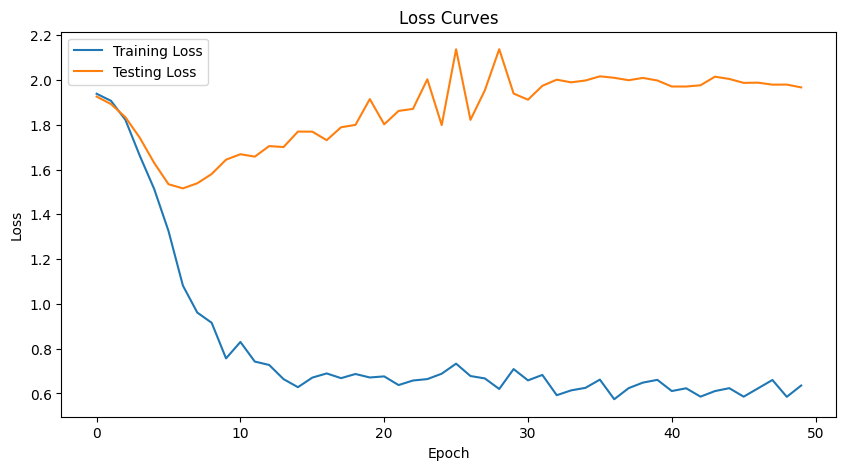

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.621 | Train Acc: 67.84% | Test NLL: 1.953 | Test Acc: 41.56%
Epoch 02 | Train NLL: 0.626 | Train Acc: 67.84% | Test NLL: 1.957 | Test Acc: 41.82%
Epoch 03 | Train NLL: 0.635 | Train Acc: 67.84% | Test NLL: 1.968 | Test Acc: 41.56%
Epoch 04 | Train NLL: 0.618 | Train Acc: 67.84% | Test NLL: 1.975 | Test Acc: 41.56%
Epoch 05 | Train NLL: 0.636 | Train Acc: 67.84% | Test NLL: 1.974 | Test Acc: 41.56%
Epoch 06 | Train NLL: 0.641 | Train Acc: 67.84% | Test NLL: 1.962 | Test Acc: 41.56%
Epoch 07 | Train NLL: 0.632 | Train Acc: 67.84% | Test NLL: 1.963 | Test Acc: 41.56%
Epoch 08 | Train NLL: 0.636 | Train Acc: 67.84% | Test NLL: 1.972 | Test Acc: 41.56%
Epoch 09 | Train NLL: 0.622 | Train Acc: 67.84% | Test NLL: 1.972 | Test Acc: 41.56%
Epoch 10 | Train NLL: 0.635 | Train Acc: 67.84% | Test NLL: 1.973 | Test Acc: 41.56%
Epoch 11 | Train NLL: 0.647 | Train Acc: 67.84% | Test NLL: 1.977 

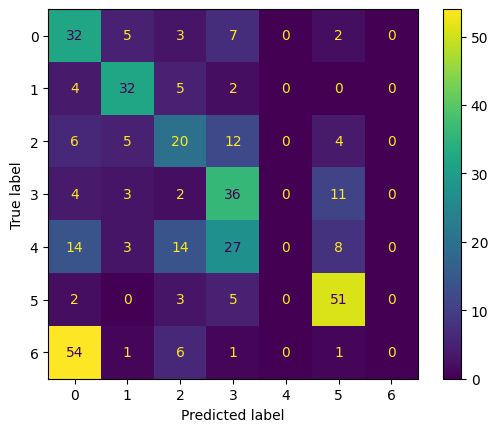

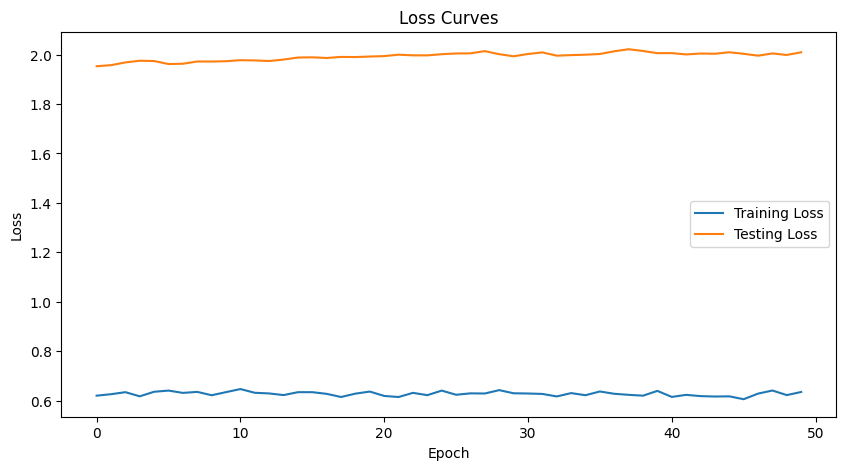

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.007 | Test Acc: 44.42%
Epoch 02 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.004 | Test Acc: 44.16%
Epoch 03 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.004 | Test Acc: 44.16%
Epoch 04 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.006 | Test Acc: 44.16%
Epoch 05 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.005 | Test Acc: 44.16%
Epoch 06 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.008 | Test Acc: 44.42%
Epoch 07 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.012 | Test Acc: 44.42%
Epoch 08 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.008 | Test Acc: 44.42%
Epoch 09 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.008 | Test Acc: 44.16%
Epoch 10 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.013 | Test Acc: 44.16%
Epoch 11 | Train NLL: 0.627 | Train Acc: 67.90% | Test NLL: 2.018 

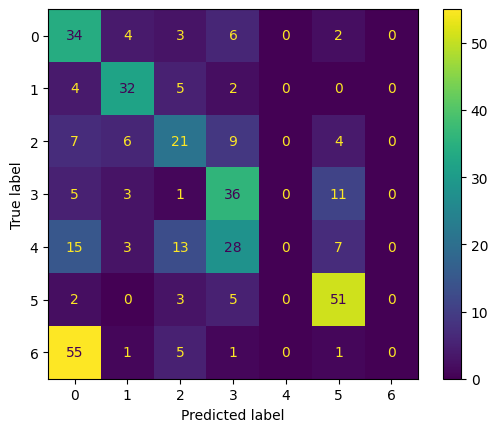

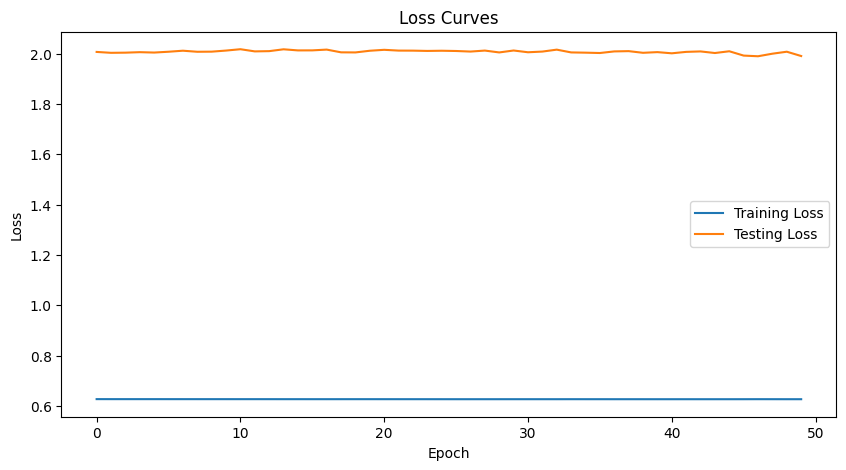

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.670 | Train Acc: 67.90% | Test NLL: 1.999 | Test Acc: 45.19%
Epoch 02 | Train NLL: 0.595 | Train Acc: 67.90% | Test NLL: 2.001 | Test Acc: 45.19%
Epoch 03 | Train NLL: 0.608 | Train Acc: 67.90% | Test NLL: 2.003 | Test Acc: 45.19%
Epoch 04 | Train NLL: 0.583 | Train Acc: 67.90% | Test NLL: 1.952 | Test Acc: 45.45%
Epoch 05 | Train NLL: 0.658 | Train Acc: 67.90% | Test NLL: 1.994 | Test Acc: 44.68%
Epoch 06 | Train NLL: 0.609 | Train Acc: 67.90% | Test NLL: 1.918 | Test Acc: 44.42%
Epoch 07 | Train NLL: 0.584 | Train Acc: 67.90% | Test NLL: 2.020 | Test Acc: 44.42%
Epoch 08 | Train NLL: 0.697 | Train Acc: 67.90% | Test NLL: 1.920 | Test Acc: 44.68%
Epoch 09 | Train NLL: 0.634 | Train Acc: 67.90% | Test NLL: 1.958 | Test Acc: 45.19%
Epoch 10 | Train NLL: 0.633 | Train Acc: 67.90% | Test NLL: 1.944 | Test Acc: 44.68%
Epoch 11 | Train NLL: 0.621 | Train Acc: 67.90% | Test NLL: 1.985 

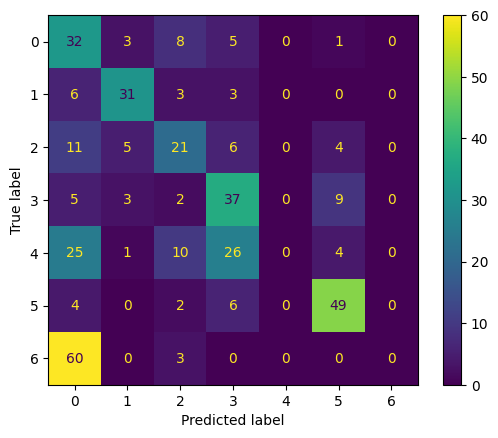

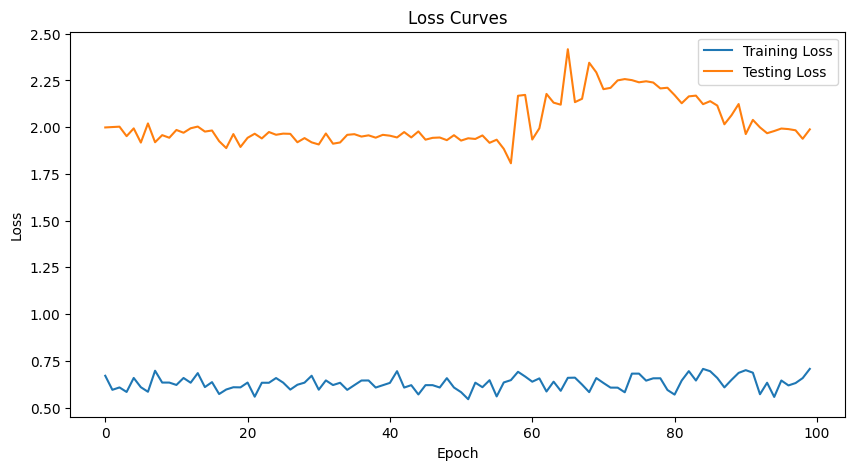

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.622 | Train Acc: 67.97% | Test NLL: 2.026 | Test Acc: 44.42%
Epoch 02 | Train NLL: 0.633 | Train Acc: 67.97% | Test NLL: 2.043 | Test Acc: 44.16%
Epoch 03 | Train NLL: 0.624 | Train Acc: 67.97% | Test NLL: 2.037 | Test Acc: 44.68%
Epoch 04 | Train NLL: 0.640 | Train Acc: 67.97% | Test NLL: 2.031 | Test Acc: 44.16%
Epoch 05 | Train NLL: 0.620 | Train Acc: 67.97% | Test NLL: 2.025 | Test Acc: 43.64%
Epoch 06 | Train NLL: 0.618 | Train Acc: 67.97% | Test NLL: 2.025 | Test Acc: 44.16%
Epoch 07 | Train NLL: 0.631 | Train Acc: 67.97% | Test NLL: 2.032 | Test Acc: 44.16%
Epoch 08 | Train NLL: 0.615 | Train Acc: 68.03% | Test NLL: 2.045 | Test Acc: 43.38%
Epoch 09 | Train NLL: 0.630 | Train Acc: 68.03% | Test NLL: 2.052 | Test Acc: 43.38%
Epoch 10 | Train NLL: 0.635 | Train Acc: 68.03% | Test NLL: 2.022 | Test Acc: 43.90%
Epoch 11 | Train NLL: 0.628 | Train Acc: 68.03% | Test NLL: 2.007

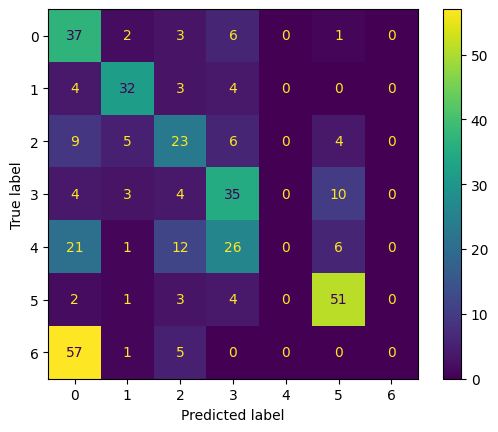

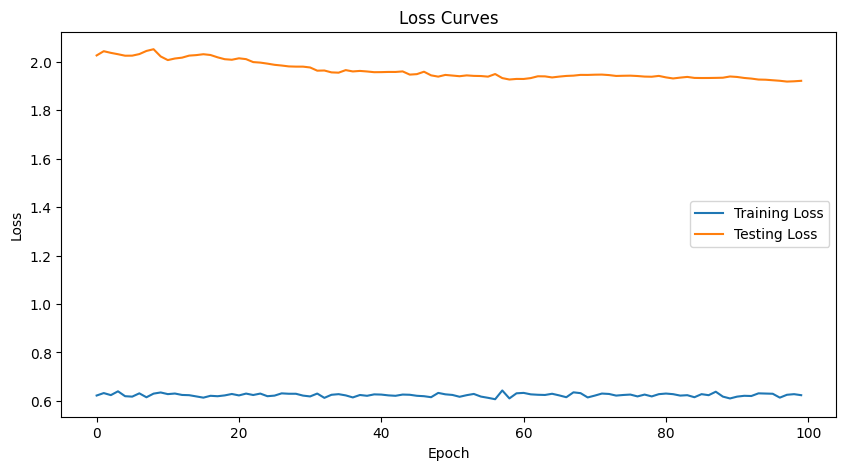

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.920 | Test Acc: 46.23%
Epoch 02 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.920 | Test Acc: 46.49%
Epoch 03 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.919 | Test Acc: 46.49%
Epoch 04 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.919 | Test Acc: 46.49%
Epoch 05 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.916 | Test Acc: 46.49%
Epoch 06 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.915 | Test Acc: 46.49%
Epoch 07 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.916 | Test Acc: 46.49%
Epoch 08 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.916 | Test Acc: 46.49%
Epoch 09 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.918 | Test Acc: 46.75%
Epoch 10 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.918 | Test Acc: 46.75%
Epoch 11 | Train NLL: 0.623 | Train Acc: 68.03% | Test NLL: 1.915

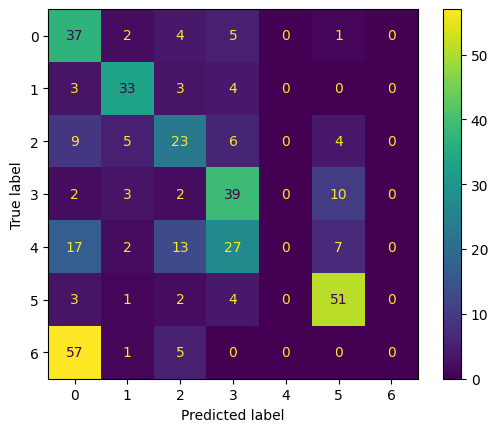

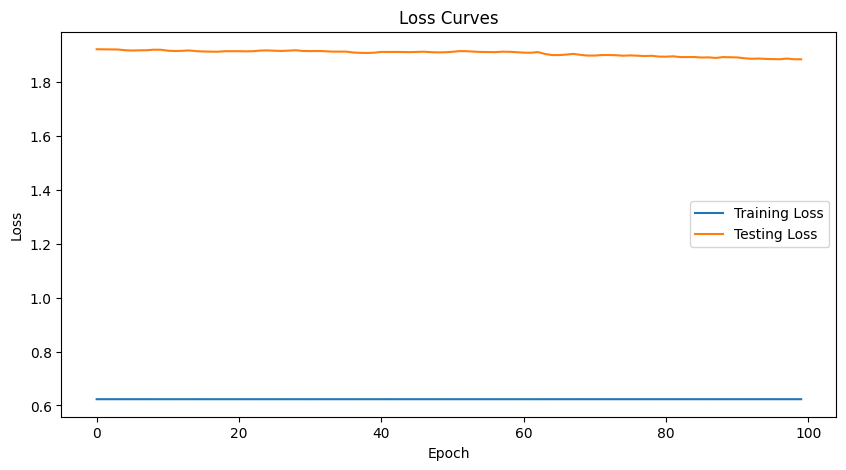

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.605 | Train Acc: 68.03% | Test NLL: 1.882 | Test Acc: 47.53%
Epoch 02 | Train NLL: 0.617 | Train Acc: 68.03% | Test NLL: 1.868 | Test Acc: 47.01%
Epoch 03 | Train NLL: 0.593 | Train Acc: 68.03% | Test NLL: 1.849 | Test Acc: 47.27%
Epoch 04 | Train NLL: 0.580 | Train Acc: 68.03% | Test NLL: 1.880 | Test Acc: 45.45%
Epoch 05 | Train NLL: 0.656 | Train Acc: 68.03% | Test NLL: 1.812 | Test Acc: 47.53%
Epoch 06 | Train NLL: 0.643 | Train Acc: 68.03% | Test NLL: 1.873 | Test Acc: 46.23%
Epoch 07 | Train NLL: 0.656 | Train Acc: 68.03% | Test NLL: 1.862 | Test Acc: 47.01%
Epoch 08 | Train NLL: 0.656 | Train Acc: 68.03% | Test NLL: 1.838 | Test Acc: 47.01%
Epoch 09 | Train NLL: 0.568 | Train Acc: 68.03% | Test NLL: 1.842 | Test Acc: 46.23%
Epoch 10 | Train NLL: 0.594 | Train Acc: 68.03% | Test NLL: 1.844 | Test Acc: 47.01%
Epoch 11 | Train NLL: 0.648 | Train Acc: 68.03% | Test NLL: 1.972 

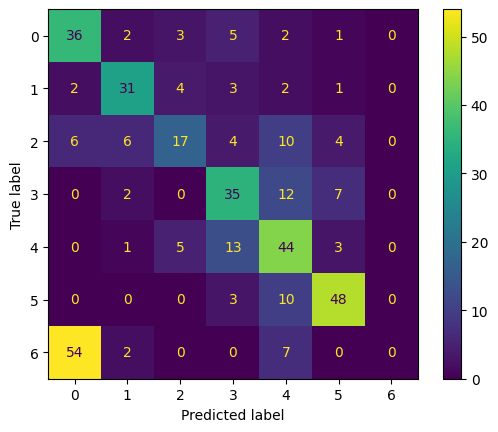

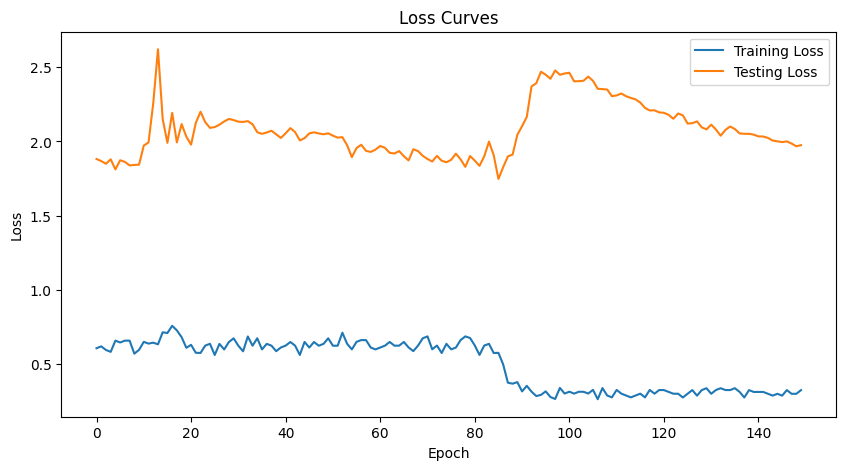

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.300 | Train Acc: 84.44% | Test NLL: 1.977 | Test Acc: 54.81%
Epoch 02 | Train NLL: 0.308 | Train Acc: 84.44% | Test NLL: 1.973 | Test Acc: 55.58%
Epoch 03 | Train NLL: 0.298 | Train Acc: 84.44% | Test NLL: 1.969 | Test Acc: 55.32%
Epoch 04 | Train NLL: 0.308 | Train Acc: 84.44% | Test NLL: 1.959 | Test Acc: 55.32%
Epoch 05 | Train NLL: 0.301 | Train Acc: 84.44% | Test NLL: 1.953 | Test Acc: 55.32%
Epoch 06 | Train NLL: 0.322 | Train Acc: 84.44% | Test NLL: 1.957 | Test Acc: 55.32%
Epoch 07 | Train NLL: 0.295 | Train Acc: 84.44% | Test NLL: 1.961 | Test Acc: 54.81%
Epoch 08 | Train NLL: 0.294 | Train Acc: 84.44% | Test NLL: 1.963 | Test Acc: 55.06%
Epoch 09 | Train NLL: 0.301 | Train Acc: 84.44% | Test NLL: 1.965 | Test Acc: 55.06%
Epoch 10 | Train NLL: 0.304 | Train Acc: 84.44% | Test NLL: 1.965 | Test Acc: 55.06%
Epoch 11 | Train NLL: 0.308 | Train Acc: 84.44% | Test NLL: 1.962

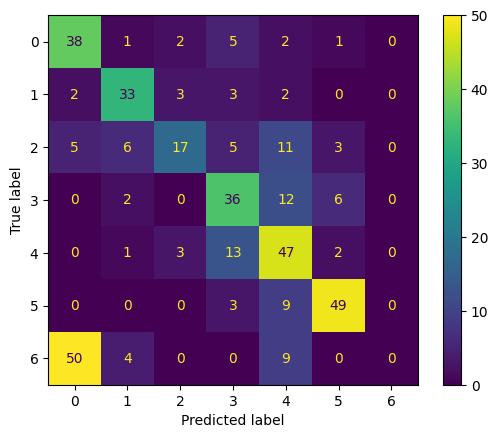

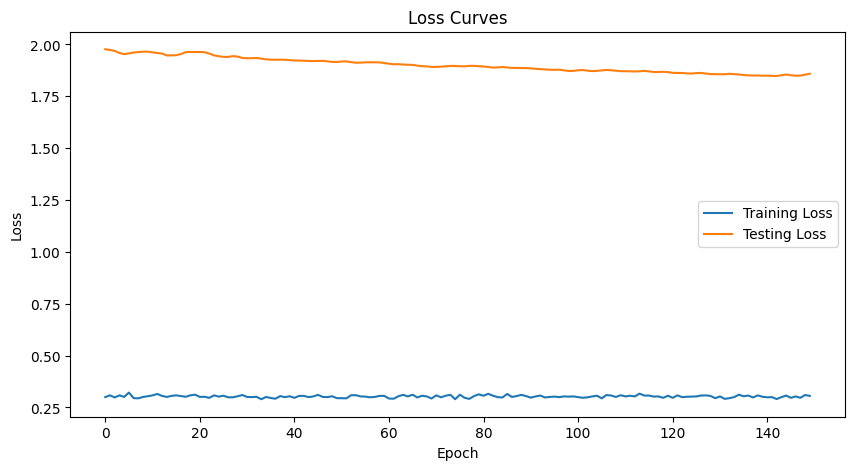

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.860 | Test Acc: 57.40%
Epoch 02 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.860 | Test Acc: 57.14%
Epoch 03 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.859 | Test Acc: 57.40%
Epoch 04 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.856 | Test Acc: 57.40%
Epoch 05 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.855 | Test Acc: 57.66%
Epoch 06 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.853 | Test Acc: 57.92%
Epoch 07 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.852 | Test Acc: 57.66%
Epoch 08 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.850 | Test Acc: 57.66%
Epoch 09 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.849 | Test Acc: 57.66%
Epoch 10 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.849 | Test Acc: 57.66%
Epoch 11 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.849

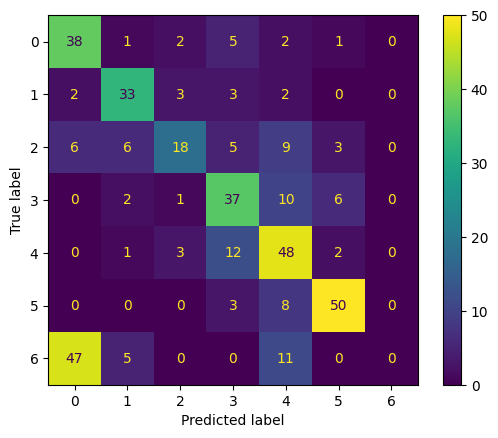

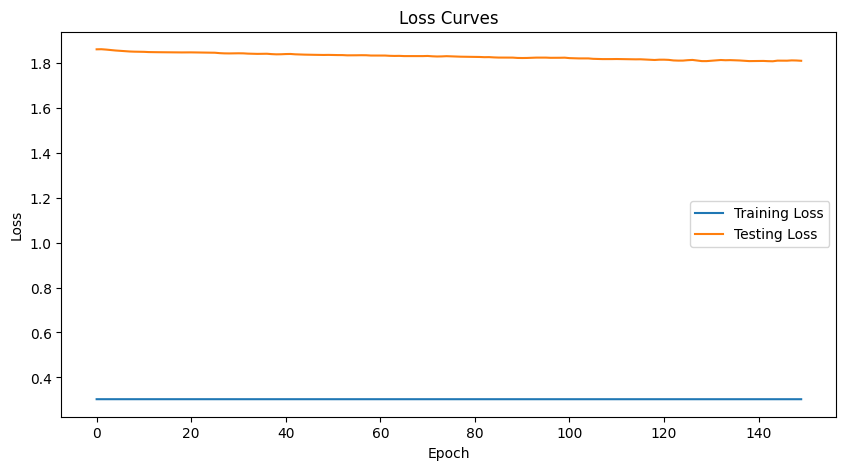

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.333 | Train Acc: 84.51% | Test NLL: 1.799 | Test Acc: 58.18%
Epoch 02 | Train NLL: 0.321 | Train Acc: 84.51% | Test NLL: 1.793 | Test Acc: 58.18%
Epoch 03 | Train NLL: 0.321 | Train Acc: 84.51% | Test NLL: 1.806 | Test Acc: 58.18%
Epoch 04 | Train NLL: 0.309 | Train Acc: 84.51% | Test NLL: 1.819 | Test Acc: 57.66%
Epoch 05 | Train NLL: 0.309 | Train Acc: 84.51% | Test NLL: 1.791 | Test Acc: 57.66%
Epoch 06 | Train NLL: 0.321 | Train Acc: 84.51% | Test NLL: 1.815 | Test Acc: 57.92%
Epoch 07 | Train NLL: 0.346 | Train Acc: 84.51% | Test NLL: 1.822 | Test Acc: 57.92%
Epoch 08 | Train NLL: 0.347 | Train Acc: 84.51% | Test NLL: 1.802 | Test Acc: 57.92%
Epoch 09 | Train NLL: 0.347 | Train Acc: 84.51% | Test NLL: 1.821 | Test Acc: 57.14%
Epoch 10 | Train NLL: 0.284 | Train Acc: 84.51% | Test NLL: 1.893 | Test Acc: 57.14%
Epoch 11 | Train NLL: 0.259 | Train Acc: 84.51% | Test NLL: 1.859 

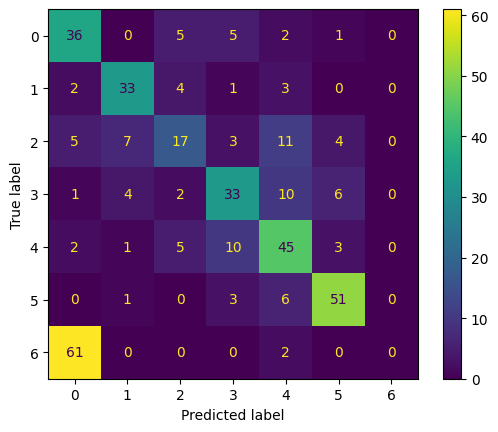

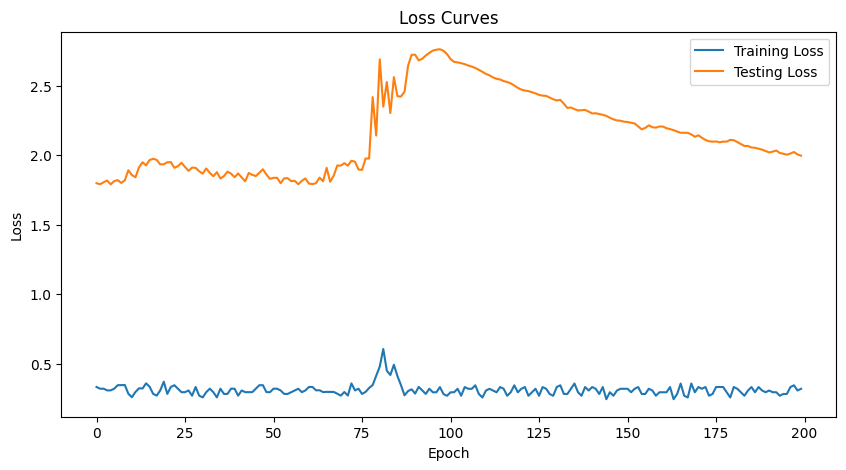

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.305 | Train Acc: 84.51% | Test NLL: 1.999 | Test Acc: 55.58%
Epoch 02 | Train NLL: 0.303 | Train Acc: 84.51% | Test NLL: 1.997 | Test Acc: 55.58%
Epoch 03 | Train NLL: 0.306 | Train Acc: 84.51% | Test NLL: 1.994 | Test Acc: 55.58%
Epoch 04 | Train NLL: 0.300 | Train Acc: 84.51% | Test NLL: 1.992 | Test Acc: 55.58%
Epoch 05 | Train NLL: 0.292 | Train Acc: 84.51% | Test NLL: 1.991 | Test Acc: 55.58%
Epoch 06 | Train NLL: 0.304 | Train Acc: 84.51% | Test NLL: 1.990 | Test Acc: 55.58%
Epoch 07 | Train NLL: 0.296 | Train Acc: 84.51% | Test NLL: 1.988 | Test Acc: 55.58%
Epoch 08 | Train NLL: 0.304 | Train Acc: 84.51% | Test NLL: 1.986 | Test Acc: 55.84%
Epoch 09 | Train NLL: 0.297 | Train Acc: 84.51% | Test NLL: 1.987 | Test Acc: 56.10%
Epoch 10 | Train NLL: 0.302 | Train Acc: 84.51% | Test NLL: 1.987 | Test Acc: 55.84%
Epoch 11 | Train NLL: 0.308 | Train Acc: 84.51% | Test NLL: 1.983

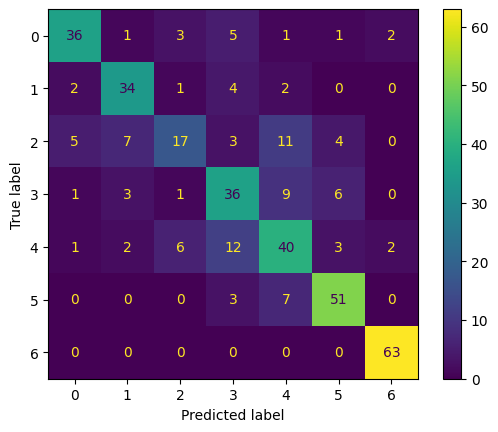

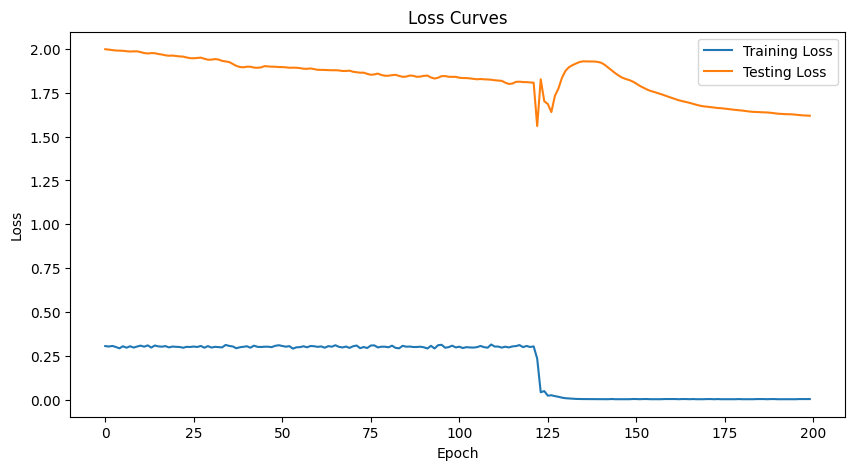

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.618 | Test Acc: 72.21%
Epoch 02 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.618 | Test Acc: 72.21%
Epoch 03 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.617 | Test Acc: 72.21%
Epoch 04 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.617 | Test Acc: 72.21%
Epoch 05 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.616 | Test Acc: 72.21%
Epoch 06 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.615 | Test Acc: 72.21%
Epoch 07 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.614 | Test Acc: 72.21%
Epoch 08 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.614 | Test Acc: 72.21%
Epoch 09 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.613 | Test Acc: 72.21%
Epoch 10 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.612 | Test Acc: 72.21%
Epoch 11 | Train NLL: 0.002 | Train Acc: 99.93% | Test NLL: 1.611

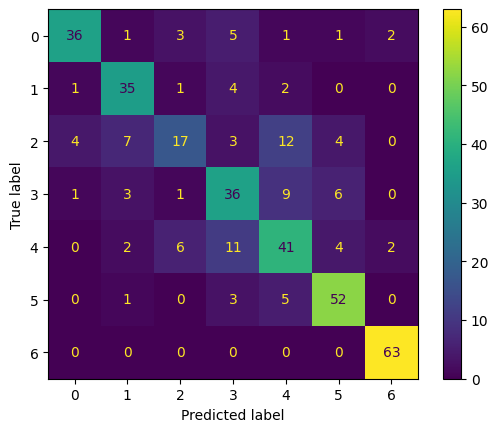

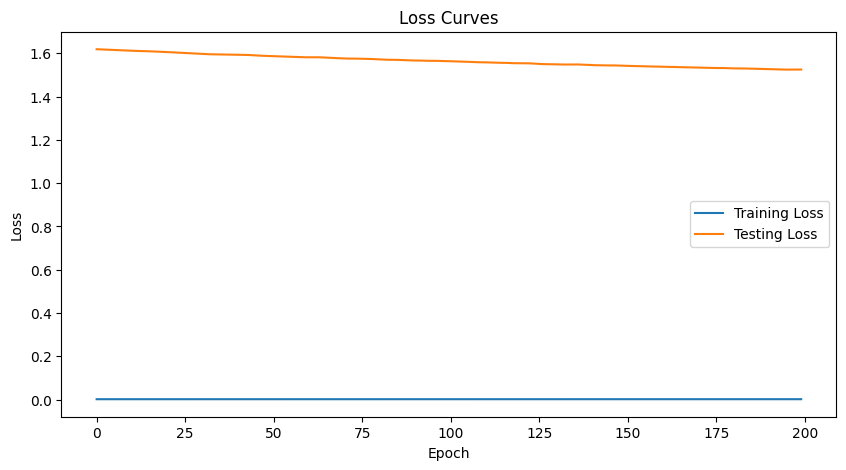

**************************************************



In [39]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 64

num_classes = 7

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.ReLU(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=2621, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=7, bias=True)
  (activation3): Sigmoid()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.942 | Train Acc: 16.34% | Test NLL: 1.936 | Test Acc: 17.40%
Epoch 02 | Train NLL: 1.920 | Train Acc: 29.88% | Test NLL: 1.906 | Test Acc: 41.30%
Epoch 03 | Train NLL: 1.875 | Train Acc: 56.25% | Test NLL: 1.852 | Test Acc: 44.42%
Epoch 04 | Train NLL: 1.811 | Train Acc: 47.01% | Test NLL: 1.780 | Test Acc: 42.08%
Epoch 05 | Train NLL: 1.704 | Train Acc: 49.61% | Test NLL: 1.702 | Test Acc: 48.57%
Epoch 06 | Train NLL: 1.625 | Train Acc: 59.83% | Test NLL: 1.633 | Test Acc: 55.06%
Epoch 07 | Train NLL: 1.519 | Train Acc: 67.32% | Test NLL: 1.588 | Test Acc: 55.58%
Epoch 08 | Train NLL: 1.462 | Train Acc: 75.07% | Test NLL: 1.561 | Test Acc: 57.66%
Epoch 09 | T

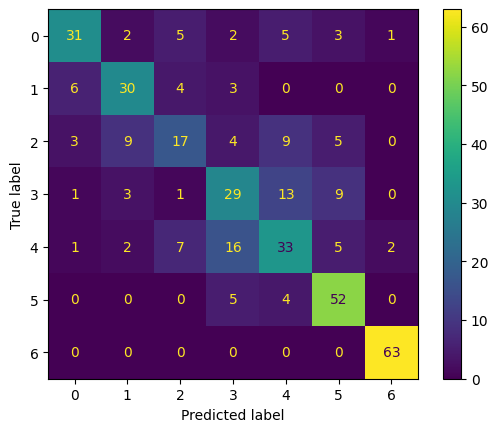

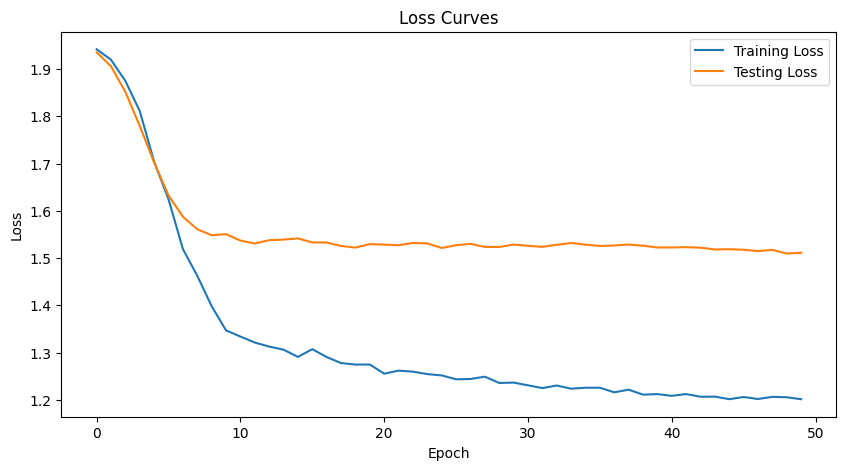

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.200 | Train Acc: 94.27% | Test NLL: 1.514 | Test Acc: 64.68%
Epoch 02 | Train NLL: 1.200 | Train Acc: 93.88% | Test NLL: 1.514 | Test Acc: 64.16%
Epoch 03 | Train NLL: 1.200 | Train Acc: 93.88% | Test NLL: 1.508 | Test Acc: 66.49%
Epoch 04 | Train NLL: 1.199 | Train Acc: 94.34% | Test NLL: 1.506 | Test Acc: 66.49%
Epoch 05 | Train NLL: 1.197 | Train Acc: 94.34% | Test NLL: 1.504 | Test Acc: 64.94%
Epoch 06 | Train NLL: 1.196 | Train Acc: 94.21% | Test NLL: 1.504 | Test Acc: 64.42%
Epoch 07 | Train NLL: 1.195 | Train Acc: 94.27% | Test NLL: 1.504 | Test Acc: 65.45%
Epoch 08 | Train NLL: 1.194 | Train Acc: 94.66% | Test NLL: 1.504 | Test Acc: 65.19%
Epoch 09 | Train NLL: 1.193 | Train Acc: 94.73% | Test NLL: 1.505 | Test Acc: 65.19%
Epoch 10 | Train NLL: 1.193 | Train Acc: 94.66% | Test NLL: 1.506 | Test Acc: 65.19%
Epoch 11 | Train NLL: 1.192 | Train Acc: 94.73% | Test NLL: 1.507 

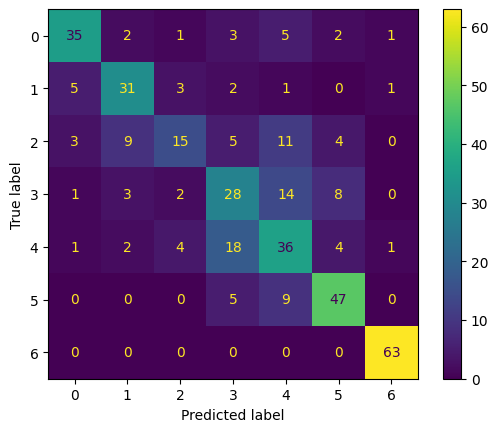

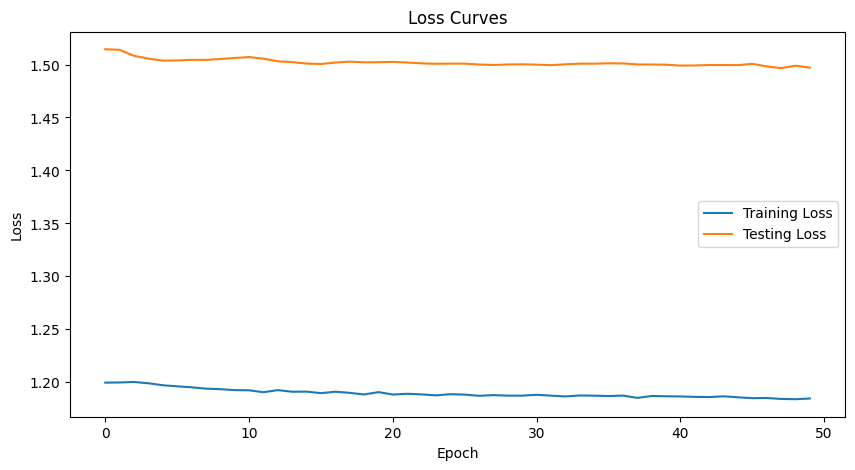

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.185 | Train Acc: 95.96% | Test NLL: 1.495 | Test Acc: 65.71%
Epoch 02 | Train NLL: 1.185 | Train Acc: 95.90% | Test NLL: 1.495 | Test Acc: 66.23%
Epoch 03 | Train NLL: 1.185 | Train Acc: 95.90% | Test NLL: 1.497 | Test Acc: 66.23%
Epoch 04 | Train NLL: 1.184 | Train Acc: 95.96% | Test NLL: 1.499 | Test Acc: 65.71%
Epoch 05 | Train NLL: 1.184 | Train Acc: 96.09% | Test NLL: 1.499 | Test Acc: 65.97%
Epoch 06 | Train NLL: 1.184 | Train Acc: 96.09% | Test NLL: 1.498 | Test Acc: 66.23%
Epoch 07 | Train NLL: 1.184 | Train Acc: 96.03% | Test NLL: 1.495 | Test Acc: 66.23%
Epoch 08 | Train NLL: 1.184 | Train Acc: 96.03% | Test NLL: 1.495 | Test Acc: 66.49%
Epoch 09 | Train NLL: 1.184 | Train Acc: 96.09% | Test NLL: 1.497 | Test Acc: 66.49%
Epoch 10 | Train NLL: 1.184 | Train Acc: 96.03% | Test NLL: 1.499 | Test Acc: 65.45%
Epoch 11 | Train NLL: 1.184 | Train Acc: 96.03% | Test NLL: 1.499 

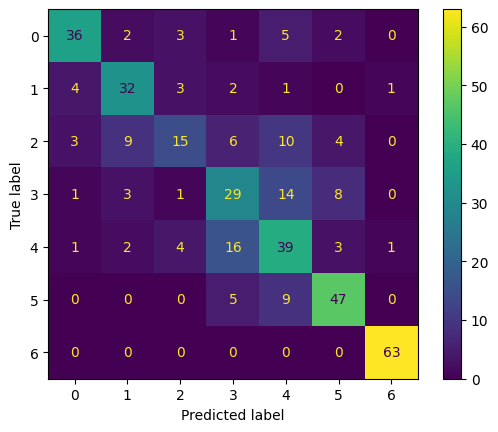

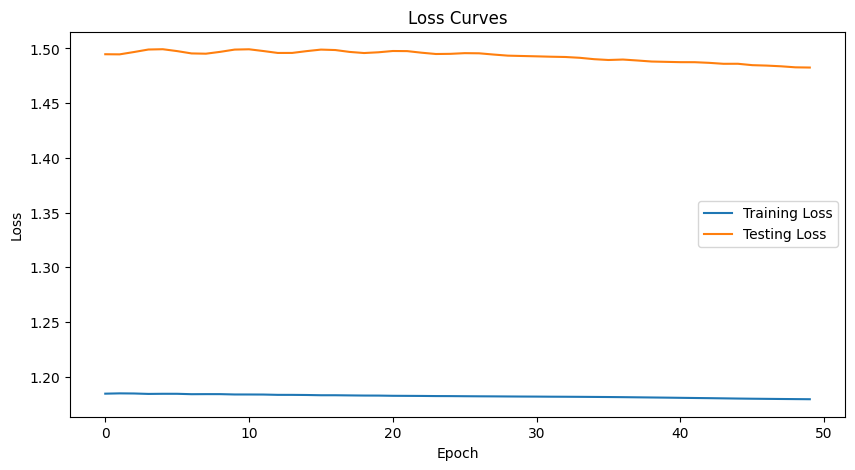

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.179 | Train Acc: 97.33% | Test NLL: 1.481 | Test Acc: 67.01%
Epoch 02 | Train NLL: 1.178 | Train Acc: 97.40% | Test NLL: 1.478 | Test Acc: 67.79%
Epoch 03 | Train NLL: 1.183 | Train Acc: 97.40% | Test NLL: 1.479 | Test Acc: 68.31%
Epoch 04 | Train NLL: 1.178 | Train Acc: 97.46% | Test NLL: 1.475 | Test Acc: 68.31%
Epoch 05 | Train NLL: 1.183 | Train Acc: 97.59% | Test NLL: 1.475 | Test Acc: 68.31%
Epoch 06 | Train NLL: 1.178 | Train Acc: 97.59% | Test NLL: 1.475 | Test Acc: 69.35%
Epoch 07 | Train NLL: 1.177 | Train Acc: 97.59% | Test NLL: 1.477 | Test Acc: 67.53%
Epoch 08 | Train NLL: 1.177 | Train Acc: 97.66% | Test NLL: 1.475 | Test Acc: 69.09%
Epoch 09 | Train NLL: 1.189 | Train Acc: 97.59% | Test NLL: 1.475 | Test Acc: 68.83%
Epoch 10 | Train NLL: 1.177 | Train Acc: 97.66% | Test NLL: 1.480 | Test Acc: 67.79%
Epoch 11 | Train NLL: 1.183 | Train Acc: 97.66% | Test NLL: 1.482 

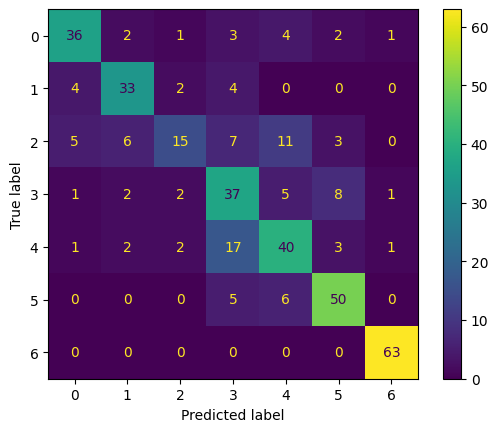

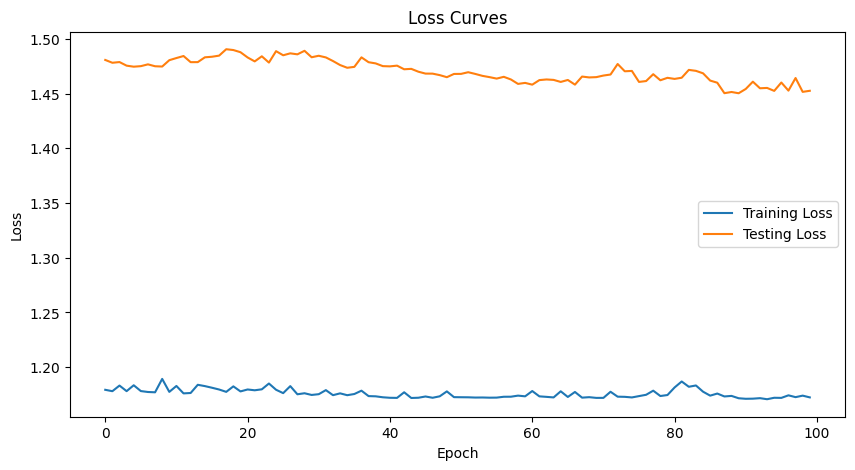

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.173 | Train Acc: 99.61% | Test NLL: 1.464 | Test Acc: 69.87%
Epoch 02 | Train NLL: 1.172 | Train Acc: 99.67% | Test NLL: 1.456 | Test Acc: 69.09%
Epoch 03 | Train NLL: 1.171 | Train Acc: 99.61% | Test NLL: 1.455 | Test Acc: 70.13%
Epoch 04 | Train NLL: 1.171 | Train Acc: 99.54% | Test NLL: 1.455 | Test Acc: 71.95%
Epoch 05 | Train NLL: 1.171 | Train Acc: 99.54% | Test NLL: 1.454 | Test Acc: 70.65%
Epoch 06 | Train NLL: 1.169 | Train Acc: 99.61% | Test NLL: 1.459 | Test Acc: 71.69%
Epoch 07 | Train NLL: 1.170 | Train Acc: 99.67% | Test NLL: 1.465 | Test Acc: 70.65%
Epoch 08 | Train NLL: 1.170 | Train Acc: 99.67% | Test NLL: 1.465 | Test Acc: 70.13%
Epoch 09 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.461 | Test Acc: 70.91%
Epoch 10 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.456 | Test Acc: 71.17%
Epoch 11 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.454

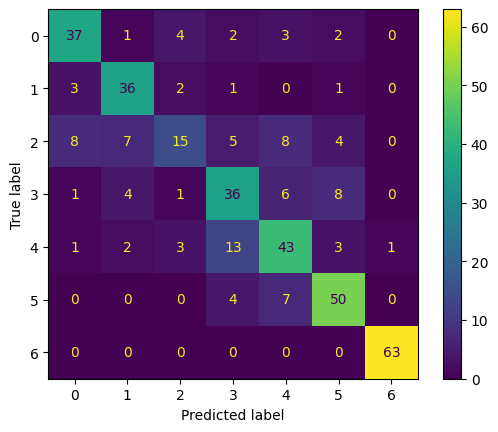

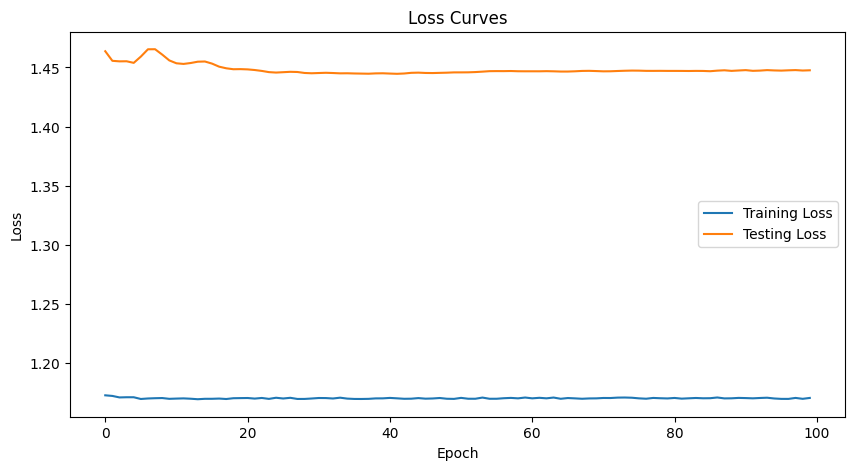

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448 | Test Acc: 72.73%
Epoch 02 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.99%
Epoch 03 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.99%
Epoch 04 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.99%
Epoch 05 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448 | Test Acc: 72.73%
Epoch 06 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448 | Test Acc: 72.73%
Epoch 07 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448 | Test Acc: 72.73%
Epoch 08 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448 | Test Acc: 72.73%
Epoch 09 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.99%
Epoch 10 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.99%
Epoch 11 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.448

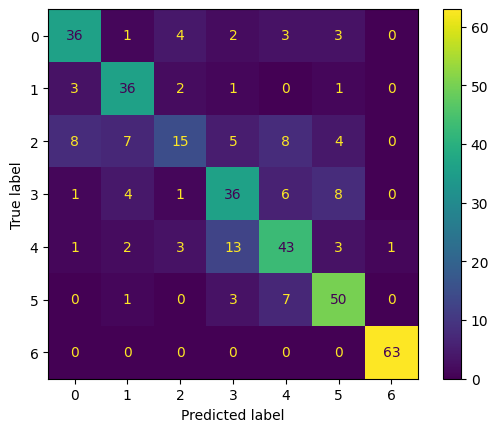

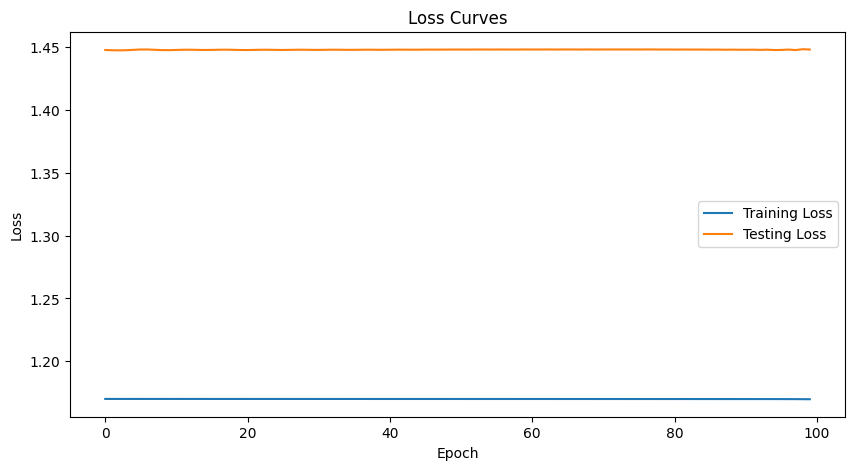

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.169 | Train Acc: 99.61% | Test NLL: 1.447 | Test Acc: 72.21%
Epoch 02 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.449 | Test Acc: 72.21%
Epoch 03 | Train NLL: 1.170 | Train Acc: 99.61% | Test NLL: 1.443 | Test Acc: 73.25%
Epoch 04 | Train NLL: 1.170 | Train Acc: 99.67% | Test NLL: 1.449 | Test Acc: 71.17%
Epoch 05 | Train NLL: 1.170 | Train Acc: 99.74% | Test NLL: 1.450 | Test Acc: 72.47%
Epoch 06 | Train NLL: 1.170 | Train Acc: 99.74% | Test NLL: 1.457 | Test Acc: 71.17%
Epoch 07 | Train NLL: 1.170 | Train Acc: 99.74% | Test NLL: 1.453 | Test Acc: 71.17%
Epoch 08 | Train NLL: 1.170 | Train Acc: 99.67% | Test NLL: 1.453 | Test Acc: 70.91%
Epoch 09 | Train NLL: 1.175 | Train Acc: 99.67% | Test NLL: 1.454 | Test Acc: 71.17%
Epoch 10 | Train NLL: 1.170 | Train Acc: 99.74% | Test NLL: 1.457 | Test Acc: 70.65%
Epoch 11 | Train NLL: 1.171 | Train Acc: 99.67% | Test NLL: 1.453 

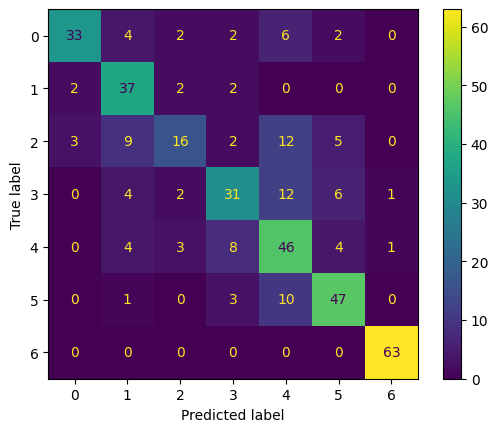

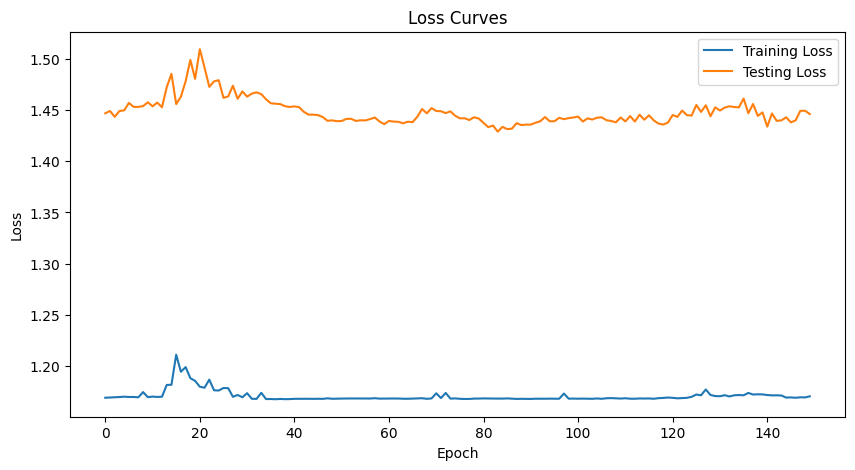

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.172 | Train Acc: 99.87% | Test NLL: 1.453 | Test Acc: 70.65%
Epoch 02 | Train NLL: 1.170 | Train Acc: 99.87% | Test NLL: 1.446 | Test Acc: 72.21%
Epoch 03 | Train NLL: 1.170 | Train Acc: 99.87% | Test NLL: 1.444 | Test Acc: 73.25%
Epoch 04 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.444 | Test Acc: 71.95%
Epoch 05 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.443 | Test Acc: 71.95%
Epoch 06 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.442 | Test Acc: 71.69%
Epoch 07 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.444 | Test Acc: 71.43%
Epoch 08 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.443 | Test Acc: 71.95%
Epoch 09 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.440 | Test Acc: 71.69%
Epoch 10 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.439 | Test Acc: 73.25%
Epoch 11 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.440

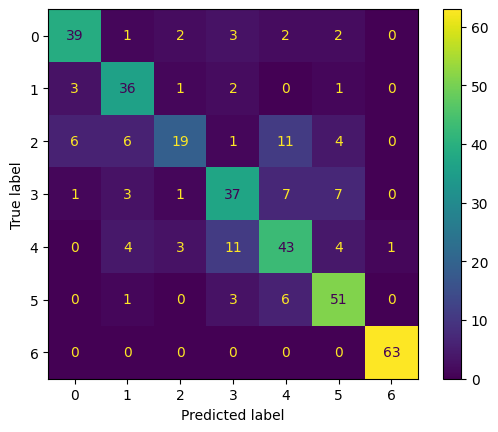

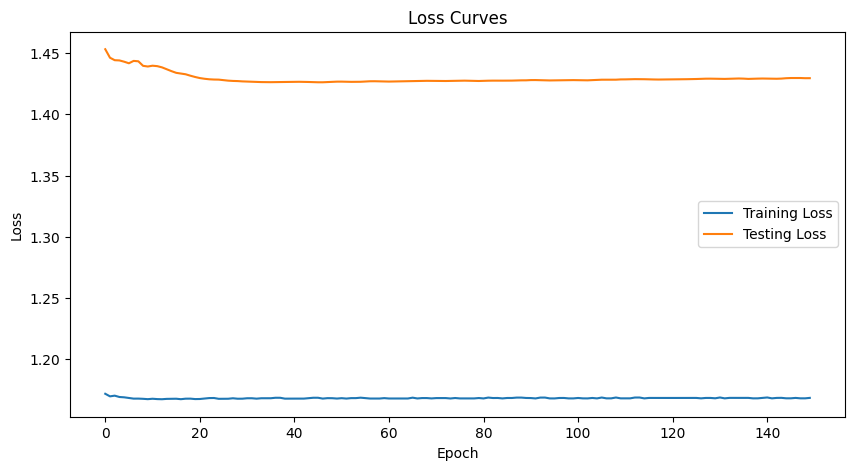

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.430 | Test Acc: 75.06%
Epoch 02 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.430 | Test Acc: 75.06%
Epoch 03 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 04 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 05 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 06 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 07 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 08 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 09 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 10 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.06%
Epoch 11 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.430

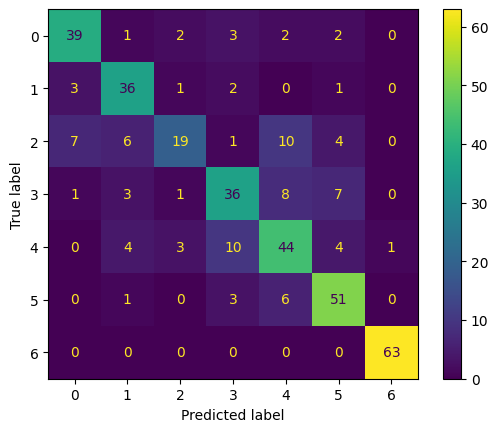

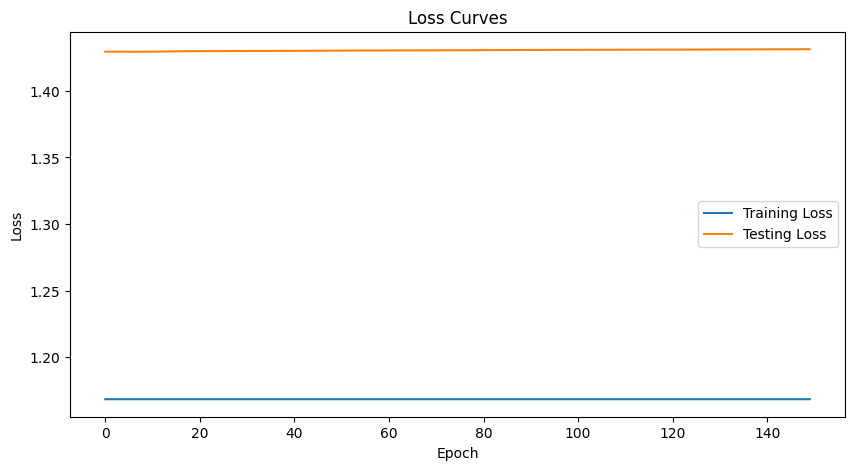

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.432 | Test Acc: 74.81%
Epoch 02 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.430 | Test Acc: 74.81%
Epoch 03 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.429 | Test Acc: 75.58%
Epoch 04 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.431 | Test Acc: 75.32%
Epoch 05 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.432 | Test Acc: 74.81%
Epoch 06 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.432 | Test Acc: 75.06%
Epoch 07 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.431 | Test Acc: 75.06%
Epoch 08 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.431 | Test Acc: 75.06%
Epoch 09 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.437 | Test Acc: 74.29%
Epoch 10 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.434 | Test Acc: 75.06%
Epoch 11 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.438 

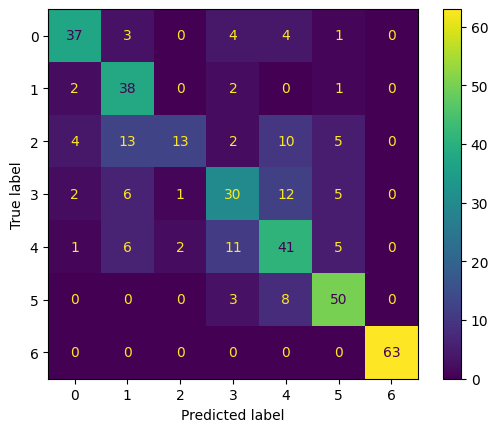

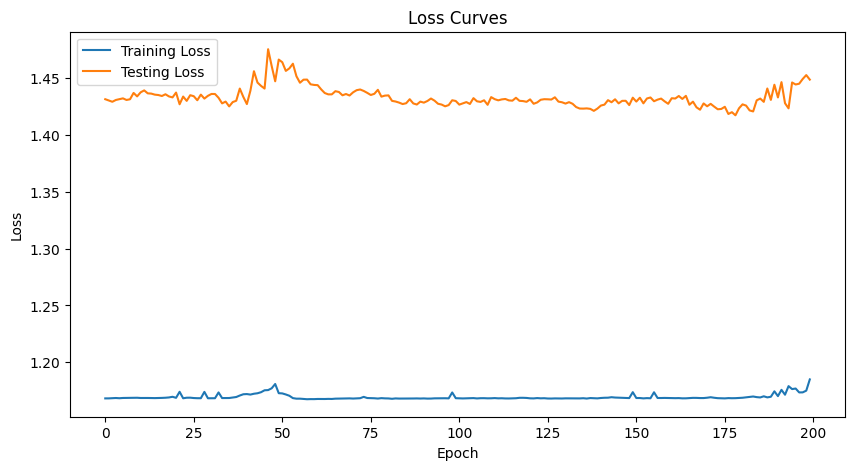

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.178 | Train Acc: 99.54% | Test NLL: 1.458 | Test Acc: 67.27%
Epoch 02 | Train NLL: 1.194 | Train Acc: 97.66% | Test NLL: 1.467 | Test Acc: 68.57%
Epoch 03 | Train NLL: 1.187 | Train Acc: 98.50% | Test NLL: 1.462 | Test Acc: 69.61%
Epoch 04 | Train NLL: 1.178 | Train Acc: 99.54% | Test NLL: 1.451 | Test Acc: 69.87%
Epoch 05 | Train NLL: 1.174 | Train Acc: 99.48% | Test NLL: 1.451 | Test Acc: 71.43%
Epoch 06 | Train NLL: 1.173 | Train Acc: 99.61% | Test NLL: 1.443 | Test Acc: 71.69%
Epoch 07 | Train NLL: 1.171 | Train Acc: 99.80% | Test NLL: 1.443 | Test Acc: 72.73%
Epoch 08 | Train NLL: 1.170 | Train Acc: 99.80% | Test NLL: 1.447 | Test Acc: 71.95%
Epoch 09 | Train NLL: 1.170 | Train Acc: 99.80% | Test NLL: 1.448 | Test Acc: 71.69%
Epoch 10 | Train NLL: 1.169 | Train Acc: 99.87% | Test NLL: 1.447 | Test Acc: 72.21%
Epoch 11 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.446

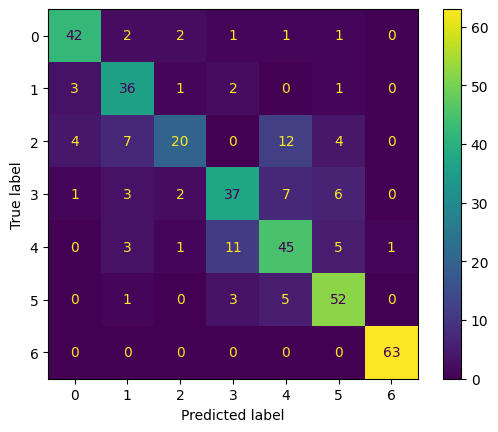

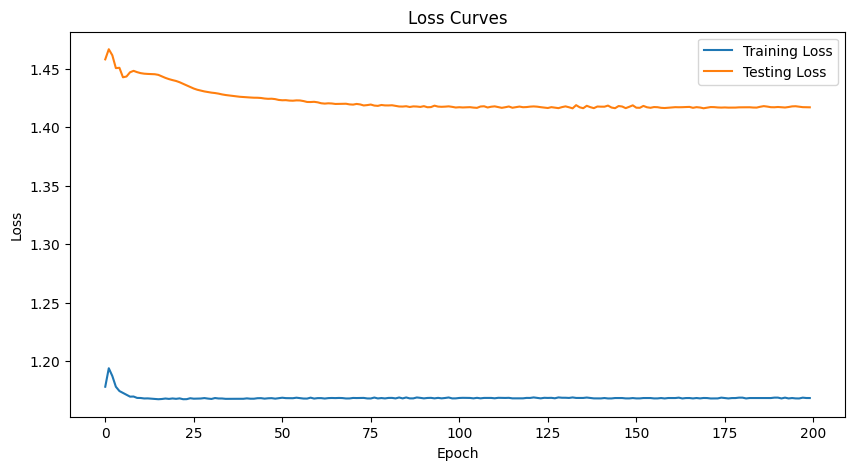

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.62%
Epoch 02 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.36%
Epoch 03 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.36%
Epoch 04 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.62%
Epoch 05 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.62%
Epoch 06 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.62%
Epoch 07 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.418 | Test Acc: 76.36%
Epoch 08 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.418 | Test Acc: 76.36%
Epoch 09 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.418 | Test Acc: 76.36%
Epoch 10 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417 | Test Acc: 76.36%
Epoch 11 | Train NLL: 1.168 | Train Acc: 99.87% | Test NLL: 1.417

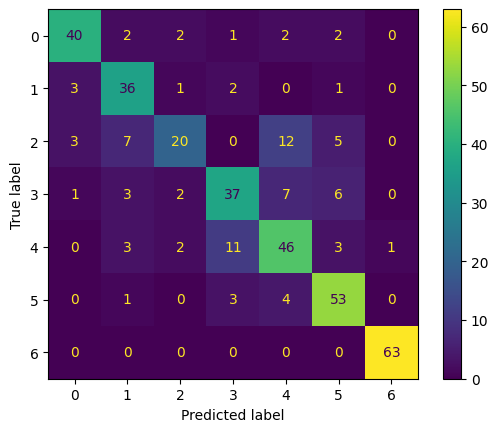

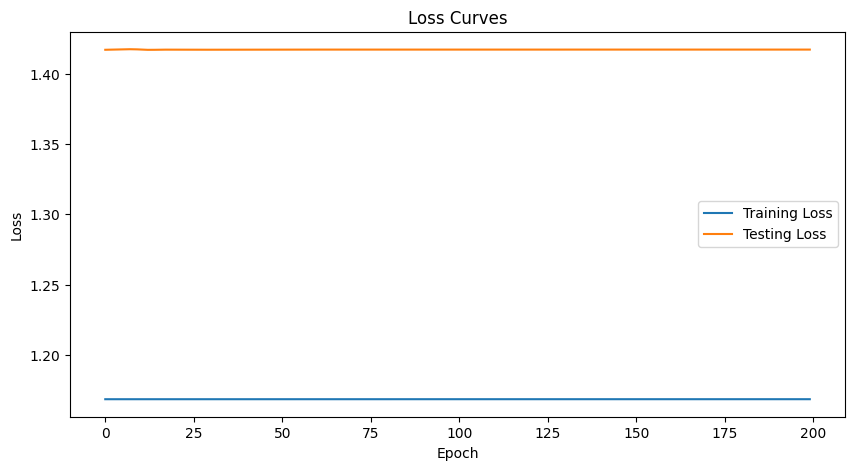

**************************************************



In [40]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 64

num_classes = 7

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Sigmoid(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=2621, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=7, bias=True)
  (activation3): Tanh()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.971 | Train Acc: 13.87% | Test NLL: 1.961 | Test Acc: 14.55%
Epoch 02 | Train NLL: 1.956 | Train Acc: 13.87% | Test NLL: 1.961 | Test Acc: 14.55%
Epoch 03 | Train NLL: 1.974 | Train Acc: 13.87% | Test NLL: 1.961 | Test Acc: 14.55%
Epoch 04 | Train NLL: 1.965 | Train Acc: 13.87% | Test NLL: 1.960 | Test Acc: 14.55%
Epoch 05 | Train NLL: 1.954 | Train Acc: 13.87% | Test NLL: 1.960 | Test Acc: 14.55%
Epoch 06 | Train NLL: 1.964 | Train Acc: 13.87% | Test NLL: 1.960 | Test Acc: 14.55%
Epoch 07 | Train NLL: 1.968 | Train Acc: 13.87% | Test NLL: 1.960 | Test Acc: 14.55%
Epoch 08 | Train NLL: 1.963 | Train Acc: 13.87% | Test NLL: 1.959 | Test Acc: 14.55%
Epoch 09 | Trai

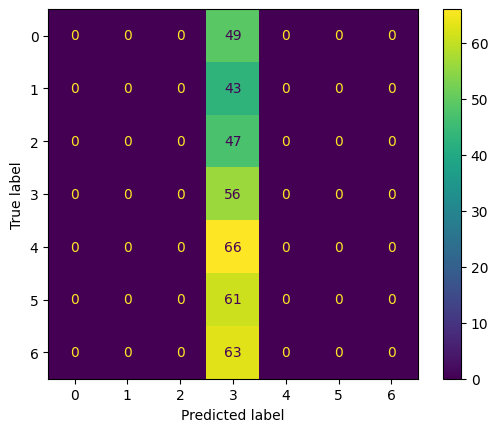

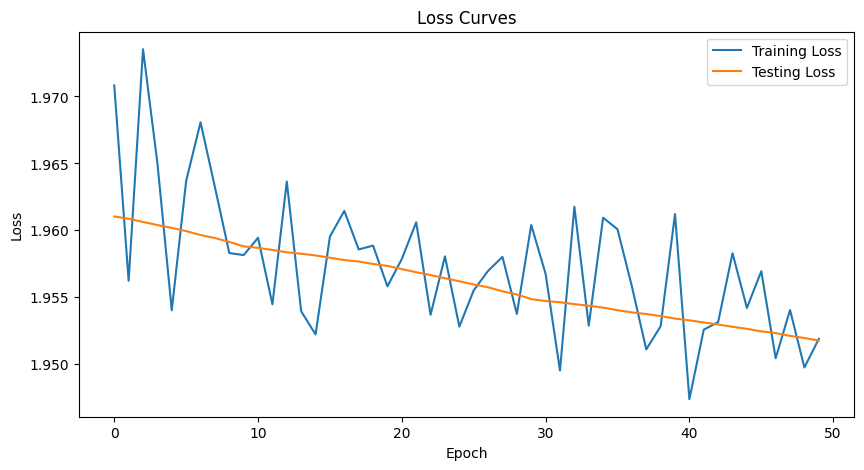

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.954 | Train Acc: 13.87% | Test NLL: 1.952 | Test Acc: 14.55%
Epoch 02 | Train NLL: 1.952 | Train Acc: 13.87% | Test NLL: 1.952 | Test Acc: 14.55%
Epoch 03 | Train NLL: 1.953 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 04 | Train NLL: 1.953 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 05 | Train NLL: 1.953 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 06 | Train NLL: 1.952 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 07 | Train NLL: 1.951 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 08 | Train NLL: 1.952 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 09 | Train NLL: 1.952 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 10 | Train NLL: 1.952 | Train Acc: 13.87% | Test NLL: 1.951 | Test Acc: 14.55%
Epoch 11 | Train NLL: 1.951 | Train Acc: 13.87% | Test NLL: 1.951 

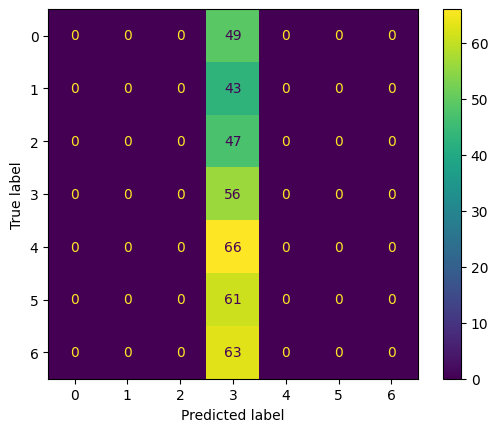

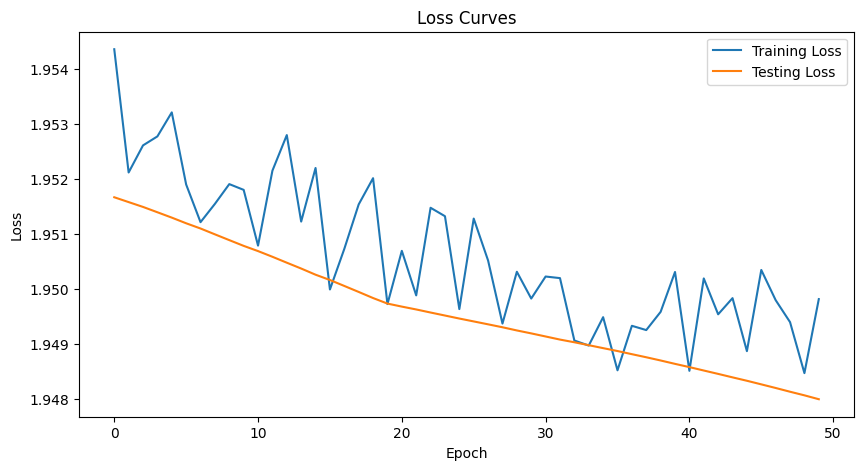

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 02 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 03 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 04 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 05 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 06 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 07 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 08 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 09 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 10 | Train NLL: 1.949 | Train Acc: 13.87% | Test NLL: 1.948 | Test Acc: 14.55%
Epoch 11 | Train NLL: 1.948 | Train Acc: 13.87% | Test NLL: 1.948 

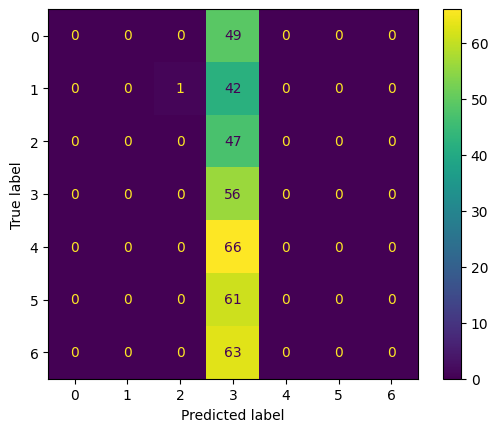

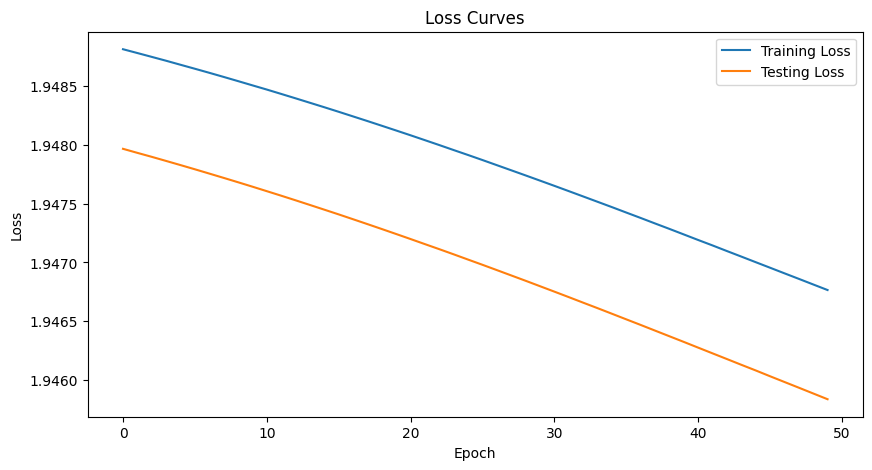

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.943 | Train Acc: 13.87% | Test NLL: 1.946 | Test Acc: 14.55%
Epoch 02 | Train NLL: 1.938 | Train Acc: 13.87% | Test NLL: 1.946 | Test Acc: 14.55%
Epoch 03 | Train NLL: 1.950 | Train Acc: 13.87% | Test NLL: 1.946 | Test Acc: 14.55%
Epoch 04 | Train NLL: 1.945 | Train Acc: 13.87% | Test NLL: 1.946 | Test Acc: 14.55%
Epoch 05 | Train NLL: 1.948 | Train Acc: 13.87% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 06 | Train NLL: 1.946 | Train Acc: 13.87% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 07 | Train NLL: 1.944 | Train Acc: 13.93% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 08 | Train NLL: 1.951 | Train Acc: 13.93% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 09 | Train NLL: 1.946 | Train Acc: 13.87% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 10 | Train NLL: 1.948 | Train Acc: 13.93% | Test NLL: 1.945 | Test Acc: 14.81%
Epoch 11 | Train NLL: 1.946 | Train Acc: 13.87% | Test NLL: 1.945 

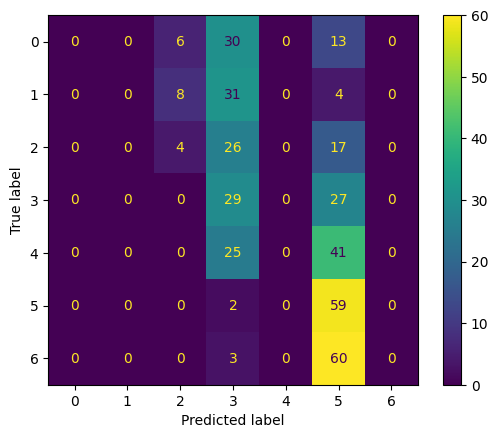

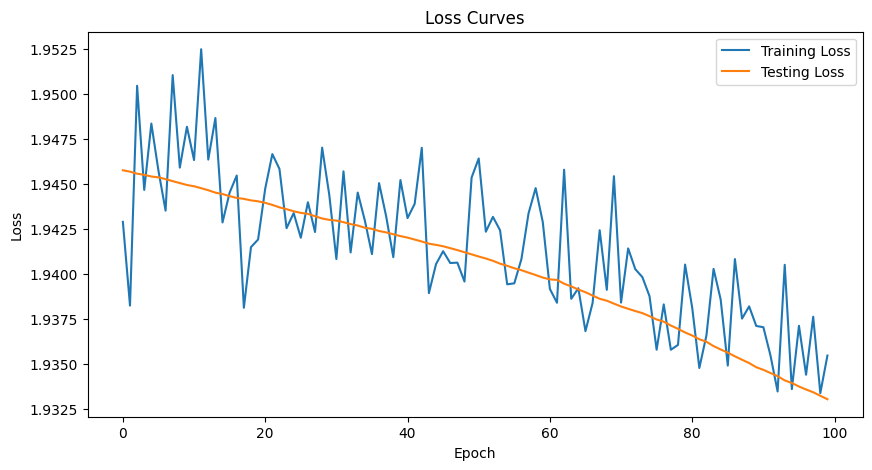

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.935 | Train Acc: 21.74% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 02 | Train NLL: 1.935 | Train Acc: 21.68% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 03 | Train NLL: 1.935 | Train Acc: 21.68% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 04 | Train NLL: 1.934 | Train Acc: 21.68% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 05 | Train NLL: 1.934 | Train Acc: 21.68% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 06 | Train NLL: 1.934 | Train Acc: 21.68% | Test NLL: 1.933 | Test Acc: 23.90%
Epoch 07 | Train NLL: 1.934 | Train Acc: 21.74% | Test NLL: 1.932 | Test Acc: 23.90%
Epoch 08 | Train NLL: 1.934 | Train Acc: 21.74% | Test NLL: 1.932 | Test Acc: 23.90%
Epoch 09 | Train NLL: 1.935 | Train Acc: 21.74% | Test NLL: 1.932 | Test Acc: 23.90%
Epoch 10 | Train NLL: 1.934 | Train Acc: 21.81% | Test NLL: 1.932 | Test Acc: 23.90%
Epoch 11 | Train NLL: 1.933 | Train Acc: 21.81% | Test NLL: 1.932

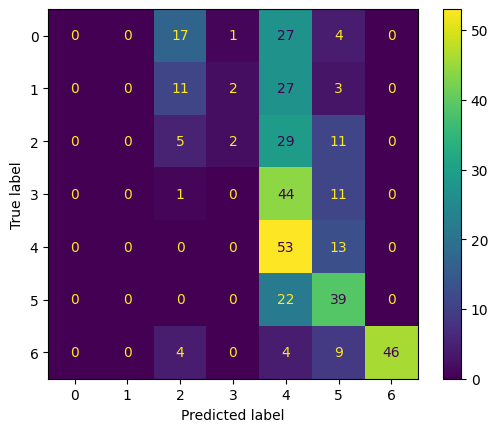

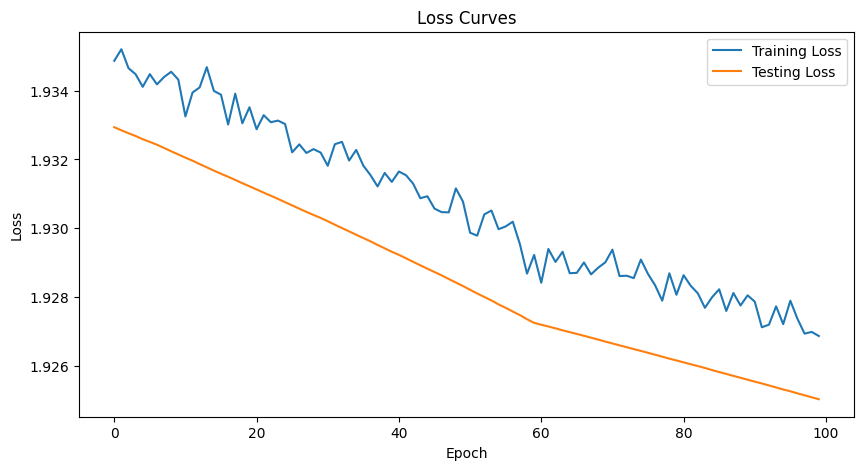

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.927 | Train Acc: 36.52% | Test NLL: 1.925 | Test Acc: 37.66%
Epoch 02 | Train NLL: 1.927 | Train Acc: 36.59% | Test NLL: 1.925 | Test Acc: 37.40%
Epoch 03 | Train NLL: 1.927 | Train Acc: 36.85% | Test NLL: 1.925 | Test Acc: 37.66%
Epoch 04 | Train NLL: 1.927 | Train Acc: 37.04% | Test NLL: 1.925 | Test Acc: 37.92%
Epoch 05 | Train NLL: 1.927 | Train Acc: 37.04% | Test NLL: 1.925 | Test Acc: 37.92%
Epoch 06 | Train NLL: 1.927 | Train Acc: 37.04% | Test NLL: 1.925 | Test Acc: 37.92%
Epoch 07 | Train NLL: 1.927 | Train Acc: 37.24% | Test NLL: 1.925 | Test Acc: 38.44%
Epoch 08 | Train NLL: 1.927 | Train Acc: 37.17% | Test NLL: 1.925 | Test Acc: 38.44%
Epoch 09 | Train NLL: 1.927 | Train Acc: 37.17% | Test NLL: 1.925 | Test Acc: 38.70%
Epoch 10 | Train NLL: 1.927 | Train Acc: 37.24% | Test NLL: 1.925 | Test Acc: 38.44%
Epoch 11 | Train NLL: 1.927 | Train Acc: 37.37% | Test NLL: 1.925

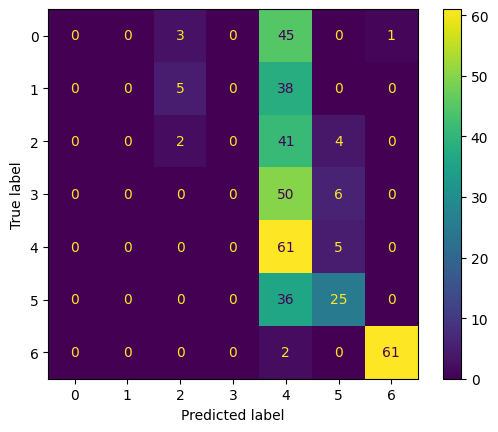

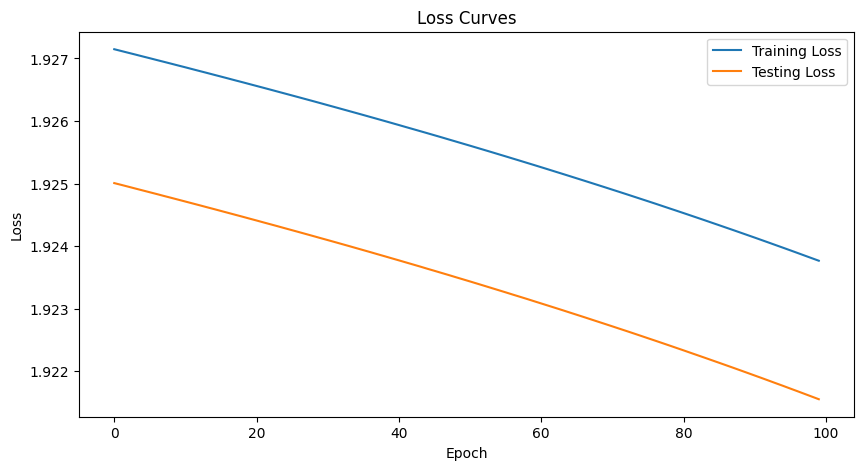

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.921 | Train Acc: 37.24% | Test NLL: 1.921 | Test Acc: 38.96%
Epoch 02 | Train NLL: 1.922 | Train Acc: 37.83% | Test NLL: 1.921 | Test Acc: 38.96%
Epoch 03 | Train NLL: 1.925 | Train Acc: 37.83% | Test NLL: 1.921 | Test Acc: 37.92%
Epoch 04 | Train NLL: 1.928 | Train Acc: 37.11% | Test NLL: 1.921 | Test Acc: 37.14%
Epoch 05 | Train NLL: 1.926 | Train Acc: 36.13% | Test NLL: 1.921 | Test Acc: 37.14%
Epoch 06 | Train NLL: 1.924 | Train Acc: 36.26% | Test NLL: 1.921 | Test Acc: 37.14%
Epoch 07 | Train NLL: 1.921 | Train Acc: 36.78% | Test NLL: 1.920 | Test Acc: 36.88%
Epoch 08 | Train NLL: 1.925 | Train Acc: 35.61% | Test NLL: 1.920 | Test Acc: 36.88%
Epoch 09 | Train NLL: 1.921 | Train Acc: 35.94% | Test NLL: 1.920 | Test Acc: 37.14%
Epoch 10 | Train NLL: 1.922 | Train Acc: 36.46% | Test NLL: 1.920 | Test Acc: 36.88%
Epoch 11 | Train NLL: 1.921 | Train Acc: 36.33% | Test NLL: 1.920 

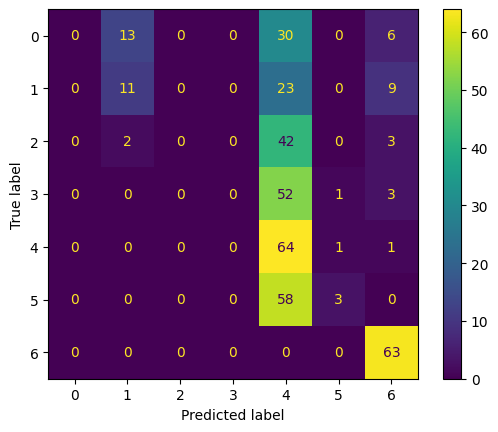

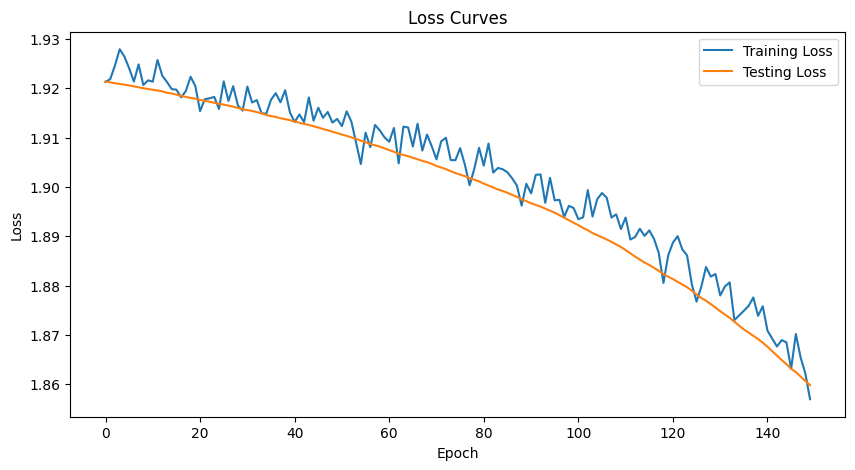

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.867 | Train Acc: 35.22% | Test NLL: 1.859 | Test Acc: 36.62%
Epoch 02 | Train NLL: 1.864 | Train Acc: 35.22% | Test NLL: 1.859 | Test Acc: 36.62%
Epoch 03 | Train NLL: 1.866 | Train Acc: 35.35% | Test NLL: 1.859 | Test Acc: 36.62%
Epoch 04 | Train NLL: 1.863 | Train Acc: 35.42% | Test NLL: 1.858 | Test Acc: 36.88%
Epoch 05 | Train NLL: 1.863 | Train Acc: 35.61% | Test NLL: 1.858 | Test Acc: 36.88%
Epoch 06 | Train NLL: 1.863 | Train Acc: 35.61% | Test NLL: 1.857 | Test Acc: 36.88%
Epoch 07 | Train NLL: 1.862 | Train Acc: 35.81% | Test NLL: 1.857 | Test Acc: 37.14%
Epoch 08 | Train NLL: 1.861 | Train Acc: 36.00% | Test NLL: 1.856 | Test Acc: 37.40%
Epoch 09 | Train NLL: 1.861 | Train Acc: 36.07% | Test NLL: 1.856 | Test Acc: 37.66%
Epoch 10 | Train NLL: 1.862 | Train Acc: 36.13% | Test NLL: 1.855 | Test Acc: 37.66%
Epoch 11 | Train NLL: 1.860 | Train Acc: 36.13% | Test NLL: 1.855

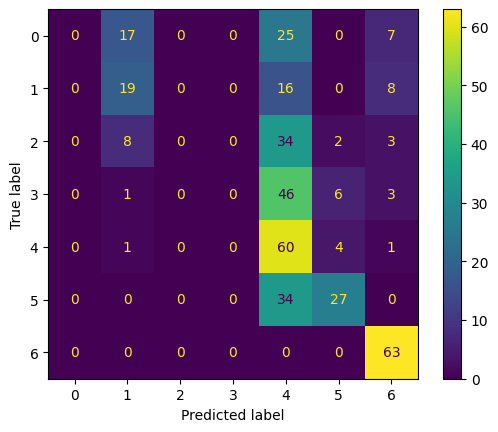

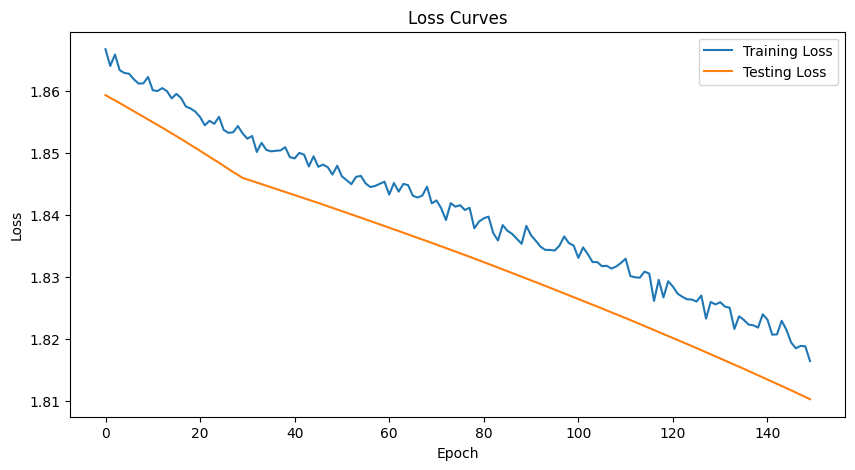

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.818 | Train Acc: 43.42% | Test NLL: 1.810 | Test Acc: 43.90%
Epoch 02 | Train NLL: 1.818 | Train Acc: 43.42% | Test NLL: 1.810 | Test Acc: 43.90%
Epoch 03 | Train NLL: 1.818 | Train Acc: 43.42% | Test NLL: 1.810 | Test Acc: 43.90%
Epoch 04 | Train NLL: 1.818 | Train Acc: 43.42% | Test NLL: 1.809 | Test Acc: 43.90%
Epoch 05 | Train NLL: 1.817 | Train Acc: 43.49% | Test NLL: 1.809 | Test Acc: 44.16%
Epoch 06 | Train NLL: 1.817 | Train Acc: 43.62% | Test NLL: 1.809 | Test Acc: 44.16%
Epoch 07 | Train NLL: 1.817 | Train Acc: 43.68% | Test NLL: 1.809 | Test Acc: 44.16%
Epoch 08 | Train NLL: 1.817 | Train Acc: 43.68% | Test NLL: 1.809 | Test Acc: 44.42%
Epoch 09 | Train NLL: 1.817 | Train Acc: 43.68% | Test NLL: 1.809 | Test Acc: 44.42%
Epoch 10 | Train NLL: 1.816 | Train Acc: 43.68% | Test NLL: 1.808 | Test Acc: 44.42%
Epoch 11 | Train NLL: 1.816 | Train Acc: 43.68% | Test NLL: 1.808

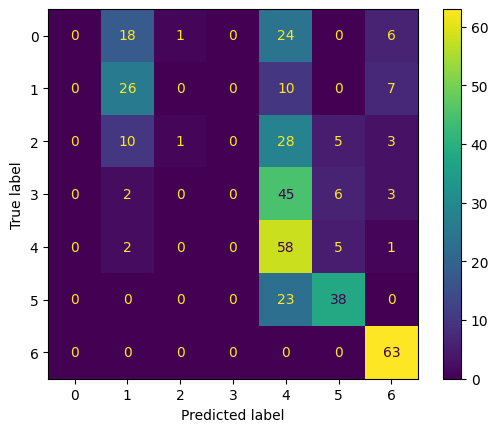

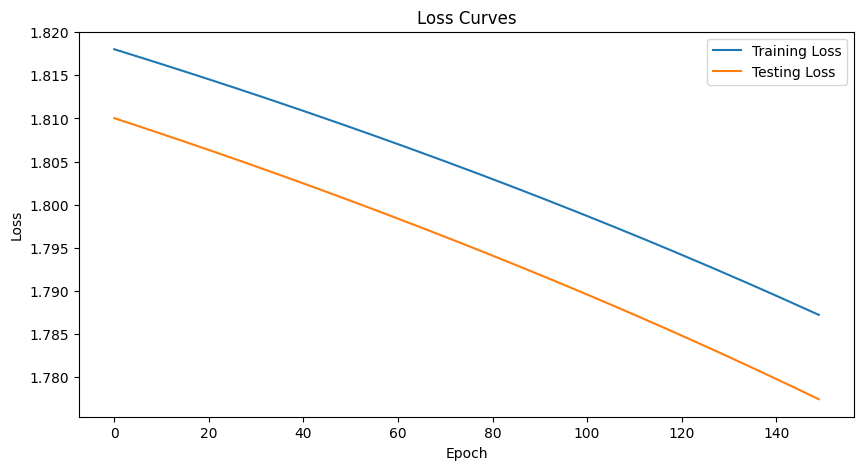

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 1.779 | Train Acc: 45.51% | Test NLL: 1.776 | Test Acc: 48.31%
Epoch 02 | Train NLL: 1.795 | Train Acc: 45.51% | Test NLL: 1.775 | Test Acc: 48.83%
Epoch 03 | Train NLL: 1.780 | Train Acc: 45.57% | Test NLL: 1.774 | Test Acc: 48.57%
Epoch 04 | Train NLL: 1.785 | Train Acc: 45.70% | Test NLL: 1.773 | Test Acc: 48.83%
Epoch 05 | Train NLL: 1.770 | Train Acc: 45.64% | Test NLL: 1.772 | Test Acc: 48.57%
Epoch 06 | Train NLL: 1.772 | Train Acc: 45.57% | Test NLL: 1.771 | Test Acc: 48.57%
Epoch 07 | Train NLL: 1.774 | Train Acc: 45.57% | Test NLL: 1.770 | Test Acc: 48.57%
Epoch 08 | Train NLL: 1.776 | Train Acc: 45.57% | Test NLL: 1.769 | Test Acc: 48.57%
Epoch 09 | Train NLL: 1.787 | Train Acc: 45.51% | Test NLL: 1.768 | Test Acc: 48.57%
Epoch 10 | Train NLL: 1.781 | Train Acc: 45.64% | Test NLL: 1.766 | Test Acc: 48.83%
Epoch 11 | Train NLL: 1.771 | Train Acc: 45.70% | Test NLL: 1.765 

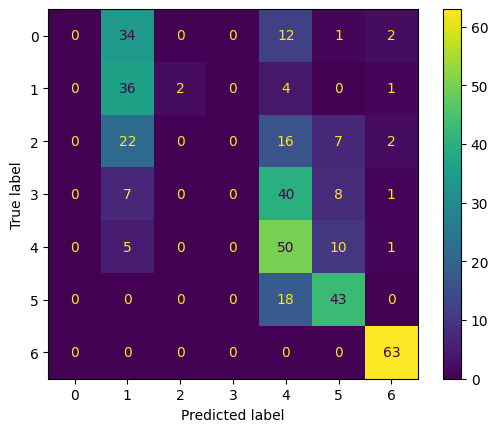

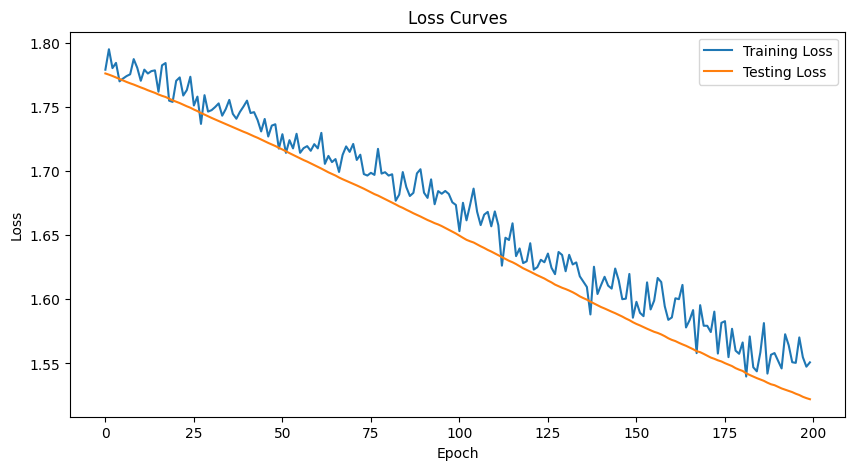

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 1.542 | Train Acc: 47.59% | Test NLL: 1.522 | Test Acc: 49.87%
Epoch 02 | Train NLL: 1.548 | Train Acc: 47.59% | Test NLL: 1.521 | Test Acc: 49.87%
Epoch 03 | Train NLL: 1.544 | Train Acc: 47.59% | Test NLL: 1.520 | Test Acc: 49.87%
Epoch 04 | Train NLL: 1.544 | Train Acc: 47.59% | Test NLL: 1.520 | Test Acc: 49.87%
Epoch 05 | Train NLL: 1.543 | Train Acc: 47.59% | Test NLL: 1.519 | Test Acc: 49.87%
Epoch 06 | Train NLL: 1.540 | Train Acc: 47.59% | Test NLL: 1.519 | Test Acc: 49.87%
Epoch 07 | Train NLL: 1.542 | Train Acc: 47.59% | Test NLL: 1.518 | Test Acc: 49.87%
Epoch 08 | Train NLL: 1.545 | Train Acc: 47.59% | Test NLL: 1.518 | Test Acc: 49.87%
Epoch 09 | Train NLL: 1.547 | Train Acc: 47.59% | Test NLL: 1.517 | Test Acc: 49.87%
Epoch 10 | Train NLL: 1.539 | Train Acc: 47.59% | Test NLL: 1.517 | Test Acc: 49.87%
Epoch 11 | Train NLL: 1.543 | Train Acc: 47.59% | Test NLL: 1.516

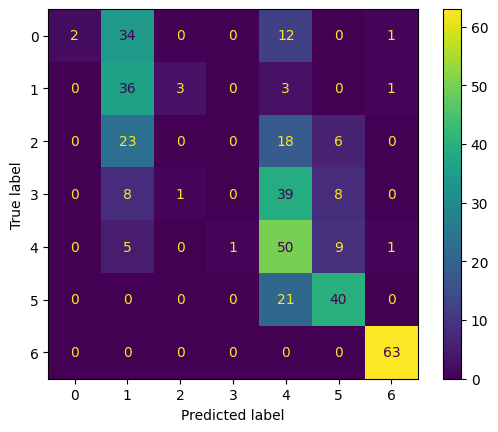

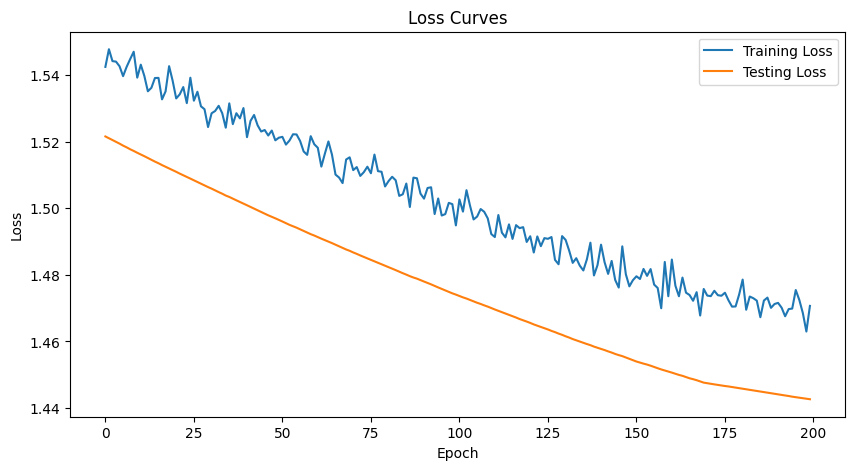

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 1.469 | Train Acc: 48.50% | Test NLL: 1.443 | Test Acc: 49.61%
Epoch 02 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 03 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 04 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 05 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 06 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 07 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 08 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 09 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 10 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442 | Test Acc: 49.61%
Epoch 11 | Train NLL: 1.468 | Train Acc: 48.50% | Test NLL: 1.442

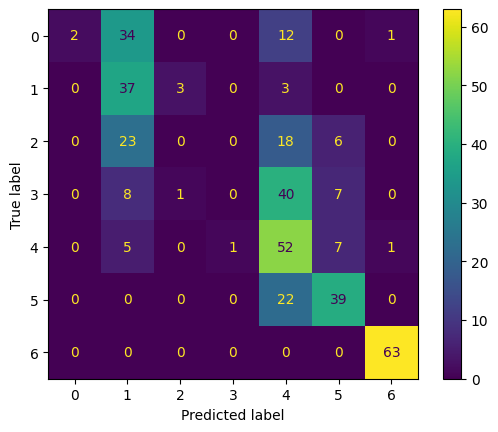

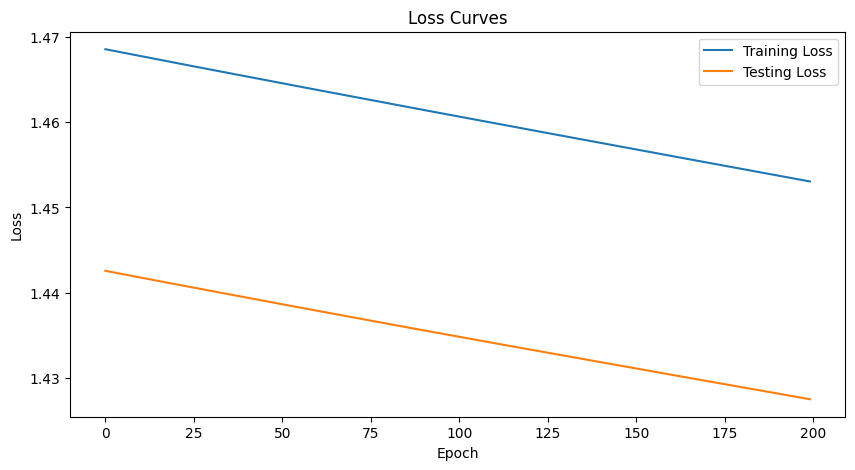

**************************************************



In [41]:
X_train = ml_dic_div["X"]["train"]
T_train = ml_dic_div["T"]["train"]
X_test = ml_dic_div["X"]["test"]
T_test = ml_dic_div["T"]["test"]

HIDDEN_UNITS = 64

num_classes = 7

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Tanh(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.SGD(pytorchNet.parameters(), lr=0.005),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

SimplePytorchMLP(
  (fc1): Linear(in_features=187, out_features=128, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=128, out_features=2, bias=True)
  (activation2): ReLU()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.507 | Train Acc: 74.38% | Test NLL: 0.452 | Test Acc: 75.40%
Epoch 02 | Train NLL: 0.433 | Train Acc: 77.97% | Test NLL: 0.411 | Test Acc: 78.50%
Epoch 03 | Train NLL: 0.406 | Train Acc: 79.85% | Test NLL: 0.394 | Test Acc: 80.18%
Epoch 04 | Train NLL: 0.393 | Train Acc: 80.81% | Test NLL: 0.390 | Test Acc: 80.04%
Epoch 05 | Train NLL: 0.386 | Train Acc: 81.25% | Test NLL: 0.378 | Test Acc: 82.24%
Epoch 06 | Train NLL: 0.385 | Train Acc: 81.51% | Test NLL: 0.373 | Test Acc: 83.41%
Epoch 07 | Train NLL: 0.373 | Train Acc: 82.57% | Test NLL: 0.360 | Test Acc: 84.30%
Epoch 08 | Train NLL: 0.365 | Train Acc: 82.85% | Test NLL: 0.354 | Test Acc: 85.43%
Epoch 09 | Train NLL: 0.359 | Train Acc: 83.56% | Test NLL: 0.348 | Test Acc: 84.06%
Epoch 10 | Tra

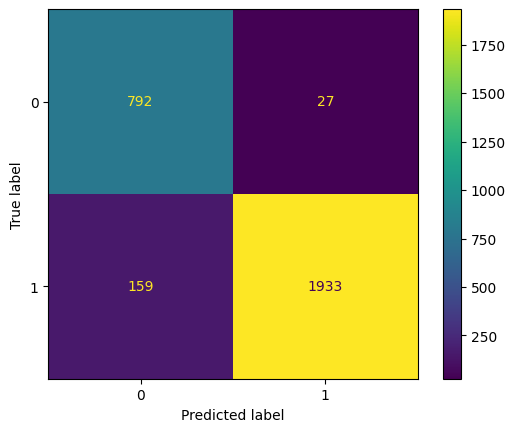

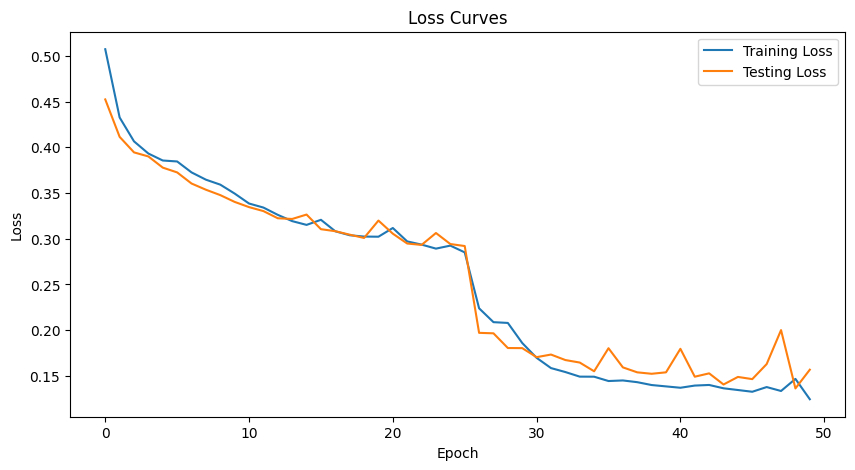

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.118 | Train Acc: 95.60% | Test NLL: 0.138 | Test Acc: 94.81%
Epoch 02 | Train NLL: 0.116 | Train Acc: 95.65% | Test NLL: 0.136 | Test Acc: 94.98%
Epoch 03 | Train NLL: 0.113 | Train Acc: 95.85% | Test NLL: 0.143 | Test Acc: 94.43%
Epoch 04 | Train NLL: 0.116 | Train Acc: 95.46% | Test NLL: 0.138 | Test Acc: 94.88%
Epoch 05 | Train NLL: 0.114 | Train Acc: 95.71% | Test NLL: 0.133 | Test Acc: 94.88%
Epoch 06 | Train NLL: 0.113 | Train Acc: 95.66% | Test NLL: 0.130 | Test Acc: 95.09%
Epoch 07 | Train NLL: 0.109 | Train Acc: 95.88% | Test NLL: 0.132 | Test Acc: 94.92%
Epoch 08 | Train NLL: 0.108 | Train Acc: 95.95% | Test NLL: 0.131 | Test Acc: 94.50%
Epoch 09 | Train NLL: 0.105 | Train Acc: 96.09% | Test NLL: 0.139 | Test Acc: 94.78%
Epoch 10 | Train NLL: 0.113 | Train Acc: 95.69% | Test NLL: 0.135 | Test Acc: 95.16%
Epoch 11 | Train NLL: 0.109 | Train Acc: 95.78% | Test NLL: 0.149 

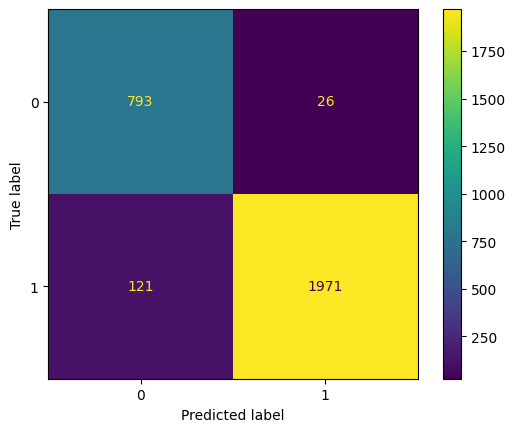

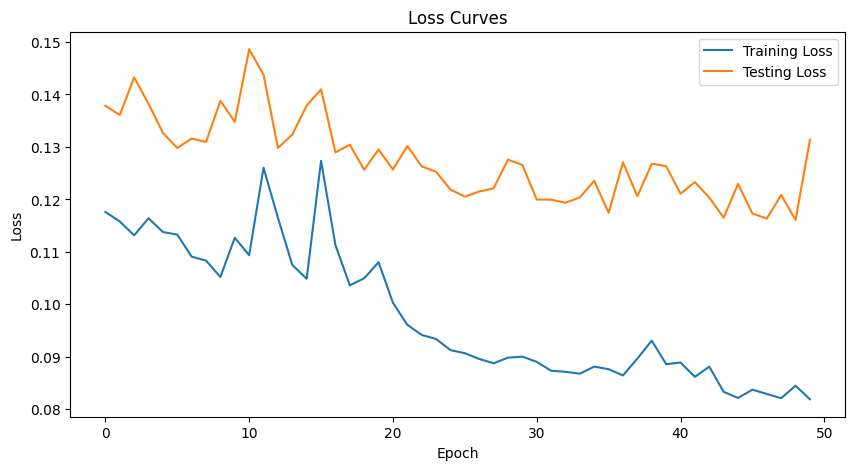

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.086 | Train Acc: 96.76% | Test NLL: 0.115 | Test Acc: 95.77%
Epoch 02 | Train NLL: 0.079 | Train Acc: 97.21% | Test NLL: 0.112 | Test Acc: 95.95%
Epoch 03 | Train NLL: 0.078 | Train Acc: 97.22% | Test NLL: 0.115 | Test Acc: 96.22%
Epoch 04 | Train NLL: 0.077 | Train Acc: 97.36% | Test NLL: 0.113 | Test Acc: 96.02%
Epoch 05 | Train NLL: 0.076 | Train Acc: 97.29% | Test NLL: 0.113 | Test Acc: 95.81%
Epoch 06 | Train NLL: 0.076 | Train Acc: 97.45% | Test NLL: 0.114 | Test Acc: 96.02%
Epoch 07 | Train NLL: 0.075 | Train Acc: 97.35% | Test NLL: 0.113 | Test Acc: 96.26%
Epoch 08 | Train NLL: 0.075 | Train Acc: 97.36% | Test NLL: 0.118 | Test Acc: 95.60%
Epoch 09 | Train NLL: 0.075 | Train Acc: 97.43% | Test NLL: 0.113 | Test Acc: 95.91%
Epoch 10 | Train NLL: 0.075 | Train Acc: 97.36% | Test NLL: 0.112 | Test Acc: 96.22%
Epoch 11 | Train NLL: 0.077 | Train Acc: 97.37% | Test NLL: 0.115 

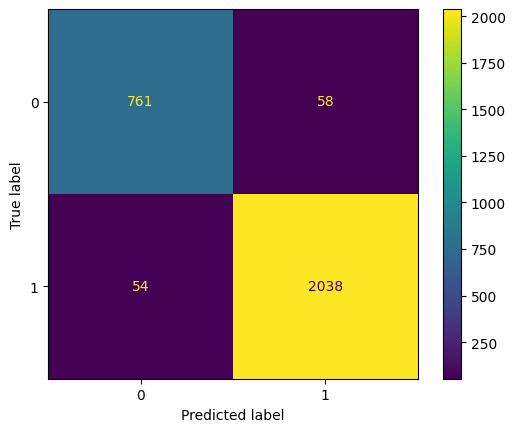

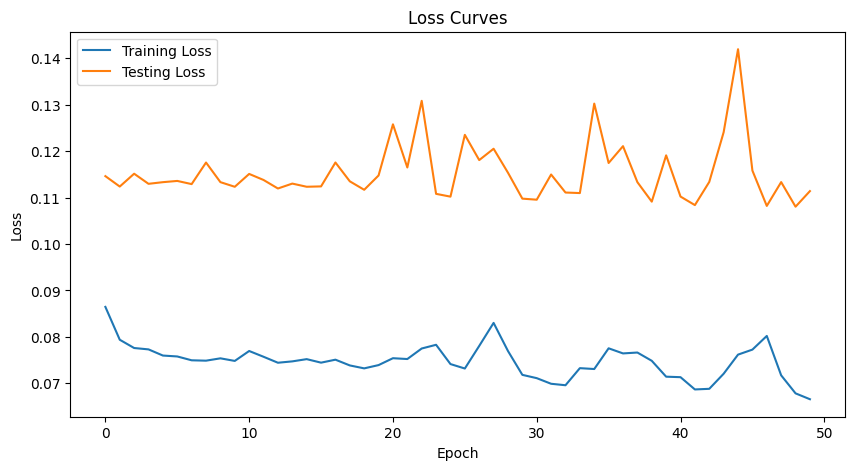

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.071 | Train Acc: 97.50% | Test NLL: 0.116 | Test Acc: 96.05%
Epoch 02 | Train NLL: 0.076 | Train Acc: 97.20% | Test NLL: 0.116 | Test Acc: 96.12%
Epoch 03 | Train NLL: 0.079 | Train Acc: 97.08% | Test NLL: 0.121 | Test Acc: 95.98%
Epoch 04 | Train NLL: 0.072 | Train Acc: 97.44% | Test NLL: 0.116 | Test Acc: 95.95%
Epoch 05 | Train NLL: 0.071 | Train Acc: 97.35% | Test NLL: 0.121 | Test Acc: 95.43%
Epoch 06 | Train NLL: 0.076 | Train Acc: 97.32% | Test NLL: 0.112 | Test Acc: 96.15%
Epoch 07 | Train NLL: 0.075 | Train Acc: 97.27% | Test NLL: 0.129 | Test Acc: 95.26%
Epoch 08 | Train NLL: 0.081 | Train Acc: 97.03% | Test NLL: 0.136 | Test Acc: 94.81%
Epoch 09 | Train NLL: 0.078 | Train Acc: 97.09% | Test NLL: 0.119 | Test Acc: 96.50%
Epoch 10 | Train NLL: 0.073 | Train Acc: 97.36% | Test NLL: 0.110 | Test Acc: 96.46%
Epoch 11 | Train NLL: 0.069 | Train Acc: 97.60% | Test NLL: 0.155 

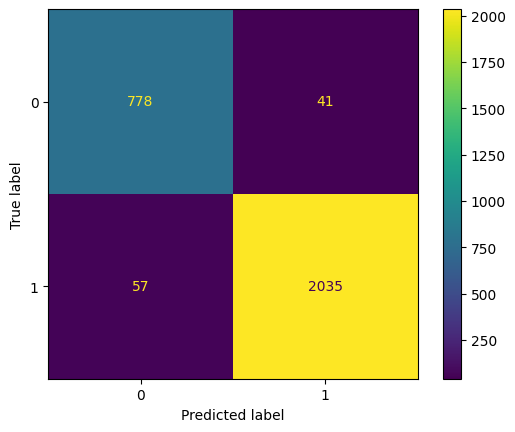

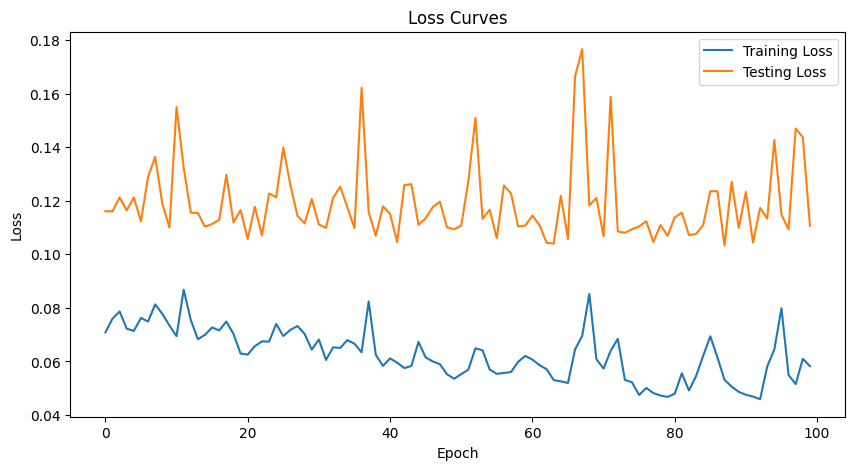

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.046 | Train Acc: 98.94% | Test NLL: 0.109 | Test Acc: 96.39%
Epoch 02 | Train NLL: 0.043 | Train Acc: 98.98% | Test NLL: 0.103 | Test Acc: 96.70%
Epoch 03 | Train NLL: 0.039 | Train Acc: 99.19% | Test NLL: 0.102 | Test Acc: 96.84%
Epoch 04 | Train NLL: 0.039 | Train Acc: 99.18% | Test NLL: 0.108 | Test Acc: 96.67%
Epoch 05 | Train NLL: 0.045 | Train Acc: 98.90% | Test NLL: 0.105 | Test Acc: 96.50%
Epoch 06 | Train NLL: 0.040 | Train Acc: 99.18% | Test NLL: 0.099 | Test Acc: 96.67%
Epoch 07 | Train NLL: 0.038 | Train Acc: 99.21% | Test NLL: 0.099 | Test Acc: 96.67%
Epoch 08 | Train NLL: 0.038 | Train Acc: 99.26% | Test NLL: 0.101 | Test Acc: 96.43%
Epoch 09 | Train NLL: 0.039 | Train Acc: 99.21% | Test NLL: 0.096 | Test Acc: 96.84%
Epoch 10 | Train NLL: 0.038 | Train Acc: 99.24% | Test NLL: 0.107 | Test Acc: 96.50%
Epoch 11 | Train NLL: 0.038 | Train Acc: 99.28% | Test NLL: 0.099

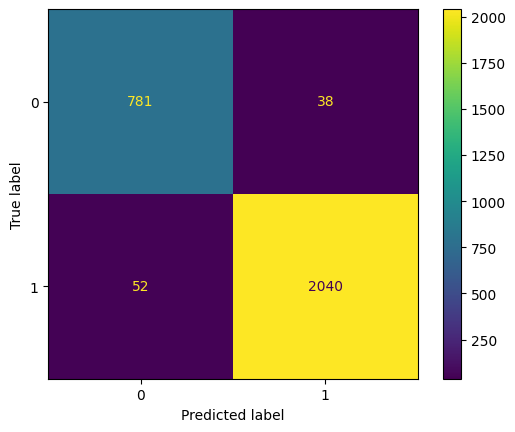

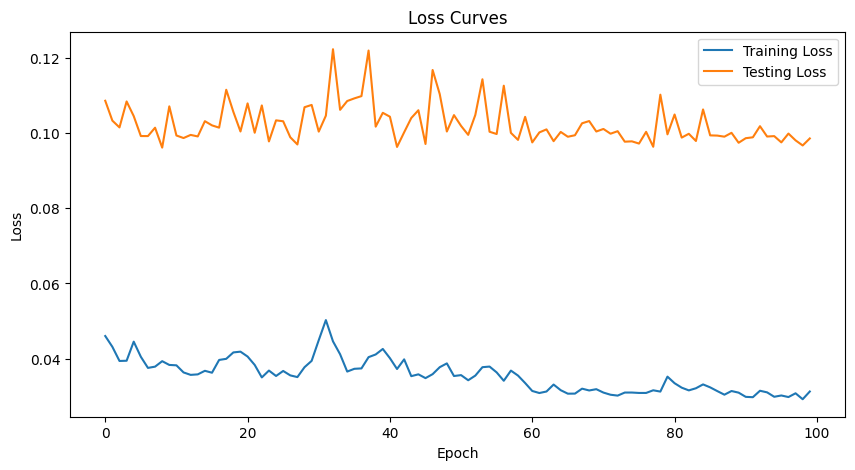

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.032 | Train Acc: 99.52% | Test NLL: 0.107 | Test Acc: 96.46%
Epoch 02 | Train NLL: 0.033 | Train Acc: 99.49% | Test NLL: 0.094 | Test Acc: 96.94%
Epoch 03 | Train NLL: 0.031 | Train Acc: 99.52% | Test NLL: 0.095 | Test Acc: 96.53%
Epoch 04 | Train NLL: 0.030 | Train Acc: 99.63% | Test NLL: 0.095 | Test Acc: 96.84%
Epoch 05 | Train NLL: 0.028 | Train Acc: 99.65% | Test NLL: 0.092 | Test Acc: 96.84%
Epoch 06 | Train NLL: 0.028 | Train Acc: 99.70% | Test NLL: 0.095 | Test Acc: 96.77%
Epoch 07 | Train NLL: 0.028 | Train Acc: 99.66% | Test NLL: 0.094 | Test Acc: 96.91%
Epoch 08 | Train NLL: 0.028 | Train Acc: 99.66% | Test NLL: 0.094 | Test Acc: 96.84%
Epoch 09 | Train NLL: 0.028 | Train Acc: 99.69% | Test NLL: 0.093 | Test Acc: 97.05%
Epoch 10 | Train NLL: 0.028 | Train Acc: 99.68% | Test NLL: 0.095 | Test Acc: 96.56%
Epoch 11 | Train NLL: 0.029 | Train Acc: 99.63% | Test NLL: 0.094

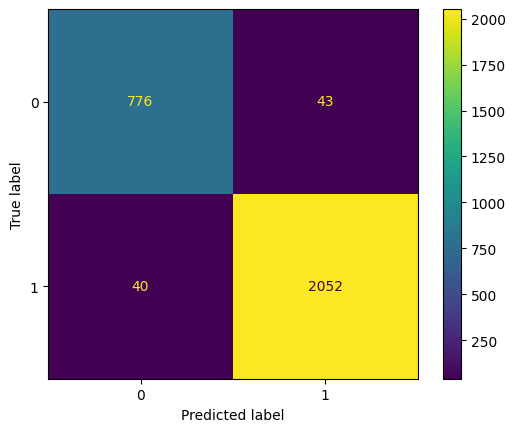

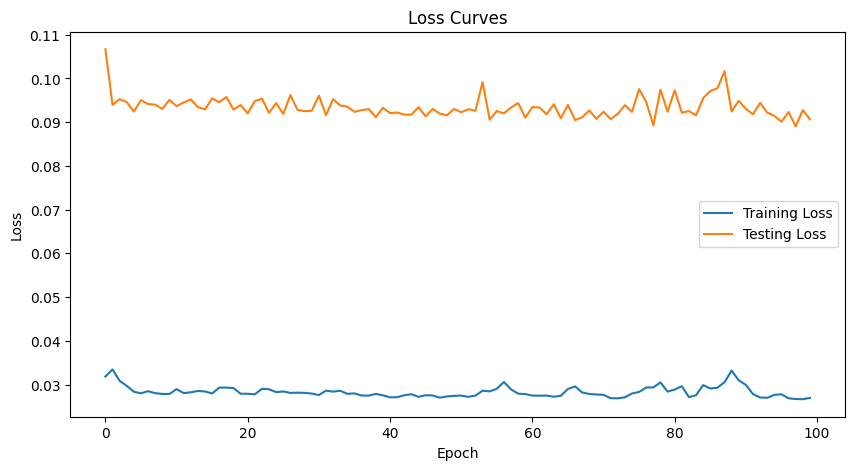

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.086 | Train Acc: 97.05% | Test NLL: 0.429 | Test Acc: 87.53%
Epoch 02 | Train NLL: 0.153 | Train Acc: 93.62% | Test NLL: 0.180 | Test Acc: 93.27%
Epoch 03 | Train NLL: 0.080 | Train Acc: 96.93% | Test NLL: 0.111 | Test Acc: 95.84%
Epoch 04 | Train NLL: 0.056 | Train Acc: 98.25% | Test NLL: 0.106 | Test Acc: 96.36%
Epoch 05 | Train NLL: 0.048 | Train Acc: 98.73% | Test NLL: 0.098 | Test Acc: 96.67%
Epoch 06 | Train NLL: 0.053 | Train Acc: 98.39% | Test NLL: 0.129 | Test Acc: 95.81%
Epoch 07 | Train NLL: 0.056 | Train Acc: 98.24% | Test NLL: 0.136 | Test Acc: 95.53%
Epoch 08 | Train NLL: 0.074 | Train Acc: 97.55% | Test NLL: 0.120 | Test Acc: 95.64%
Epoch 09 | Train NLL: 0.044 | Train Acc: 98.81% | Test NLL: 0.109 | Test Acc: 96.29%
Epoch 10 | Train NLL: 0.043 | Train Acc: 98.95% | Test NLL: 0.118 | Test Acc: 95.88%
Epoch 11 | Train NLL: 0.041 | Train Acc: 98.94% | Test NLL: 0.104 

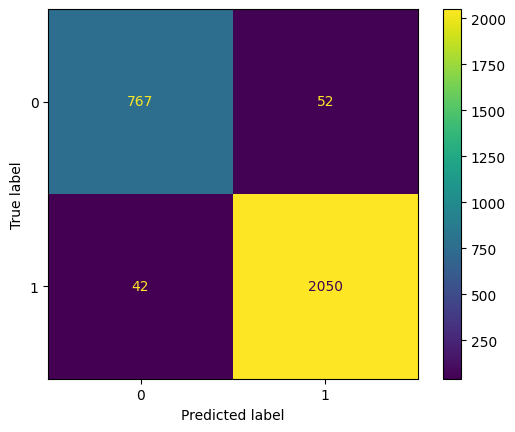

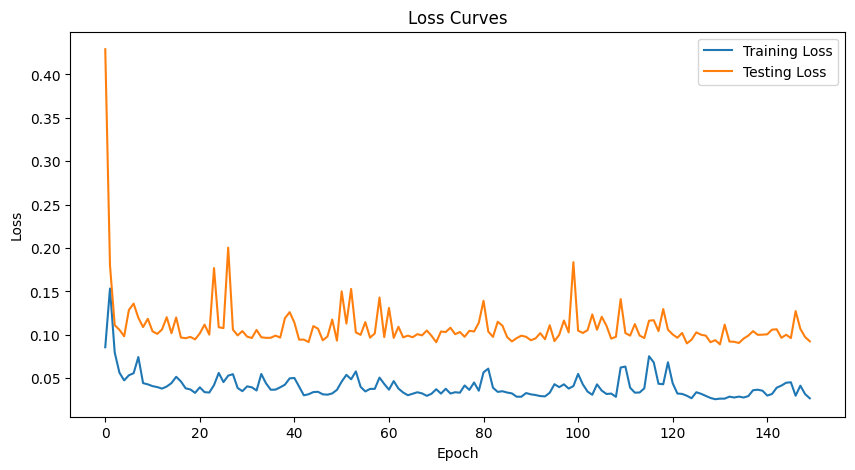

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.026 | Train Acc: 99.71% | Test NLL: 0.092 | Test Acc: 97.08%
Epoch 02 | Train NLL: 0.026 | Train Acc: 99.66% | Test NLL: 0.098 | Test Acc: 96.70%
Epoch 03 | Train NLL: 0.034 | Train Acc: 99.30% | Test NLL: 0.098 | Test Acc: 96.74%
Epoch 04 | Train NLL: 0.031 | Train Acc: 99.48% | Test NLL: 0.087 | Test Acc: 97.25%
Epoch 05 | Train NLL: 0.025 | Train Acc: 99.69% | Test NLL: 0.094 | Test Acc: 96.70%
Epoch 06 | Train NLL: 0.023 | Train Acc: 99.79% | Test NLL: 0.091 | Test Acc: 96.87%
Epoch 07 | Train NLL: 0.023 | Train Acc: 99.77% | Test NLL: 0.089 | Test Acc: 97.32%
Epoch 08 | Train NLL: 0.023 | Train Acc: 99.82% | Test NLL: 0.089 | Test Acc: 97.25%
Epoch 09 | Train NLL: 0.024 | Train Acc: 99.75% | Test NLL: 0.097 | Test Acc: 96.87%
Epoch 10 | Train NLL: 0.024 | Train Acc: 99.84% | Test NLL: 0.091 | Test Acc: 97.22%
Epoch 11 | Train NLL: 0.023 | Train Acc: 99.84% | Test NLL: 0.091

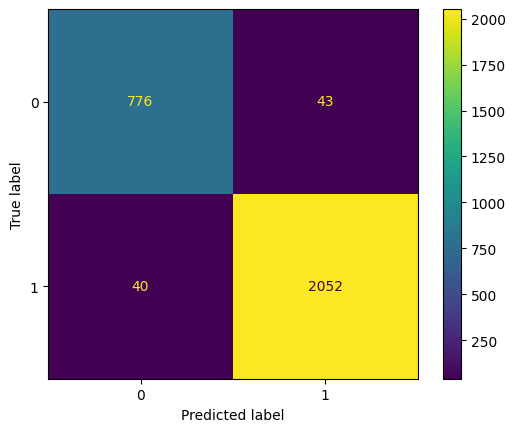

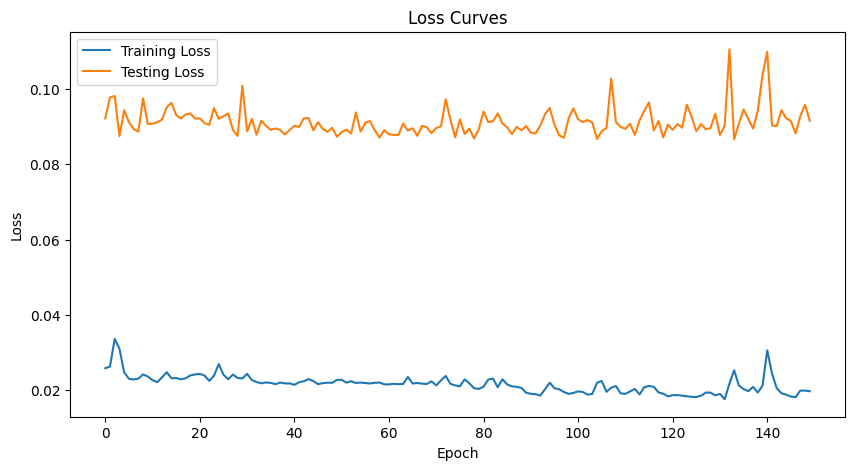

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.019 | Train Acc: 99.87% | Test NLL: 0.086 | Test Acc: 96.94%
Epoch 02 | Train NLL: 0.018 | Train Acc: 99.83% | Test NLL: 0.087 | Test Acc: 96.98%
Epoch 03 | Train NLL: 0.018 | Train Acc: 99.89% | Test NLL: 0.086 | Test Acc: 97.01%
Epoch 04 | Train NLL: 0.018 | Train Acc: 99.89% | Test NLL: 0.086 | Test Acc: 96.91%
Epoch 05 | Train NLL: 0.018 | Train Acc: 99.88% | Test NLL: 0.086 | Test Acc: 97.08%
Epoch 06 | Train NLL: 0.018 | Train Acc: 99.85% | Test NLL: 0.085 | Test Acc: 97.08%
Epoch 07 | Train NLL: 0.018 | Train Acc: 99.89% | Test NLL: 0.084 | Test Acc: 97.05%
Epoch 08 | Train NLL: 0.017 | Train Acc: 99.90% | Test NLL: 0.088 | Test Acc: 97.05%
Epoch 09 | Train NLL: 0.017 | Train Acc: 99.94% | Test NLL: 0.085 | Test Acc: 97.05%
Epoch 10 | Train NLL: 0.017 | Train Acc: 99.87% | Test NLL: 0.083 | Test Acc: 97.08%
Epoch 11 | Train NLL: 0.016 | Train Acc: 99.94% | Test NLL: 0.087

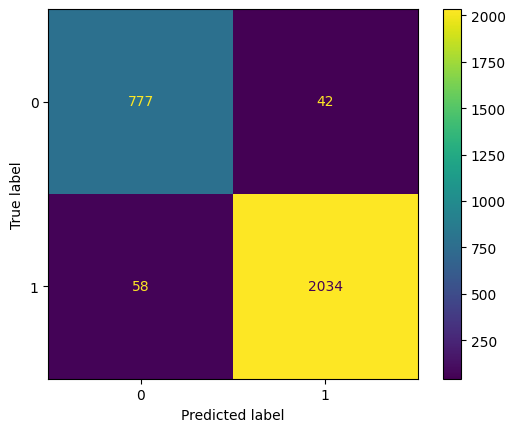

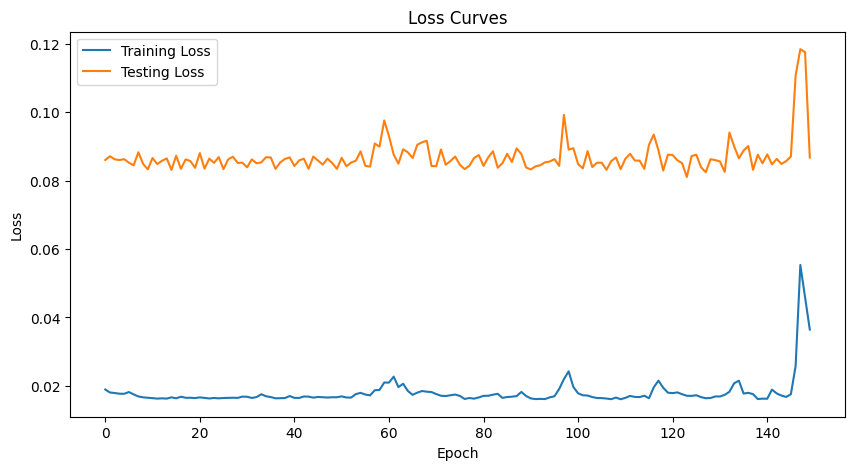

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.256 | Train Acc: 92.13% | Test NLL: 0.259 | Test Acc: 88.11%
Epoch 02 | Train NLL: 0.207 | Train Acc: 90.46% | Test NLL: 0.182 | Test Acc: 92.92%
Epoch 03 | Train NLL: 0.141 | Train Acc: 94.02% | Test NLL: 0.136 | Test Acc: 94.85%
Epoch 04 | Train NLL: 0.094 | Train Acc: 96.39% | Test NLL: 0.113 | Test Acc: 96.05%
Epoch 05 | Train NLL: 0.078 | Train Acc: 97.21% | Test NLL: 0.129 | Test Acc: 95.50%
Epoch 06 | Train NLL: 0.068 | Train Acc: 97.82% | Test NLL: 0.103 | Test Acc: 96.43%
Epoch 07 | Train NLL: 0.062 | Train Acc: 97.84% | Test NLL: 0.109 | Test Acc: 96.46%
Epoch 08 | Train NLL: 0.055 | Train Acc: 98.57% | Test NLL: 0.097 | Test Acc: 96.36%
Epoch 09 | Train NLL: 0.051 | Train Acc: 98.62% | Test NLL: 0.100 | Test Acc: 96.12%
Epoch 10 | Train NLL: 0.054 | Train Acc: 98.55% | Test NLL: 0.113 | Test Acc: 95.95%
Epoch 11 | Train NLL: 0.055 | Train Acc: 98.48% | Test NLL: 0.105 

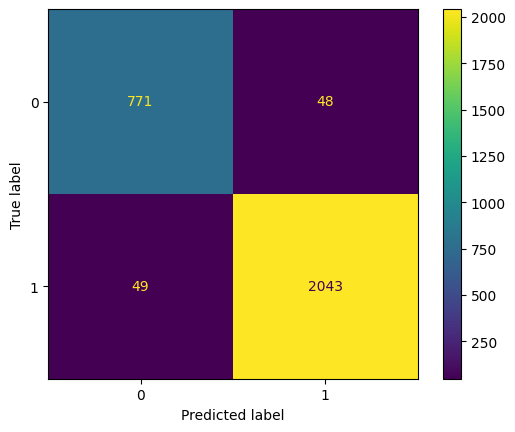

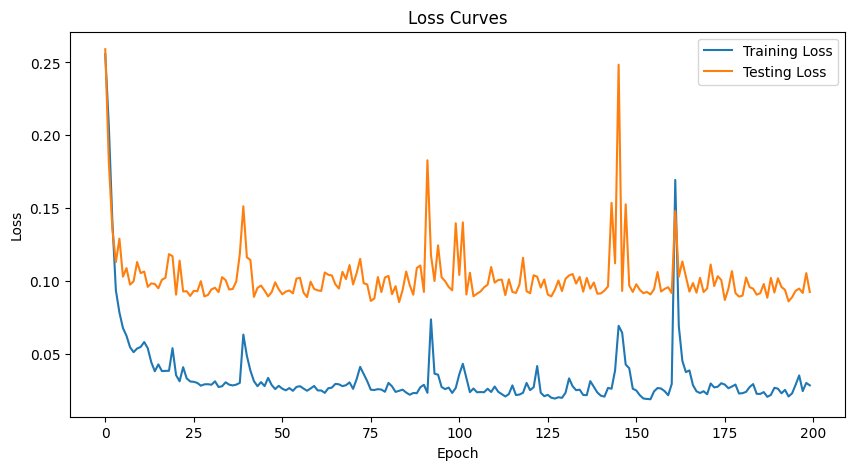

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.021 | Train Acc: 99.73% | Test NLL: 0.090 | Test Acc: 96.91%
Epoch 02 | Train NLL: 0.019 | Train Acc: 99.85% | Test NLL: 0.089 | Test Acc: 96.98%
Epoch 03 | Train NLL: 0.018 | Train Acc: 99.85% | Test NLL: 0.092 | Test Acc: 96.84%
Epoch 04 | Train NLL: 0.018 | Train Acc: 99.81% | Test NLL: 0.091 | Test Acc: 96.70%
Epoch 05 | Train NLL: 0.019 | Train Acc: 99.74% | Test NLL: 0.092 | Test Acc: 96.74%
Epoch 06 | Train NLL: 0.018 | Train Acc: 99.79% | Test NLL: 0.086 | Test Acc: 97.01%
Epoch 07 | Train NLL: 0.017 | Train Acc: 99.87% | Test NLL: 0.087 | Test Acc: 96.94%
Epoch 08 | Train NLL: 0.017 | Train Acc: 99.88% | Test NLL: 0.086 | Test Acc: 96.84%
Epoch 09 | Train NLL: 0.017 | Train Acc: 99.88% | Test NLL: 0.085 | Test Acc: 97.15%
Epoch 10 | Train NLL: 0.016 | Train Acc: 99.88% | Test NLL: 0.088 | Test Acc: 97.01%
Epoch 11 | Train NLL: 0.017 | Train Acc: 99.87% | Test NLL: 0.086

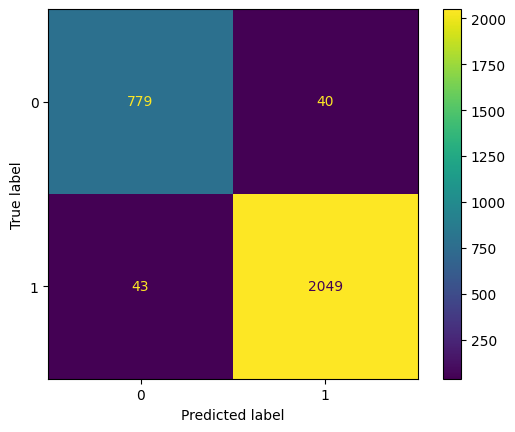

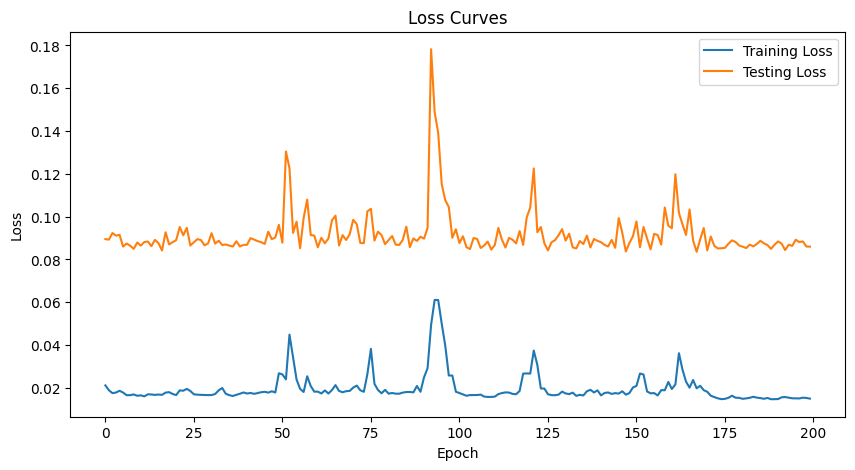

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.015 | Train Acc: 99.93% | Test NLL: 0.080 | Test Acc: 97.05%
Epoch 02 | Train NLL: 0.015 | Train Acc: 99.95% | Test NLL: 0.080 | Test Acc: 97.05%
Epoch 03 | Train NLL: 0.014 | Train Acc: 99.97% | Test NLL: 0.079 | Test Acc: 97.05%
Epoch 04 | Train NLL: 0.014 | Train Acc: 99.95% | Test NLL: 0.080 | Test Acc: 96.98%
Epoch 05 | Train NLL: 0.014 | Train Acc: 99.97% | Test NLL: 0.080 | Test Acc: 97.05%
Epoch 06 | Train NLL: 0.015 | Train Acc: 99.93% | Test NLL: 0.080 | Test Acc: 97.01%
Epoch 07 | Train NLL: 0.015 | Train Acc: 99.94% | Test NLL: 0.080 | Test Acc: 96.91%
Epoch 08 | Train NLL: 0.015 | Train Acc: 99.96% | Test NLL: 0.080 | Test Acc: 97.08%
Epoch 09 | Train NLL: 0.014 | Train Acc: 99.95% | Test NLL: 0.080 | Test Acc: 97.01%
Epoch 10 | Train NLL: 0.014 | Train Acc: 99.96% | Test NLL: 0.081 | Test Acc: 96.98%
Epoch 11 | Train NLL: 0.015 | Train Acc: 99.94% | Test NLL: 0.080

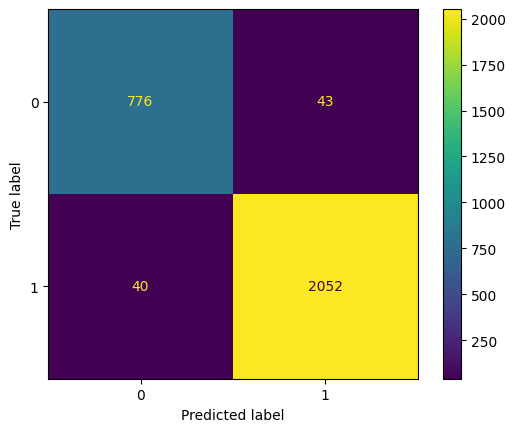

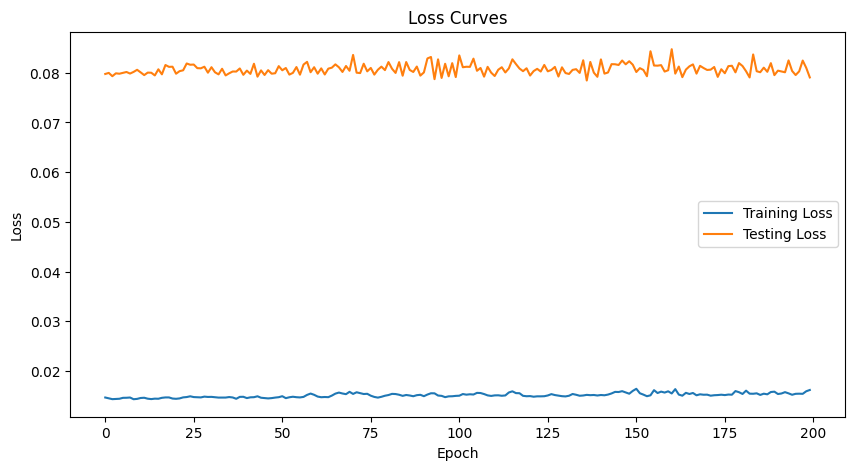

**************************************************



In [42]:
from scipy.sparse import csr_matrix

X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 128

num_classes = 2

pytorchNet = SimplePytorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.ReLU(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=187, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=2, bias=True)
  (activation3): ReLU6()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.708 | Train Acc: 27.72% | Test NLL: 0.703 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.699 | Train Acc: 27.72% | Test NLL: 0.695 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.694 | Train Acc: 27.72% | Test NLL: 0.694 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.694 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Trai

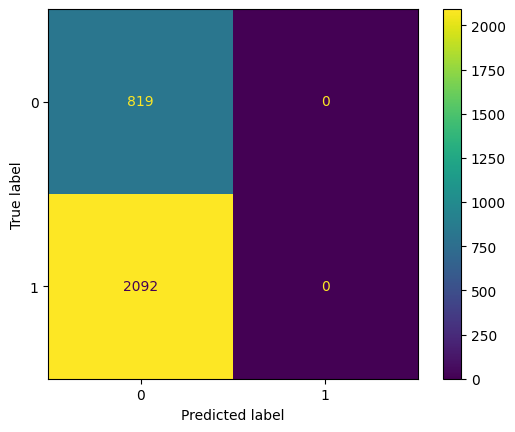

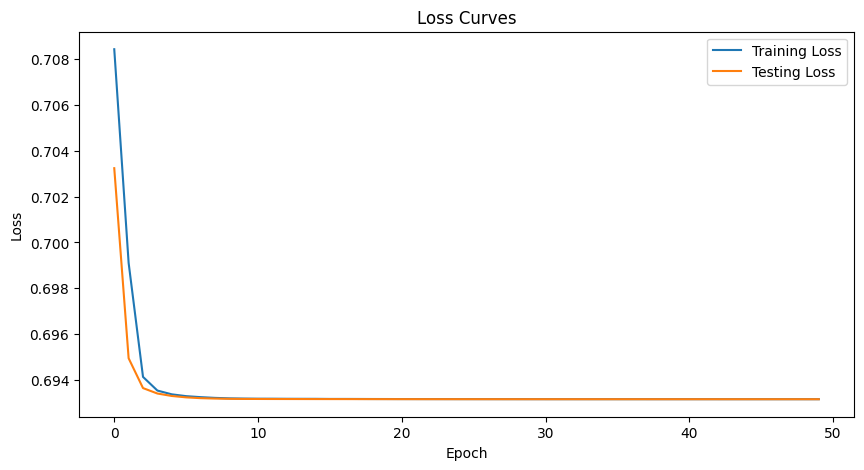

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 

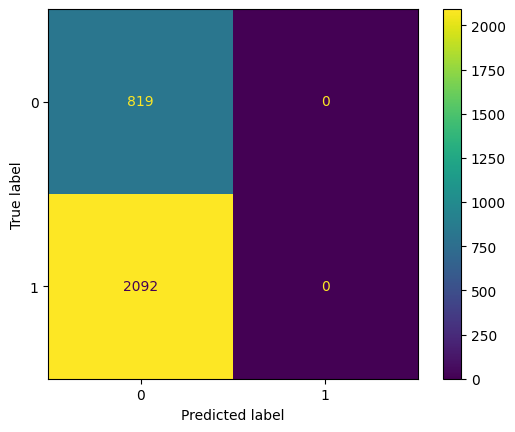

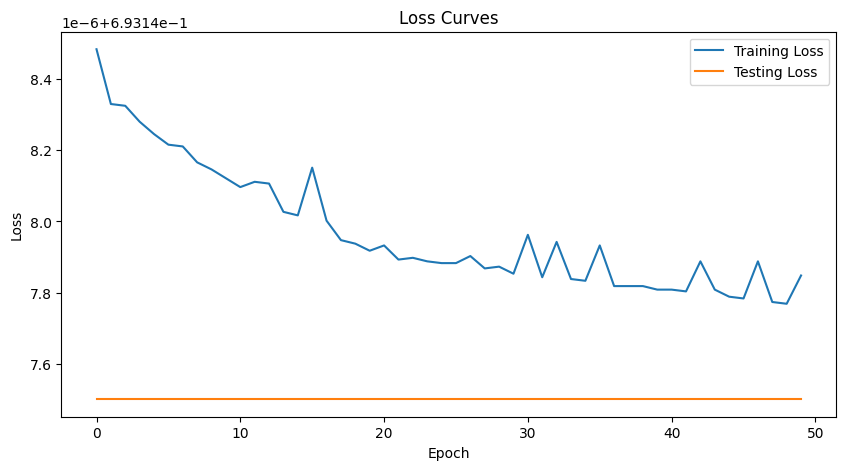

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 

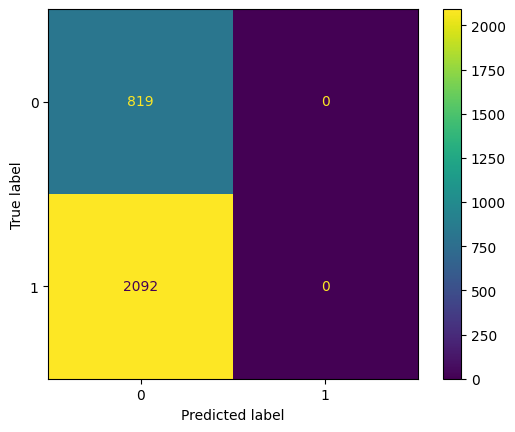

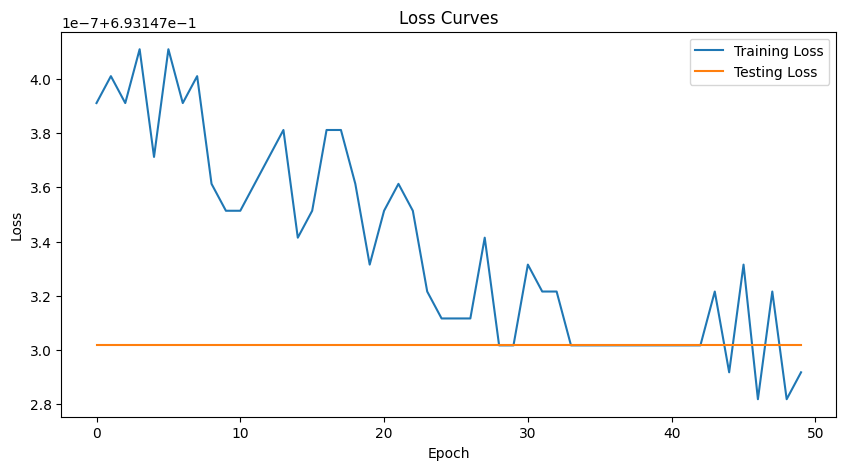

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 

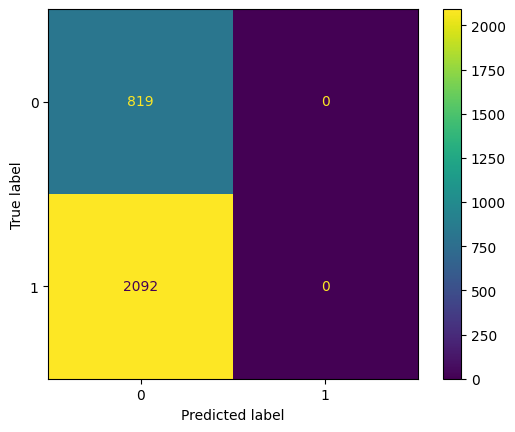

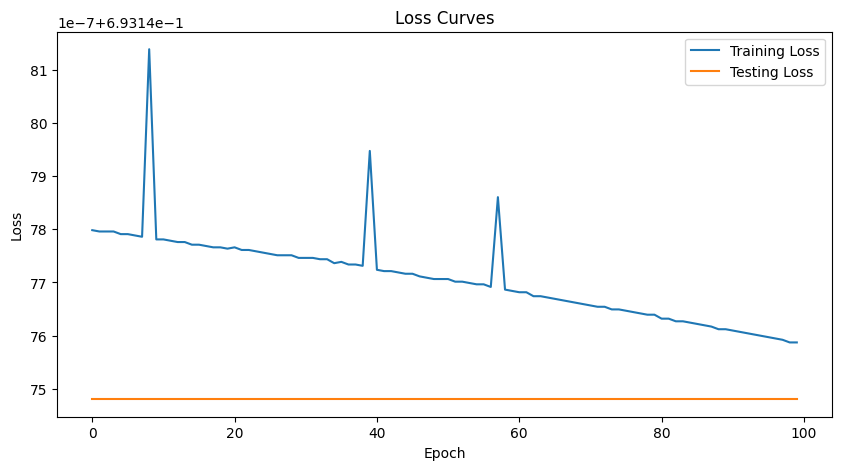

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

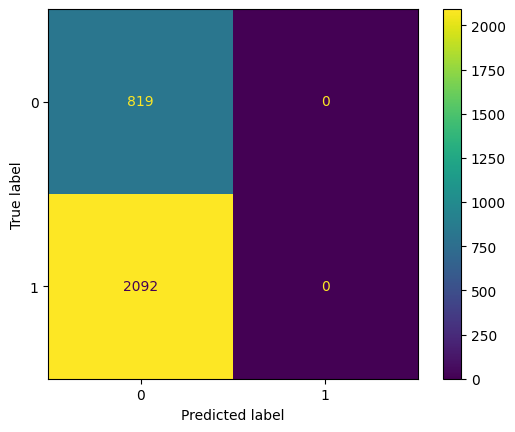

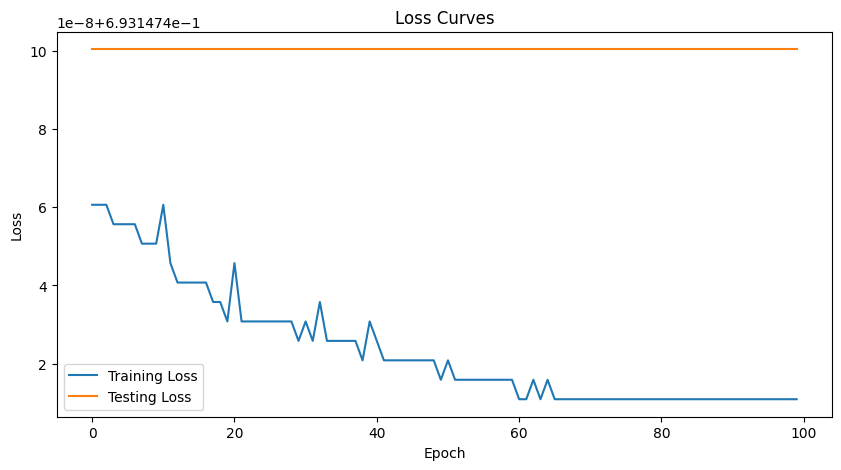

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

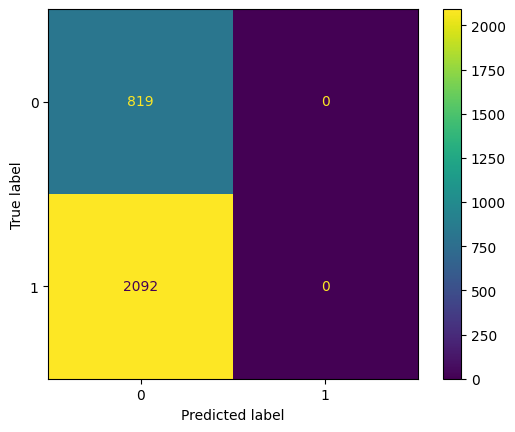

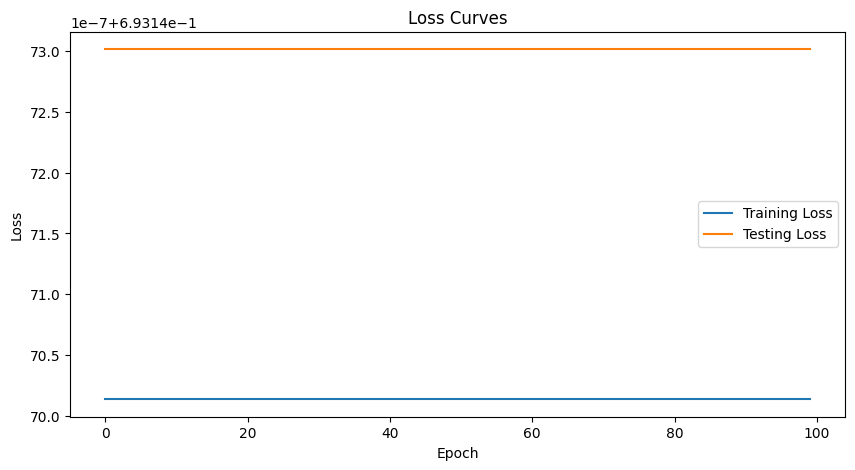

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 

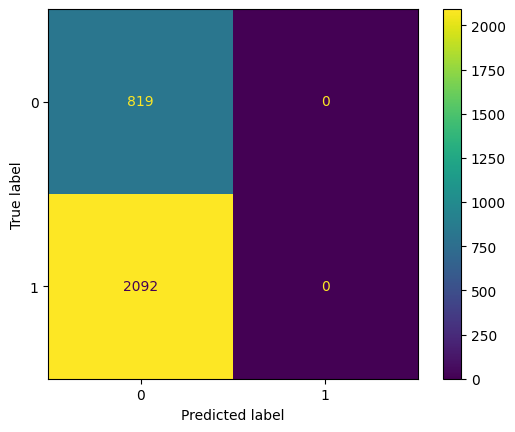

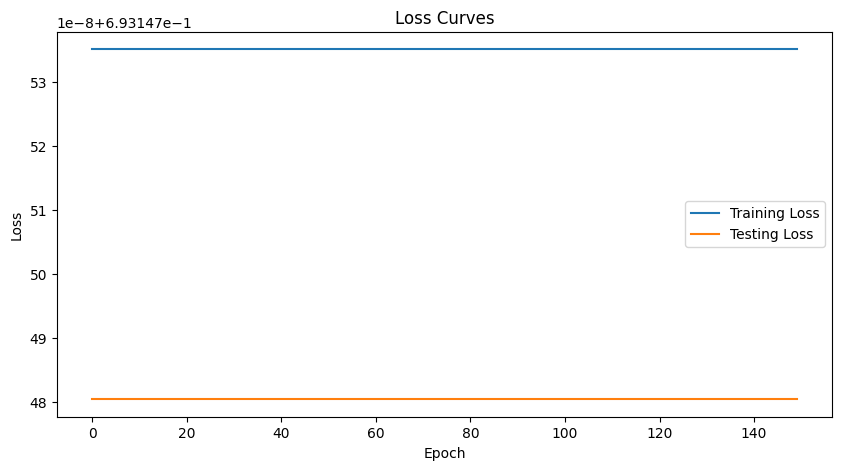

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

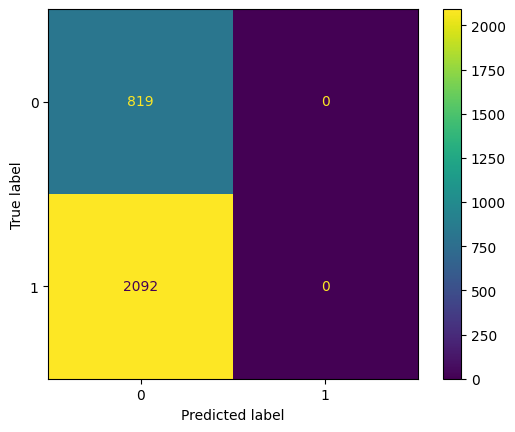

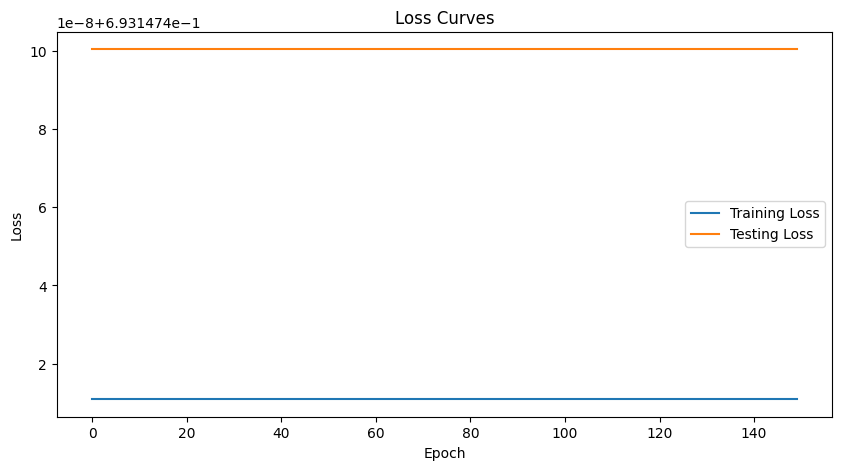

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

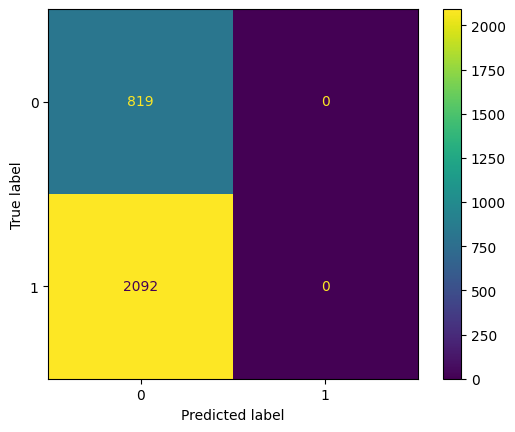

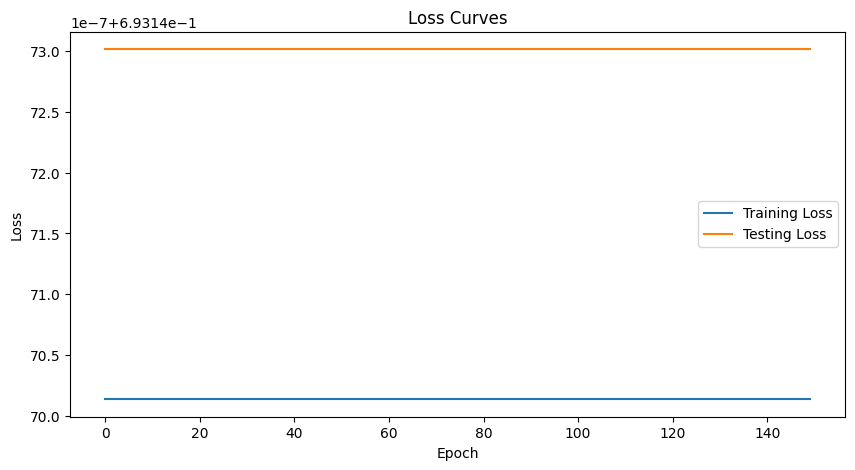

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 

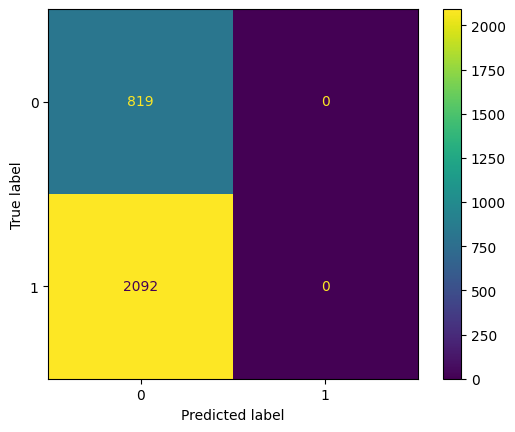

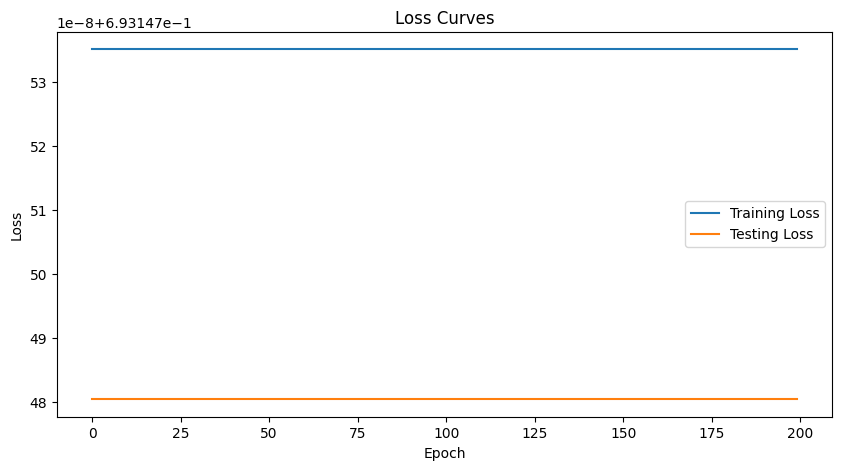

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

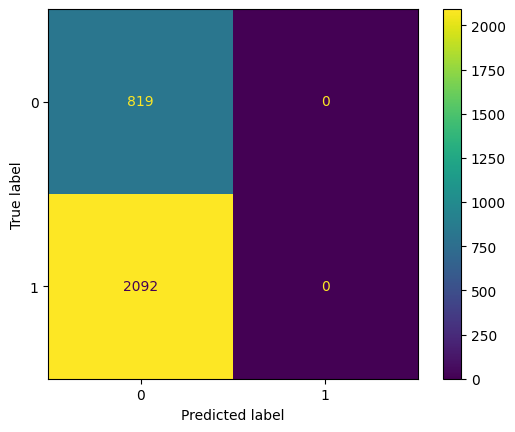

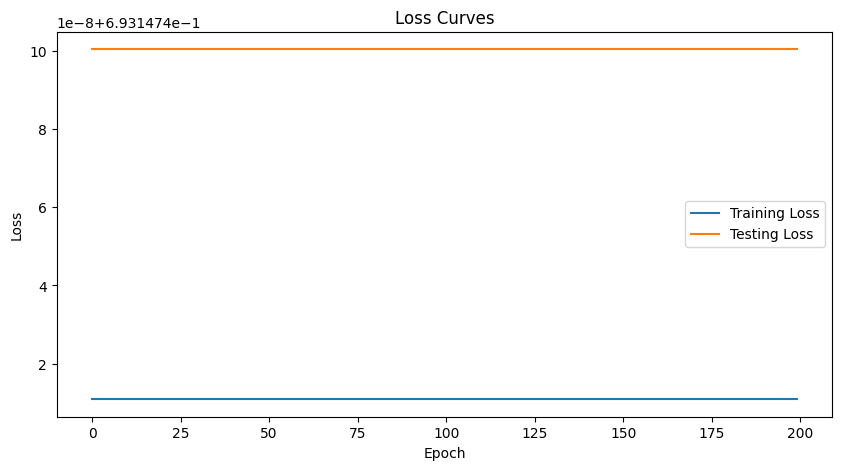

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 03 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 04 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 05 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 06 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 07 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 08 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 09 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 10 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693 | Test Acc: 28.13%
Epoch 11 | Train NLL: 0.693 | Train Acc: 27.72% | Test NLL: 0.693

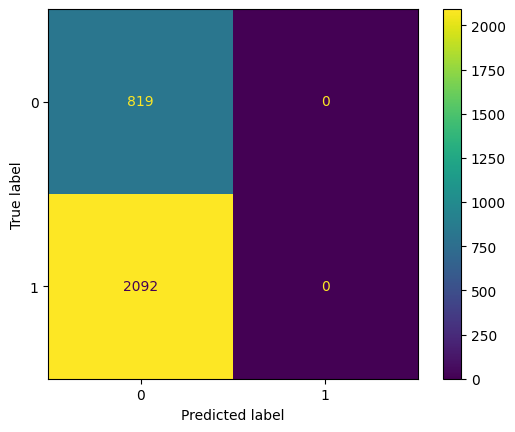

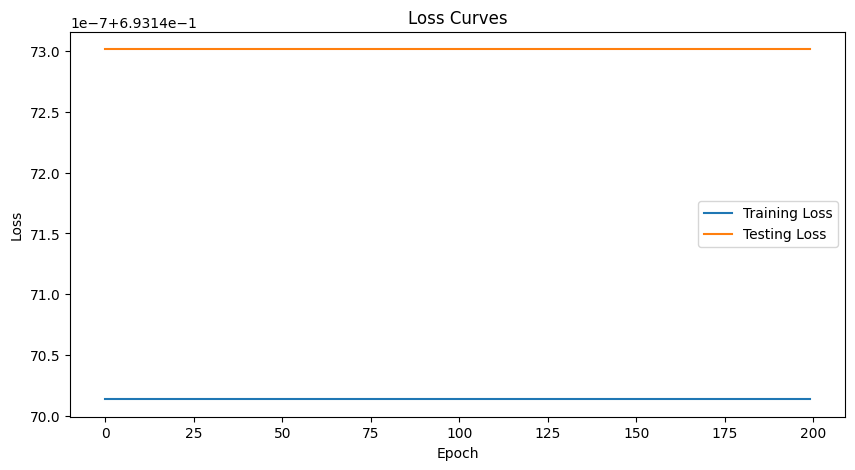

**************************************************



In [43]:
from scipy.sparse import csr_matrix

X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 64

num_classes = 2

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.ReLU6(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.SGD(pytorchNet.parameters(), lr=0.005),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=187, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=2, bias=True)
  (activation3): Sigmoid()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.602 | Train Acc: 72.28% | Test NLL: 0.580 | Test Acc: 71.87%
Epoch 02 | Train NLL: 0.556 | Train Acc: 72.26% | Test NLL: 0.534 | Test Acc: 74.82%
Epoch 03 | Train NLL: 0.517 | Train Acc: 78.74% | Test NLL: 0.497 | Test Acc: 80.59%
Epoch 04 | Train NLL: 0.491 | Train Acc: 81.15% | Test NLL: 0.479 | Test Acc: 82.62%
Epoch 05 | Train NLL: 0.475 | Train Acc: 83.26% | Test NLL: 0.472 | Test Acc: 84.03%
Epoch 06 | Train NLL: 0.465 | Train Acc: 84.43% | Test NLL: 0.469 | Test Acc: 83.58%
Epoch 07 | Train NLL: 0.455 | Train Acc: 85.49% | Test NLL: 0.454 | Test Acc: 85.43%
Epoch 08 | Train NLL: 0.449 | Train Acc: 85.95% | Test NLL: 0.445 | Test Acc: 86.16%
Epoch 09 | Tr

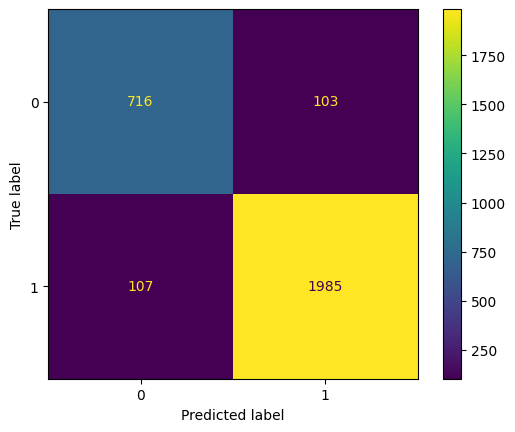

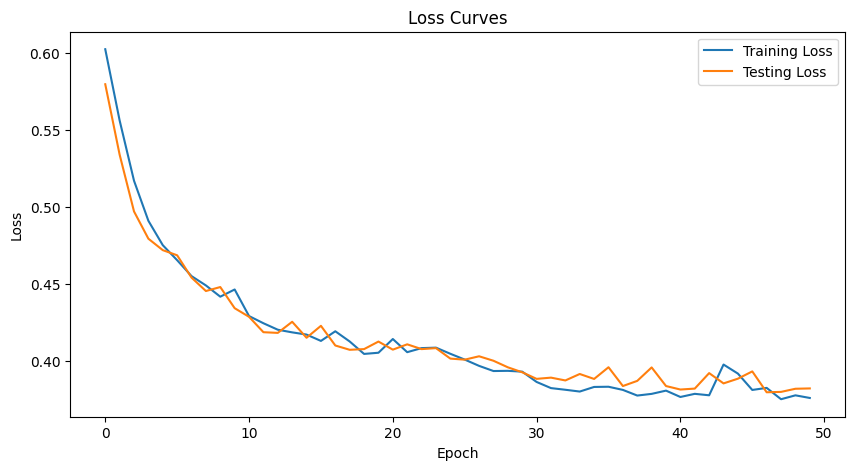

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.374 | Train Acc: 94.09% | Test NLL: 0.380 | Test Acc: 93.27%
Epoch 02 | Train NLL: 0.372 | Train Acc: 94.23% | Test NLL: 0.378 | Test Acc: 93.71%
Epoch 03 | Train NLL: 0.372 | Train Acc: 94.22% | Test NLL: 0.378 | Test Acc: 93.34%
Epoch 04 | Train NLL: 0.371 | Train Acc: 94.36% | Test NLL: 0.377 | Test Acc: 93.51%
Epoch 05 | Train NLL: 0.370 | Train Acc: 94.42% | Test NLL: 0.378 | Test Acc: 93.71%
Epoch 06 | Train NLL: 0.371 | Train Acc: 94.30% | Test NLL: 0.379 | Test Acc: 93.34%
Epoch 07 | Train NLL: 0.370 | Train Acc: 94.55% | Test NLL: 0.377 | Test Acc: 93.75%
Epoch 08 | Train NLL: 0.371 | Train Acc: 94.37% | Test NLL: 0.377 | Test Acc: 93.85%
Epoch 09 | Train NLL: 0.371 | Train Acc: 94.53% | Test NLL: 0.382 | Test Acc: 93.03%
Epoch 10 | Train NLL: 0.380 | Train Acc: 93.45% | Test NLL: 0.389 | Test Acc: 92.31%
Epoch 11 | Train NLL: 0.380 | Train Acc: 93.39% | Test NLL: 0.385 

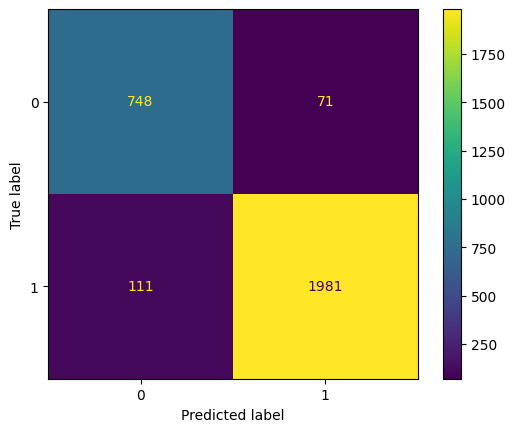

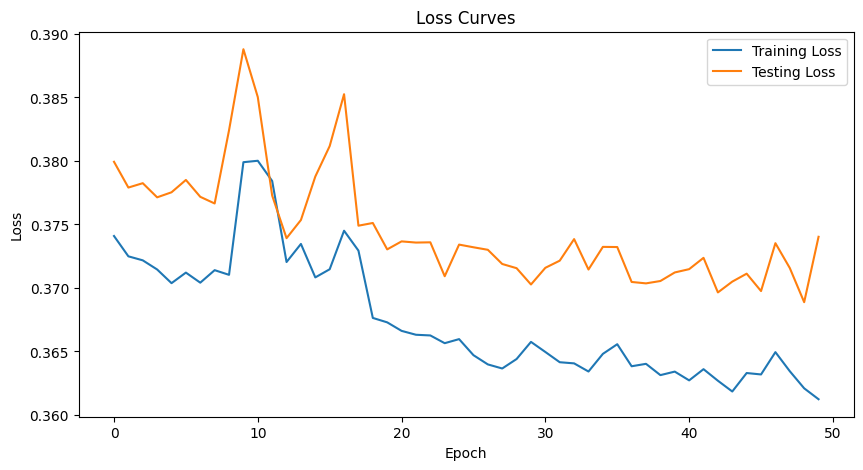

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.363 | Train Acc: 95.32% | Test NLL: 0.370 | Test Acc: 94.16%
Epoch 02 | Train NLL: 0.364 | Train Acc: 95.24% | Test NLL: 0.372 | Test Acc: 93.89%
Epoch 03 | Train NLL: 0.365 | Train Acc: 94.97% | Test NLL: 0.367 | Test Acc: 94.74%
Epoch 04 | Train NLL: 0.364 | Train Acc: 95.20% | Test NLL: 0.375 | Test Acc: 93.78%
Epoch 05 | Train NLL: 0.366 | Train Acc: 94.99% | Test NLL: 0.373 | Test Acc: 93.95%
Epoch 06 | Train NLL: 0.365 | Train Acc: 95.10% | Test NLL: 0.371 | Test Acc: 94.06%
Epoch 07 | Train NLL: 0.364 | Train Acc: 95.17% | Test NLL: 0.370 | Test Acc: 94.23%
Epoch 08 | Train NLL: 0.362 | Train Acc: 95.40% | Test NLL: 0.375 | Test Acc: 93.61%
Epoch 09 | Train NLL: 0.362 | Train Acc: 95.26% | Test NLL: 0.368 | Test Acc: 94.30%
Epoch 10 | Train NLL: 0.360 | Train Acc: 95.61% | Test NLL: 0.368 | Test Acc: 94.43%
Epoch 11 | Train NLL: 0.360 | Train Acc: 95.63% | Test NLL: 0.368 

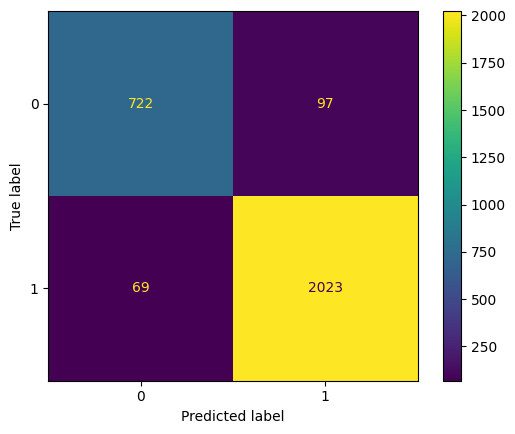

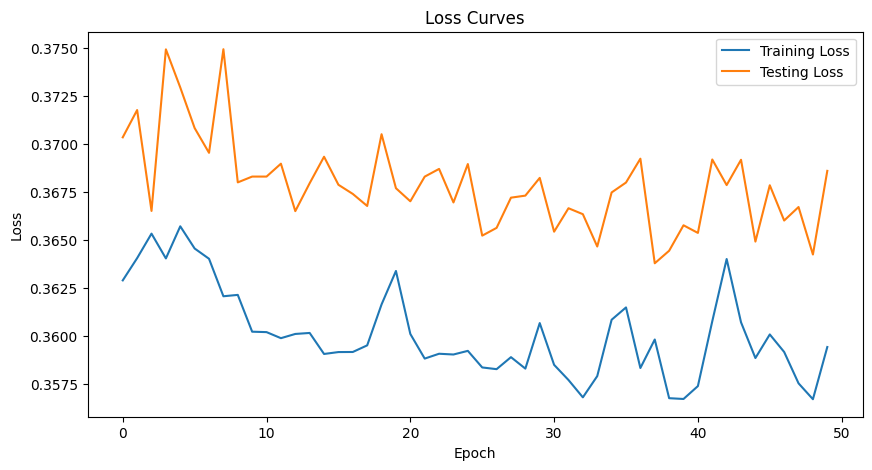

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.358 | Train Acc: 95.70% | Test NLL: 0.373 | Test Acc: 94.02%
Epoch 02 | Train NLL: 0.363 | Train Acc: 95.18% | Test NLL: 0.387 | Test Acc: 92.31%
Epoch 03 | Train NLL: 0.368 | Train Acc: 94.64% | Test NLL: 0.372 | Test Acc: 93.92%
Epoch 04 | Train NLL: 0.361 | Train Acc: 95.41% | Test NLL: 0.365 | Test Acc: 94.78%
Epoch 05 | Train NLL: 0.363 | Train Acc: 95.16% | Test NLL: 0.365 | Test Acc: 95.02%
Epoch 06 | Train NLL: 0.360 | Train Acc: 95.51% | Test NLL: 0.370 | Test Acc: 94.23%
Epoch 07 | Train NLL: 0.360 | Train Acc: 95.54% | Test NLL: 0.364 | Test Acc: 94.92%
Epoch 08 | Train NLL: 0.360 | Train Acc: 95.55% | Test NLL: 0.365 | Test Acc: 94.81%
Epoch 09 | Train NLL: 0.360 | Train Acc: 95.43% | Test NLL: 0.368 | Test Acc: 94.50%
Epoch 10 | Train NLL: 0.360 | Train Acc: 95.53% | Test NLL: 0.371 | Test Acc: 94.19%
Epoch 11 | Train NLL: 0.362 | Train Acc: 95.22% | Test NLL: 0.367 

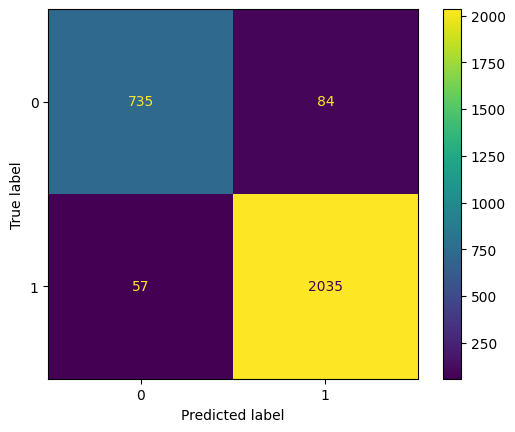

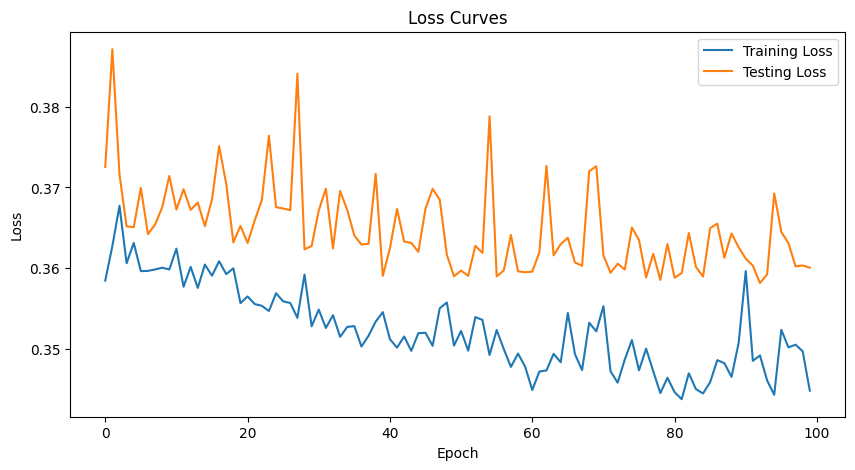

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.343 | Train Acc: 97.37% | Test NLL: 0.361 | Test Acc: 95.26%
Epoch 02 | Train NLL: 0.342 | Train Acc: 97.31% | Test NLL: 0.359 | Test Acc: 95.33%
Epoch 03 | Train NLL: 0.341 | Train Acc: 97.51% | Test NLL: 0.361 | Test Acc: 95.29%
Epoch 04 | Train NLL: 0.342 | Train Acc: 97.50% | Test NLL: 0.361 | Test Acc: 95.16%
Epoch 05 | Train NLL: 0.342 | Train Acc: 97.41% | Test NLL: 0.359 | Test Acc: 95.33%
Epoch 06 | Train NLL: 0.343 | Train Acc: 97.35% | Test NLL: 0.361 | Test Acc: 95.19%
Epoch 07 | Train NLL: 0.341 | Train Acc: 97.48% | Test NLL: 0.358 | Test Acc: 95.36%
Epoch 08 | Train NLL: 0.342 | Train Acc: 97.43% | Test NLL: 0.361 | Test Acc: 95.12%
Epoch 09 | Train NLL: 0.342 | Train Acc: 97.42% | Test NLL: 0.362 | Test Acc: 95.05%
Epoch 10 | Train NLL: 0.341 | Train Acc: 97.45% | Test NLL: 0.359 | Test Acc: 95.26%
Epoch 11 | Train NLL: 0.340 | Train Acc: 97.62% | Test NLL: 0.358

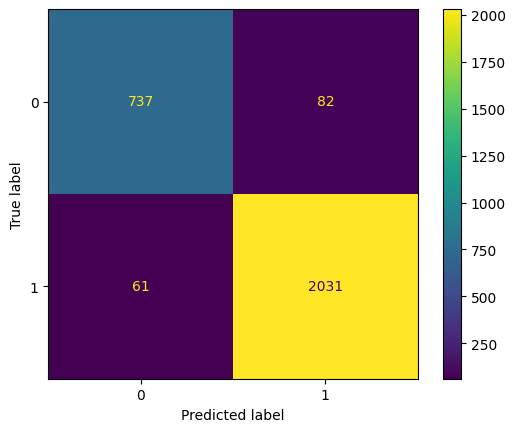

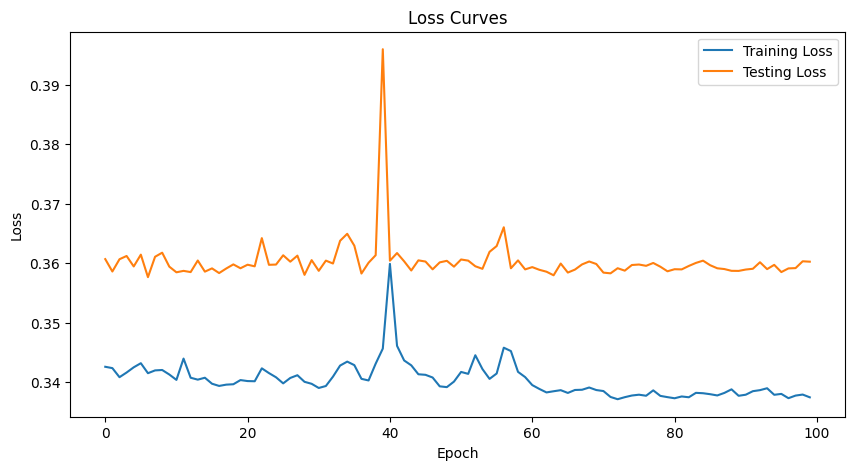

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.338 | Train Acc: 97.92% | Test NLL: 0.358 | Test Acc: 95.36%
Epoch 02 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.358 | Test Acc: 95.36%
Epoch 03 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.358 | Test Acc: 95.23%
Epoch 04 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.359 | Test Acc: 95.26%
Epoch 05 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.359 | Test Acc: 95.16%
Epoch 06 | Train NLL: 0.337 | Train Acc: 97.90% | Test NLL: 0.359 | Test Acc: 95.02%
Epoch 07 | Train NLL: 0.337 | Train Acc: 97.90% | Test NLL: 0.359 | Test Acc: 95.19%
Epoch 08 | Train NLL: 0.337 | Train Acc: 97.92% | Test NLL: 0.358 | Test Acc: 95.16%
Epoch 09 | Train NLL: 0.337 | Train Acc: 97.92% | Test NLL: 0.358 | Test Acc: 95.29%
Epoch 10 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.358 | Test Acc: 95.26%
Epoch 11 | Train NLL: 0.337 | Train Acc: 97.92% | Test NLL: 0.358

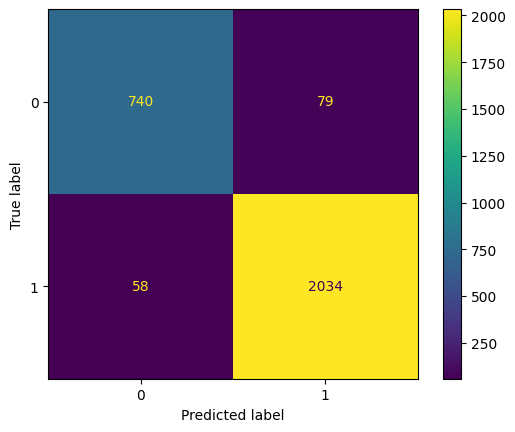

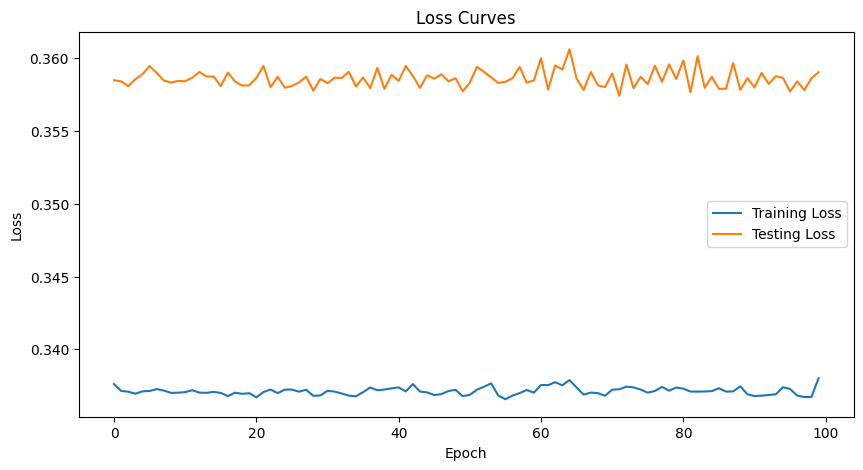

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.357 | Train Acc: 95.89% | Test NLL: 0.394 | Test Acc: 91.41%
Epoch 02 | Train NLL: 0.370 | Train Acc: 94.10% | Test NLL: 0.370 | Test Acc: 94.16%
Epoch 03 | Train NLL: 0.363 | Train Acc: 95.15% | Test NLL: 0.367 | Test Acc: 94.47%
Epoch 04 | Train NLL: 0.354 | Train Acc: 96.06% | Test NLL: 0.380 | Test Acc: 93.06%
Epoch 05 | Train NLL: 0.358 | Train Acc: 95.59% | Test NLL: 0.377 | Test Acc: 93.27%
Epoch 06 | Train NLL: 0.360 | Train Acc: 95.31% | Test NLL: 0.367 | Test Acc: 94.50%
Epoch 07 | Train NLL: 0.353 | Train Acc: 96.02% | Test NLL: 0.369 | Test Acc: 94.19%
Epoch 08 | Train NLL: 0.355 | Train Acc: 95.93% | Test NLL: 0.369 | Test Acc: 94.33%
Epoch 09 | Train NLL: 0.352 | Train Acc: 96.35% | Test NLL: 0.368 | Test Acc: 94.19%
Epoch 10 | Train NLL: 0.357 | Train Acc: 95.86% | Test NLL: 0.366 | Test Acc: 94.85%
Epoch 11 | Train NLL: 0.353 | Train Acc: 96.13% | Test NLL: 0.361 

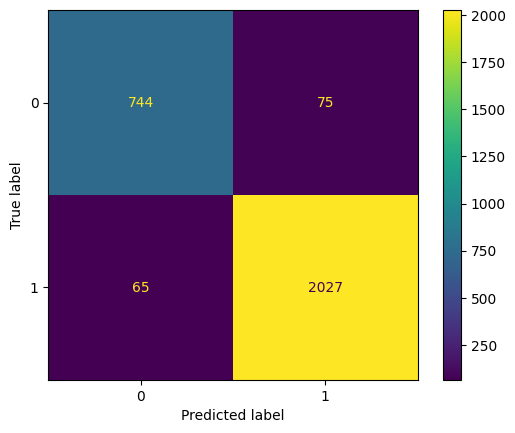

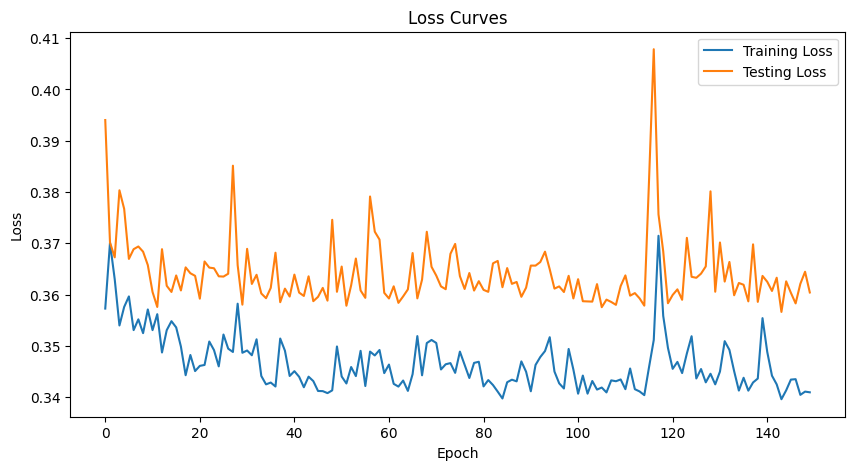

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.340 | Train Acc: 97.53% | Test NLL: 0.360 | Test Acc: 95.19%
Epoch 02 | Train NLL: 0.341 | Train Acc: 97.43% | Test NLL: 0.360 | Test Acc: 95.50%
Epoch 03 | Train NLL: 0.340 | Train Acc: 97.59% | Test NLL: 0.357 | Test Acc: 95.57%
Epoch 04 | Train NLL: 0.338 | Train Acc: 97.79% | Test NLL: 0.357 | Test Acc: 95.53%
Epoch 05 | Train NLL: 0.338 | Train Acc: 97.81% | Test NLL: 0.358 | Test Acc: 95.53%
Epoch 06 | Train NLL: 0.339 | Train Acc: 97.67% | Test NLL: 0.360 | Test Acc: 95.43%
Epoch 07 | Train NLL: 0.338 | Train Acc: 97.84% | Test NLL: 0.357 | Test Acc: 95.57%
Epoch 08 | Train NLL: 0.338 | Train Acc: 97.84% | Test NLL: 0.357 | Test Acc: 95.60%
Epoch 09 | Train NLL: 0.337 | Train Acc: 97.90% | Test NLL: 0.357 | Test Acc: 95.71%
Epoch 10 | Train NLL: 0.337 | Train Acc: 97.91% | Test NLL: 0.357 | Test Acc: 95.60%
Epoch 11 | Train NLL: 0.338 | Train Acc: 97.78% | Test NLL: 0.357

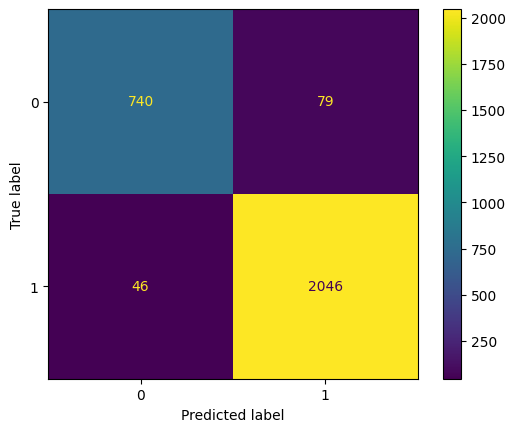

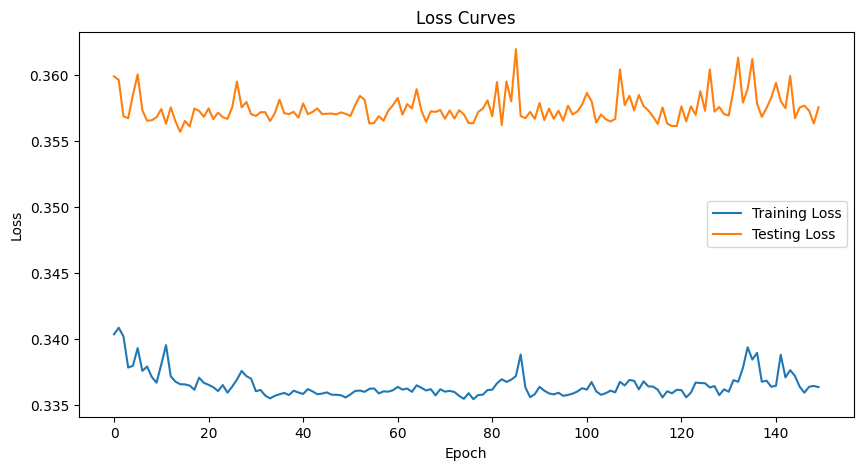

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.336 | Train Acc: 98.04% | Test NLL: 0.356 | Test Acc: 95.88%
Epoch 02 | Train NLL: 0.336 | Train Acc: 98.03% | Test NLL: 0.355 | Test Acc: 95.77%
Epoch 03 | Train NLL: 0.336 | Train Acc: 98.05% | Test NLL: 0.356 | Test Acc: 95.64%
Epoch 04 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356 | Test Acc: 95.67%
Epoch 05 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.355 | Test Acc: 95.74%
Epoch 06 | Train NLL: 0.335 | Train Acc: 98.05% | Test NLL: 0.356 | Test Acc: 95.81%
Epoch 07 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356 | Test Acc: 95.64%
Epoch 08 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356 | Test Acc: 95.71%
Epoch 09 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356 | Test Acc: 95.60%
Epoch 10 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356 | Test Acc: 95.77%
Epoch 11 | Train NLL: 0.335 | Train Acc: 98.06% | Test NLL: 0.356

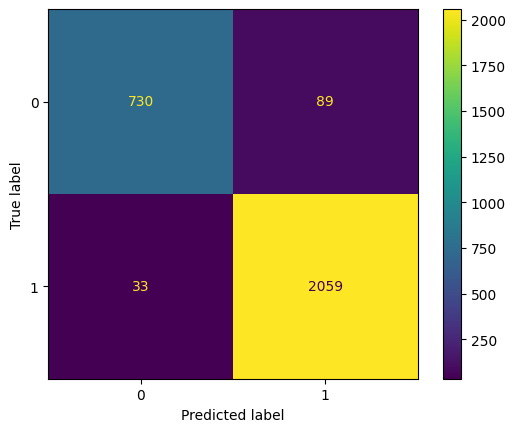

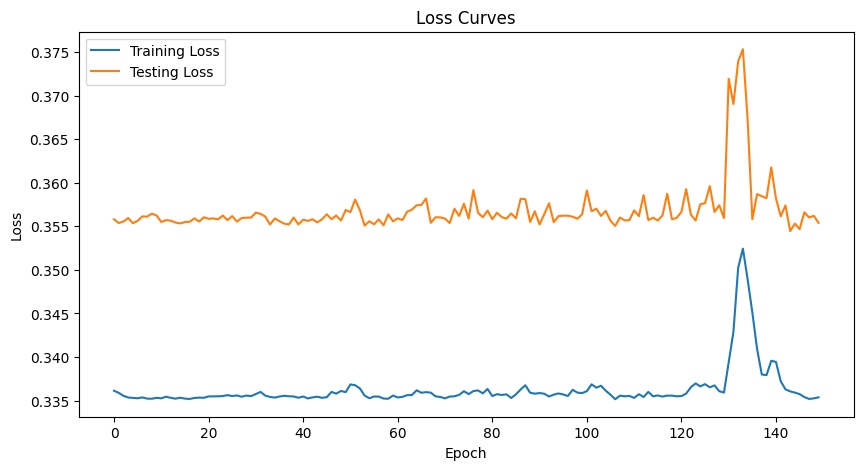

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.341 | Train Acc: 97.60% | Test NLL: 0.365 | Test Acc: 94.74%
Epoch 02 | Train NLL: 0.376 | Train Acc: 93.68% | Test NLL: 0.427 | Test Acc: 88.25%
Epoch 03 | Train NLL: 0.385 | Train Acc: 92.53% | Test NLL: 0.382 | Test Acc: 92.68%
Epoch 04 | Train NLL: 0.364 | Train Acc: 94.85% | Test NLL: 0.362 | Test Acc: 94.98%
Epoch 05 | Train NLL: 0.355 | Train Acc: 95.84% | Test NLL: 0.363 | Test Acc: 95.02%
Epoch 06 | Train NLL: 0.353 | Train Acc: 96.25% | Test NLL: 0.362 | Test Acc: 95.26%
Epoch 07 | Train NLL: 0.347 | Train Acc: 96.82% | Test NLL: 0.365 | Test Acc: 94.40%
Epoch 08 | Train NLL: 0.344 | Train Acc: 97.11% | Test NLL: 0.370 | Test Acc: 94.37%
Epoch 09 | Train NLL: 0.352 | Train Acc: 96.13% | Test NLL: 0.361 | Test Acc: 95.19%
Epoch 10 | Train NLL: 0.349 | Train Acc: 96.53% | Test NLL: 0.381 | Test Acc: 93.03%
Epoch 11 | Train NLL: 0.347 | Train Acc: 96.78% | Test NLL: 0.361 

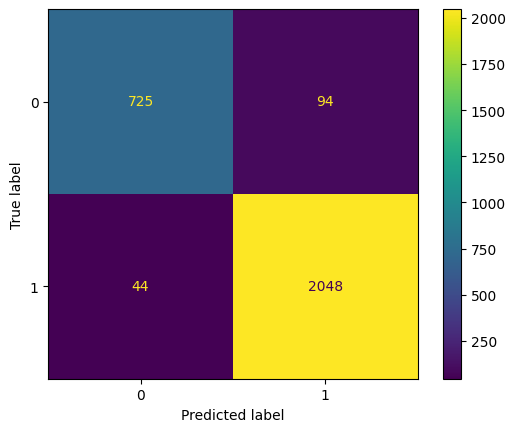

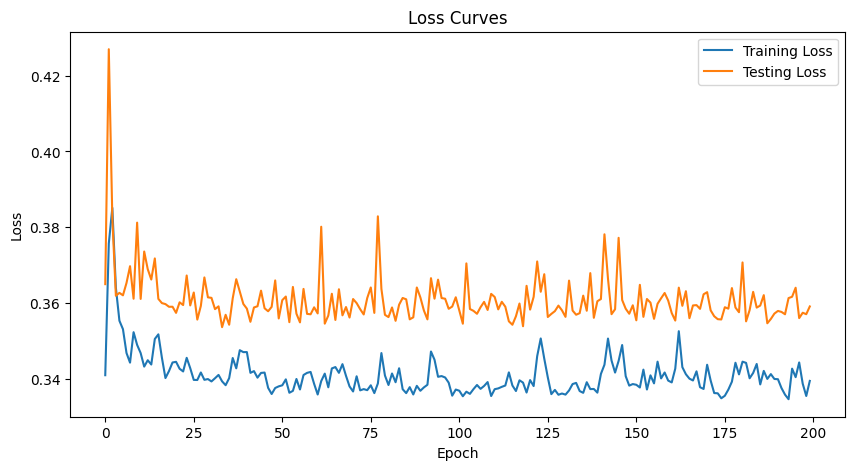

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.337 | Train Acc: 97.81% | Test NLL: 0.357 | Test Acc: 95.53%
Epoch 02 | Train NLL: 0.335 | Train Acc: 98.09% | Test NLL: 0.355 | Test Acc: 95.74%
Epoch 03 | Train NLL: 0.333 | Train Acc: 98.30% | Test NLL: 0.354 | Test Acc: 95.88%
Epoch 04 | Train NLL: 0.333 | Train Acc: 98.29% | Test NLL: 0.354 | Test Acc: 95.81%
Epoch 05 | Train NLL: 0.333 | Train Acc: 98.26% | Test NLL: 0.355 | Test Acc: 95.64%
Epoch 06 | Train NLL: 0.334 | Train Acc: 98.24% | Test NLL: 0.355 | Test Acc: 95.67%
Epoch 07 | Train NLL: 0.333 | Train Acc: 98.34% | Test NLL: 0.355 | Test Acc: 95.67%
Epoch 08 | Train NLL: 0.333 | Train Acc: 98.34% | Test NLL: 0.355 | Test Acc: 95.77%
Epoch 09 | Train NLL: 0.333 | Train Acc: 98.32% | Test NLL: 0.355 | Test Acc: 95.64%
Epoch 10 | Train NLL: 0.334 | Train Acc: 98.31% | Test NLL: 0.359 | Test Acc: 95.29%
Epoch 11 | Train NLL: 0.335 | Train Acc: 98.14% | Test NLL: 0.356

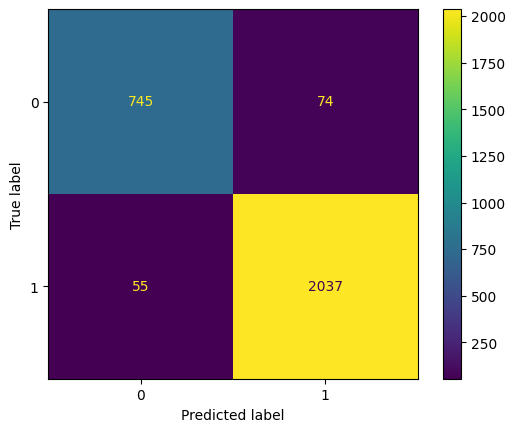

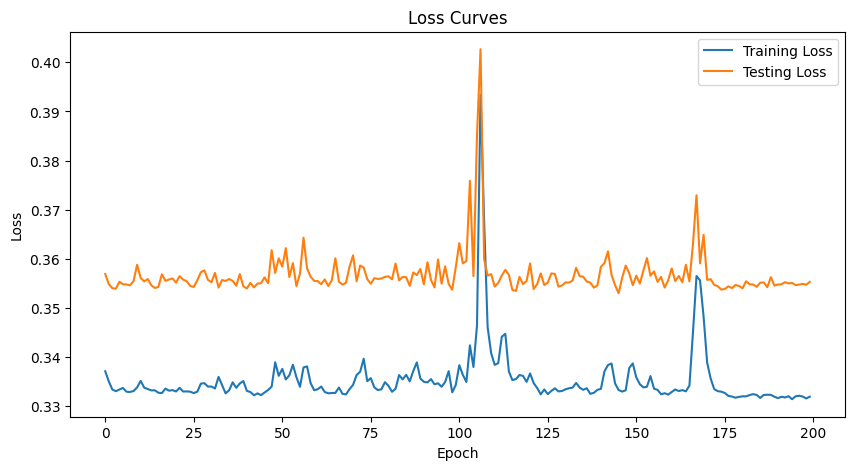

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.332 | Train Acc: 98.43% | Test NLL: 0.356 | Test Acc: 95.57%
Epoch 02 | Train NLL: 0.332 | Train Acc: 98.46% | Test NLL: 0.355 | Test Acc: 95.57%
Epoch 03 | Train NLL: 0.331 | Train Acc: 98.46% | Test NLL: 0.355 | Test Acc: 95.64%
Epoch 04 | Train NLL: 0.332 | Train Acc: 98.45% | Test NLL: 0.355 | Test Acc: 95.60%
Epoch 05 | Train NLL: 0.331 | Train Acc: 98.46% | Test NLL: 0.354 | Test Acc: 95.57%
Epoch 06 | Train NLL: 0.331 | Train Acc: 98.47% | Test NLL: 0.355 | Test Acc: 95.57%
Epoch 07 | Train NLL: 0.332 | Train Acc: 98.46% | Test NLL: 0.355 | Test Acc: 95.50%
Epoch 08 | Train NLL: 0.331 | Train Acc: 98.47% | Test NLL: 0.355 | Test Acc: 95.53%
Epoch 09 | Train NLL: 0.332 | Train Acc: 98.46% | Test NLL: 0.354 | Test Acc: 95.50%
Epoch 10 | Train NLL: 0.331 | Train Acc: 98.47% | Test NLL: 0.355 | Test Acc: 95.57%
Epoch 11 | Train NLL: 0.332 | Train Acc: 98.47% | Test NLL: 0.355

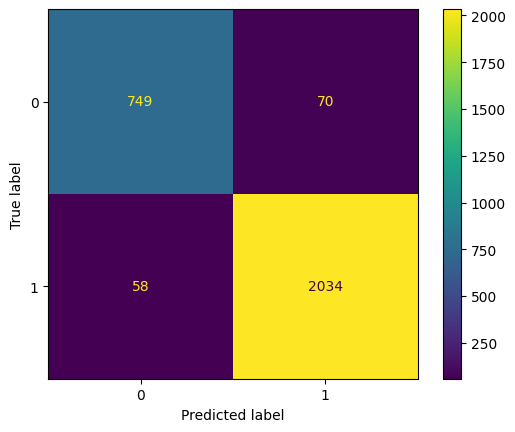

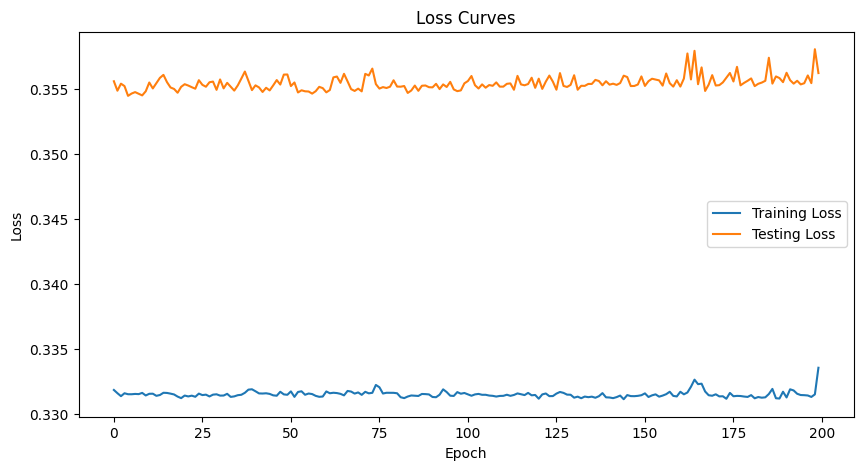

**************************************************



In [44]:
from scipy.sparse import csr_matrix

X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test =csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

HIDDEN_UNITS = 64

num_classes = 2

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Sigmoid(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

ComplexPyTorchMLP(
  (fc1): Linear(in_features=187, out_features=64, bias=True)
  (activation1): ReLU()
  (fc2): Linear(in_features=64, out_features=32, bias=True)
  (activation2): ReLU()
  (fc3): Linear(in_features=32, out_features=5, bias=True)
  (activation3): Tanh()
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.796 | Train Acc: 82.38% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 02 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 03 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 04 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 05 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 06 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 07 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 08 | Train NLL: 0.777 | Train Acc: 82.79% | Test NLL: 0.779 | Test Acc: 82.68%
Epoch 09 | Train

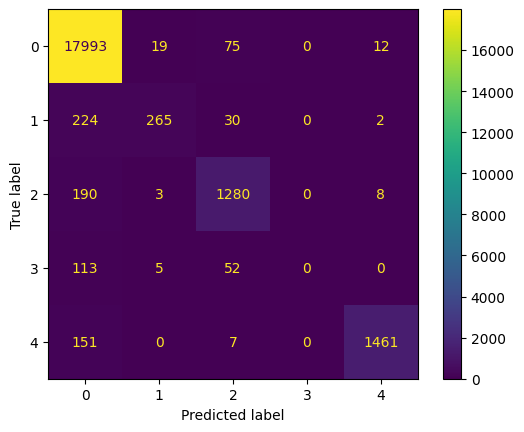

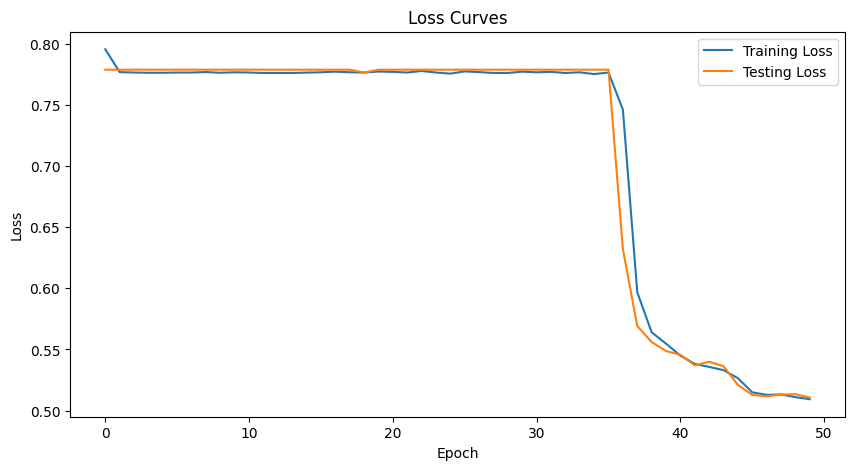

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.508 | Train Acc: 96.10% | Test NLL: 0.512 | Test Acc: 95.84%
Epoch 02 | Train NLL: 0.506 | Train Acc: 96.20% | Test NLL: 0.507 | Test Acc: 96.11%
Epoch 03 | Train NLL: 0.505 | Train Acc: 96.23% | Test NLL: 0.507 | Test Acc: 96.14%
Epoch 04 | Train NLL: 0.506 | Train Acc: 96.24% | Test NLL: 0.510 | Test Acc: 95.97%
Epoch 05 | Train NLL: 0.504 | Train Acc: 96.30% | Test NLL: 0.504 | Test Acc: 96.23%
Epoch 06 | Train NLL: 0.504 | Train Acc: 96.35% | Test NLL: 0.506 | Test Acc: 96.07%
Epoch 07 | Train NLL: 0.504 | Train Acc: 96.31% | Test NLL: 0.507 | Test Acc: 96.15%
Epoch 08 | Train NLL: 0.504 | Train Acc: 96.29% | Test NLL: 0.506 | Test Acc: 96.11%
Epoch 09 | Train NLL: 0.504 | Train Acc: 96.28% | Test NLL: 0.506 | Test Acc: 96.19%
Epoch 10 | Train NLL: 0.502 | Train Acc: 96.39% | Test NLL: 0.504 | Test Acc: 96.28%
Epoch 11 | Train NLL: 0.503 | Train Acc: 96.38% | Test NLL: 0.507 

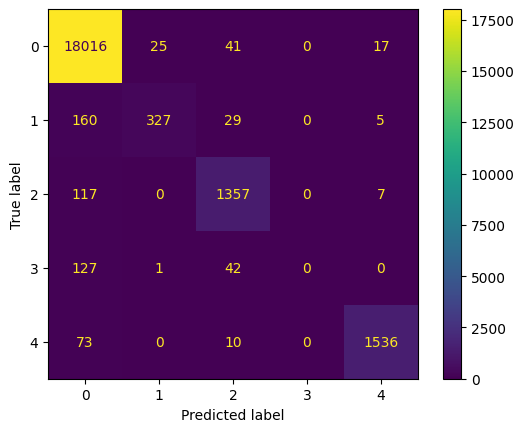

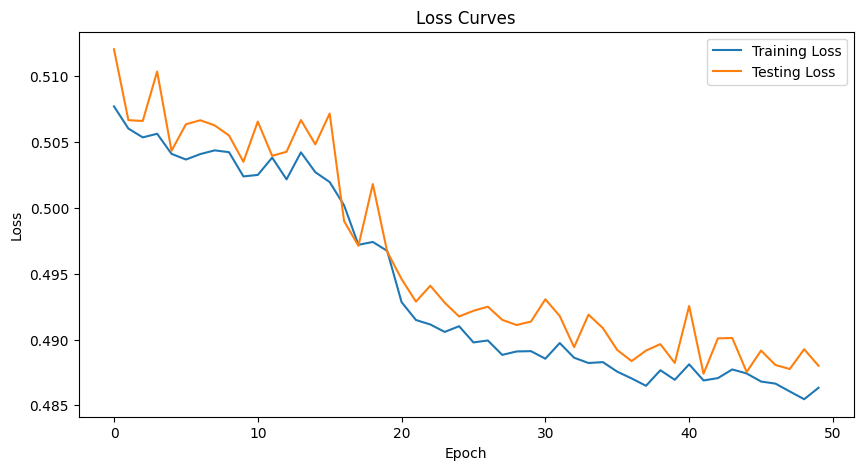

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.484 | Train Acc: 97.26% | Test NLL: 0.486 | Test Acc: 97.10%
Epoch 02 | Train NLL: 0.483 | Train Acc: 97.32% | Test NLL: 0.487 | Test Acc: 97.06%
Epoch 03 | Train NLL: 0.484 | Train Acc: 97.27% | Test NLL: 0.486 | Test Acc: 97.09%
Epoch 04 | Train NLL: 0.483 | Train Acc: 97.33% | Test NLL: 0.489 | Test Acc: 96.83%
Epoch 05 | Train NLL: 0.484 | Train Acc: 97.30% | Test NLL: 0.488 | Test Acc: 96.92%
Epoch 06 | Train NLL: 0.484 | Train Acc: 97.30% | Test NLL: 0.485 | Test Acc: 97.14%
Epoch 07 | Train NLL: 0.484 | Train Acc: 97.31% | Test NLL: 0.486 | Test Acc: 97.05%
Epoch 08 | Train NLL: 0.484 | Train Acc: 97.30% | Test NLL: 0.486 | Test Acc: 97.05%
Epoch 09 | Train NLL: 0.484 | Train Acc: 97.29% | Test NLL: 0.485 | Test Acc: 97.09%
Epoch 10 | Train NLL: 0.484 | Train Acc: 97.29% | Test NLL: 0.486 | Test Acc: 97.07%
Epoch 11 | Train NLL: 0.483 | Train Acc: 97.35% | Test NLL: 0.485 

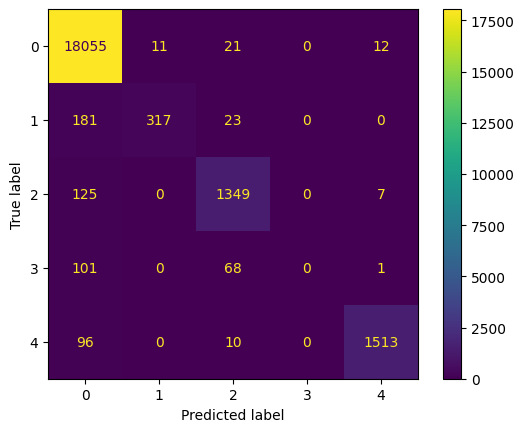

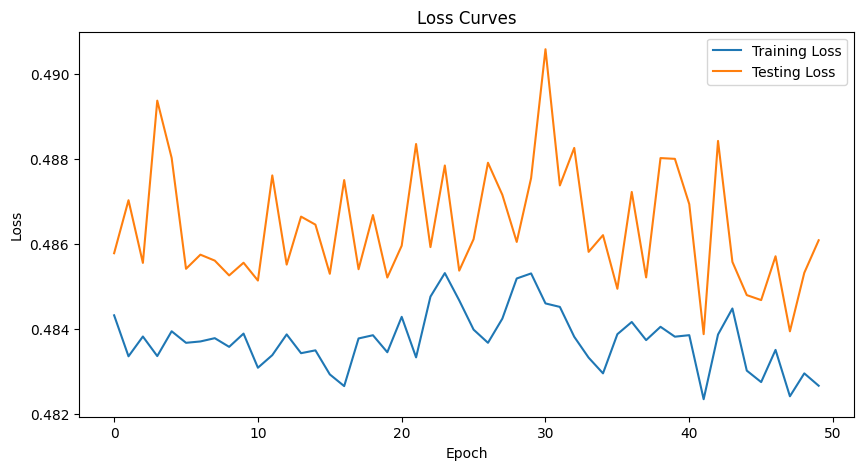

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.489 | Train Acc: 96.96% | Test NLL: 0.489 | Test Acc: 97.00%
Epoch 02 | Train NLL: 0.487 | Train Acc: 97.05% | Test NLL: 0.492 | Test Acc: 96.59%
Epoch 03 | Train NLL: 0.487 | Train Acc: 97.08% | Test NLL: 0.496 | Test Acc: 96.78%
Epoch 04 | Train NLL: 0.488 | Train Acc: 97.04% | Test NLL: 0.496 | Test Acc: 96.33%
Epoch 05 | Train NLL: 0.487 | Train Acc: 97.06% | Test NLL: 0.487 | Test Acc: 97.04%
Epoch 06 | Train NLL: 0.485 | Train Acc: 97.13% | Test NLL: 0.497 | Test Acc: 96.29%
Epoch 07 | Train NLL: 0.485 | Train Acc: 97.22% | Test NLL: 0.485 | Test Acc: 97.09%
Epoch 08 | Train NLL: 0.485 | Train Acc: 97.21% | Test NLL: 0.490 | Test Acc: 97.07%
Epoch 09 | Train NLL: 0.485 | Train Acc: 97.17% | Test NLL: 0.495 | Test Acc: 96.85%
Epoch 10 | Train NLL: 0.484 | Train Acc: 97.26% | Test NLL: 0.490 | Test Acc: 96.74%
Epoch 11 | Train NLL: 0.485 | Train Acc: 97.20% | Test NLL: 0.485 

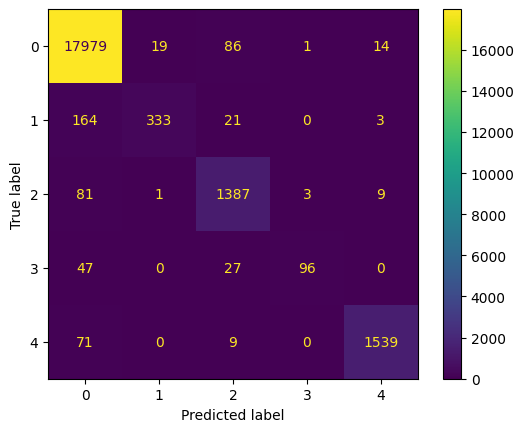

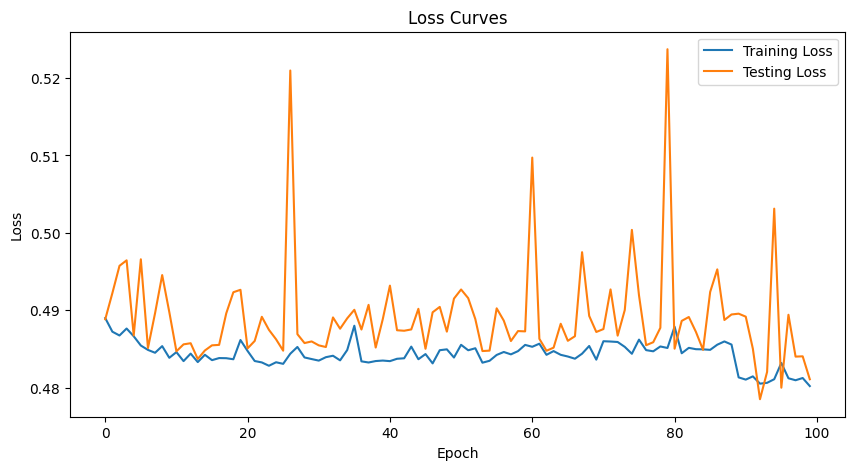

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.477 | Train Acc: 97.62% | Test NLL: 0.476 | Test Acc: 97.62%
Epoch 02 | Train NLL: 0.475 | Train Acc: 97.73% | Test NLL: 0.480 | Test Acc: 97.38%
Epoch 03 | Train NLL: 0.476 | Train Acc: 97.69% | Test NLL: 0.477 | Test Acc: 97.65%
Epoch 04 | Train NLL: 0.475 | Train Acc: 97.75% | Test NLL: 0.477 | Test Acc: 97.67%
Epoch 05 | Train NLL: 0.475 | Train Acc: 97.74% | Test NLL: 0.476 | Test Acc: 97.66%
Epoch 06 | Train NLL: 0.476 | Train Acc: 97.67% | Test NLL: 0.480 | Test Acc: 97.55%
Epoch 07 | Train NLL: 0.476 | Train Acc: 97.73% | Test NLL: 0.478 | Test Acc: 97.67%
Epoch 08 | Train NLL: 0.476 | Train Acc: 97.69% | Test NLL: 0.478 | Test Acc: 97.66%
Epoch 09 | Train NLL: 0.476 | Train Acc: 97.73% | Test NLL: 0.478 | Test Acc: 97.64%
Epoch 10 | Train NLL: 0.479 | Train Acc: 97.51% | Test NLL: 0.479 | Test Acc: 97.59%
Epoch 11 | Train NLL: 0.478 | Train Acc: 97.58% | Test NLL: 0.486

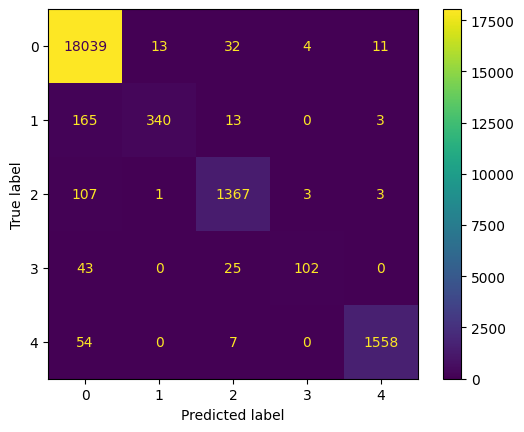

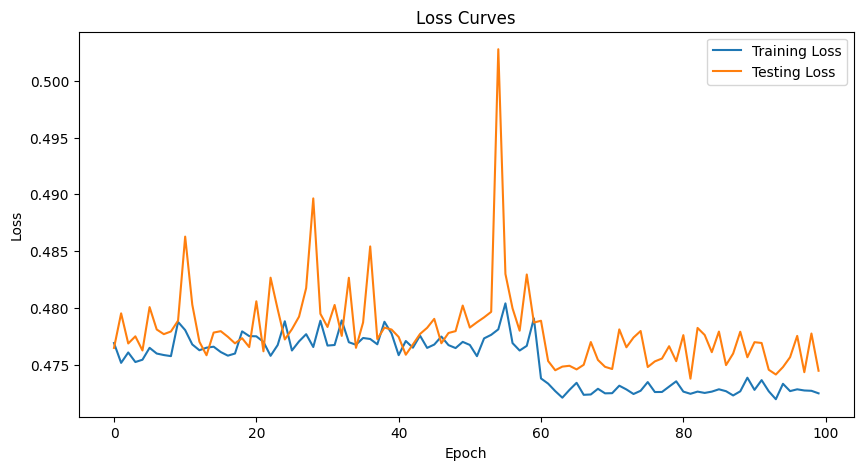

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.470 | Train Acc: 98.03% | Test NLL: 0.475 | Test Acc: 97.74%
Epoch 02 | Train NLL: 0.470 | Train Acc: 98.08% | Test NLL: 0.474 | Test Acc: 97.76%
Epoch 03 | Train NLL: 0.470 | Train Acc: 98.05% | Test NLL: 0.476 | Test Acc: 97.73%
Epoch 04 | Train NLL: 0.470 | Train Acc: 98.04% | Test NLL: 0.474 | Test Acc: 97.75%
Epoch 05 | Train NLL: 0.470 | Train Acc: 98.04% | Test NLL: 0.475 | Test Acc: 97.77%
Epoch 06 | Train NLL: 0.470 | Train Acc: 98.05% | Test NLL: 0.475 | Test Acc: 97.77%
Epoch 07 | Train NLL: 0.470 | Train Acc: 98.03% | Test NLL: 0.475 | Test Acc: 97.74%
Epoch 08 | Train NLL: 0.470 | Train Acc: 98.04% | Test NLL: 0.474 | Test Acc: 97.76%
Epoch 09 | Train NLL: 0.470 | Train Acc: 98.08% | Test NLL: 0.474 | Test Acc: 97.79%
Epoch 10 | Train NLL: 0.470 | Train Acc: 98.08% | Test NLL: 0.474 | Test Acc: 97.85%
Epoch 11 | Train NLL: 0.470 | Train Acc: 98.09% | Test NLL: 0.474

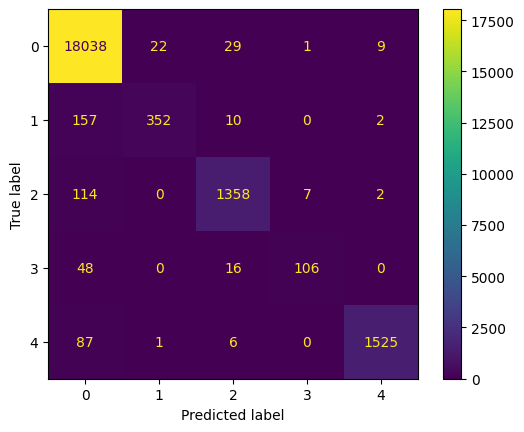

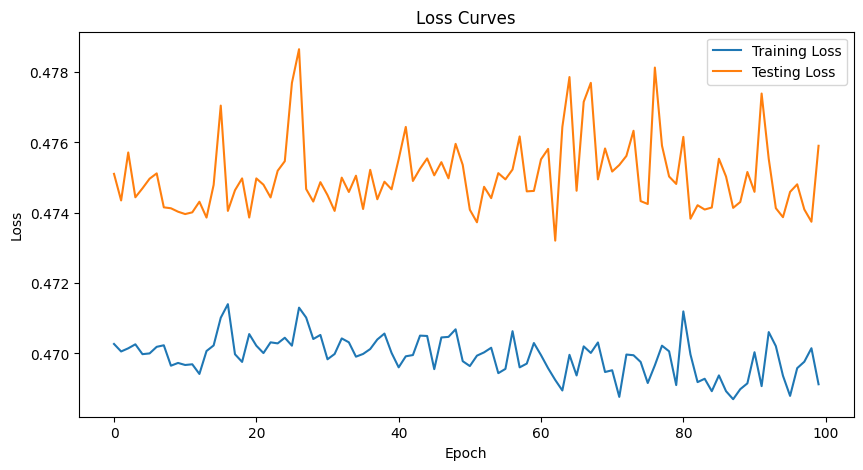

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.485 | Train Acc: 97.18% | Test NLL: 0.512 | Test Acc: 95.40%
Epoch 02 | Train NLL: 0.482 | Train Acc: 97.29% | Test NLL: 0.487 | Test Acc: 97.29%
Epoch 03 | Train NLL: 0.478 | Train Acc: 97.49% | Test NLL: 0.480 | Test Acc: 97.35%
Epoch 04 | Train NLL: 0.478 | Train Acc: 97.53% | Test NLL: 0.483 | Test Acc: 97.29%
Epoch 05 | Train NLL: 0.476 | Train Acc: 97.58% | Test NLL: 0.487 | Test Acc: 96.97%
Epoch 06 | Train NLL: 0.476 | Train Acc: 97.62% | Test NLL: 0.483 | Test Acc: 97.22%
Epoch 07 | Train NLL: 0.480 | Train Acc: 97.44% | Test NLL: 0.482 | Test Acc: 97.33%
Epoch 08 | Train NLL: 0.478 | Train Acc: 97.51% | Test NLL: 0.480 | Test Acc: 97.45%
Epoch 09 | Train NLL: 0.477 | Train Acc: 97.59% | Test NLL: 0.479 | Test Acc: 97.37%
Epoch 10 | Train NLL: 0.477 | Train Acc: 97.62% | Test NLL: 0.482 | Test Acc: 97.41%
Epoch 11 | Train NLL: 0.476 | Train Acc: 97.66% | Test NLL: 0.479 

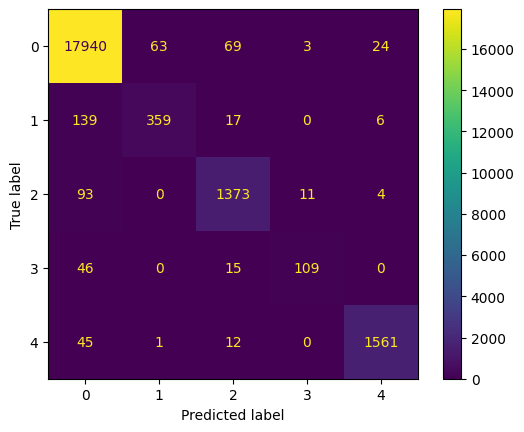

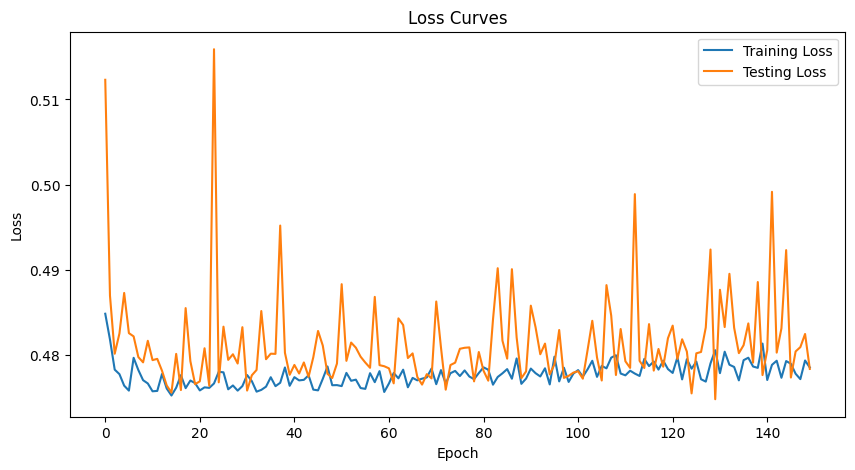

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.474 | Train Acc: 97.77% | Test NLL: 0.475 | Test Acc: 97.72%
Epoch 02 | Train NLL: 0.473 | Train Acc: 97.80% | Test NLL: 0.475 | Test Acc: 97.67%
Epoch 03 | Train NLL: 0.473 | Train Acc: 97.83% | Test NLL: 0.475 | Test Acc: 97.71%
Epoch 04 | Train NLL: 0.472 | Train Acc: 97.88% | Test NLL: 0.478 | Test Acc: 97.50%
Epoch 05 | Train NLL: 0.474 | Train Acc: 97.74% | Test NLL: 0.475 | Test Acc: 97.74%
Epoch 06 | Train NLL: 0.474 | Train Acc: 97.80% | Test NLL: 0.475 | Test Acc: 97.65%
Epoch 07 | Train NLL: 0.474 | Train Acc: 97.82% | Test NLL: 0.478 | Test Acc: 97.48%
Epoch 08 | Train NLL: 0.474 | Train Acc: 97.76% | Test NLL: 0.481 | Test Acc: 97.31%
Epoch 09 | Train NLL: 0.474 | Train Acc: 97.79% | Test NLL: 0.476 | Test Acc: 97.61%
Epoch 10 | Train NLL: 0.473 | Train Acc: 97.84% | Test NLL: 0.474 | Test Acc: 97.73%
Epoch 11 | Train NLL: 0.474 | Train Acc: 97.79% | Test NLL: 0.480

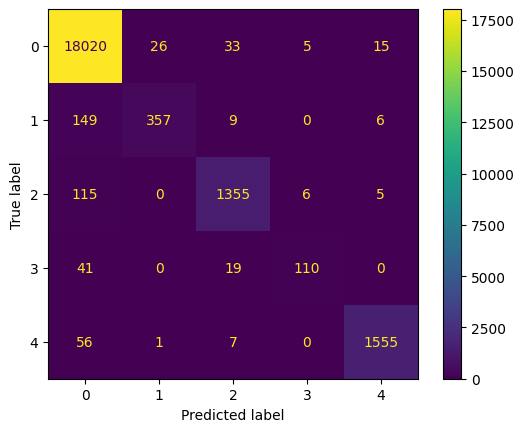

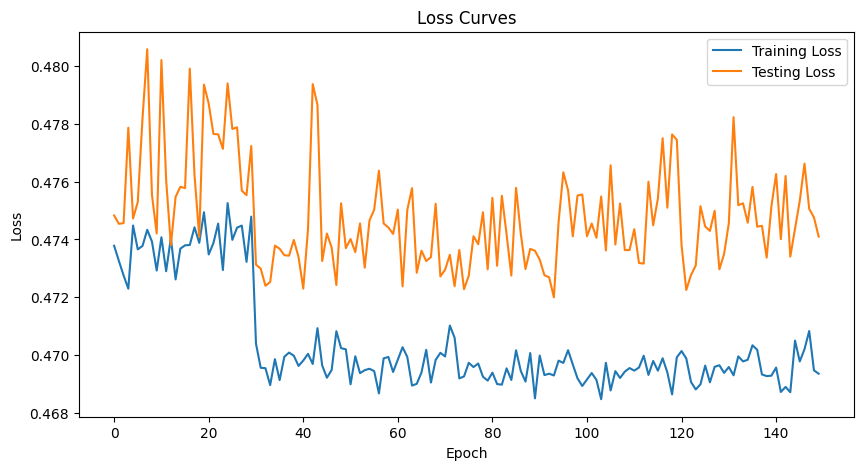

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.467 | Train Acc: 98.19% | Test NLL: 0.472 | Test Acc: 97.89%
Epoch 02 | Train NLL: 0.467 | Train Acc: 98.26% | Test NLL: 0.472 | Test Acc: 97.91%
Epoch 03 | Train NLL: 0.466 | Train Acc: 98.27% | Test NLL: 0.472 | Test Acc: 97.86%
Epoch 04 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.472 | Test Acc: 97.84%
Epoch 05 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.473 | Test Acc: 97.86%
Epoch 06 | Train NLL: 0.467 | Train Acc: 98.23% | Test NLL: 0.473 | Test Acc: 97.90%
Epoch 07 | Train NLL: 0.467 | Train Acc: 98.19% | Test NLL: 0.473 | Test Acc: 97.86%
Epoch 08 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.473 | Test Acc: 97.83%
Epoch 09 | Train NLL: 0.467 | Train Acc: 98.26% | Test NLL: 0.473 | Test Acc: 97.85%
Epoch 10 | Train NLL: 0.467 | Train Acc: 98.26% | Test NLL: 0.473 | Test Acc: 97.91%
Epoch 11 | Train NLL: 0.467 | Train Acc: 98.27% | Test NLL: 0.473

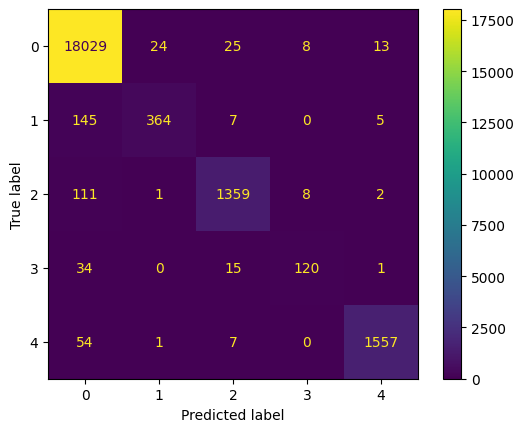

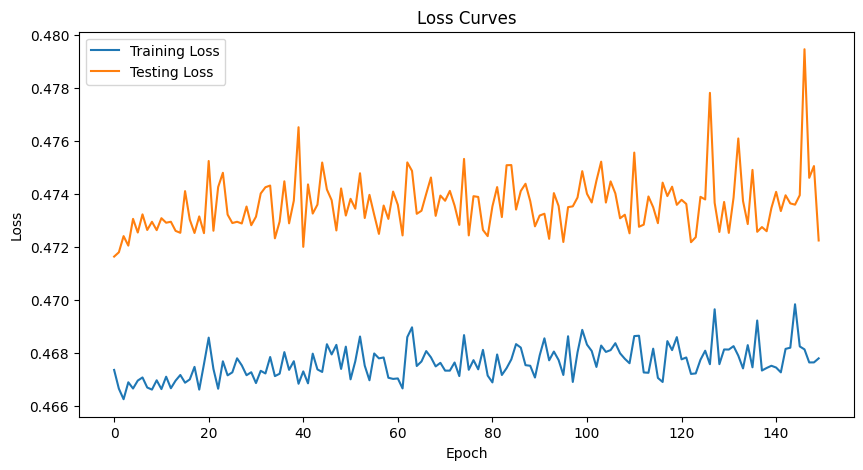

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.485 | Train Acc: 97.13% | Test NLL: 0.486 | Test Acc: 96.97%
Epoch 02 | Train NLL: 0.479 | Train Acc: 97.44% | Test NLL: 0.496 | Test Acc: 96.34%
Epoch 03 | Train NLL: 0.479 | Train Acc: 97.48% | Test NLL: 0.486 | Test Acc: 97.20%
Epoch 04 | Train NLL: 0.477 | Train Acc: 97.59% | Test NLL: 0.478 | Test Acc: 97.53%
Epoch 05 | Train NLL: 0.477 | Train Acc: 97.59% | Test NLL: 0.477 | Test Acc: 97.57%
Epoch 06 | Train NLL: 0.477 | Train Acc: 97.58% | Test NLL: 0.478 | Test Acc: 97.51%
Epoch 07 | Train NLL: 0.475 | Train Acc: 97.70% | Test NLL: 0.478 | Test Acc: 97.58%
Epoch 08 | Train NLL: 0.475 | Train Acc: 97.67% | Test NLL: 0.483 | Test Acc: 97.23%
Epoch 09 | Train NLL: 0.476 | Train Acc: 97.65% | Test NLL: 0.478 | Test Acc: 97.54%
Epoch 10 | Train NLL: 0.475 | Train Acc: 97.69% | Test NLL: 0.478 | Test Acc: 97.51%
Epoch 11 | Train NLL: 0.476 | Train Acc: 97.60% | Test NLL: 0.479 

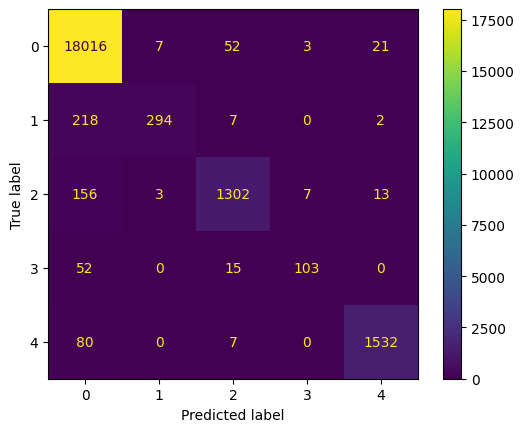

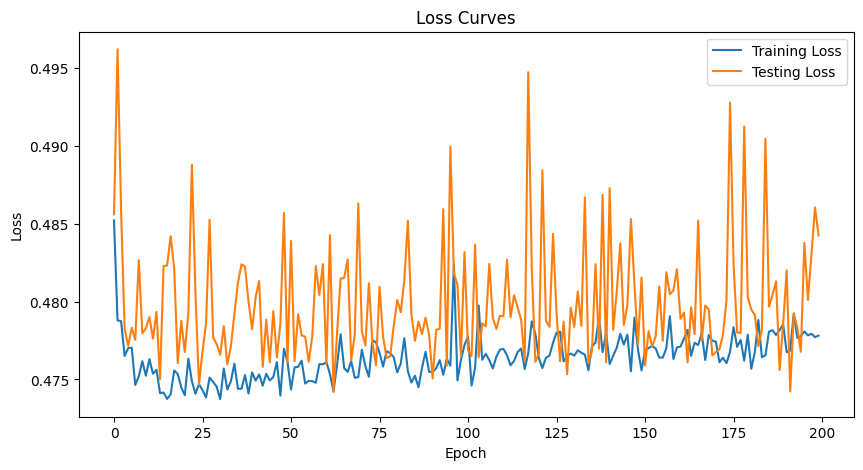

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.474 | Train Acc: 97.76% | Test NLL: 0.475 | Test Acc: 97.82%
Epoch 02 | Train NLL: 0.471 | Train Acc: 97.96% | Test NLL: 0.474 | Test Acc: 97.78%
Epoch 03 | Train NLL: 0.472 | Train Acc: 97.86% | Test NLL: 0.480 | Test Acc: 97.63%
Epoch 04 | Train NLL: 0.472 | Train Acc: 97.89% | Test NLL: 0.476 | Test Acc: 97.68%
Epoch 05 | Train NLL: 0.471 | Train Acc: 97.94% | Test NLL: 0.476 | Test Acc: 97.59%
Epoch 06 | Train NLL: 0.472 | Train Acc: 97.90% | Test NLL: 0.474 | Test Acc: 97.72%
Epoch 07 | Train NLL: 0.472 | Train Acc: 97.89% | Test NLL: 0.476 | Test Acc: 97.70%
Epoch 08 | Train NLL: 0.473 | Train Acc: 97.85% | Test NLL: 0.484 | Test Acc: 97.48%
Epoch 09 | Train NLL: 0.473 | Train Acc: 97.82% | Test NLL: 0.475 | Test Acc: 97.72%
Epoch 10 | Train NLL: 0.473 | Train Acc: 97.83% | Test NLL: 0.475 | Test Acc: 97.75%
Epoch 11 | Train NLL: 0.472 | Train Acc: 97.88% | Test NLL: 0.475

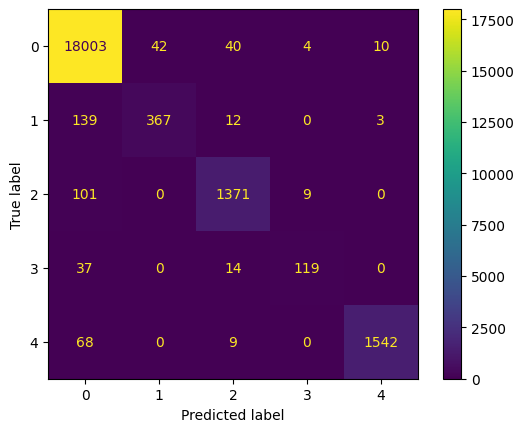

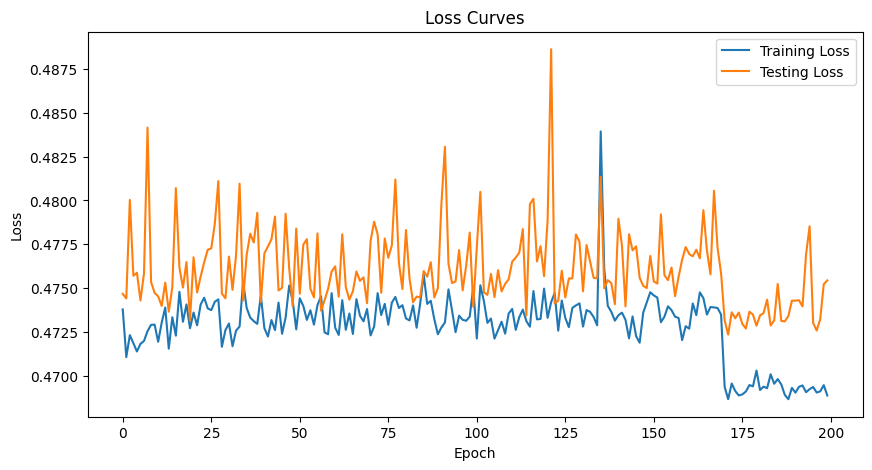

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.468 | Train Acc: 98.14% | Test NLL: 0.472 | Test Acc: 97.89%
Epoch 02 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.472 | Test Acc: 97.89%
Epoch 03 | Train NLL: 0.467 | Train Acc: 98.25% | Test NLL: 0.472 | Test Acc: 97.94%
Epoch 04 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.471 | Test Acc: 97.94%
Epoch 05 | Train NLL: 0.467 | Train Acc: 98.25% | Test NLL: 0.472 | Test Acc: 97.96%
Epoch 06 | Train NLL: 0.466 | Train Acc: 98.26% | Test NLL: 0.471 | Test Acc: 98.03%
Epoch 07 | Train NLL: 0.467 | Train Acc: 98.24% | Test NLL: 0.472 | Test Acc: 97.88%
Epoch 08 | Train NLL: 0.467 | Train Acc: 98.26% | Test NLL: 0.472 | Test Acc: 97.97%
Epoch 09 | Train NLL: 0.466 | Train Acc: 98.30% | Test NLL: 0.472 | Test Acc: 97.89%
Epoch 10 | Train NLL: 0.467 | Train Acc: 98.23% | Test NLL: 0.472 | Test Acc: 97.83%
Epoch 11 | Train NLL: 0.467 | Train Acc: 98.26% | Test NLL: 0.472

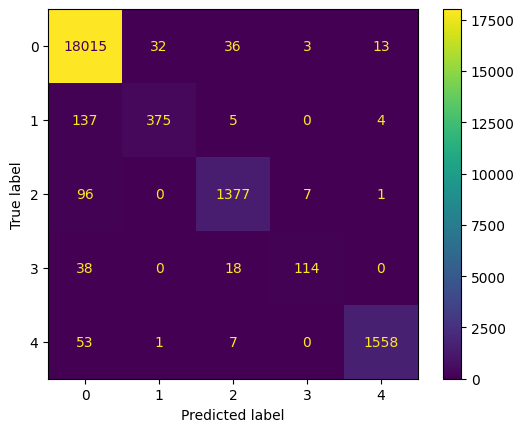

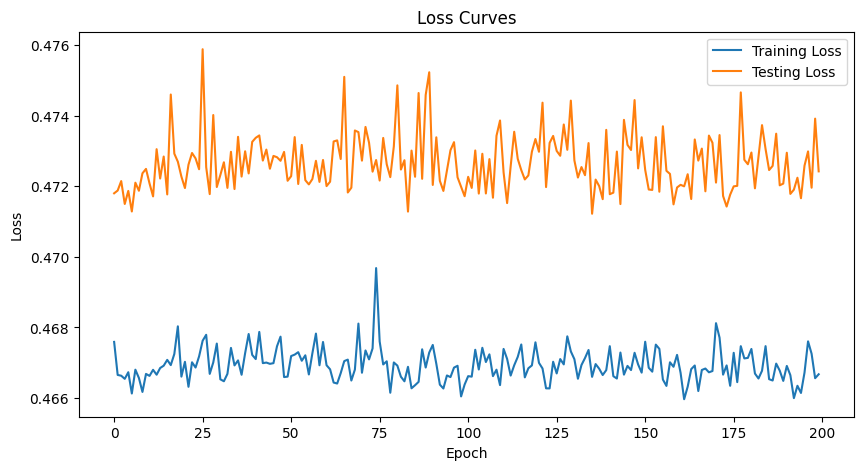

**************************************************



In [12]:
from scipy.sparse import csr_matrix

X_train = csr_matrix(X_mitbih_train.values)
T_train = y_mitbih_train.to_frame()
X_test =csr_matrix(X_mitbih_test.values)
T_test = y_mitbih_test.to_frame()

HIDDEN_UNITS = 64

num_classes = 5

pytorchNet = ComplexPyTorchMLP(X_train.shape[1], HIDDEN_UNITS, nn.Tanh(), num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_MLP(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE, num_classes=num_classes)

## CNN Implementation & Training & Testing

In [12]:
# Credits (adapted code from): https://github.com/okrasolar/pytorch-timeseries/blob/master/src/models/utils.py

class Conv1dSamePadding(nn.Conv1d):
    def forward(self, input):
        return conv1d_same_padding(input, self.weight, self.bias, self.stride, self.dilation, self.groups)

def conv1d_same_padding(input, weight, bias, stride, dilation, groups):
    kernel, dilation, stride = weight.size(2), dilation[0], stride[0]
    l_out = l_in = input.size(2)
    padding = ((l_out - 1) * stride) - l_in + (dilation * (kernel - 1)) + 1
    if padding % 2 != 0:
        input = F.pad(input, [0, 1])
    return F.conv1d(input=input, weight=weight, bias=bias, stride=stride, padding=padding // 2, dilation=dilation, groups=groups)

class ConvBlock(nn.Module):
    def __init__(self, in_channels: int, out_channels: int, kernel_size: int, stride: int) -> None:
        super().__init__()
        self.layers = nn.Sequential(
            Conv1dSamePadding(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride),
            nn.BatchNorm1d(num_features=out_channels),
            nn.ReLU(),
        )

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.layers(x)

In [13]:
# Credits (adapted code from): https://github.com/okrasolar/pytorch-timeseries/blob/master/src/models/resnet_baseline.py

class ResNetBaseline(nn.Module):
    
    def __init__(self, in_channels: int, mid_channels: int = 64,
                num_pred_classes: int = 1) -> None:
        super().__init__()

        # for easier saving and loading
        self.input_args = {
            'in_channels': in_channels,
            'num_pred_classes': num_pred_classes
        }

        self.layers = nn.Sequential(*[
            ResNetBlock(in_channels=in_channels, out_channels=mid_channels),
            ResNetBlock(in_channels=mid_channels, out_channels=mid_channels * 2),
            ResNetBlock(in_channels=mid_channels * 2, out_channels=mid_channels * 2),

        ])
        self.final = nn.Linear(mid_channels * 2, num_pred_classes)

    def forward(self, x: torch.Tensor) -> torch.Tensor:  # type: ignore
        x = self.layers(x)
        return self.final(x.mean(dim=-1))


class ResNetBlock(nn.Module):

    def __init__(self, in_channels: int, out_channels: int) -> None:
        super().__init__()

        channels = [in_channels, out_channels, out_channels, out_channels]
        kernel_sizes = [8, 5, 3]

        self.layers = nn.Sequential(*[
            ConvBlock(in_channels=channels[i], out_channels=channels[i + 1],
                    kernel_size=kernel_sizes[i], stride=1) for i in range(len(kernel_sizes))
        ])

        self.match_channels = False
        if in_channels != out_channels:
            self.match_channels = True
            self.residual = nn.Sequential(*[
                Conv1dSamePadding(in_channels=in_channels, out_channels=out_channels,
                                kernel_size=1, stride=1),
                nn.BatchNorm1d(num_features=out_channels)
            ])

    def forward(self, x: torch.Tensor) -> torch.Tensor:  # type: ignore

        if self.match_channels:
            return self.layers(x) + self.residual(x)
        return self.layers(x)


In [14]:
# Credits (adapted code from) : https://github.com/okrasolar/pytorch-timeseries/blob/master/src/models/inception.py

class InceptionBlock(nn.Module):
    def __init__(self, in_channels: int, out_channels: int, residual: bool, stride: int = 1, bottleneck_channels: int = 32, kernel_size: int = 41) -> None:
        assert kernel_size > 3, "Kernel size must be strictly greater than 3"
        super().__init__()
        self.use_bottleneck = bottleneck_channels > 0
        if self.use_bottleneck:
            self.bottleneck = Conv1dSamePadding(in_channels, bottleneck_channels, kernel_size=1, bias=False)
        kernel_size_s = [kernel_size // (2 ** i) for i in range(3)]
        start_channels = bottleneck_channels if self.use_bottleneck else in_channels
        channels = [start_channels] + [out_channels] * 3
        self.conv_layers = nn.Sequential(*[
            Conv1dSamePadding(in_channels=channels[i], out_channels=channels[i + 1], kernel_size=kernel_size_s[i], stride=stride, bias=False)
            for i in range(len(kernel_size_s))
        ])
        self.batchnorm = nn.BatchNorm1d(num_features=channels[-1])
        self.relu = nn.ReLU()
        self.use_residual = residual
        if residual:
            self.residual = nn.Sequential(*[
                Conv1dSamePadding(in_channels=in_channels, out_channels=out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm1d(out_channels),
                nn.ReLU()
            ])

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        org_x = x
        if self.use_bottleneck:
            x = self.bottleneck(x)
        x = self.conv_layers(x)
        if self.use_residual:
            x = x + self.residual(org_x)
        return x

class InceptionModel(nn.Module):
    def __init__(self, num_blocks: int, in_channels: int, out_channels: Union[List[int], int], bottleneck_channels: Union[List[int], int], kernel_sizes: Union[List[int], int], use_residuals: Union[List[bool], bool, str] = 'default', num_pred_classes: int = 1) -> None:
        super().__init__()
        self.input_args = {'num_blocks': num_blocks, 'in_channels': in_channels, 'out_channels': out_channels, 'bottleneck_channels': bottleneck_channels, 'kernel_sizes': kernel_sizes, 'use_residuals': use_residuals, 'num_pred_classes': num_pred_classes}
        channels = [in_channels] + cast(List[int], self._expand_to_blocks(out_channels, num_blocks))
        bottleneck_channels = cast(List[int], self._expand_to_blocks(bottleneck_channels, num_blocks))
        kernel_sizes = cast(List[int], self._expand_to_blocks(kernel_sizes, num_blocks))
        if use_residuals == 'default':
            use_residuals = [True if i % 3 == 2 else False for i in range(num_blocks)]
        use_residuals = cast(List[bool], self._expand_to_blocks(cast(Union[bool, List[bool]], use_residuals), num_blocks))
        self.blocks = nn.Sequential(*[
            InceptionBlock(in_channels=channels[i], out_channels=channels[i + 1], residual=use_residuals[i], bottleneck_channels=bottleneck_channels[i], kernel_size=kernel_sizes[i]) for i in range(num_blocks)
        ])
        self.linear = nn.Linear(in_features=channels[-1], out_features=num_pred_classes)

    @staticmethod
    def _expand_to_blocks(value: Union[int, bool, List[int], List[bool]], num_blocks: int) -> Union[List[int], List[bool]]:
        if isinstance(value, list):
            assert len(value) == num_blocks, f'Length of inputs lists must be the same as num blocks, expected length {num_blocks}, got {len(value)}'
        else:
            value = [value] * num_blocks
        return value

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.blocks(x).mean(dim=-1)
        return self.linear(x)


In [19]:
def train_test_PyTorch_CNN(model, loss_fn, optimizer, X_train, T_train, X_test, T_test,
                        train_losses, test_losses, num_classes, EPOCHS_NO=[150], BATCH_SIZE=[100]):
    T_train = T_train.values.ravel()
    T_test = T_test.values.ravel()

    X_train_tensor = torch.tensor(X_train.toarray(), dtype=torch.float32).unsqueeze(1).to(device)
    T_train_tensor = torch.tensor(T_train, dtype=torch.long).to(device)
    X_test_tensor = torch.tensor(X_test.toarray(), dtype=torch.float32).unsqueeze(1).to(device)
    T_test_tensor = torch.tensor(T_test, dtype=torch.long).to(device)
    
    train_dataset = TensorDataset(X_train_tensor, T_train_tensor)
    test_dataset = TensorDataset(X_test_tensor, T_test_tensor)
    
    lr_schedule_milestones = [10e2, 15e2, 25e2]
    lr_factor = 0.1
    lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=lr_schedule_milestones, gamma=lr_factor)
    
    for epoch_elem in EPOCHS_NO:
        for batch_elem in BATCH_SIZE:
            print(f"EPOCH : {epoch_elem} & BATCH SIZE : {batch_elem}\n")
            
            train_loader = DataLoader(train_dataset, batch_size=batch_elem, shuffle=True)
            test_loader = DataLoader(test_dataset, batch_size=batch_elem, shuffle=False)
            
            for epoch in range(epoch_elem):
                model.train()
                epoch_train_loss = 0
                correct_train_predictions = 0
                total_train_samples = 0
                
                for X_batch, T_batch in train_loader:
                    optimizer.zero_grad()
                    outputs = model(X_batch)
                    loss = loss_fn(outputs, T_batch)
                    loss.backward()
                    optimizer.step()
                    
                    epoch_train_loss += loss.item()
                    
                    preds = torch.argmax(outputs, dim=1)
                    correct_train_predictions += (preds == T_batch).sum().item()
                    total_train_samples += T_batch.size(0)
                
                train_accuracy = correct_train_predictions / total_train_samples
                train_losses.append(epoch_train_loss / len(train_loader))
                
                model.eval()
                with torch.no_grad():
                    test_loss = 0
                    correct_test_predictions = 0
                    total_test_samples = 0
                    all_preds = []
                    all_labels = []

                    for X_batch, T_batch in test_loader:
                        outputs = model(X_batch)
                        loss = loss_fn(outputs, T_batch)
                        test_loss += loss.item()
                        
                        preds = torch.argmax(outputs, dim=1)
                        correct_test_predictions += (preds == T_batch).sum().item()
                        total_test_samples += T_batch.size(0)
                        
                        all_preds.append(preds.cpu().numpy())
                        all_labels.append(T_batch.cpu().numpy())
                    
                    test_accuracy = correct_test_predictions / total_test_samples
                    test_losses.append(test_loss / len(test_loader))
                    
                    all_preds = np.concatenate(all_preds)
                    all_labels = np.concatenate(all_labels)
                    
                    print(f'Epoch {epoch + 1:02d} '
                        f'| Train NLL: {train_losses[-1]:.3f} '
                        f'| Train Acc: {train_accuracy * 100:.2f}% '
                        f'| Test NLL: {test_losses[-1]:.3f} '
                          f'| Test Acc: {test_accuracy * 100:.2f}%')

                lr_scheduler.step()
            
            print(classification_report(all_labels, all_preds))
            
            cm = confusion_matrix(all_labels, all_preds, labels=np.arange(num_classes))
            disp = ConfusionMatrixDisplay(confusion_matrix=cm)
            disp.plot()
            plt.show()
            
            plot_loss_curves(train_losses, test_losses)

            train_losses.clear()
            test_losses.clear()

            print("*" * 50 + "\n")

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(41,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(10,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
  )
  (linear): Linear(in_features=2, out_features=2, bias=True)
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.584 | Train Acc: 72.28% | Test NLL: 0.587 | Test Acc: 71.87%
Epoch 02 | Train NLL: 0.57

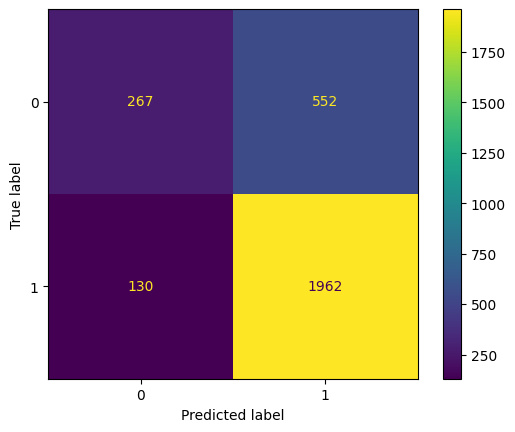

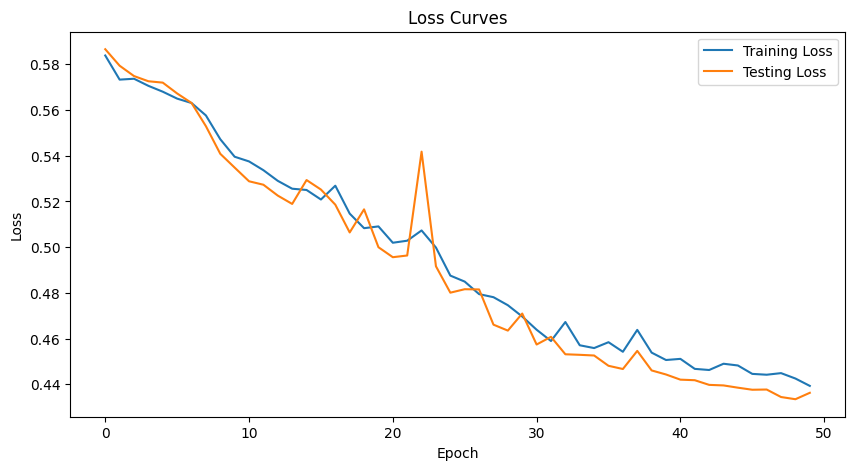

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.446 | Train Acc: 77.03% | Test NLL: 0.432 | Test Acc: 77.88%
Epoch 02 | Train NLL: 0.446 | Train Acc: 76.99% | Test NLL: 0.431 | Test Acc: 78.01%
Epoch 03 | Train NLL: 0.444 | Train Acc: 77.18% | Test NLL: 0.432 | Test Acc: 78.84%
Epoch 04 | Train NLL: 0.444 | Train Acc: 77.16% | Test NLL: 0.435 | Test Acc: 79.25%
Epoch 05 | Train NLL: 0.439 | Train Acc: 77.50% | Test NLL: 0.432 | Test Acc: 78.98%
Epoch 06 | Train NLL: 0.439 | Train Acc: 77.72% | Test NLL: 0.429 | Test Acc: 78.67%
Epoch 07 | Train NLL: 0.438 | Train Acc: 77.82% | Test NLL: 0.431 | Test Acc: 77.43%
Epoch 08 | Train NLL: 0.437 | Train Acc: 78.08% | Test NLL: 0.429 | Test Acc: 78.05%
Epoch 09 | Train NLL: 0.435 | Train Acc: 78.15% | Test NLL: 0.427 | Test Acc: 78.94%
Epoch 10 | Train NLL: 0.435 | Train Acc: 78.21% | Test NLL: 0.427 | Test Acc: 79.11%
Epoch 11 | Train NLL: 0.435 | Train Acc: 78.05% | Test NLL: 0.427 

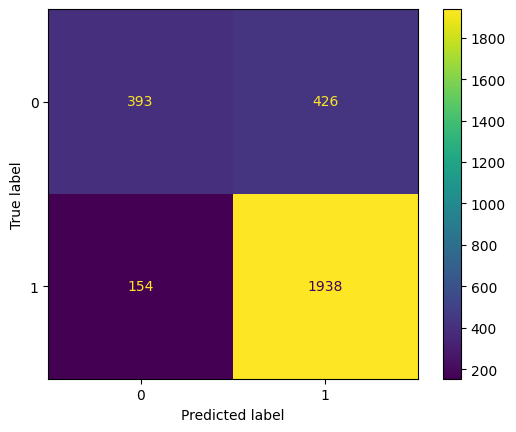

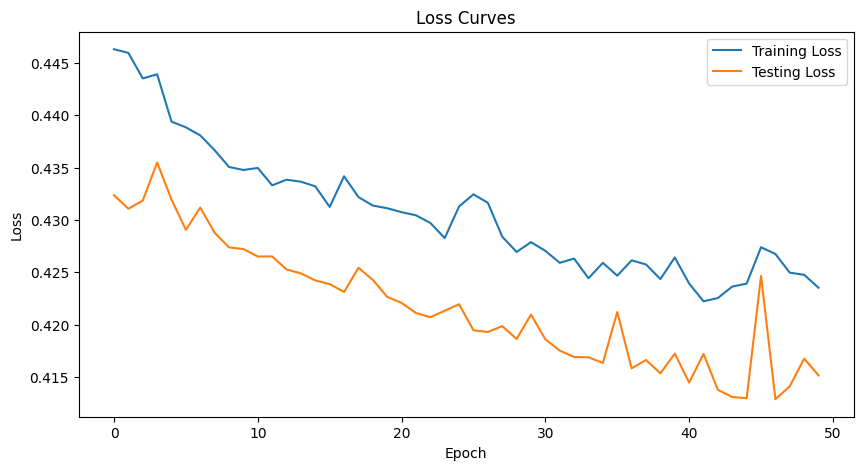

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.421 | Train Acc: 79.43% | Test NLL: 0.408 | Test Acc: 80.49%
Epoch 02 | Train NLL: 0.421 | Train Acc: 79.14% | Test NLL: 0.408 | Test Acc: 80.52%
Epoch 03 | Train NLL: 0.421 | Train Acc: 79.43% | Test NLL: 0.407 | Test Acc: 80.80%
Epoch 04 | Train NLL: 0.420 | Train Acc: 79.40% | Test NLL: 0.407 | Test Acc: 80.76%
Epoch 05 | Train NLL: 0.420 | Train Acc: 79.55% | Test NLL: 0.409 | Test Acc: 80.08%
Epoch 06 | Train NLL: 0.422 | Train Acc: 79.20% | Test NLL: 0.407 | Test Acc: 80.63%
Epoch 07 | Train NLL: 0.421 | Train Acc: 79.59% | Test NLL: 0.407 | Test Acc: 80.90%
Epoch 08 | Train NLL: 0.420 | Train Acc: 79.49% | Test NLL: 0.407 | Test Acc: 80.66%
Epoch 09 | Train NLL: 0.420 | Train Acc: 79.40% | Test NLL: 0.406 | Test Acc: 80.69%
Epoch 10 | Train NLL: 0.419 | Train Acc: 79.51% | Test NLL: 0.406 | Test Acc: 80.63%
Epoch 11 | Train NLL: 0.419 | Train Acc: 79.55% | Test NLL: 0.406 

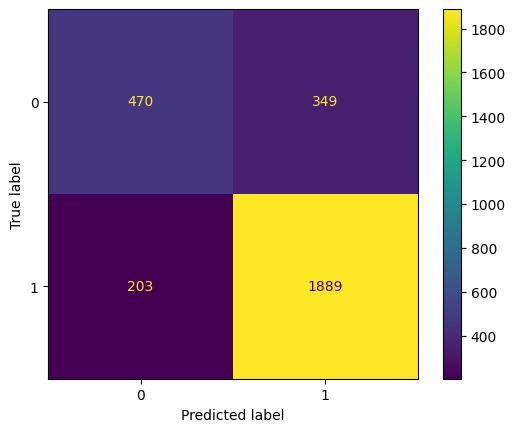

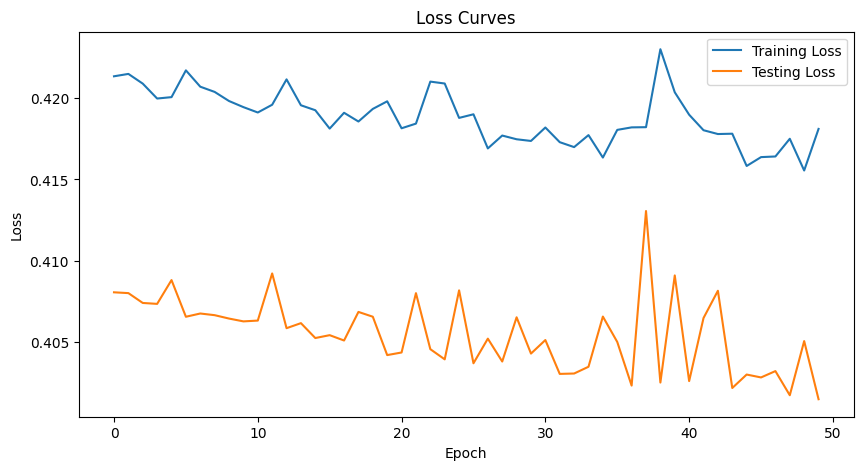

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.416 | Train Acc: 79.62% | Test NLL: 0.407 | Test Acc: 80.97%
Epoch 02 | Train NLL: 0.418 | Train Acc: 79.80% | Test NLL: 0.408 | Test Acc: 81.31%
Epoch 03 | Train NLL: 0.418 | Train Acc: 79.72% | Test NLL: 0.410 | Test Acc: 80.45%
Epoch 04 | Train NLL: 0.424 | Train Acc: 79.24% | Test NLL: 0.412 | Test Acc: 80.35%
Epoch 05 | Train NLL: 0.417 | Train Acc: 79.56% | Test NLL: 0.406 | Test Acc: 81.21%
Epoch 06 | Train NLL: 0.415 | Train Acc: 79.89% | Test NLL: 0.409 | Test Acc: 80.42%
Epoch 07 | Train NLL: 0.419 | Train Acc: 79.75% | Test NLL: 0.406 | Test Acc: 81.28%
Epoch 08 | Train NLL: 0.418 | Train Acc: 79.80% | Test NLL: 0.404 | Test Acc: 81.21%
Epoch 09 | Train NLL: 0.425 | Train Acc: 79.18% | Test NLL: 0.409 | Test Acc: 81.24%
Epoch 10 | Train NLL: 0.414 | Train Acc: 79.98% | Test NLL: 0.411 | Test Acc: 80.14%
Epoch 11 | Train NLL: 0.424 | Train Acc: 78.94% | Test NLL: 0.415 

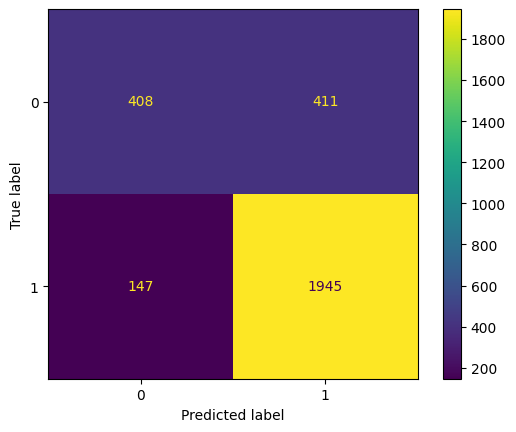

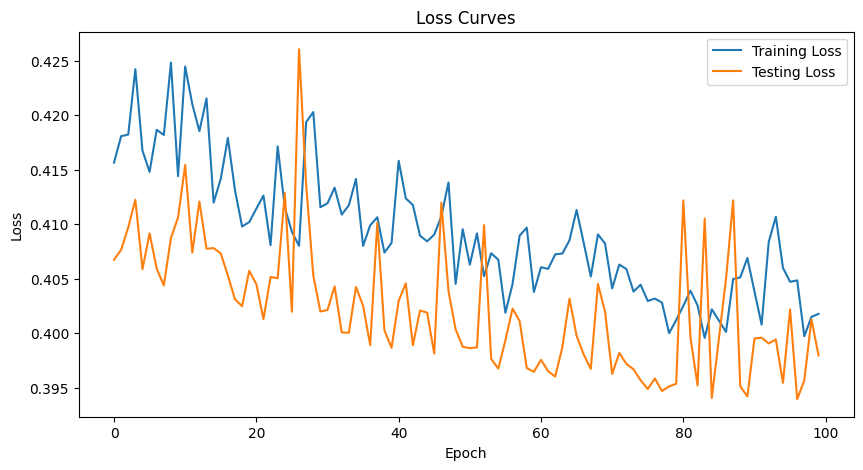

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.402 | Train Acc: 80.50% | Test NLL: 0.396 | Test Acc: 80.49%
Epoch 02 | Train NLL: 0.403 | Train Acc: 80.54% | Test NLL: 0.397 | Test Acc: 80.49%
Epoch 03 | Train NLL: 0.400 | Train Acc: 80.44% | Test NLL: 0.394 | Test Acc: 80.42%
Epoch 04 | Train NLL: 0.399 | Train Acc: 80.66% | Test NLL: 0.395 | Test Acc: 80.56%
Epoch 05 | Train NLL: 0.401 | Train Acc: 80.53% | Test NLL: 0.398 | Test Acc: 80.76%
Epoch 06 | Train NLL: 0.402 | Train Acc: 80.50% | Test NLL: 0.395 | Test Acc: 80.97%
Epoch 07 | Train NLL: 0.401 | Train Acc: 80.47% | Test NLL: 0.394 | Test Acc: 80.69%
Epoch 08 | Train NLL: 0.402 | Train Acc: 80.60% | Test NLL: 0.406 | Test Acc: 79.97%
Epoch 09 | Train NLL: 0.400 | Train Acc: 80.41% | Test NLL: 0.394 | Test Acc: 80.83%
Epoch 10 | Train NLL: 0.400 | Train Acc: 80.61% | Test NLL: 0.394 | Test Acc: 80.59%
Epoch 11 | Train NLL: 0.399 | Train Acc: 80.64% | Test NLL: 0.394

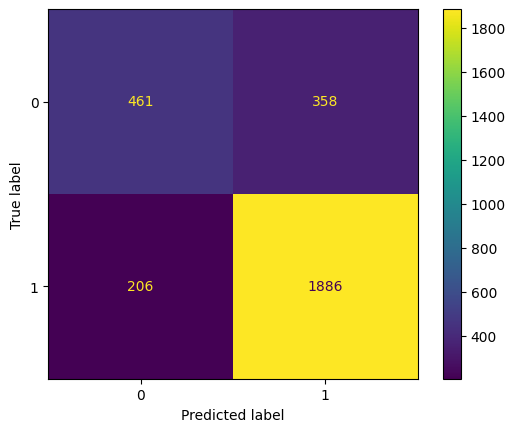

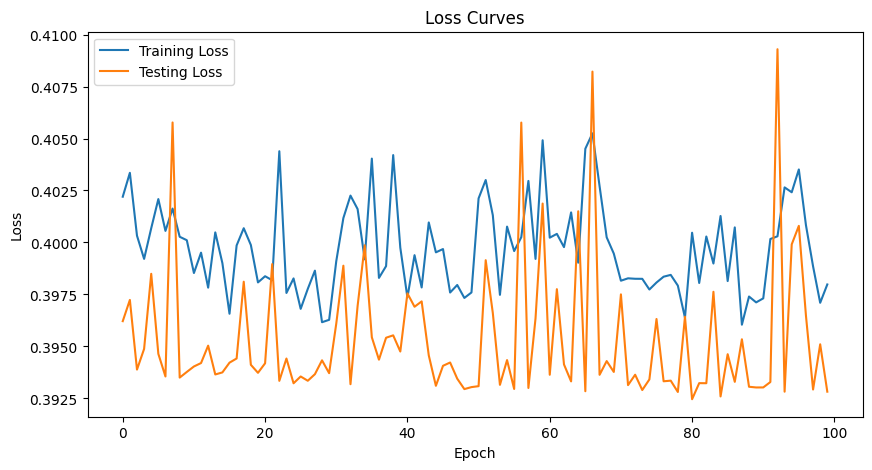

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.396 | Train Acc: 80.98% | Test NLL: 0.387 | Test Acc: 80.80%
Epoch 02 | Train NLL: 0.396 | Train Acc: 80.91% | Test NLL: 0.388 | Test Acc: 80.73%
Epoch 03 | Train NLL: 0.396 | Train Acc: 81.04% | Test NLL: 0.387 | Test Acc: 80.66%
Epoch 04 | Train NLL: 0.396 | Train Acc: 80.78% | Test NLL: 0.388 | Test Acc: 80.76%
Epoch 05 | Train NLL: 0.397 | Train Acc: 80.41% | Test NLL: 0.392 | Test Acc: 80.66%
Epoch 06 | Train NLL: 0.396 | Train Acc: 80.92% | Test NLL: 0.390 | Test Acc: 80.52%
Epoch 07 | Train NLL: 0.396 | Train Acc: 80.45% | Test NLL: 0.388 | Test Acc: 80.93%
Epoch 08 | Train NLL: 0.395 | Train Acc: 80.89% | Test NLL: 0.387 | Test Acc: 80.80%
Epoch 09 | Train NLL: 0.396 | Train Acc: 81.00% | Test NLL: 0.387 | Test Acc: 80.59%
Epoch 10 | Train NLL: 0.395 | Train Acc: 80.88% | Test NLL: 0.387 | Test Acc: 80.73%
Epoch 11 | Train NLL: 0.395 | Train Acc: 80.92% | Test NLL: 0.387

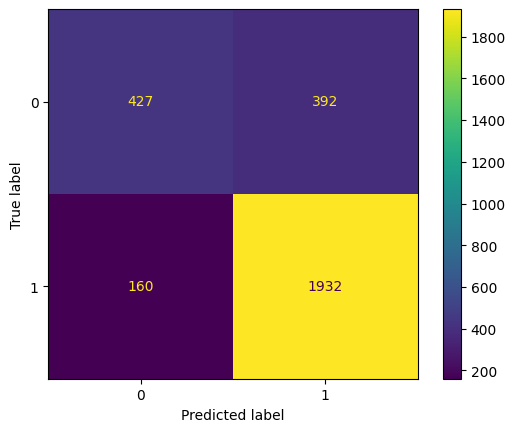

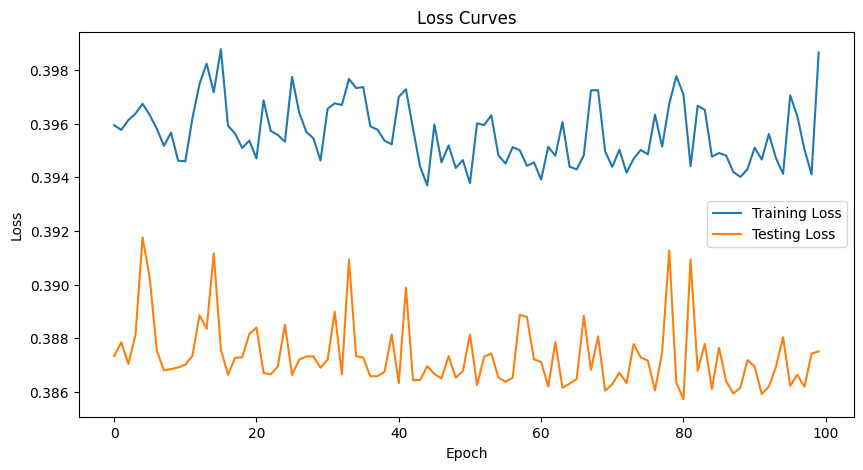

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.399 | Train Acc: 81.06% | Test NLL: 0.392 | Test Acc: 80.90%
Epoch 02 | Train NLL: 0.398 | Train Acc: 80.98% | Test NLL: 0.393 | Test Acc: 80.73%
Epoch 03 | Train NLL: 0.403 | Train Acc: 80.72% | Test NLL: 0.392 | Test Acc: 81.04%
Epoch 04 | Train NLL: 0.402 | Train Acc: 80.82% | Test NLL: 0.554 | Test Acc: 71.90%
Epoch 05 | Train NLL: 0.439 | Train Acc: 78.47% | Test NLL: 0.414 | Test Acc: 80.18%
Epoch 06 | Train NLL: 0.410 | Train Acc: 80.56% | Test NLL: 0.394 | Test Acc: 80.97%
Epoch 07 | Train NLL: 0.403 | Train Acc: 80.65% | Test NLL: 0.394 | Test Acc: 80.80%
Epoch 08 | Train NLL: 0.403 | Train Acc: 80.97% | Test NLL: 0.406 | Test Acc: 79.80%
Epoch 09 | Train NLL: 0.401 | Train Acc: 80.56% | Test NLL: 0.394 | Test Acc: 80.80%
Epoch 10 | Train NLL: 0.401 | Train Acc: 80.64% | Test NLL: 0.393 | Test Acc: 80.83%
Epoch 11 | Train NLL: 0.397 | Train Acc: 80.88% | Test NLL: 0.392 

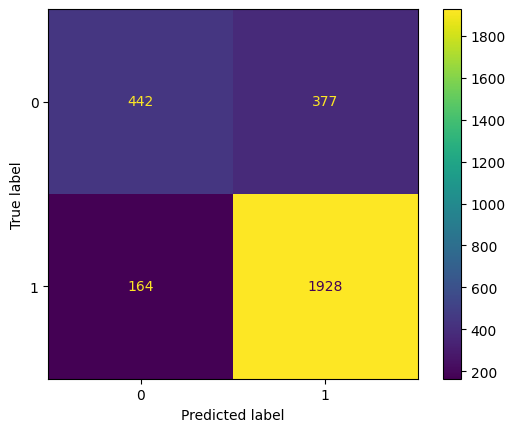

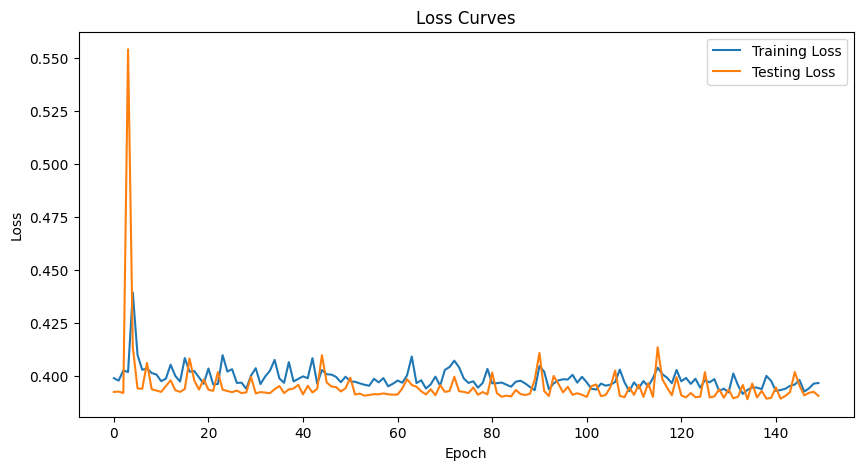

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.392 | Train Acc: 81.63% | Test NLL: 0.389 | Test Acc: 81.14%
Epoch 02 | Train NLL: 0.392 | Train Acc: 81.44% | Test NLL: 0.389 | Test Acc: 81.17%
Epoch 03 | Train NLL: 0.392 | Train Acc: 81.45% | Test NLL: 0.389 | Test Acc: 81.24%
Epoch 04 | Train NLL: 0.394 | Train Acc: 81.11% | Test NLL: 0.389 | Test Acc: 81.21%
Epoch 05 | Train NLL: 0.392 | Train Acc: 81.51% | Test NLL: 0.389 | Test Acc: 81.42%
Epoch 06 | Train NLL: 0.391 | Train Acc: 81.59% | Test NLL: 0.389 | Test Acc: 81.21%
Epoch 07 | Train NLL: 0.391 | Train Acc: 81.54% | Test NLL: 0.390 | Test Acc: 80.93%
Epoch 08 | Train NLL: 0.394 | Train Acc: 81.30% | Test NLL: 0.393 | Test Acc: 81.48%
Epoch 09 | Train NLL: 0.392 | Train Acc: 81.39% | Test NLL: 0.389 | Test Acc: 80.93%
Epoch 10 | Train NLL: 0.395 | Train Acc: 81.14% | Test NLL: 0.388 | Test Acc: 81.14%
Epoch 11 | Train NLL: 0.391 | Train Acc: 81.36% | Test NLL: 0.389

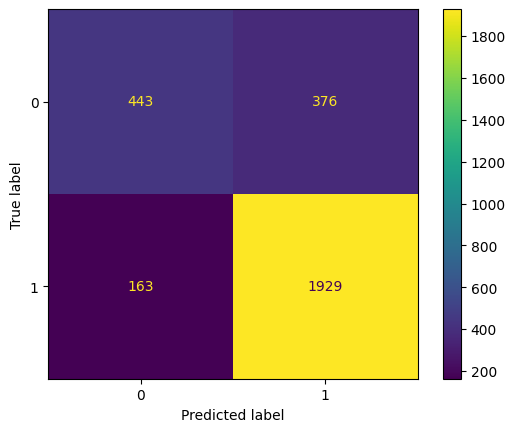

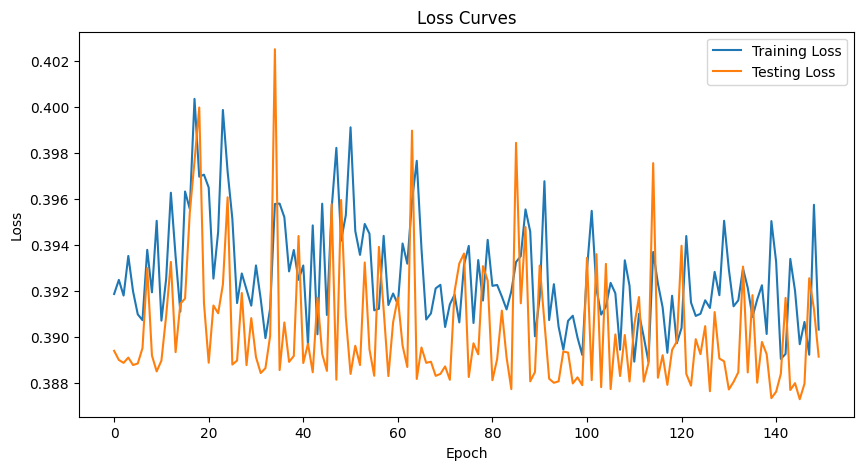

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.390 | Train Acc: 81.58% | Test NLL: 0.381 | Test Acc: 81.24%
Epoch 02 | Train NLL: 0.391 | Train Acc: 82.05% | Test NLL: 0.384 | Test Acc: 80.73%
Epoch 03 | Train NLL: 0.394 | Train Acc: 81.01% | Test NLL: 0.387 | Test Acc: 81.38%
Epoch 04 | Train NLL: 0.393 | Train Acc: 81.50% | Test NLL: 0.381 | Test Acc: 81.66%
Epoch 05 | Train NLL: 0.390 | Train Acc: 81.87% | Test NLL: 0.381 | Test Acc: 81.31%
Epoch 06 | Train NLL: 0.390 | Train Acc: 81.74% | Test NLL: 0.381 | Test Acc: 81.28%
Epoch 07 | Train NLL: 0.389 | Train Acc: 81.79% | Test NLL: 0.381 | Test Acc: 81.24%
Epoch 08 | Train NLL: 0.389 | Train Acc: 82.02% | Test NLL: 0.382 | Test Acc: 81.14%
Epoch 09 | Train NLL: 0.389 | Train Acc: 81.68% | Test NLL: 0.382 | Test Acc: 81.52%
Epoch 10 | Train NLL: 0.390 | Train Acc: 81.93% | Test NLL: 0.386 | Test Acc: 80.38%
Epoch 11 | Train NLL: 0.391 | Train Acc: 81.48% | Test NLL: 0.381

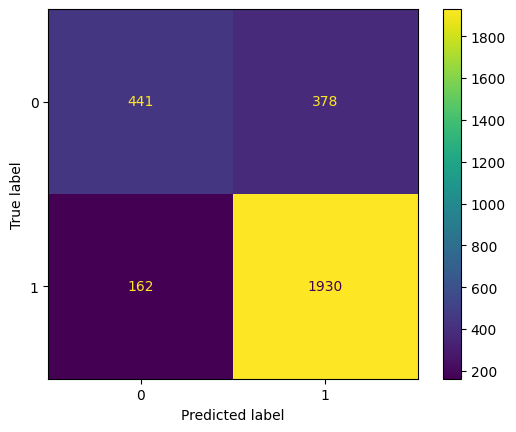

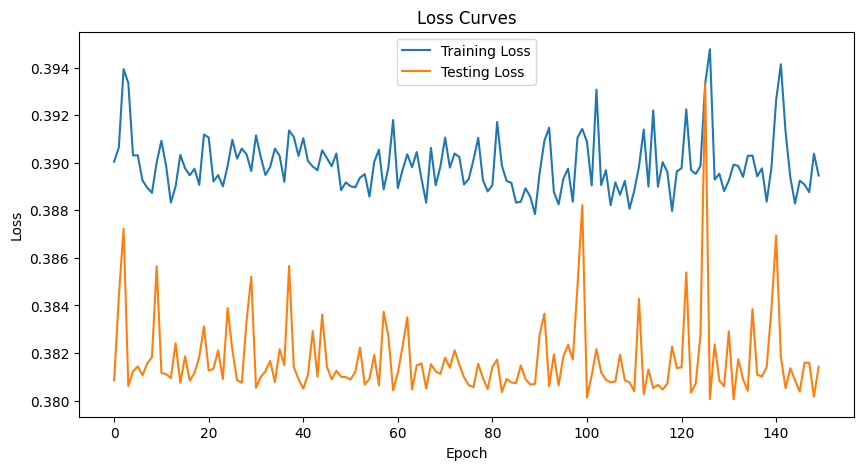

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.395 | Train Acc: 81.32% | Test NLL: 0.388 | Test Acc: 81.21%
Epoch 02 | Train NLL: 0.398 | Train Acc: 81.45% | Test NLL: 0.392 | Test Acc: 80.90%
Epoch 03 | Train NLL: 0.403 | Train Acc: 80.73% | Test NLL: 0.388 | Test Acc: 81.11%
Epoch 04 | Train NLL: 0.407 | Train Acc: 80.38% | Test NLL: 0.403 | Test Acc: 81.04%
Epoch 05 | Train NLL: 0.401 | Train Acc: 81.28% | Test NLL: 0.398 | Test Acc: 80.73%
Epoch 06 | Train NLL: 0.395 | Train Acc: 81.43% | Test NLL: 0.394 | Test Acc: 81.21%
Epoch 07 | Train NLL: 0.399 | Train Acc: 81.31% | Test NLL: 0.398 | Test Acc: 80.63%
Epoch 08 | Train NLL: 0.406 | Train Acc: 80.60% | Test NLL: 0.389 | Test Acc: 81.52%
Epoch 09 | Train NLL: 0.397 | Train Acc: 81.53% | Test NLL: 0.389 | Test Acc: 81.45%
Epoch 10 | Train NLL: 0.395 | Train Acc: 81.53% | Test NLL: 0.389 | Test Acc: 81.59%
Epoch 11 | Train NLL: 0.394 | Train Acc: 81.25% | Test NLL: 0.387 

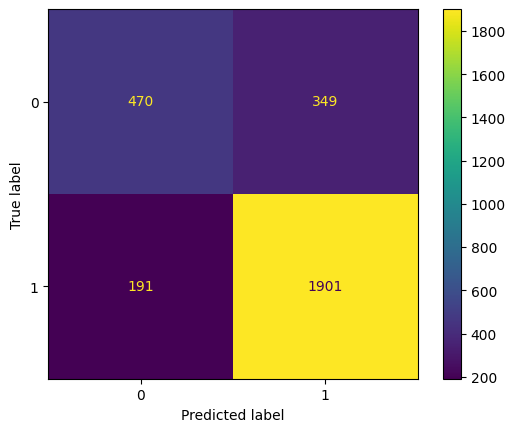

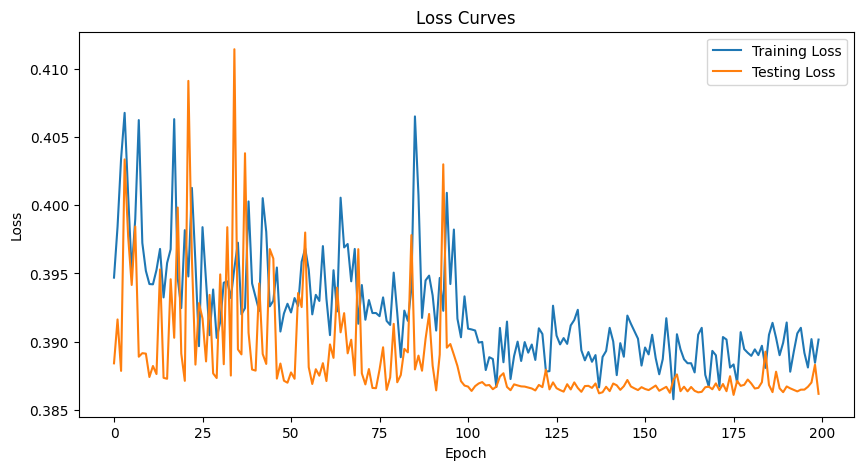

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.388 | Train Acc: 81.89% | Test NLL: 0.387 | Test Acc: 81.45%
Epoch 02 | Train NLL: 0.389 | Train Acc: 81.86% | Test NLL: 0.387 | Test Acc: 81.11%
Epoch 03 | Train NLL: 0.388 | Train Acc: 81.99% | Test NLL: 0.387 | Test Acc: 81.17%
Epoch 04 | Train NLL: 0.388 | Train Acc: 81.88% | Test NLL: 0.387 | Test Acc: 81.35%
Epoch 05 | Train NLL: 0.388 | Train Acc: 81.85% | Test NLL: 0.387 | Test Acc: 81.21%
Epoch 06 | Train NLL: 0.387 | Train Acc: 81.91% | Test NLL: 0.387 | Test Acc: 81.52%
Epoch 07 | Train NLL: 0.388 | Train Acc: 82.03% | Test NLL: 0.387 | Test Acc: 81.17%
Epoch 08 | Train NLL: 0.388 | Train Acc: 82.01% | Test NLL: 0.387 | Test Acc: 81.35%
Epoch 09 | Train NLL: 0.389 | Train Acc: 81.99% | Test NLL: 0.386 | Test Acc: 81.28%
Epoch 10 | Train NLL: 0.389 | Train Acc: 81.83% | Test NLL: 0.387 | Test Acc: 81.35%
Epoch 11 | Train NLL: 0.390 | Train Acc: 81.90% | Test NLL: 0.387

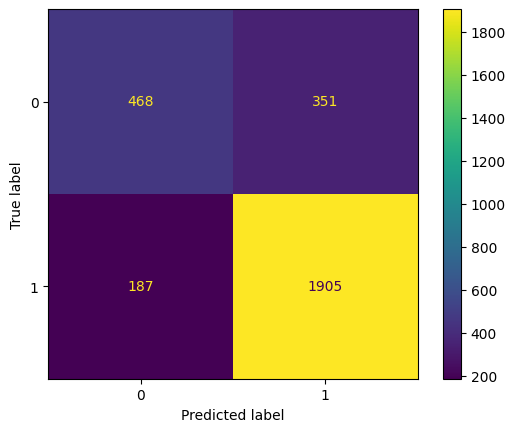

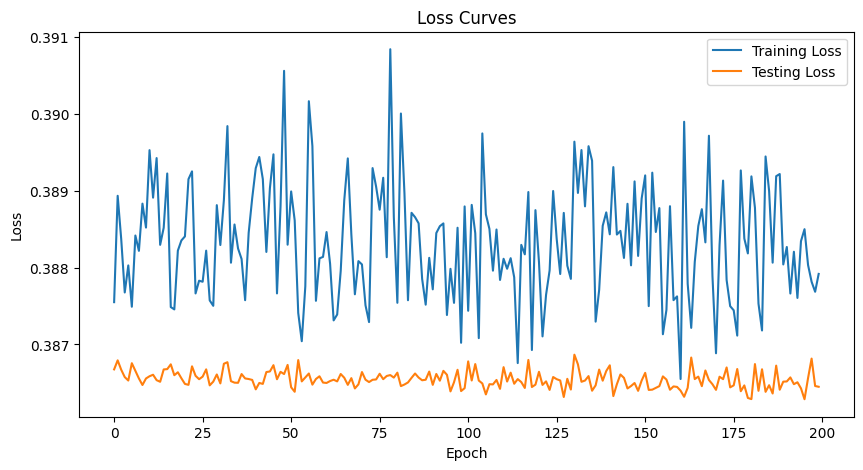

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.387 | Train Acc: 81.89% | Test NLL: 0.380 | Test Acc: 81.17%
Epoch 02 | Train NLL: 0.387 | Train Acc: 81.71% | Test NLL: 0.380 | Test Acc: 81.14%
Epoch 03 | Train NLL: 0.388 | Train Acc: 81.90% | Test NLL: 0.380 | Test Acc: 81.62%
Epoch 04 | Train NLL: 0.388 | Train Acc: 82.01% | Test NLL: 0.380 | Test Acc: 81.45%
Epoch 05 | Train NLL: 0.387 | Train Acc: 82.06% | Test NLL: 0.380 | Test Acc: 81.24%
Epoch 06 | Train NLL: 0.388 | Train Acc: 82.00% | Test NLL: 0.380 | Test Acc: 81.45%
Epoch 07 | Train NLL: 0.388 | Train Acc: 82.00% | Test NLL: 0.380 | Test Acc: 81.35%
Epoch 08 | Train NLL: 0.387 | Train Acc: 81.94% | Test NLL: 0.380 | Test Acc: 81.17%
Epoch 09 | Train NLL: 0.388 | Train Acc: 81.90% | Test NLL: 0.380 | Test Acc: 81.42%
Epoch 10 | Train NLL: 0.388 | Train Acc: 82.02% | Test NLL: 0.380 | Test Acc: 81.45%
Epoch 11 | Train NLL: 0.387 | Train Acc: 81.95% | Test NLL: 0.380

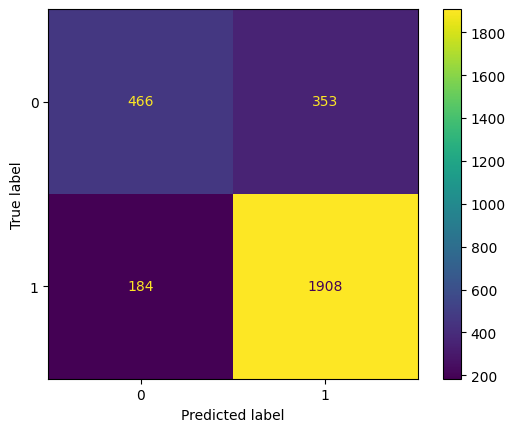

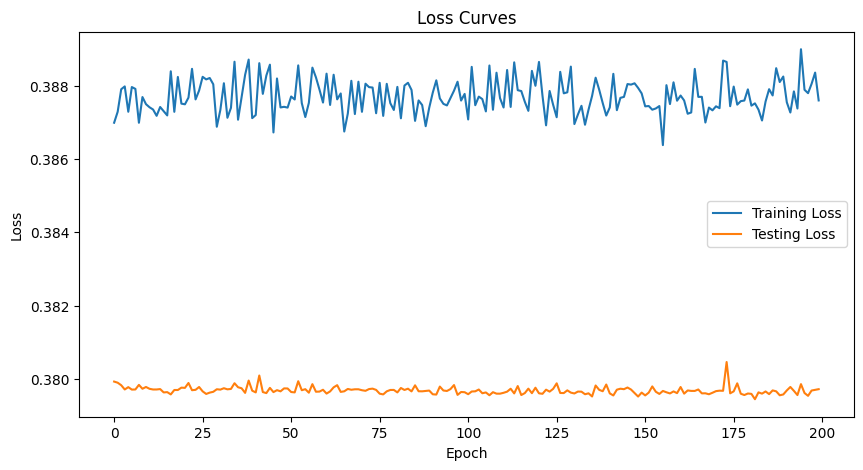

**************************************************



In [16]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=1,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=41,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(41,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(10,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
  )
  (linear): Linear(in_features=2, out_features=2, bias=True)
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.796 | Train Acc: 39.34% | Test NLL: 0.734 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.69

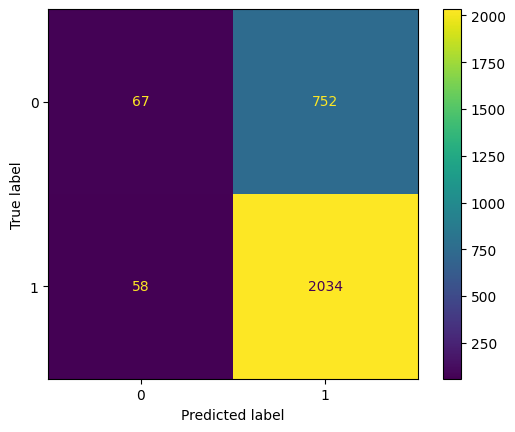

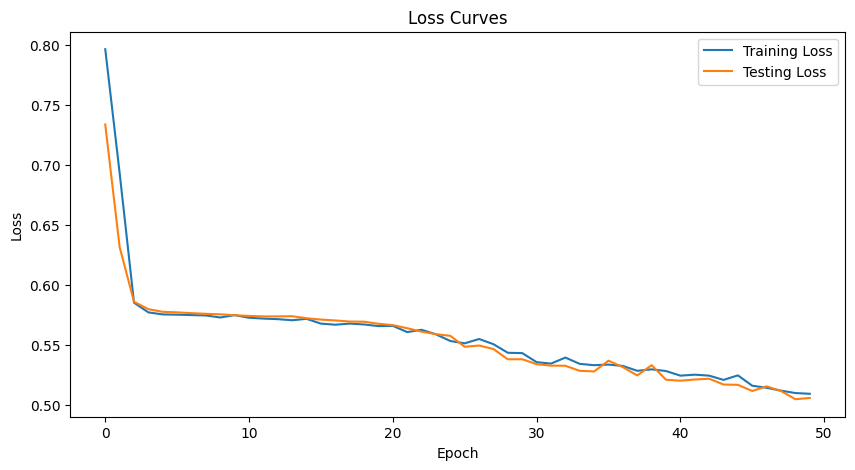

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.514 | Train Acc: 72.17% | Test NLL: 0.506 | Test Acc: 72.31%
Epoch 02 | Train NLL: 0.512 | Train Acc: 72.34% | Test NLL: 0.505 | Test Acc: 72.00%
Epoch 03 | Train NLL: 0.503 | Train Acc: 72.12% | Test NLL: 0.501 | Test Acc: 71.93%
Epoch 04 | Train NLL: 0.503 | Train Acc: 72.15% | Test NLL: 0.498 | Test Acc: 71.83%
Epoch 05 | Train NLL: 0.499 | Train Acc: 72.18% | Test NLL: 0.497 | Test Acc: 71.90%
Epoch 06 | Train NLL: 0.501 | Train Acc: 72.24% | Test NLL: 0.507 | Test Acc: 72.00%
Epoch 07 | Train NLL: 0.506 | Train Acc: 72.40% | Test NLL: 0.501 | Test Acc: 71.90%
Epoch 08 | Train NLL: 0.499 | Train Acc: 72.37% | Test NLL: 0.507 | Test Acc: 72.00%
Epoch 09 | Train NLL: 0.502 | Train Acc: 72.80% | Test NLL: 0.495 | Test Acc: 71.73%
Epoch 10 | Train NLL: 0.502 | Train Acc: 72.28% | Test NLL: 0.500 | Test Acc: 72.96%
Epoch 11 | Train NLL: 0.498 | Train Acc: 72.24% | Test NLL: 0.495 

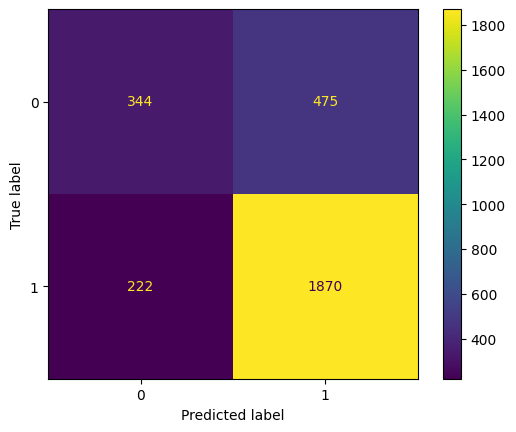

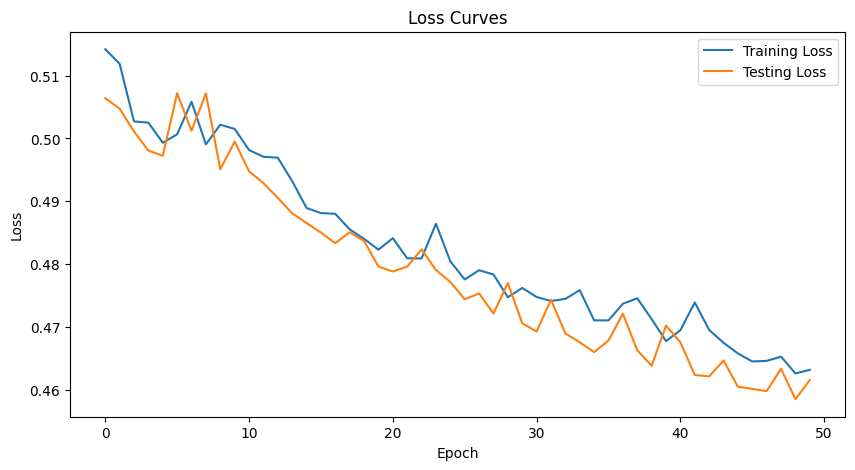

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.466 | Train Acc: 74.19% | Test NLL: 0.455 | Test Acc: 75.99%
Epoch 02 | Train NLL: 0.463 | Train Acc: 74.23% | Test NLL: 0.455 | Test Acc: 76.16%
Epoch 03 | Train NLL: 0.464 | Train Acc: 74.38% | Test NLL: 0.454 | Test Acc: 75.99%
Epoch 04 | Train NLL: 0.465 | Train Acc: 74.48% | Test NLL: 0.456 | Test Acc: 76.13%
Epoch 05 | Train NLL: 0.464 | Train Acc: 74.59% | Test NLL: 0.452 | Test Acc: 75.51%
Epoch 06 | Train NLL: 0.464 | Train Acc: 74.44% | Test NLL: 0.452 | Test Acc: 75.71%
Epoch 07 | Train NLL: 0.463 | Train Acc: 74.71% | Test NLL: 0.452 | Test Acc: 75.92%
Epoch 08 | Train NLL: 0.463 | Train Acc: 74.64% | Test NLL: 0.451 | Test Acc: 75.44%
Epoch 09 | Train NLL: 0.462 | Train Acc: 75.00% | Test NLL: 0.451 | Test Acc: 75.27%
Epoch 10 | Train NLL: 0.461 | Train Acc: 74.92% | Test NLL: 0.451 | Test Acc: 74.61%
Epoch 11 | Train NLL: 0.461 | Train Acc: 74.97% | Test NLL: 0.451 

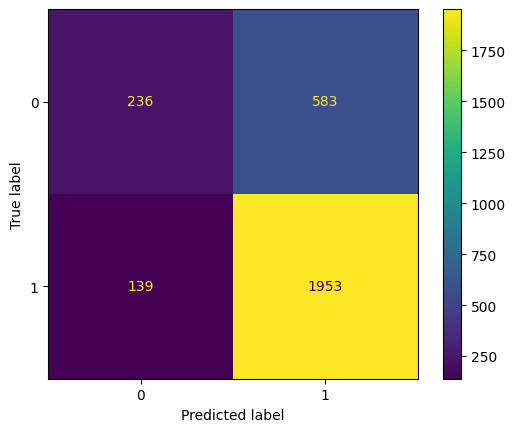

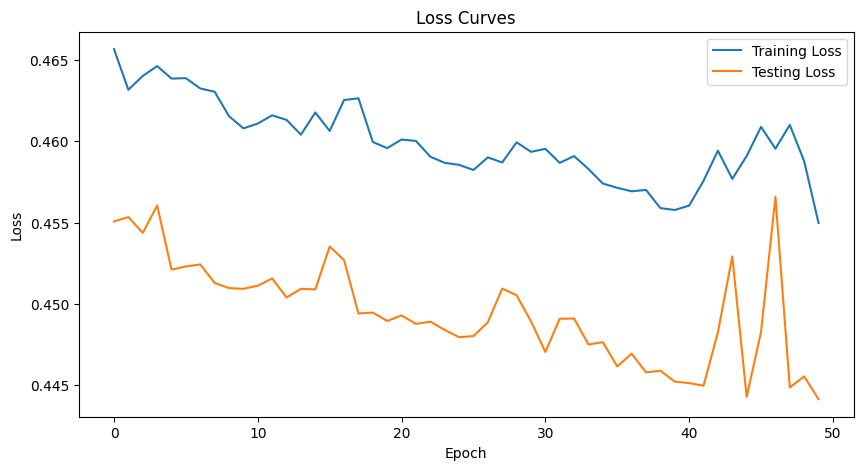

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.460 | Train Acc: 75.04% | Test NLL: 0.450 | Test Acc: 76.64%
Epoch 02 | Train NLL: 0.466 | Train Acc: 75.02% | Test NLL: 0.476 | Test Acc: 77.36%
Epoch 03 | Train NLL: 0.464 | Train Acc: 75.01% | Test NLL: 0.449 | Test Acc: 76.43%
Epoch 04 | Train NLL: 0.453 | Train Acc: 75.71% | Test NLL: 0.448 | Test Acc: 74.96%
Epoch 05 | Train NLL: 0.453 | Train Acc: 75.81% | Test NLL: 0.445 | Test Acc: 77.05%
Epoch 06 | Train NLL: 0.453 | Train Acc: 75.60% | Test NLL: 0.457 | Test Acc: 77.22%
Epoch 07 | Train NLL: 0.460 | Train Acc: 75.71% | Test NLL: 0.444 | Test Acc: 76.88%
Epoch 08 | Train NLL: 0.455 | Train Acc: 75.86% | Test NLL: 0.444 | Test Acc: 75.99%
Epoch 09 | Train NLL: 0.451 | Train Acc: 76.41% | Test NLL: 0.446 | Test Acc: 74.96%
Epoch 10 | Train NLL: 0.450 | Train Acc: 76.28% | Test NLL: 0.455 | Test Acc: 73.58%
Epoch 11 | Train NLL: 0.454 | Train Acc: 75.41% | Test NLL: 0.444 

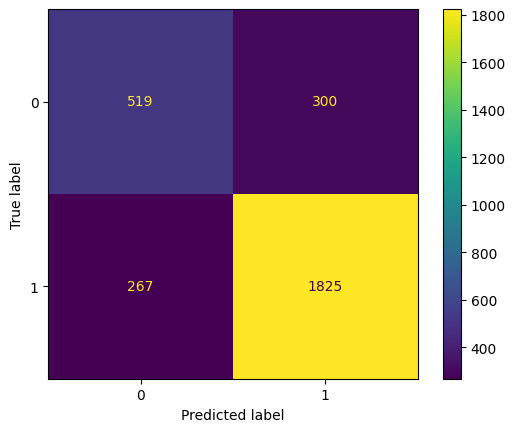

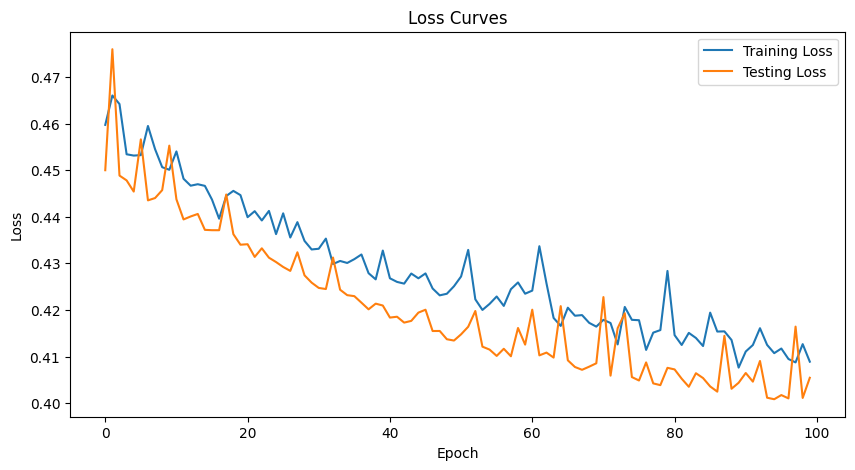

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.411 | Train Acc: 80.13% | Test NLL: 0.401 | Test Acc: 81.38%
Epoch 02 | Train NLL: 0.407 | Train Acc: 80.24% | Test NLL: 0.404 | Test Acc: 80.69%
Epoch 03 | Train NLL: 0.410 | Train Acc: 80.07% | Test NLL: 0.402 | Test Acc: 81.04%
Epoch 04 | Train NLL: 0.408 | Train Acc: 80.36% | Test NLL: 0.400 | Test Acc: 81.04%
Epoch 05 | Train NLL: 0.407 | Train Acc: 80.28% | Test NLL: 0.399 | Test Acc: 81.17%
Epoch 06 | Train NLL: 0.406 | Train Acc: 80.35% | Test NLL: 0.399 | Test Acc: 81.11%
Epoch 07 | Train NLL: 0.408 | Train Acc: 80.20% | Test NLL: 0.401 | Test Acc: 80.97%
Epoch 08 | Train NLL: 0.407 | Train Acc: 80.19% | Test NLL: 0.399 | Test Acc: 81.14%
Epoch 09 | Train NLL: 0.406 | Train Acc: 80.31% | Test NLL: 0.399 | Test Acc: 81.14%
Epoch 10 | Train NLL: 0.406 | Train Acc: 80.35% | Test NLL: 0.401 | Test Acc: 80.80%
Epoch 11 | Train NLL: 0.406 | Train Acc: 80.41% | Test NLL: 0.398

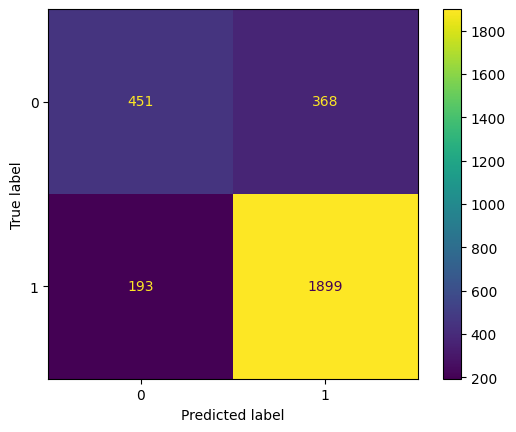

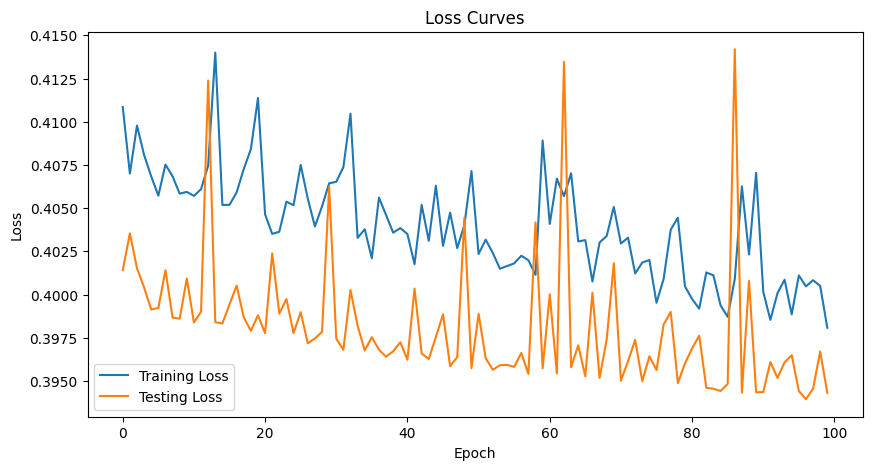

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.397 | Train Acc: 80.74% | Test NLL: 0.389 | Test Acc: 80.73%
Epoch 02 | Train NLL: 0.397 | Train Acc: 80.65% | Test NLL: 0.389 | Test Acc: 80.69%
Epoch 03 | Train NLL: 0.398 | Train Acc: 80.59% | Test NLL: 0.389 | Test Acc: 80.80%
Epoch 04 | Train NLL: 0.399 | Train Acc: 80.71% | Test NLL: 0.389 | Test Acc: 81.00%
Epoch 05 | Train NLL: 0.398 | Train Acc: 80.46% | Test NLL: 0.390 | Test Acc: 80.90%
Epoch 06 | Train NLL: 0.399 | Train Acc: 80.65% | Test NLL: 0.389 | Test Acc: 80.93%
Epoch 07 | Train NLL: 0.398 | Train Acc: 80.81% | Test NLL: 0.389 | Test Acc: 80.97%
Epoch 08 | Train NLL: 0.398 | Train Acc: 80.71% | Test NLL: 0.389 | Test Acc: 80.76%
Epoch 09 | Train NLL: 0.398 | Train Acc: 80.41% | Test NLL: 0.390 | Test Acc: 80.93%
Epoch 10 | Train NLL: 0.398 | Train Acc: 80.59% | Test NLL: 0.389 | Test Acc: 80.83%
Epoch 11 | Train NLL: 0.399 | Train Acc: 80.68% | Test NLL: 0.391

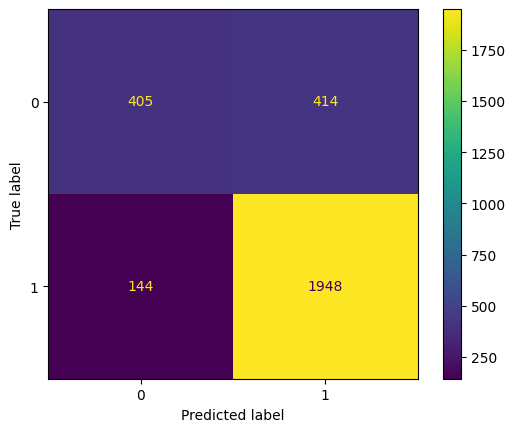

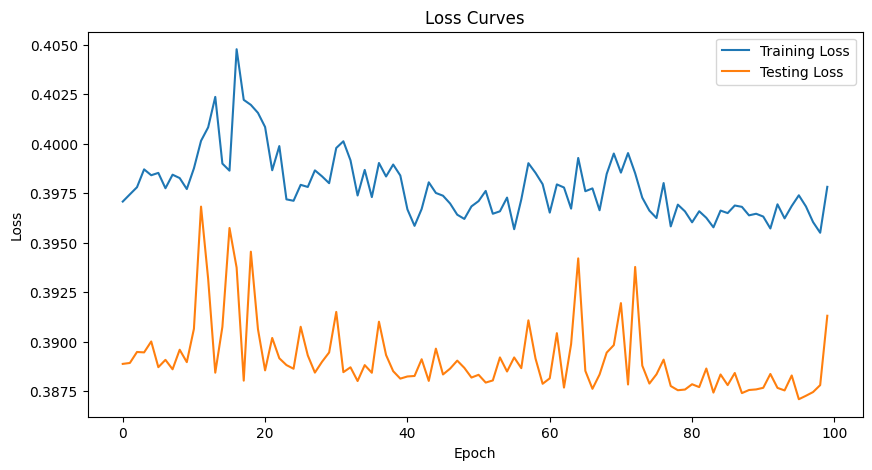

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.402 | Train Acc: 80.71% | Test NLL: 0.394 | Test Acc: 80.66%
Epoch 02 | Train NLL: 0.400 | Train Acc: 80.63% | Test NLL: 0.394 | Test Acc: 80.59%
Epoch 03 | Train NLL: 0.399 | Train Acc: 80.86% | Test NLL: 0.393 | Test Acc: 80.76%
Epoch 04 | Train NLL: 0.402 | Train Acc: 80.37% | Test NLL: 0.408 | Test Acc: 79.77%
Epoch 05 | Train NLL: 0.401 | Train Acc: 80.58% | Test NLL: 0.399 | Test Acc: 81.24%
Epoch 06 | Train NLL: 0.401 | Train Acc: 80.58% | Test NLL: 0.393 | Test Acc: 80.69%
Epoch 07 | Train NLL: 0.400 | Train Acc: 80.49% | Test NLL: 0.393 | Test Acc: 81.11%
Epoch 08 | Train NLL: 0.401 | Train Acc: 80.83% | Test NLL: 0.395 | Test Acc: 80.97%
Epoch 09 | Train NLL: 0.402 | Train Acc: 80.68% | Test NLL: 0.392 | Test Acc: 80.76%
Epoch 10 | Train NLL: 0.402 | Train Acc: 80.56% | Test NLL: 0.393 | Test Acc: 80.63%
Epoch 11 | Train NLL: 0.399 | Train Acc: 80.59% | Test NLL: 0.392 

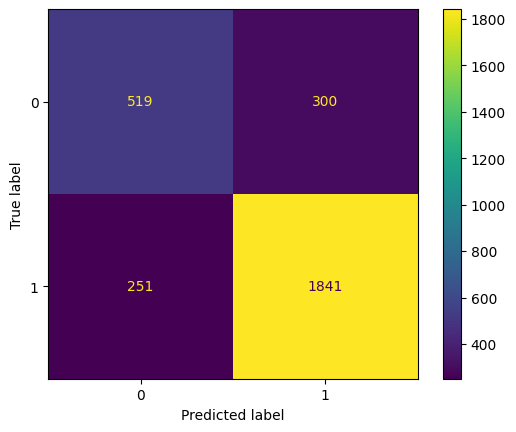

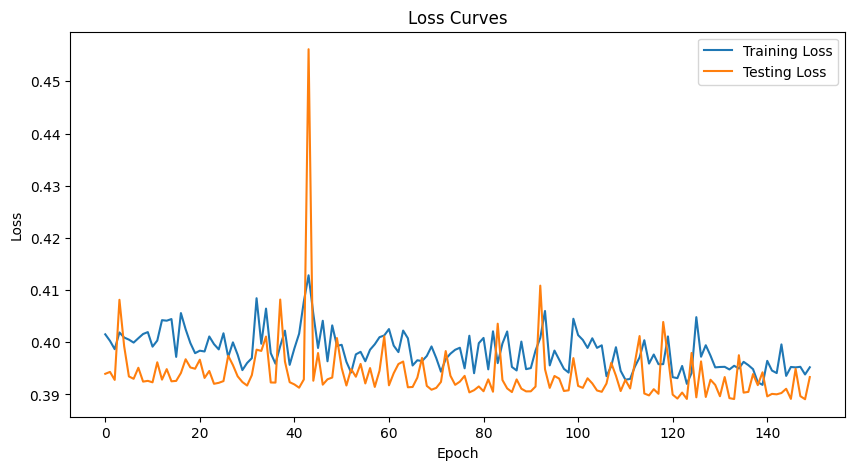

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.398 | Train Acc: 80.83% | Test NLL: 0.390 | Test Acc: 80.97%
Epoch 02 | Train NLL: 0.398 | Train Acc: 81.00% | Test NLL: 0.389 | Test Acc: 81.35%
Epoch 03 | Train NLL: 0.392 | Train Acc: 81.59% | Test NLL: 0.390 | Test Acc: 81.31%
Epoch 04 | Train NLL: 0.391 | Train Acc: 81.56% | Test NLL: 0.390 | Test Acc: 81.59%
Epoch 05 | Train NLL: 0.396 | Train Acc: 81.36% | Test NLL: 0.392 | Test Acc: 81.48%
Epoch 06 | Train NLL: 0.392 | Train Acc: 81.46% | Test NLL: 0.389 | Test Acc: 81.14%
Epoch 07 | Train NLL: 0.391 | Train Acc: 81.62% | Test NLL: 0.390 | Test Acc: 81.45%
Epoch 08 | Train NLL: 0.392 | Train Acc: 81.74% | Test NLL: 0.389 | Test Acc: 81.24%
Epoch 09 | Train NLL: 0.393 | Train Acc: 81.55% | Test NLL: 0.389 | Test Acc: 81.35%
Epoch 10 | Train NLL: 0.391 | Train Acc: 81.40% | Test NLL: 0.389 | Test Acc: 81.35%
Epoch 11 | Train NLL: 0.391 | Train Acc: 81.39% | Test NLL: 0.389

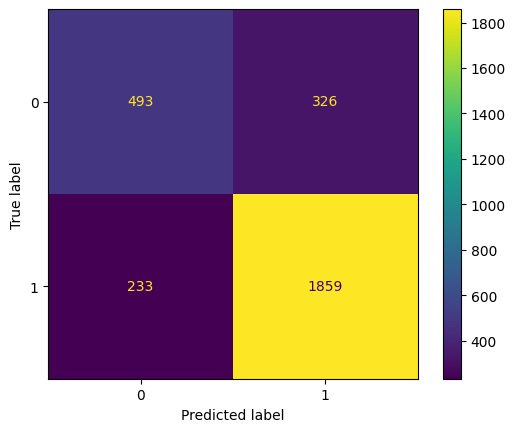

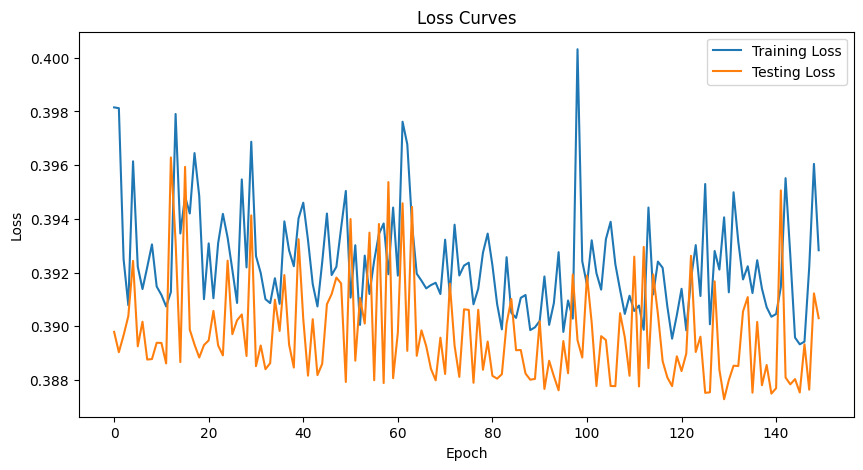

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.391 | Train Acc: 81.58% | Test NLL: 0.383 | Test Acc: 81.48%
Epoch 02 | Train NLL: 0.391 | Train Acc: 81.57% | Test NLL: 0.381 | Test Acc: 81.45%
Epoch 03 | Train NLL: 0.390 | Train Acc: 81.77% | Test NLL: 0.381 | Test Acc: 81.52%
Epoch 04 | Train NLL: 0.389 | Train Acc: 81.69% | Test NLL: 0.381 | Test Acc: 81.48%
Epoch 05 | Train NLL: 0.392 | Train Acc: 81.48% | Test NLL: 0.383 | Test Acc: 81.69%
Epoch 06 | Train NLL: 0.390 | Train Acc: 81.81% | Test NLL: 0.381 | Test Acc: 81.52%
Epoch 07 | Train NLL: 0.390 | Train Acc: 81.86% | Test NLL: 0.381 | Test Acc: 81.45%
Epoch 08 | Train NLL: 0.389 | Train Acc: 81.91% | Test NLL: 0.381 | Test Acc: 81.35%
Epoch 09 | Train NLL: 0.390 | Train Acc: 81.63% | Test NLL: 0.381 | Test Acc: 81.38%
Epoch 10 | Train NLL: 0.389 | Train Acc: 81.84% | Test NLL: 0.381 | Test Acc: 81.31%
Epoch 11 | Train NLL: 0.389 | Train Acc: 81.98% | Test NLL: 0.381

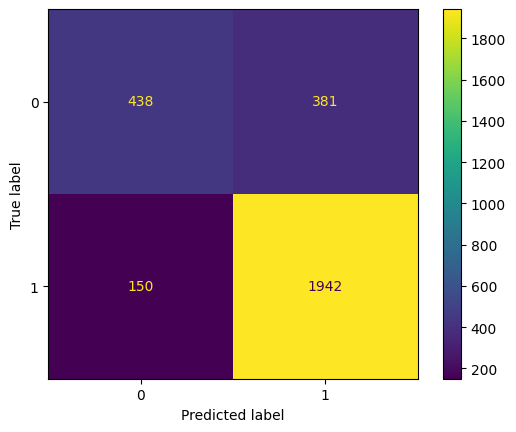

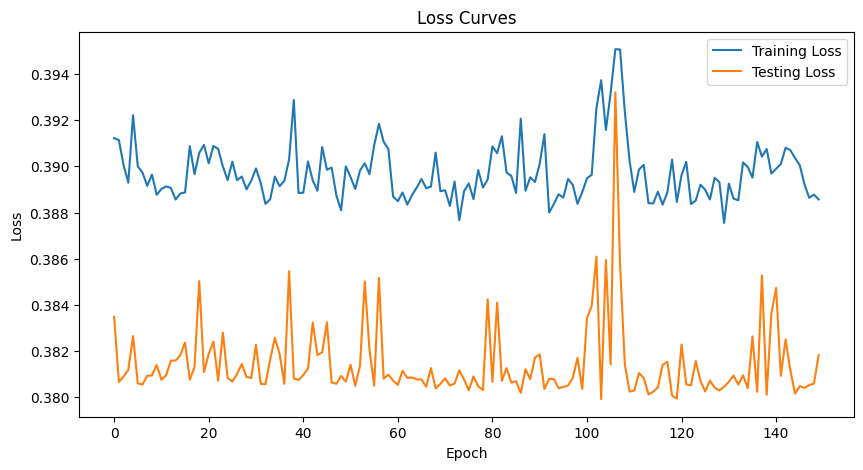

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.389 | Train Acc: 81.71% | Test NLL: 0.391 | Test Acc: 81.59%
Epoch 02 | Train NLL: 0.392 | Train Acc: 81.41% | Test NLL: 0.387 | Test Acc: 81.28%
Epoch 03 | Train NLL: 0.400 | Train Acc: 80.94% | Test NLL: 0.405 | Test Acc: 79.90%
Epoch 04 | Train NLL: 0.397 | Train Acc: 81.35% | Test NLL: 0.389 | Test Acc: 81.45%
Epoch 05 | Train NLL: 0.398 | Train Acc: 81.32% | Test NLL: 0.390 | Test Acc: 81.52%
Epoch 06 | Train NLL: 0.399 | Train Acc: 81.60% | Test NLL: 0.391 | Test Acc: 81.38%
Epoch 07 | Train NLL: 0.397 | Train Acc: 81.30% | Test NLL: 0.389 | Test Acc: 81.28%
Epoch 08 | Train NLL: 0.391 | Train Acc: 81.64% | Test NLL: 0.390 | Test Acc: 81.93%
Epoch 09 | Train NLL: 0.391 | Train Acc: 81.77% | Test NLL: 0.397 | Test Acc: 80.38%
Epoch 10 | Train NLL: 0.394 | Train Acc: 81.26% | Test NLL: 0.387 | Test Acc: 81.62%
Epoch 11 | Train NLL: 0.392 | Train Acc: 81.60% | Test NLL: 0.387 

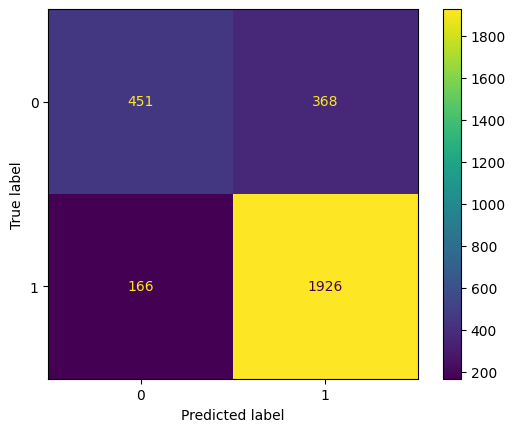

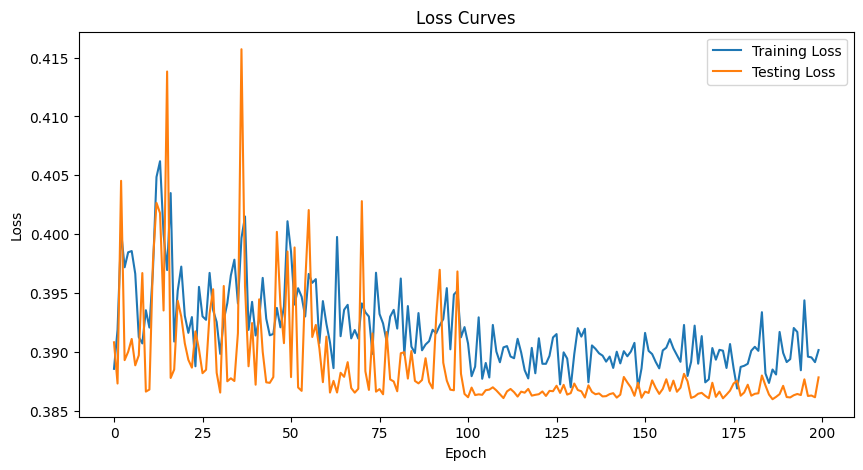

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.389 | Train Acc: 82.09% | Test NLL: 0.387 | Test Acc: 81.17%
Epoch 02 | Train NLL: 0.388 | Train Acc: 81.82% | Test NLL: 0.386 | Test Acc: 81.38%
Epoch 03 | Train NLL: 0.388 | Train Acc: 81.93% | Test NLL: 0.387 | Test Acc: 81.59%
Epoch 04 | Train NLL: 0.388 | Train Acc: 81.76% | Test NLL: 0.386 | Test Acc: 81.55%
Epoch 05 | Train NLL: 0.388 | Train Acc: 82.01% | Test NLL: 0.386 | Test Acc: 81.35%
Epoch 06 | Train NLL: 0.388 | Train Acc: 81.68% | Test NLL: 0.387 | Test Acc: 81.28%
Epoch 07 | Train NLL: 0.388 | Train Acc: 81.80% | Test NLL: 0.387 | Test Acc: 81.66%
Epoch 08 | Train NLL: 0.389 | Train Acc: 81.99% | Test NLL: 0.386 | Test Acc: 81.35%
Epoch 09 | Train NLL: 0.388 | Train Acc: 81.85% | Test NLL: 0.387 | Test Acc: 81.38%
Epoch 10 | Train NLL: 0.388 | Train Acc: 81.99% | Test NLL: 0.387 | Test Acc: 81.62%
Epoch 11 | Train NLL: 0.389 | Train Acc: 81.89% | Test NLL: 0.386

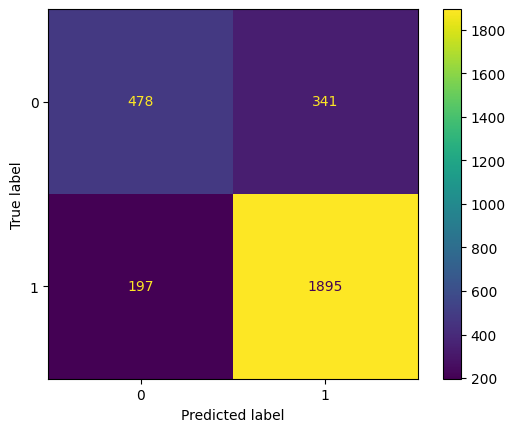

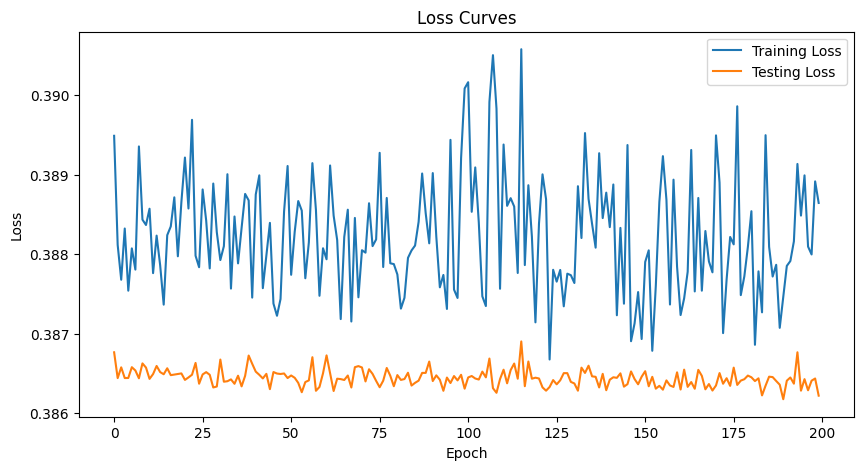

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.388 | Train Acc: 81.69% | Test NLL: 0.380 | Test Acc: 81.14%
Epoch 02 | Train NLL: 0.389 | Train Acc: 81.85% | Test NLL: 0.380 | Test Acc: 81.72%
Epoch 03 | Train NLL: 0.388 | Train Acc: 82.03% | Test NLL: 0.379 | Test Acc: 81.52%
Epoch 04 | Train NLL: 0.387 | Train Acc: 81.99% | Test NLL: 0.380 | Test Acc: 81.42%
Epoch 05 | Train NLL: 0.388 | Train Acc: 81.81% | Test NLL: 0.380 | Test Acc: 81.28%
Epoch 06 | Train NLL: 0.387 | Train Acc: 81.94% | Test NLL: 0.380 | Test Acc: 81.55%
Epoch 07 | Train NLL: 0.388 | Train Acc: 81.87% | Test NLL: 0.380 | Test Acc: 81.52%
Epoch 08 | Train NLL: 0.387 | Train Acc: 82.02% | Test NLL: 0.380 | Test Acc: 81.52%
Epoch 09 | Train NLL: 0.388 | Train Acc: 81.86% | Test NLL: 0.380 | Test Acc: 81.48%
Epoch 10 | Train NLL: 0.387 | Train Acc: 81.98% | Test NLL: 0.380 | Test Acc: 81.38%
Epoch 11 | Train NLL: 0.386 | Train Acc: 81.97% | Test NLL: 0.380

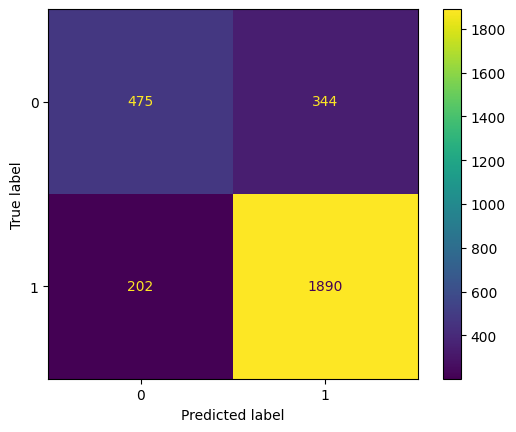

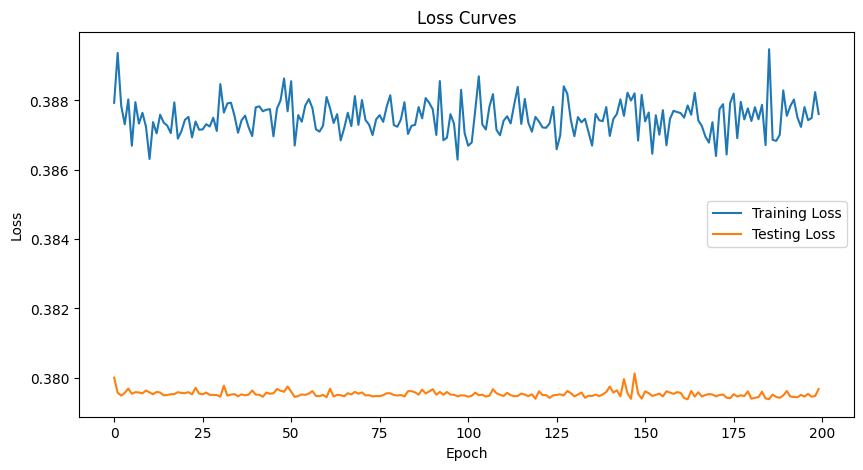

**************************************************



In [17]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=1,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=41,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.RAdam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(90,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(45,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(22,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
  )
  (linear): Linear(in_features=2, out_features=2, bias=True)
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.584 | Train Acc: 72.28% | Test NLL: 0.597 | Test Acc: 71.87%
Epoch 02 | Train NLL: 0.57

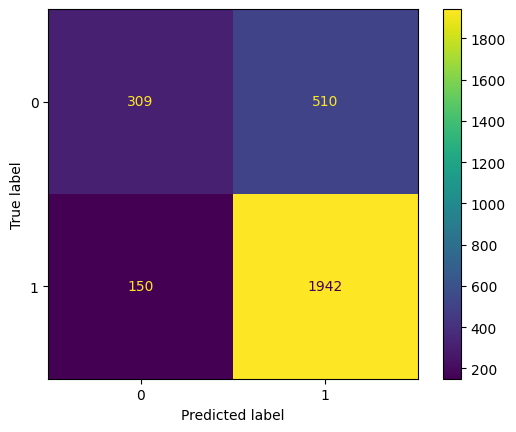

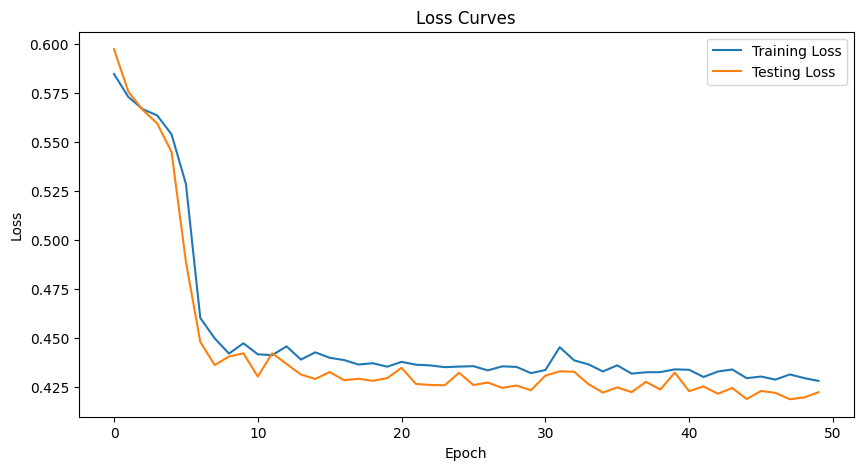

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.428 | Train Acc: 78.40% | Test NLL: 0.423 | Test Acc: 77.46%
Epoch 02 | Train NLL: 0.426 | Train Acc: 78.41% | Test NLL: 0.418 | Test Acc: 78.46%
Epoch 03 | Train NLL: 0.427 | Train Acc: 78.72% | Test NLL: 0.416 | Test Acc: 78.56%
Epoch 04 | Train NLL: 0.425 | Train Acc: 78.86% | Test NLL: 0.416 | Test Acc: 78.63%
Epoch 05 | Train NLL: 0.425 | Train Acc: 78.77% | Test NLL: 0.417 | Test Acc: 78.43%
Epoch 06 | Train NLL: 0.427 | Train Acc: 78.91% | Test NLL: 0.419 | Test Acc: 77.67%
Epoch 07 | Train NLL: 0.426 | Train Acc: 78.67% | Test NLL: 0.421 | Test Acc: 77.64%
Epoch 08 | Train NLL: 0.425 | Train Acc: 79.34% | Test NLL: 0.416 | Test Acc: 78.74%
Epoch 09 | Train NLL: 0.424 | Train Acc: 78.97% | Test NLL: 0.414 | Test Acc: 78.80%
Epoch 10 | Train NLL: 0.424 | Train Acc: 78.94% | Test NLL: 0.415 | Test Acc: 79.18%
Epoch 11 | Train NLL: 0.424 | Train Acc: 79.36% | Test NLL: 0.413 

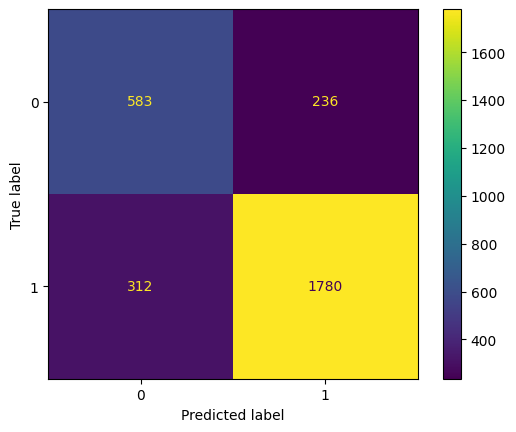

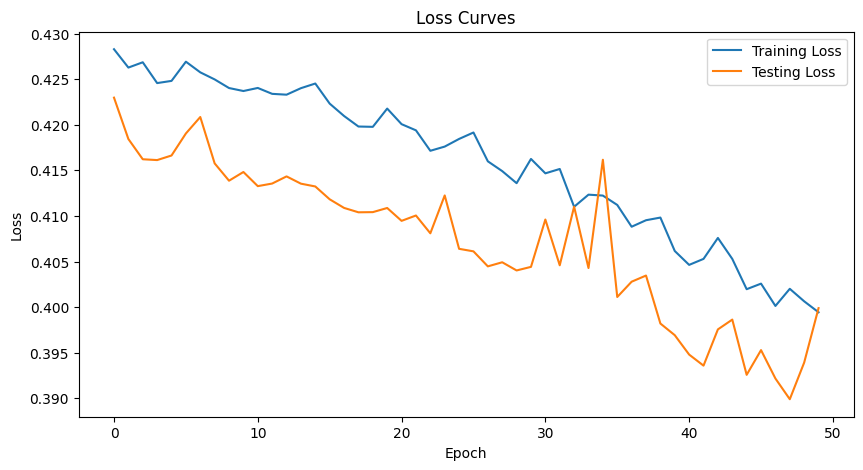

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.399 | Train Acc: 81.19% | Test NLL: 0.384 | Test Acc: 80.83%
Epoch 02 | Train NLL: 0.397 | Train Acc: 81.36% | Test NLL: 0.386 | Test Acc: 80.38%
Epoch 03 | Train NLL: 0.397 | Train Acc: 81.30% | Test NLL: 0.383 | Test Acc: 80.83%
Epoch 04 | Train NLL: 0.396 | Train Acc: 81.52% | Test NLL: 0.383 | Test Acc: 81.48%
Epoch 05 | Train NLL: 0.395 | Train Acc: 81.60% | Test NLL: 0.384 | Test Acc: 81.11%
Epoch 06 | Train NLL: 0.396 | Train Acc: 81.41% | Test NLL: 0.384 | Test Acc: 81.66%
Epoch 07 | Train NLL: 0.396 | Train Acc: 81.54% | Test NLL: 0.383 | Test Acc: 81.69%
Epoch 08 | Train NLL: 0.395 | Train Acc: 81.54% | Test NLL: 0.382 | Test Acc: 81.11%
Epoch 09 | Train NLL: 0.394 | Train Acc: 81.67% | Test NLL: 0.383 | Test Acc: 81.62%
Epoch 10 | Train NLL: 0.394 | Train Acc: 81.38% | Test NLL: 0.382 | Test Acc: 81.59%
Epoch 11 | Train NLL: 0.394 | Train Acc: 81.59% | Test NLL: 0.381 

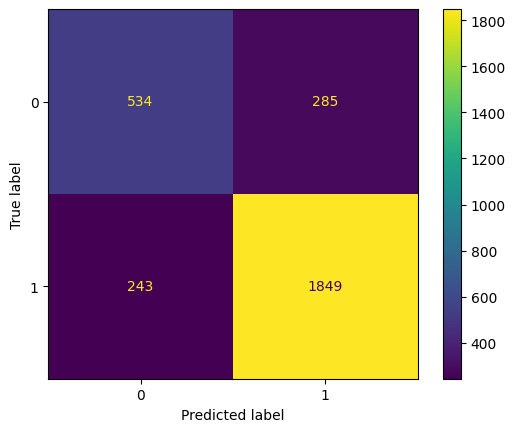

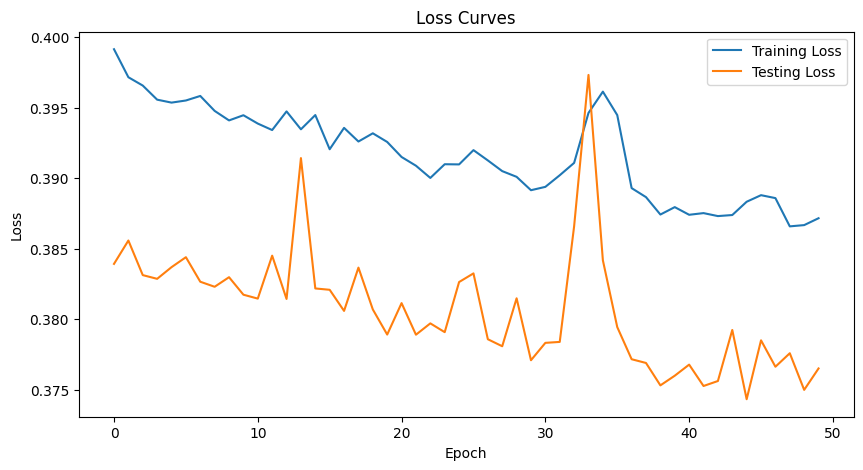

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.391 | Train Acc: 81.37% | Test NLL: 0.382 | Test Acc: 81.69%
Epoch 02 | Train NLL: 0.397 | Train Acc: 81.31% | Test NLL: 0.391 | Test Acc: 80.08%
Epoch 03 | Train NLL: 0.392 | Train Acc: 81.48% | Test NLL: 0.380 | Test Acc: 80.93%
Epoch 04 | Train NLL: 0.390 | Train Acc: 81.58% | Test NLL: 0.379 | Test Acc: 81.90%
Epoch 05 | Train NLL: 0.391 | Train Acc: 81.44% | Test NLL: 0.380 | Test Acc: 81.83%
Epoch 06 | Train NLL: 0.388 | Train Acc: 81.63% | Test NLL: 0.378 | Test Acc: 81.96%
Epoch 07 | Train NLL: 0.388 | Train Acc: 81.69% | Test NLL: 0.379 | Test Acc: 82.24%
Epoch 08 | Train NLL: 0.391 | Train Acc: 81.77% | Test NLL: 0.378 | Test Acc: 82.10%
Epoch 09 | Train NLL: 0.388 | Train Acc: 81.85% | Test NLL: 0.378 | Test Acc: 81.86%
Epoch 10 | Train NLL: 0.388 | Train Acc: 81.39% | Test NLL: 0.380 | Test Acc: 81.86%
Epoch 11 | Train NLL: 0.387 | Train Acc: 81.90% | Test NLL: 0.376 

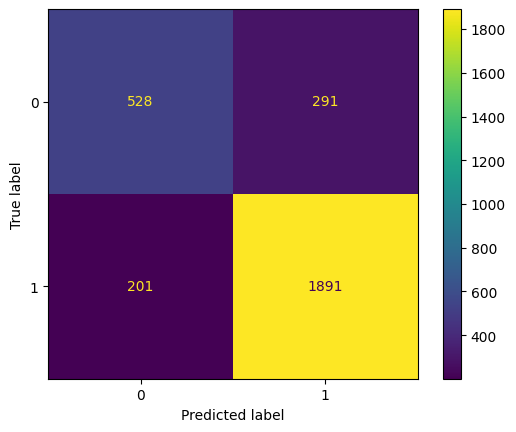

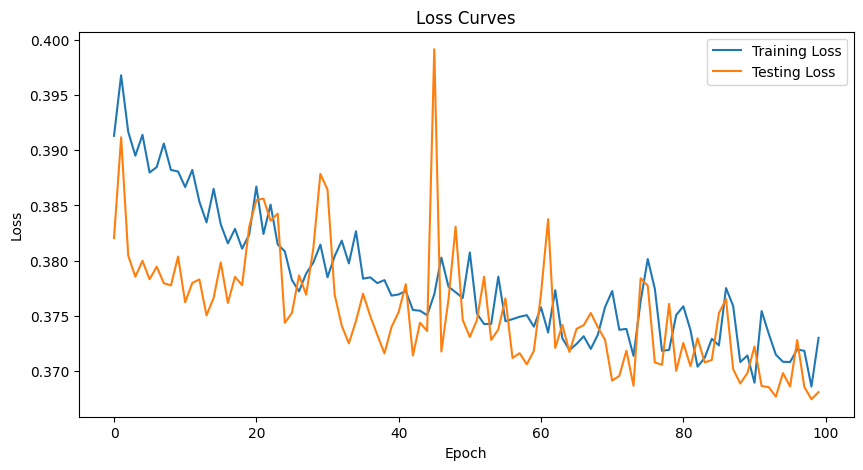

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.372 | Train Acc: 82.66% | Test NLL: 0.371 | Test Acc: 82.27%
Epoch 02 | Train NLL: 0.370 | Train Acc: 82.96% | Test NLL: 0.367 | Test Acc: 82.24%
Epoch 03 | Train NLL: 0.370 | Train Acc: 82.92% | Test NLL: 0.373 | Test Acc: 81.52%
Epoch 04 | Train NLL: 0.369 | Train Acc: 82.91% | Test NLL: 0.370 | Test Acc: 81.69%
Epoch 05 | Train NLL: 0.370 | Train Acc: 82.70% | Test NLL: 0.369 | Test Acc: 81.86%
Epoch 06 | Train NLL: 0.368 | Train Acc: 83.10% | Test NLL: 0.373 | Test Acc: 81.21%
Epoch 07 | Train NLL: 0.369 | Train Acc: 82.85% | Test NLL: 0.368 | Test Acc: 82.69%
Epoch 08 | Train NLL: 0.368 | Train Acc: 82.95% | Test NLL: 0.368 | Test Acc: 82.17%
Epoch 09 | Train NLL: 0.369 | Train Acc: 82.97% | Test NLL: 0.368 | Test Acc: 82.62%
Epoch 10 | Train NLL: 0.368 | Train Acc: 82.88% | Test NLL: 0.370 | Test Acc: 81.96%
Epoch 11 | Train NLL: 0.369 | Train Acc: 82.89% | Test NLL: 0.370

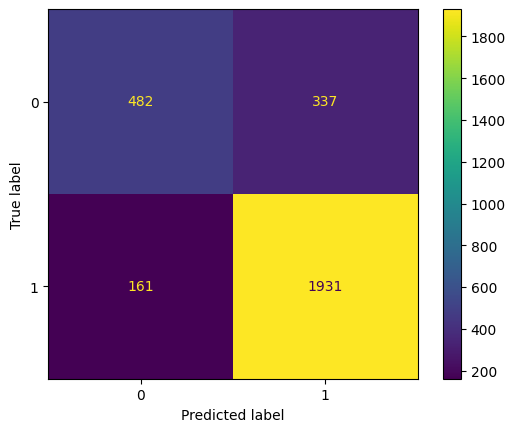

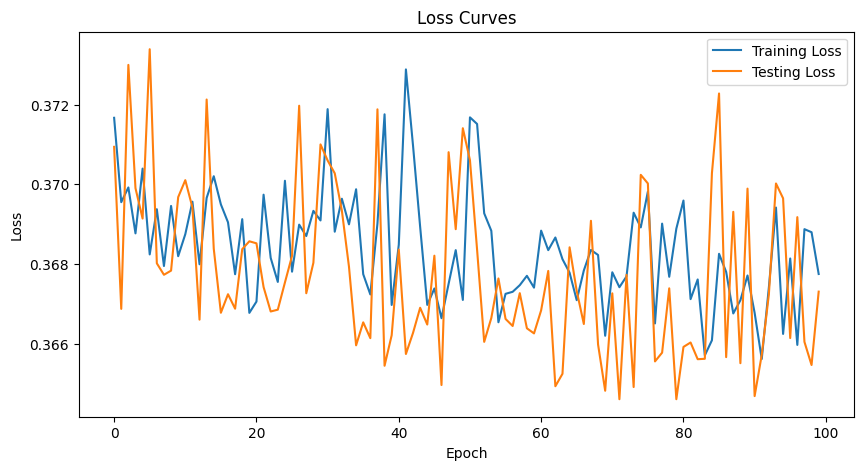

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.366 | Train Acc: 83.07% | Test NLL: 0.359 | Test Acc: 82.58%
Epoch 02 | Train NLL: 0.366 | Train Acc: 83.32% | Test NLL: 0.360 | Test Acc: 82.72%
Epoch 03 | Train NLL: 0.365 | Train Acc: 83.48% | Test NLL: 0.360 | Test Acc: 83.24%
Epoch 04 | Train NLL: 0.365 | Train Acc: 83.33% | Test NLL: 0.359 | Test Acc: 83.24%
Epoch 05 | Train NLL: 0.365 | Train Acc: 83.46% | Test NLL: 0.359 | Test Acc: 82.93%
Epoch 06 | Train NLL: 0.365 | Train Acc: 83.30% | Test NLL: 0.360 | Test Acc: 82.34%
Epoch 07 | Train NLL: 0.366 | Train Acc: 83.50% | Test NLL: 0.358 | Test Acc: 82.89%
Epoch 08 | Train NLL: 0.366 | Train Acc: 83.32% | Test NLL: 0.360 | Test Acc: 82.89%
Epoch 09 | Train NLL: 0.365 | Train Acc: 83.28% | Test NLL: 0.359 | Test Acc: 83.00%
Epoch 10 | Train NLL: 0.364 | Train Acc: 83.39% | Test NLL: 0.358 | Test Acc: 82.93%
Epoch 11 | Train NLL: 0.365 | Train Acc: 83.47% | Test NLL: 0.360

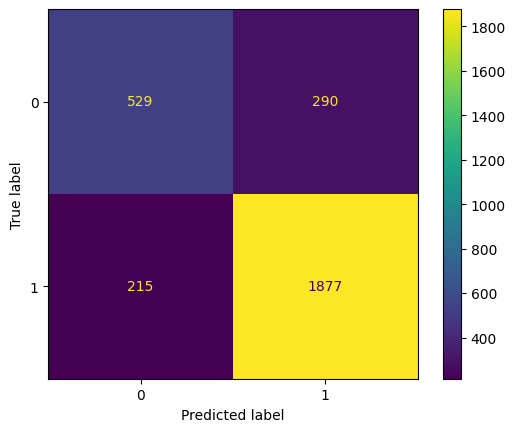

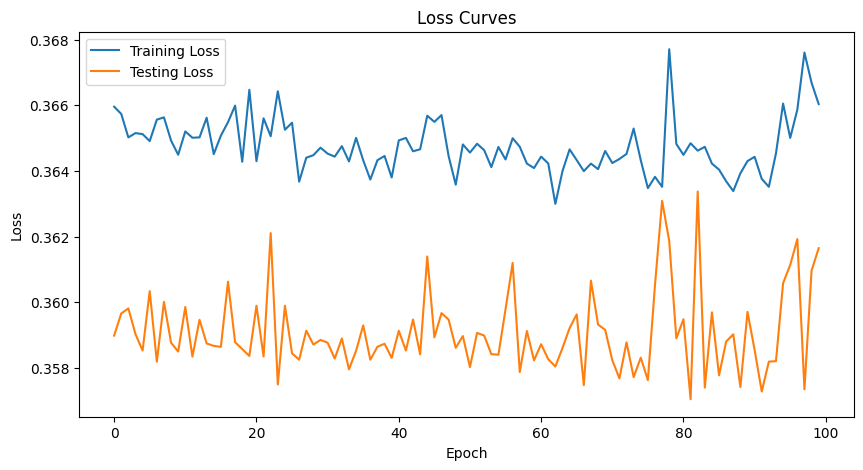

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.369 | Train Acc: 82.94% | Test NLL: 0.372 | Test Acc: 83.03%
Epoch 02 | Train NLL: 0.369 | Train Acc: 83.04% | Test NLL: 0.375 | Test Acc: 81.45%
Epoch 03 | Train NLL: 0.367 | Train Acc: 83.39% | Test NLL: 0.364 | Test Acc: 83.30%
Epoch 04 | Train NLL: 0.377 | Train Acc: 82.68% | Test NLL: 0.369 | Test Acc: 82.55%
Epoch 05 | Train NLL: 0.367 | Train Acc: 83.06% | Test NLL: 0.374 | Test Acc: 82.07%
Epoch 06 | Train NLL: 0.368 | Train Acc: 83.46% | Test NLL: 0.371 | Test Acc: 82.21%
Epoch 07 | Train NLL: 0.371 | Train Acc: 82.94% | Test NLL: 0.368 | Test Acc: 82.24%
Epoch 08 | Train NLL: 0.369 | Train Acc: 82.91% | Test NLL: 0.379 | Test Acc: 81.17%
Epoch 09 | Train NLL: 0.369 | Train Acc: 82.85% | Test NLL: 0.368 | Test Acc: 83.27%
Epoch 10 | Train NLL: 0.367 | Train Acc: 83.50% | Test NLL: 0.369 | Test Acc: 82.31%
Epoch 11 | Train NLL: 0.369 | Train Acc: 83.12% | Test NLL: 0.365 

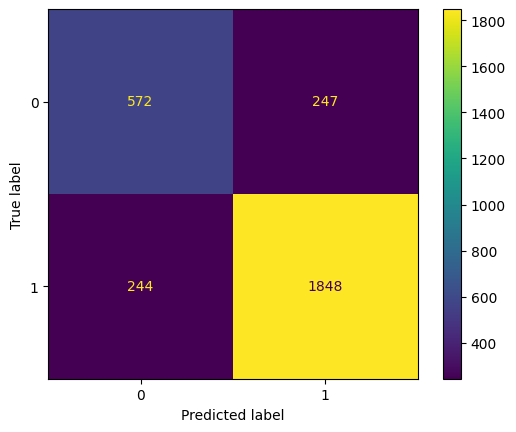

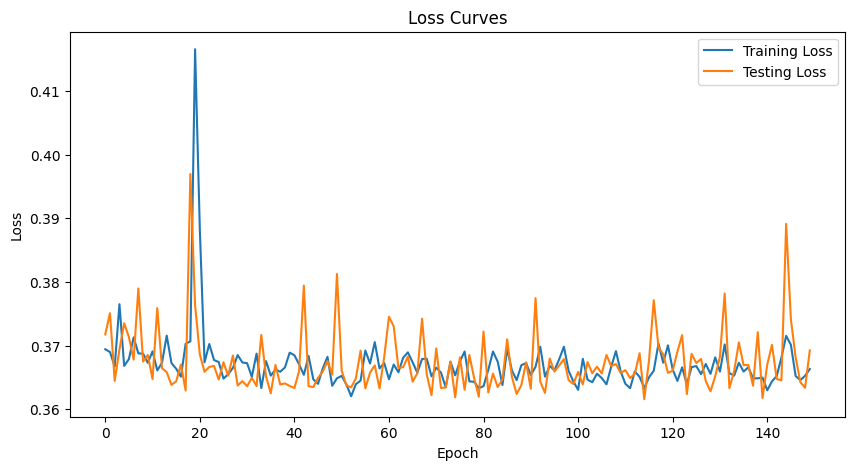

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.365 | Train Acc: 83.77% | Test NLL: 0.363 | Test Acc: 83.24%
Epoch 02 | Train NLL: 0.363 | Train Acc: 83.64% | Test NLL: 0.365 | Test Acc: 82.89%
Epoch 03 | Train NLL: 0.362 | Train Acc: 83.64% | Test NLL: 0.361 | Test Acc: 83.55%
Epoch 04 | Train NLL: 0.364 | Train Acc: 83.71% | Test NLL: 0.363 | Test Acc: 83.37%
Epoch 05 | Train NLL: 0.364 | Train Acc: 83.56% | Test NLL: 0.364 | Test Acc: 82.55%
Epoch 06 | Train NLL: 0.364 | Train Acc: 83.80% | Test NLL: 0.366 | Test Acc: 82.48%
Epoch 07 | Train NLL: 0.363 | Train Acc: 83.58% | Test NLL: 0.365 | Test Acc: 83.00%
Epoch 08 | Train NLL: 0.363 | Train Acc: 83.48% | Test NLL: 0.368 | Test Acc: 83.10%
Epoch 09 | Train NLL: 0.365 | Train Acc: 83.52% | Test NLL: 0.366 | Test Acc: 82.82%
Epoch 10 | Train NLL: 0.365 | Train Acc: 83.38% | Test NLL: 0.362 | Test Acc: 83.03%
Epoch 11 | Train NLL: 0.364 | Train Acc: 83.68% | Test NLL: 0.367

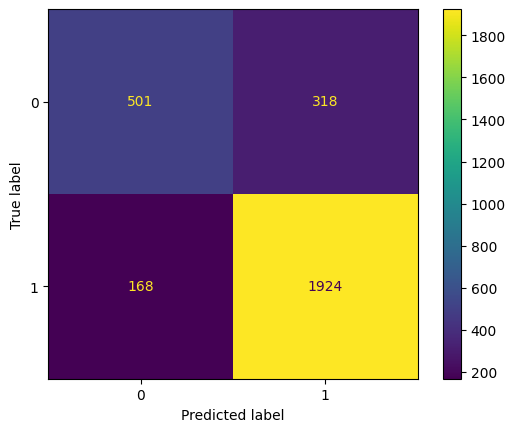

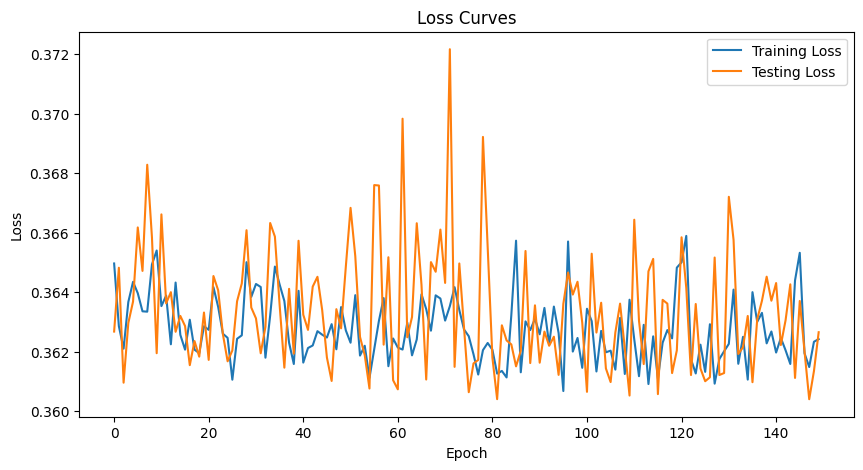

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.361 | Train Acc: 83.97% | Test NLL: 0.356 | Test Acc: 83.68%
Epoch 02 | Train NLL: 0.361 | Train Acc: 83.79% | Test NLL: 0.356 | Test Acc: 83.58%
Epoch 03 | Train NLL: 0.361 | Train Acc: 83.84% | Test NLL: 0.356 | Test Acc: 83.06%
Epoch 04 | Train NLL: 0.361 | Train Acc: 83.63% | Test NLL: 0.356 | Test Acc: 83.51%
Epoch 05 | Train NLL: 0.361 | Train Acc: 83.94% | Test NLL: 0.355 | Test Acc: 83.51%
Epoch 06 | Train NLL: 0.360 | Train Acc: 83.87% | Test NLL: 0.356 | Test Acc: 83.72%
Epoch 07 | Train NLL: 0.360 | Train Acc: 83.82% | Test NLL: 0.354 | Test Acc: 83.51%
Epoch 08 | Train NLL: 0.361 | Train Acc: 83.94% | Test NLL: 0.355 | Test Acc: 83.34%
Epoch 09 | Train NLL: 0.360 | Train Acc: 83.90% | Test NLL: 0.356 | Test Acc: 83.58%
Epoch 10 | Train NLL: 0.360 | Train Acc: 83.82% | Test NLL: 0.355 | Test Acc: 83.61%
Epoch 11 | Train NLL: 0.360 | Train Acc: 83.70% | Test NLL: 0.355

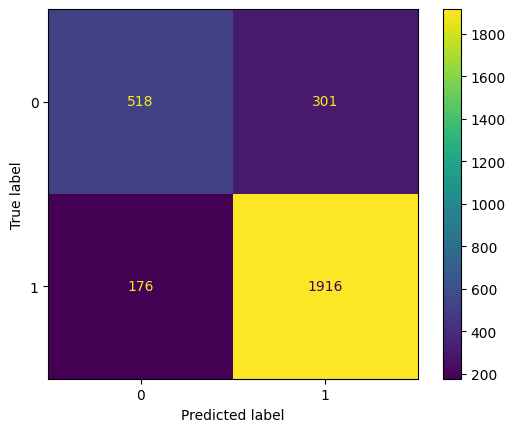

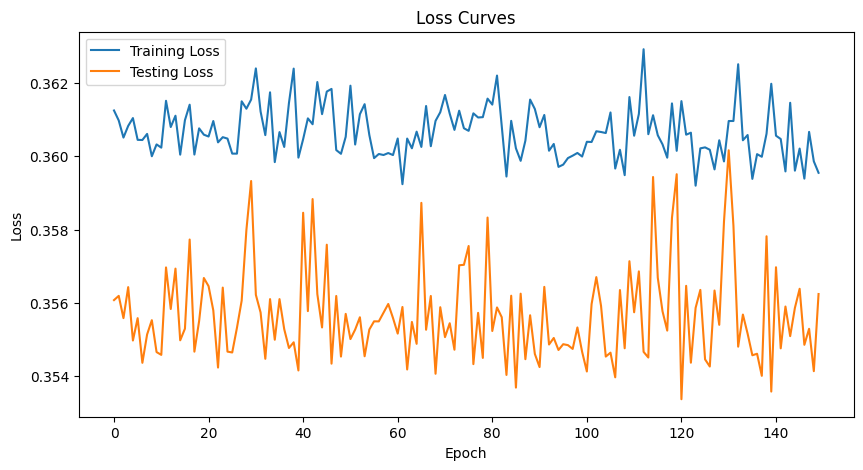

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.362 | Train Acc: 83.90% | Test NLL: 0.364 | Test Acc: 82.69%
Epoch 02 | Train NLL: 0.367 | Train Acc: 83.37% | Test NLL: 0.367 | Test Acc: 83.24%
Epoch 03 | Train NLL: 0.398 | Train Acc: 81.81% | Test NLL: 0.393 | Test Acc: 79.80%
Epoch 04 | Train NLL: 1.017 | Train Acc: 75.82% | Test NLL: 3.840 | Test Acc: 41.88%
Epoch 05 | Train NLL: 2.105 | Train Acc: 67.60% | Test NLL: 0.694 | Test Acc: 72.11%
Epoch 06 | Train NLL: 0.435 | Train Acc: 78.78% | Test NLL: 0.388 | Test Acc: 81.07%
Epoch 07 | Train NLL: 0.390 | Train Acc: 80.65% | Test NLL: 0.378 | Test Acc: 80.90%
Epoch 08 | Train NLL: 0.384 | Train Acc: 81.14% | Test NLL: 0.374 | Test Acc: 81.45%
Epoch 09 | Train NLL: 0.384 | Train Acc: 81.10% | Test NLL: 0.375 | Test Acc: 81.48%
Epoch 10 | Train NLL: 0.380 | Train Acc: 80.95% | Test NLL: 0.373 | Test Acc: 81.35%
Epoch 11 | Train NLL: 0.379 | Train Acc: 81.22% | Test NLL: 0.372 

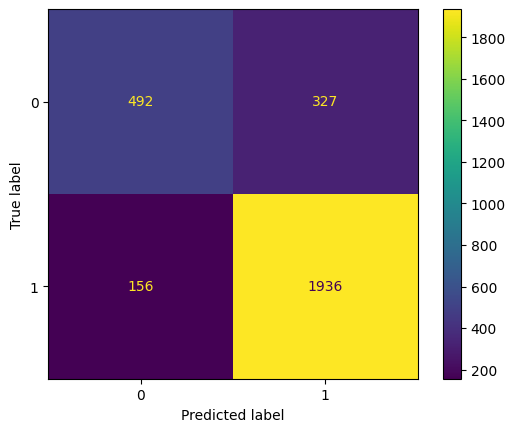

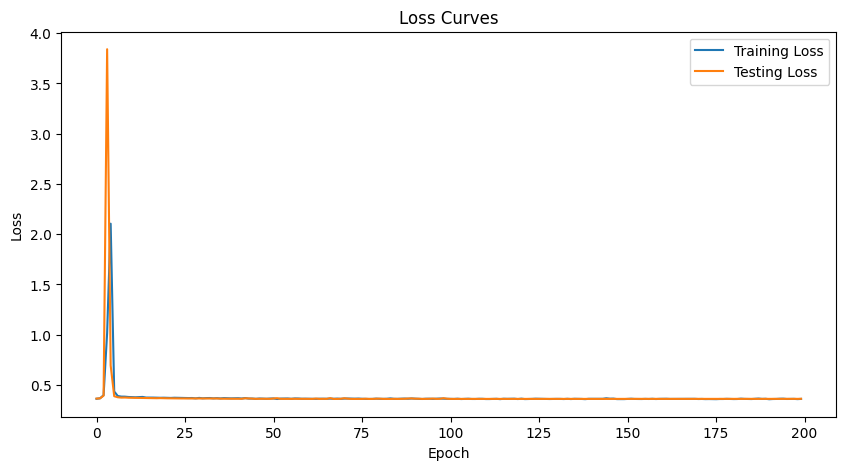

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.362 | Train Acc: 83.48% | Test NLL: 0.362 | Test Acc: 83.34%
Epoch 02 | Train NLL: 0.360 | Train Acc: 83.88% | Test NLL: 0.361 | Test Acc: 83.58%
Epoch 03 | Train NLL: 0.361 | Train Acc: 83.77% | Test NLL: 0.361 | Test Acc: 83.58%
Epoch 04 | Train NLL: 0.360 | Train Acc: 83.71% | Test NLL: 0.361 | Test Acc: 83.58%
Epoch 05 | Train NLL: 0.361 | Train Acc: 83.68% | Test NLL: 0.361 | Test Acc: 83.55%
Epoch 06 | Train NLL: 0.362 | Train Acc: 83.71% | Test NLL: 0.361 | Test Acc: 83.48%
Epoch 07 | Train NLL: 0.360 | Train Acc: 83.68% | Test NLL: 0.361 | Test Acc: 83.58%
Epoch 08 | Train NLL: 0.360 | Train Acc: 83.80% | Test NLL: 0.361 | Test Acc: 83.51%
Epoch 09 | Train NLL: 0.360 | Train Acc: 83.73% | Test NLL: 0.362 | Test Acc: 83.61%
Epoch 10 | Train NLL: 0.360 | Train Acc: 83.70% | Test NLL: 0.361 | Test Acc: 83.51%
Epoch 11 | Train NLL: 0.361 | Train Acc: 83.87% | Test NLL: 0.361

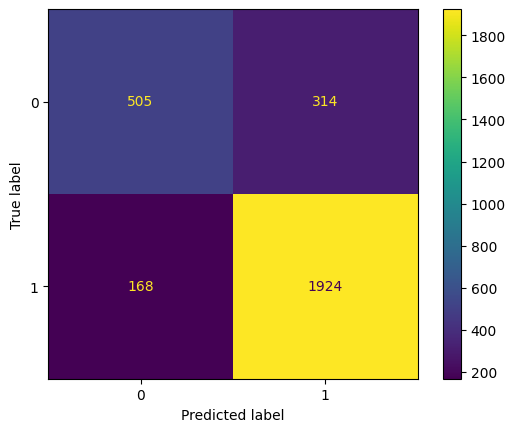

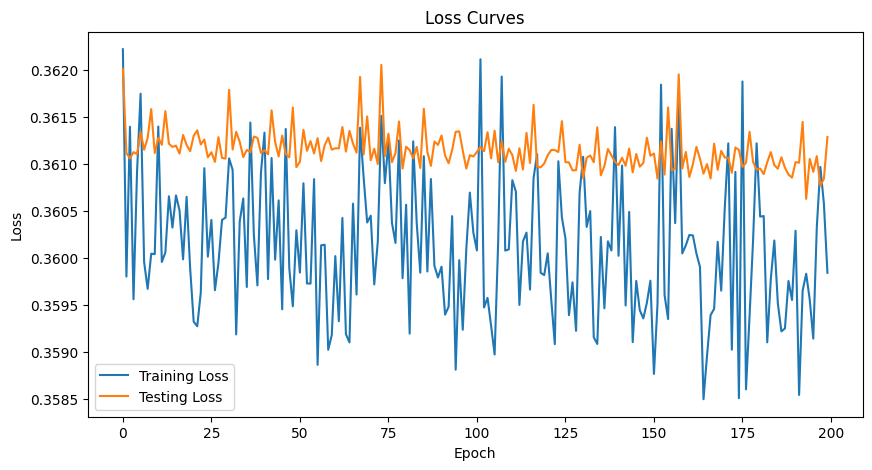

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.360 | Train Acc: 83.75% | Test NLL: 0.355 | Test Acc: 83.51%
Epoch 02 | Train NLL: 0.360 | Train Acc: 83.75% | Test NLL: 0.355 | Test Acc: 83.61%
Epoch 03 | Train NLL: 0.359 | Train Acc: 83.85% | Test NLL: 0.355 | Test Acc: 83.48%
Epoch 04 | Train NLL: 0.359 | Train Acc: 83.81% | Test NLL: 0.355 | Test Acc: 83.51%
Epoch 05 | Train NLL: 0.359 | Train Acc: 83.76% | Test NLL: 0.355 | Test Acc: 83.58%
Epoch 06 | Train NLL: 0.360 | Train Acc: 83.79% | Test NLL: 0.355 | Test Acc: 83.55%
Epoch 07 | Train NLL: 0.359 | Train Acc: 83.74% | Test NLL: 0.355 | Test Acc: 83.61%
Epoch 08 | Train NLL: 0.359 | Train Acc: 83.73% | Test NLL: 0.355 | Test Acc: 83.48%
Epoch 09 | Train NLL: 0.359 | Train Acc: 83.83% | Test NLL: 0.355 | Test Acc: 83.48%
Epoch 10 | Train NLL: 0.359 | Train Acc: 83.76% | Test NLL: 0.355 | Test Acc: 83.55%
Epoch 11 | Train NLL: 0.359 | Train Acc: 83.77% | Test NLL: 0.355

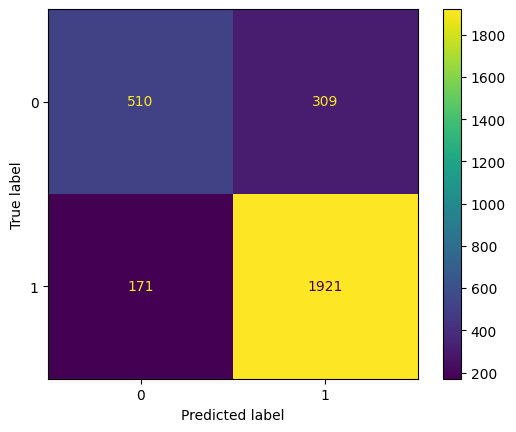

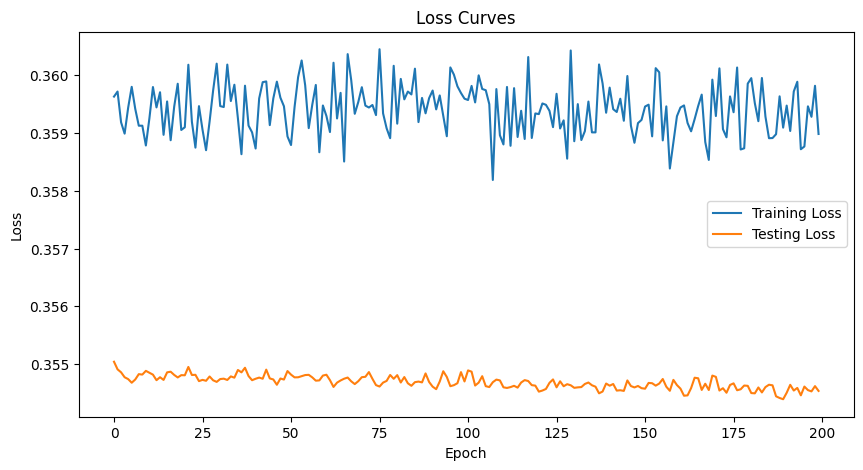

**************************************************



In [18]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=1,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=90,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(5,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(2,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(1,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
  )
  (linear): Linear(in_features=2, out_features=2, bias=True)
)
EPOCH : 50 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.817 | Train Acc: 29.16% | Test NLL: 0.777 | Test Acc: 28.13%
Epoch 02 | Train NLL: 0.672 |

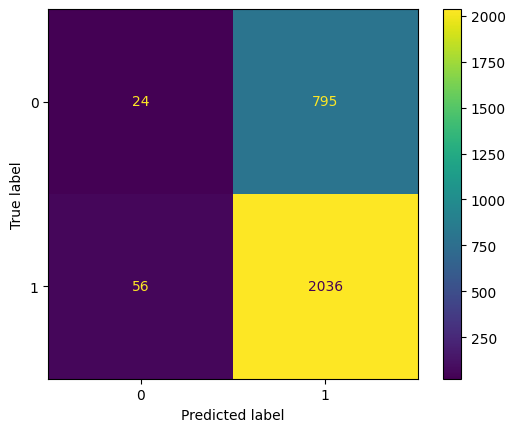

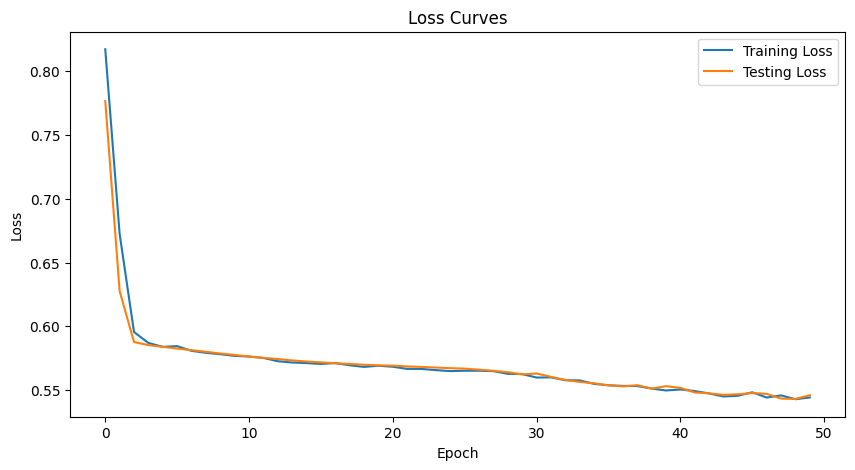

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.542 | Train Acc: 71.47% | Test NLL: 0.542 | Test Acc: 71.80%
Epoch 02 | Train NLL: 0.541 | Train Acc: 71.45% | Test NLL: 0.542 | Test Acc: 71.69%
Epoch 03 | Train NLL: 0.542 | Train Acc: 71.77% | Test NLL: 0.542 | Test Acc: 71.08%
Epoch 04 | Train NLL: 0.541 | Train Acc: 71.50% | Test NLL: 0.541 | Test Acc: 71.32%
Epoch 05 | Train NLL: 0.540 | Train Acc: 71.43% | Test NLL: 0.540 | Test Acc: 71.14%
Epoch 06 | Train NLL: 0.539 | Train Acc: 71.63% | Test NLL: 0.540 | Test Acc: 71.56%
Epoch 07 | Train NLL: 0.539 | Train Acc: 71.59% | Test NLL: 0.540 | Test Acc: 71.11%
Epoch 08 | Train NLL: 0.539 | Train Acc: 71.61% | Test NLL: 0.544 | Test Acc: 70.97%
Epoch 09 | Train NLL: 0.539 | Train Acc: 71.41% | Test NLL: 0.539 | Test Acc: 71.49%
Epoch 10 | Train NLL: 0.538 | Train Acc: 71.46% | Test NLL: 0.539 | Test Acc: 71.14%
Epoch 11 | Train NLL: 0.537 | Train Acc: 71.31% | Test NLL: 0.538 

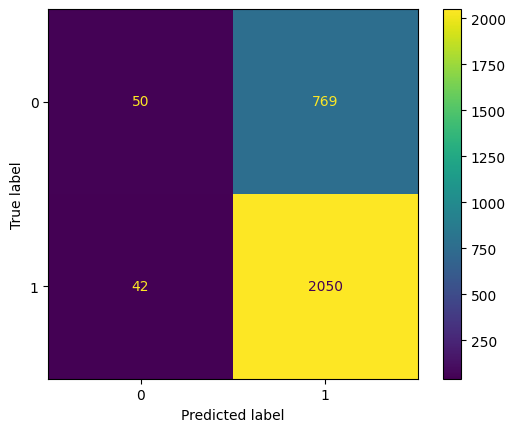

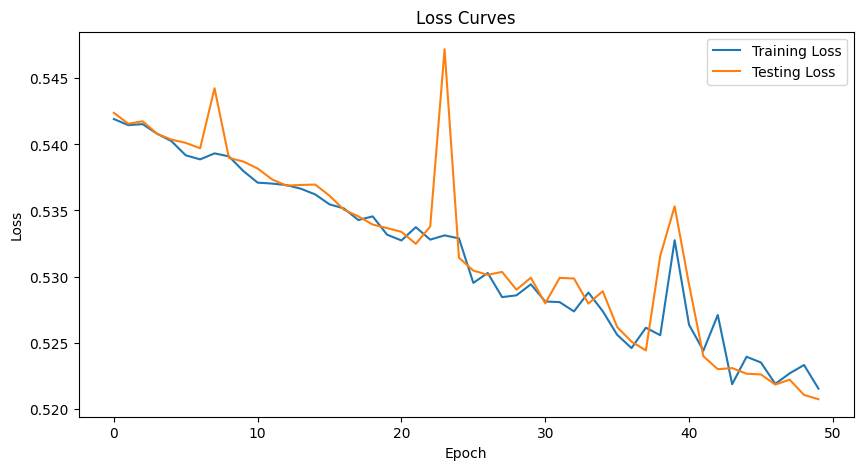

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.520 | Train Acc: 71.77% | Test NLL: 0.517 | Test Acc: 71.93%
Epoch 02 | Train NLL: 0.520 | Train Acc: 71.71% | Test NLL: 0.516 | Test Acc: 71.93%
Epoch 03 | Train NLL: 0.520 | Train Acc: 71.89% | Test NLL: 0.516 | Test Acc: 71.97%
Epoch 04 | Train NLL: 0.520 | Train Acc: 72.05% | Test NLL: 0.516 | Test Acc: 71.87%
Epoch 05 | Train NLL: 0.521 | Train Acc: 71.90% | Test NLL: 0.516 | Test Acc: 72.07%
Epoch 06 | Train NLL: 0.521 | Train Acc: 72.18% | Test NLL: 0.516 | Test Acc: 71.87%
Epoch 07 | Train NLL: 0.519 | Train Acc: 71.87% | Test NLL: 0.515 | Test Acc: 72.11%
Epoch 08 | Train NLL: 0.520 | Train Acc: 71.70% | Test NLL: 0.515 | Test Acc: 71.87%
Epoch 09 | Train NLL: 0.519 | Train Acc: 71.97% | Test NLL: 0.515 | Test Acc: 72.07%
Epoch 10 | Train NLL: 0.520 | Train Acc: 72.01% | Test NLL: 0.515 | Test Acc: 72.11%
Epoch 11 | Train NLL: 0.519 | Train Acc: 71.84% | Test NLL: 0.515 

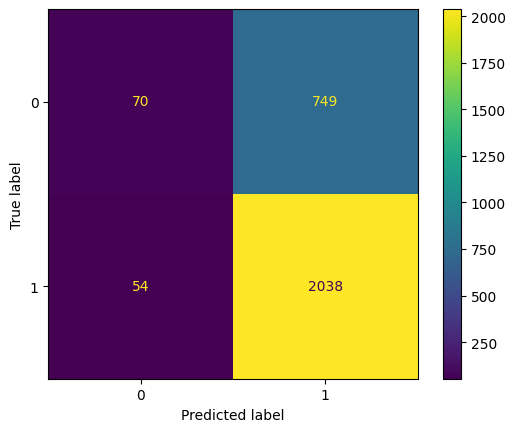

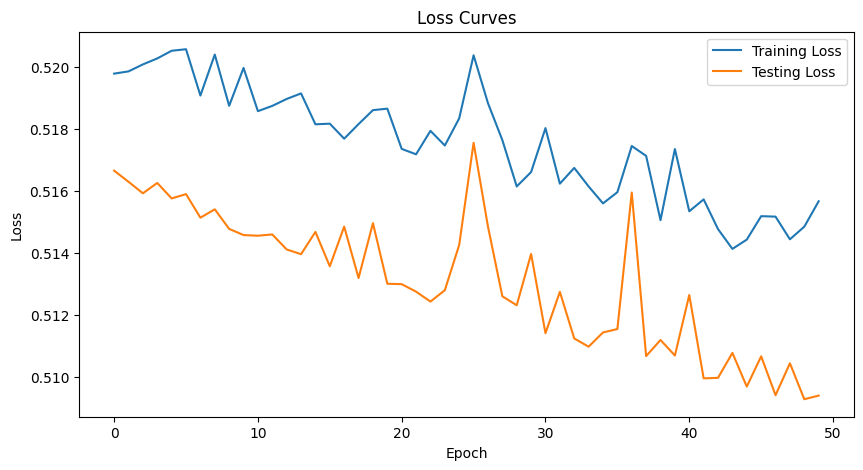

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.516 | Train Acc: 72.16% | Test NLL: 0.513 | Test Acc: 72.11%
Epoch 02 | Train NLL: 0.521 | Train Acc: 72.39% | Test NLL: 0.537 | Test Acc: 71.87%
Epoch 03 | Train NLL: 0.521 | Train Acc: 72.40% | Test NLL: 0.515 | Test Acc: 72.48%
Epoch 04 | Train NLL: 0.522 | Train Acc: 72.35% | Test NLL: 0.515 | Test Acc: 72.72%
Epoch 05 | Train NLL: 0.524 | Train Acc: 72.18% | Test NLL: 0.512 | Test Acc: 72.17%
Epoch 06 | Train NLL: 0.519 | Train Acc: 72.19% | Test NLL: 0.518 | Test Acc: 72.76%
Epoch 07 | Train NLL: 0.518 | Train Acc: 72.47% | Test NLL: 0.524 | Test Acc: 72.31%
Epoch 08 | Train NLL: 0.516 | Train Acc: 72.43% | Test NLL: 0.525 | Test Acc: 72.21%
Epoch 09 | Train NLL: 0.520 | Train Acc: 72.36% | Test NLL: 0.552 | Test Acc: 72.66%
Epoch 10 | Train NLL: 0.522 | Train Acc: 72.19% | Test NLL: 0.516 | Test Acc: 72.62%
Epoch 11 | Train NLL: 0.521 | Train Acc: 72.36% | Test NLL: 0.524 

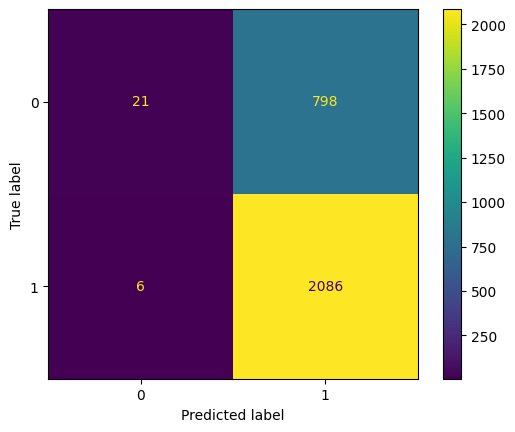

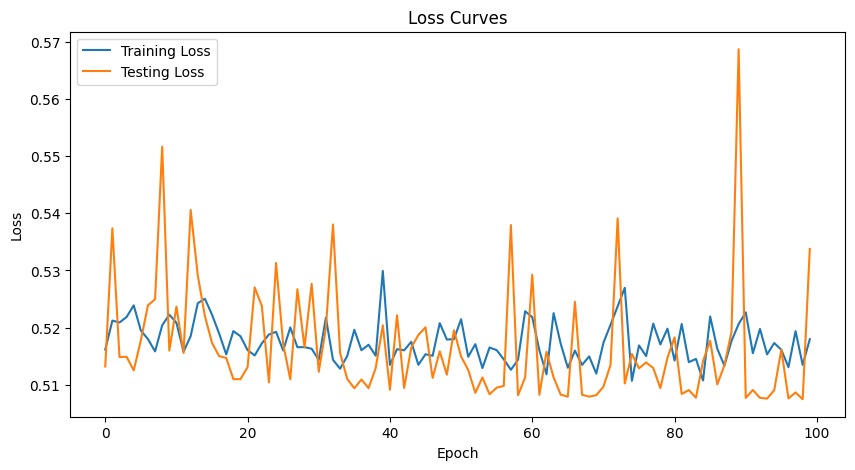

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.513 | Train Acc: 72.58% | Test NLL: 0.510 | Test Acc: 73.14%
Epoch 02 | Train NLL: 0.510 | Train Acc: 72.47% | Test NLL: 0.508 | Test Acc: 72.79%
Epoch 03 | Train NLL: 0.511 | Train Acc: 72.48% | Test NLL: 0.521 | Test Acc: 72.69%
Epoch 04 | Train NLL: 0.513 | Train Acc: 72.50% | Test NLL: 0.520 | Test Acc: 73.00%
Epoch 05 | Train NLL: 0.512 | Train Acc: 72.30% | Test NLL: 0.509 | Test Acc: 72.59%
Epoch 06 | Train NLL: 0.511 | Train Acc: 72.72% | Test NLL: 0.509 | Test Acc: 73.27%
Epoch 07 | Train NLL: 0.511 | Train Acc: 72.53% | Test NLL: 0.508 | Test Acc: 72.55%
Epoch 08 | Train NLL: 0.514 | Train Acc: 72.30% | Test NLL: 0.514 | Test Acc: 72.79%
Epoch 09 | Train NLL: 0.512 | Train Acc: 72.59% | Test NLL: 0.509 | Test Acc: 73.31%
Epoch 10 | Train NLL: 0.510 | Train Acc: 72.68% | Test NLL: 0.508 | Test Acc: 72.93%
Epoch 11 | Train NLL: 0.513 | Train Acc: 72.56% | Test NLL: 0.509

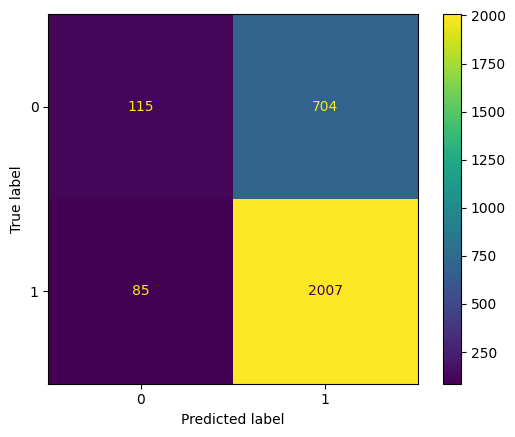

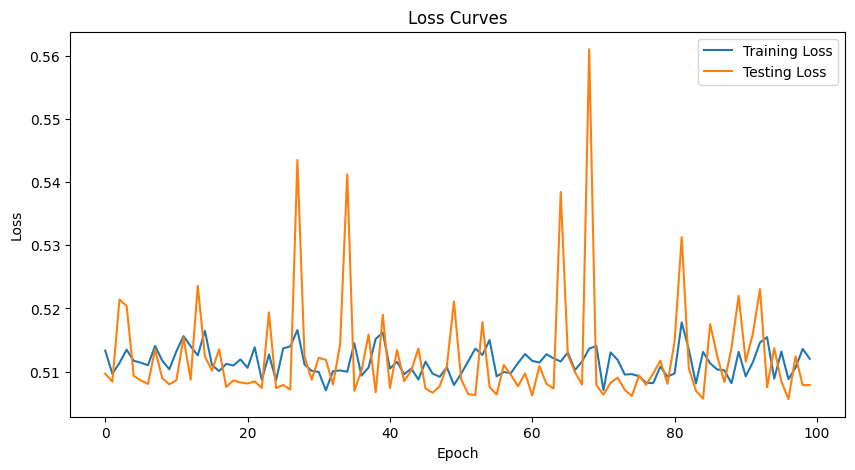

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.511 | Train Acc: 72.80% | Test NLL: 0.502 | Test Acc: 73.65%
Epoch 02 | Train NLL: 0.508 | Train Acc: 72.98% | Test NLL: 0.506 | Test Acc: 73.34%
Epoch 03 | Train NLL: 0.510 | Train Acc: 73.02% | Test NLL: 0.504 | Test Acc: 73.10%
Epoch 04 | Train NLL: 0.509 | Train Acc: 72.88% | Test NLL: 0.509 | Test Acc: 73.48%
Epoch 05 | Train NLL: 0.509 | Train Acc: 72.85% | Test NLL: 0.504 | Test Acc: 73.10%
Epoch 06 | Train NLL: 0.509 | Train Acc: 72.63% | Test NLL: 0.502 | Test Acc: 73.82%
Epoch 07 | Train NLL: 0.507 | Train Acc: 72.81% | Test NLL: 0.500 | Test Acc: 72.93%
Epoch 08 | Train NLL: 0.509 | Train Acc: 72.76% | Test NLL: 0.501 | Test Acc: 73.75%
Epoch 09 | Train NLL: 0.507 | Train Acc: 72.45% | Test NLL: 0.500 | Test Acc: 73.00%
Epoch 10 | Train NLL: 0.508 | Train Acc: 72.93% | Test NLL: 0.500 | Test Acc: 73.41%
Epoch 11 | Train NLL: 0.508 | Train Acc: 72.73% | Test NLL: 0.500

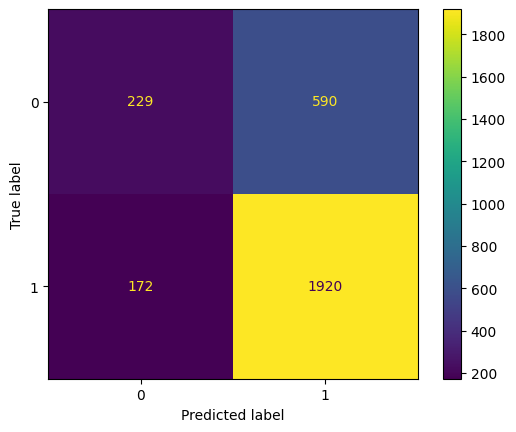

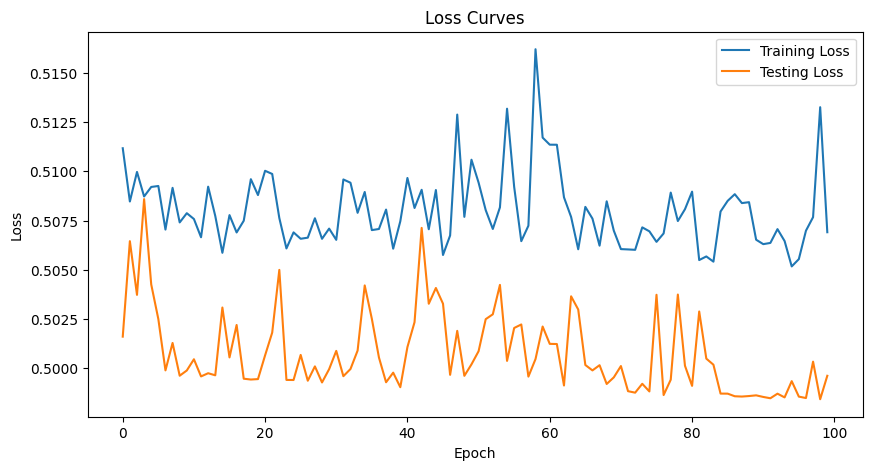

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.513 | Train Acc: 72.88% | Test NLL: 0.522 | Test Acc: 73.14%
Epoch 02 | Train NLL: 0.521 | Train Acc: 73.10% | Test NLL: 0.506 | Test Acc: 73.45%
Epoch 03 | Train NLL: 0.518 | Train Acc: 72.75% | Test NLL: 0.512 | Test Acc: 73.48%
Epoch 04 | Train NLL: 0.525 | Train Acc: 72.13% | Test NLL: 0.588 | Test Acc: 71.93%
Epoch 05 | Train NLL: 0.520 | Train Acc: 72.49% | Test NLL: 0.504 | Test Acc: 73.65%
Epoch 06 | Train NLL: 0.520 | Train Acc: 72.36% | Test NLL: 0.562 | Test Acc: 72.11%
Epoch 07 | Train NLL: 0.529 | Train Acc: 72.48% | Test NLL: 0.529 | Test Acc: 73.07%
Epoch 08 | Train NLL: 0.516 | Train Acc: 72.66% | Test NLL: 0.505 | Test Acc: 73.03%
Epoch 09 | Train NLL: 0.511 | Train Acc: 72.78% | Test NLL: 0.505 | Test Acc: 72.72%
Epoch 10 | Train NLL: 0.517 | Train Acc: 72.78% | Test NLL: 0.514 | Test Acc: 72.93%
Epoch 11 | Train NLL: 0.513 | Train Acc: 72.73% | Test NLL: 0.508 

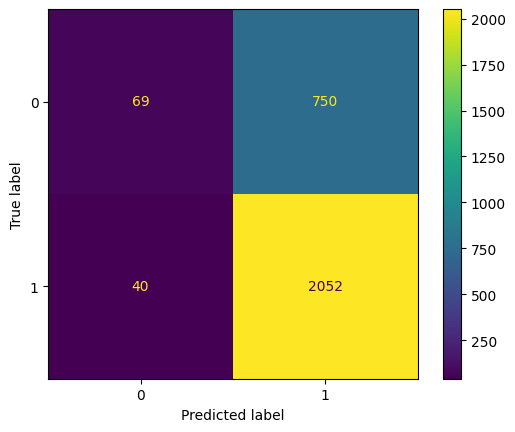

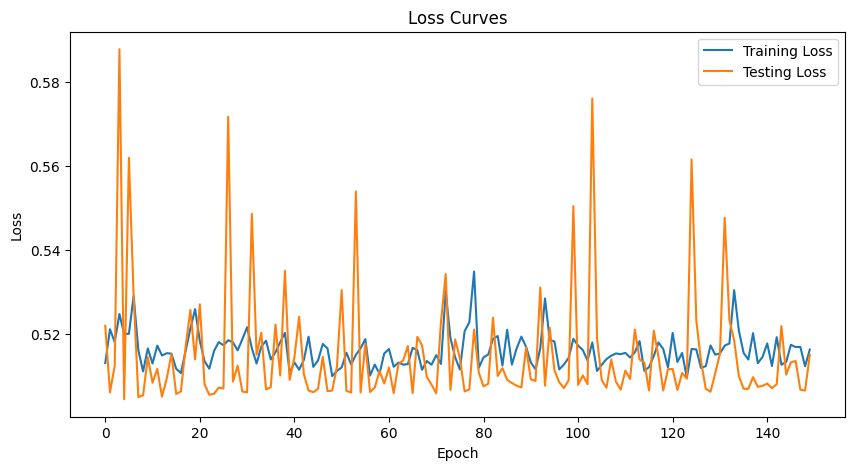

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.513 | Train Acc: 72.61% | Test NLL: 0.544 | Test Acc: 72.79%
Epoch 02 | Train NLL: 0.513 | Train Acc: 72.48% | Test NLL: 0.508 | Test Acc: 73.21%
Epoch 03 | Train NLL: 0.511 | Train Acc: 72.60% | Test NLL: 0.507 | Test Acc: 73.03%
Epoch 04 | Train NLL: 0.510 | Train Acc: 72.56% | Test NLL: 0.509 | Test Acc: 73.21%
Epoch 05 | Train NLL: 0.513 | Train Acc: 72.63% | Test NLL: 0.513 | Test Acc: 72.90%
Epoch 06 | Train NLL: 0.510 | Train Acc: 72.85% | Test NLL: 0.509 | Test Acc: 72.72%
Epoch 07 | Train NLL: 0.510 | Train Acc: 72.76% | Test NLL: 0.510 | Test Acc: 73.31%
Epoch 08 | Train NLL: 0.509 | Train Acc: 72.70% | Test NLL: 0.507 | Test Acc: 72.93%
Epoch 09 | Train NLL: 0.509 | Train Acc: 72.43% | Test NLL: 0.508 | Test Acc: 73.31%
Epoch 10 | Train NLL: 0.509 | Train Acc: 72.43% | Test NLL: 0.507 | Test Acc: 73.27%
Epoch 11 | Train NLL: 0.510 | Train Acc: 72.66% | Test NLL: 0.508

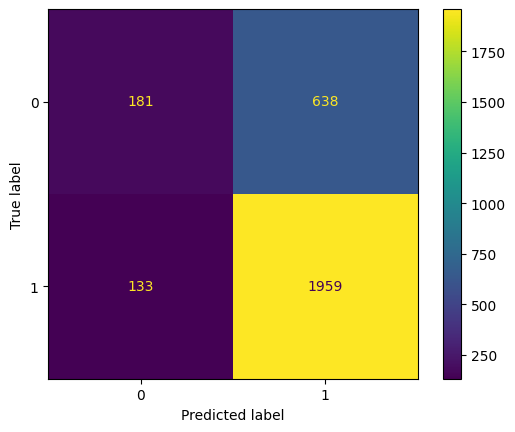

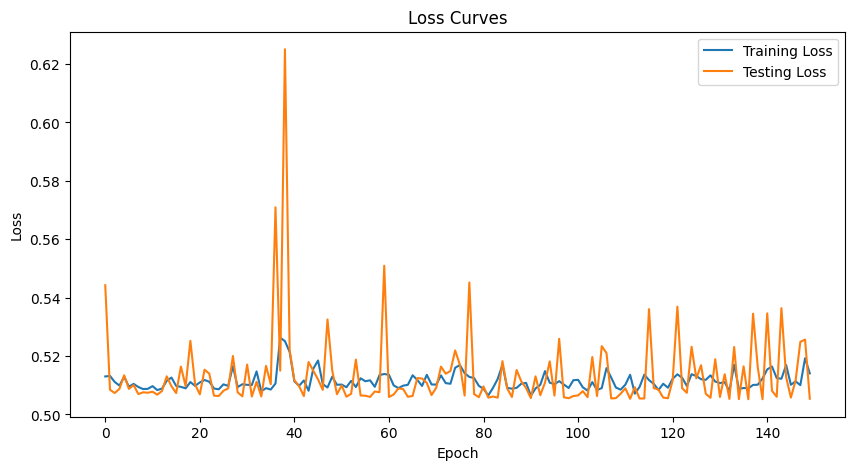

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.509 | Train Acc: 72.55% | Test NLL: 0.500 | Test Acc: 73.38%
Epoch 02 | Train NLL: 0.509 | Train Acc: 72.77% | Test NLL: 0.500 | Test Acc: 72.69%
Epoch 03 | Train NLL: 0.509 | Train Acc: 72.60% | Test NLL: 0.500 | Test Acc: 73.62%
Epoch 04 | Train NLL: 0.511 | Train Acc: 72.57% | Test NLL: 0.500 | Test Acc: 72.69%
Epoch 05 | Train NLL: 0.507 | Train Acc: 72.63% | Test NLL: 0.507 | Test Acc: 73.38%
Epoch 06 | Train NLL: 0.510 | Train Acc: 72.58% | Test NLL: 0.502 | Test Acc: 73.07%
Epoch 07 | Train NLL: 0.507 | Train Acc: 72.61% | Test NLL: 0.503 | Test Acc: 73.72%
Epoch 08 | Train NLL: 0.508 | Train Acc: 73.05% | Test NLL: 0.499 | Test Acc: 73.17%
Epoch 09 | Train NLL: 0.507 | Train Acc: 72.36% | Test NLL: 0.499 | Test Acc: 73.38%
Epoch 10 | Train NLL: 0.507 | Train Acc: 72.55% | Test NLL: 0.500 | Test Acc: 73.69%
Epoch 11 | Train NLL: 0.509 | Train Acc: 72.64% | Test NLL: 0.499

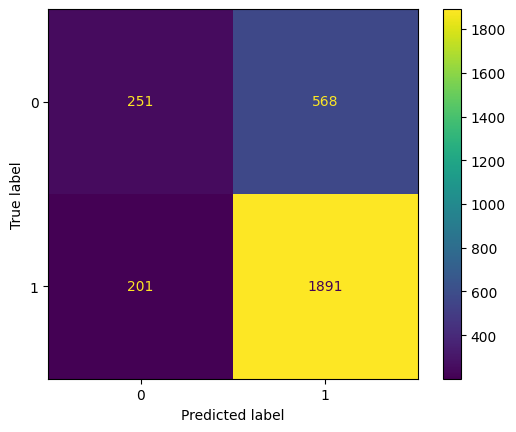

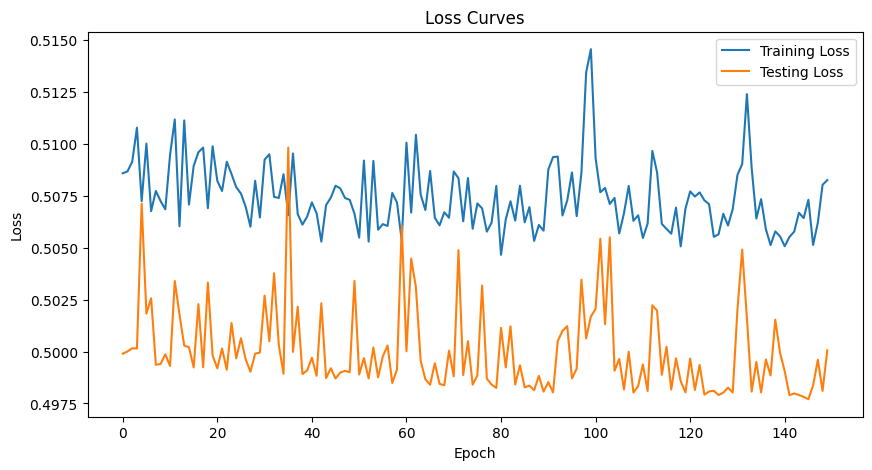

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.513 | Train Acc: 73.27% | Test NLL: 0.504 | Test Acc: 73.17%
Epoch 02 | Train NLL: 0.516 | Train Acc: 72.64% | Test NLL: 0.561 | Test Acc: 71.35%
Epoch 03 | Train NLL: 0.530 | Train Acc: 72.59% | Test NLL: 0.597 | Test Acc: 71.93%
Epoch 04 | Train NLL: 0.528 | Train Acc: 72.53% | Test NLL: 0.504 | Test Acc: 73.24%
Epoch 05 | Train NLL: 0.518 | Train Acc: 72.81% | Test NLL: 0.510 | Test Acc: 73.21%
Epoch 06 | Train NLL: 0.520 | Train Acc: 72.30% | Test NLL: 0.523 | Test Acc: 72.90%
Epoch 07 | Train NLL: 0.517 | Train Acc: 72.60% | Test NLL: 0.507 | Test Acc: 72.93%
Epoch 08 | Train NLL: 0.516 | Train Acc: 72.61% | Test NLL: 0.532 | Test Acc: 73.00%
Epoch 09 | Train NLL: 0.512 | Train Acc: 72.71% | Test NLL: 0.505 | Test Acc: 72.96%
Epoch 10 | Train NLL: 0.519 | Train Acc: 72.51% | Test NLL: 0.507 | Test Acc: 72.93%
Epoch 11 | Train NLL: 0.513 | Train Acc: 72.91% | Test NLL: 0.509 

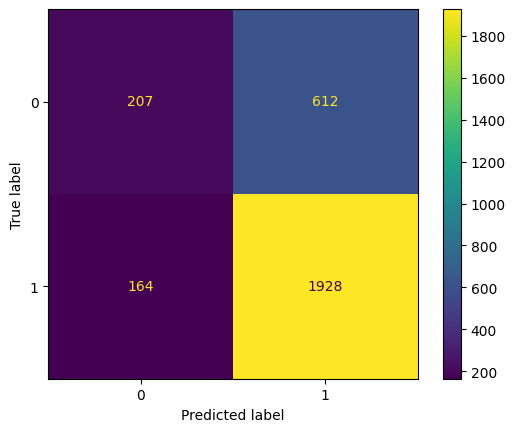

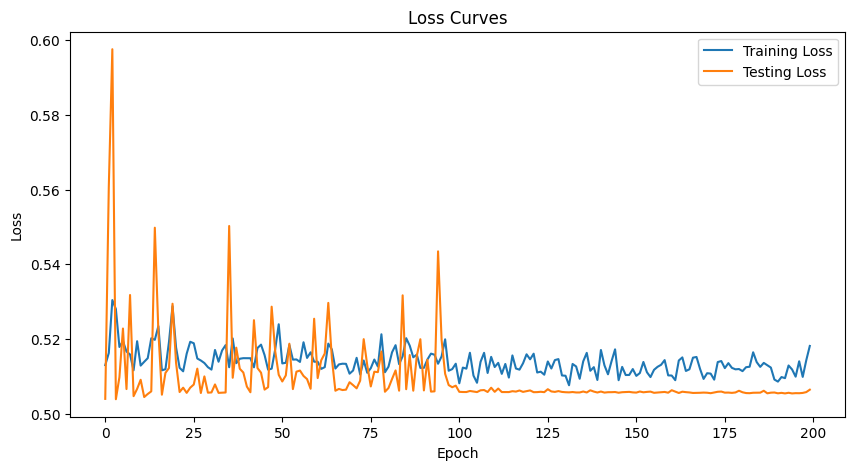

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.508 | Train Acc: 72.87% | Test NLL: 0.508 | Test Acc: 72.66%
Epoch 02 | Train NLL: 0.509 | Train Acc: 72.57% | Test NLL: 0.507 | Test Acc: 73.27%
Epoch 03 | Train NLL: 0.511 | Train Acc: 72.47% | Test NLL: 0.507 | Test Acc: 73.31%
Epoch 04 | Train NLL: 0.508 | Train Acc: 72.56% | Test NLL: 0.507 | Test Acc: 73.41%
Epoch 05 | Train NLL: 0.508 | Train Acc: 72.53% | Test NLL: 0.506 | Test Acc: 73.03%
Epoch 06 | Train NLL: 0.509 | Train Acc: 72.50% | Test NLL: 0.506 | Test Acc: 72.86%
Epoch 07 | Train NLL: 0.508 | Train Acc: 72.76% | Test NLL: 0.506 | Test Acc: 73.24%
Epoch 08 | Train NLL: 0.511 | Train Acc: 72.31% | Test NLL: 0.506 | Test Acc: 73.00%
Epoch 09 | Train NLL: 0.507 | Train Acc: 72.56% | Test NLL: 0.506 | Test Acc: 73.03%
Epoch 10 | Train NLL: 0.508 | Train Acc: 72.78% | Test NLL: 0.506 | Test Acc: 73.00%
Epoch 11 | Train NLL: 0.512 | Train Acc: 72.78% | Test NLL: 0.506

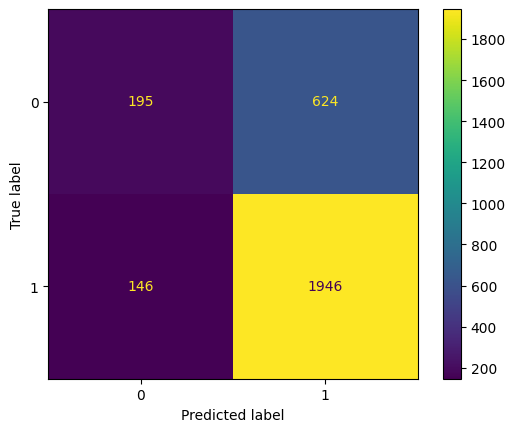

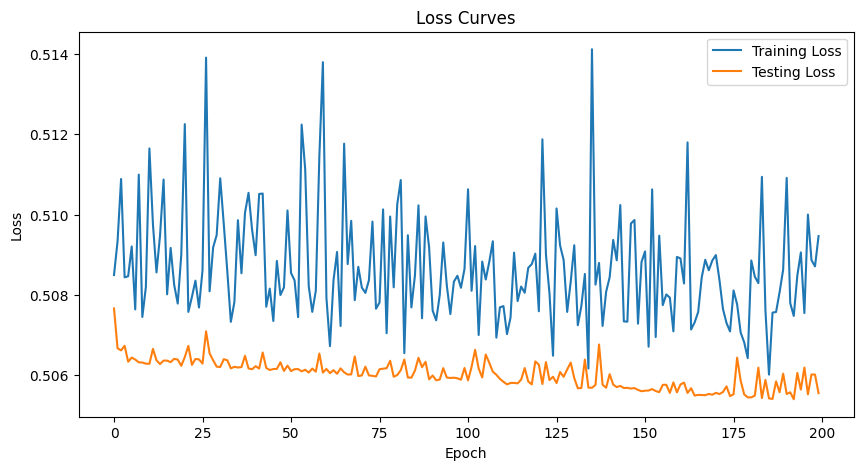

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.507 | Train Acc: 72.61% | Test NLL: 0.500 | Test Acc: 73.79%
Epoch 02 | Train NLL: 0.507 | Train Acc: 72.65% | Test NLL: 0.500 | Test Acc: 73.41%
Epoch 03 | Train NLL: 0.507 | Train Acc: 72.54% | Test NLL: 0.500 | Test Acc: 73.38%
Epoch 04 | Train NLL: 0.507 | Train Acc: 72.73% | Test NLL: 0.499 | Test Acc: 73.17%
Epoch 05 | Train NLL: 0.507 | Train Acc: 72.70% | Test NLL: 0.499 | Test Acc: 73.14%
Epoch 06 | Train NLL: 0.506 | Train Acc: 72.75% | Test NLL: 0.500 | Test Acc: 73.38%
Epoch 07 | Train NLL: 0.507 | Train Acc: 72.52% | Test NLL: 0.499 | Test Acc: 73.31%
Epoch 08 | Train NLL: 0.507 | Train Acc: 72.68% | Test NLL: 0.499 | Test Acc: 73.27%
Epoch 09 | Train NLL: 0.509 | Train Acc: 72.55% | Test NLL: 0.500 | Test Acc: 73.48%
Epoch 10 | Train NLL: 0.507 | Train Acc: 72.61% | Test NLL: 0.499 | Test Acc: 73.21%
Epoch 11 | Train NLL: 0.510 | Train Acc: 72.58% | Test NLL: 0.499

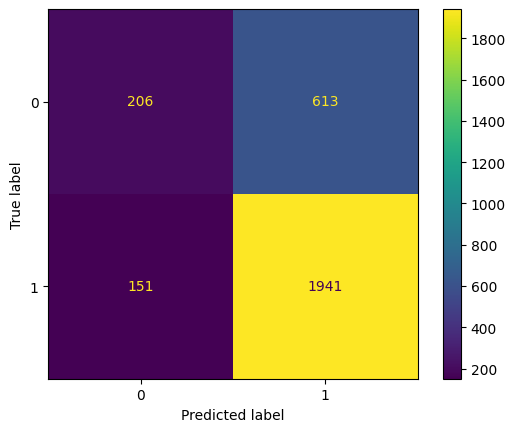

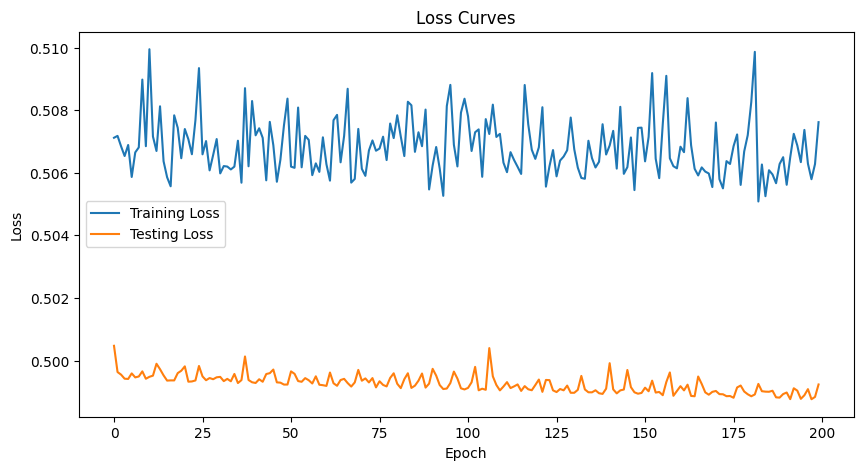

**************************************************



In [19]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=1,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=5,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(10,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(5,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
    (1): InceptionBlock(
      (bottleneck): Conv1dSamePadding(2, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1

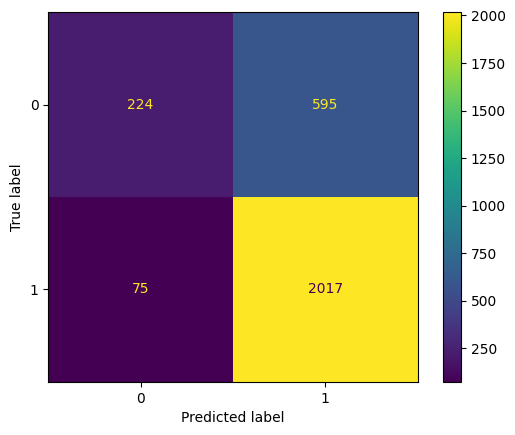

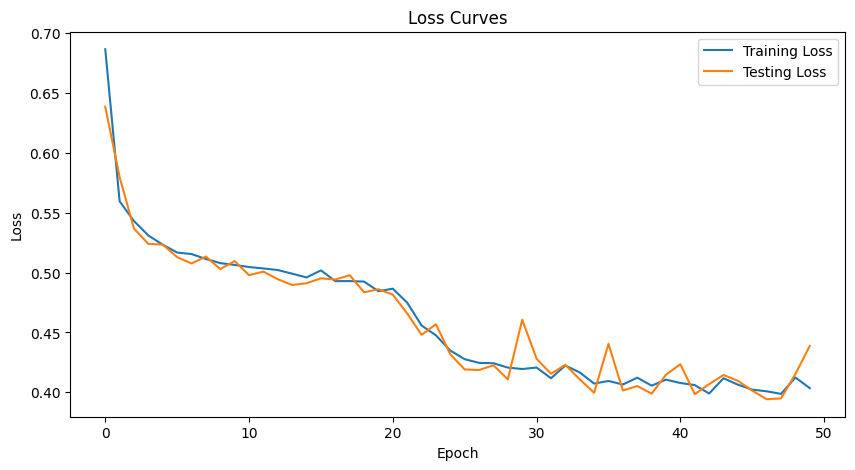

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.401 | Train Acc: 80.46% | Test NLL: 0.397 | Test Acc: 79.84%
Epoch 02 | Train NLL: 0.396 | Train Acc: 80.16% | Test NLL: 0.394 | Test Acc: 80.45%
Epoch 03 | Train NLL: 0.397 | Train Acc: 80.68% | Test NLL: 0.400 | Test Acc: 79.18%
Epoch 04 | Train NLL: 0.391 | Train Acc: 81.00% | Test NLL: 0.401 | Test Acc: 79.77%
Epoch 05 | Train NLL: 0.401 | Train Acc: 80.11% | Test NLL: 0.398 | Test Acc: 80.80%
Epoch 06 | Train NLL: 0.399 | Train Acc: 80.61% | Test NLL: 0.390 | Test Acc: 80.25%
Epoch 07 | Train NLL: 0.403 | Train Acc: 80.22% | Test NLL: 0.396 | Test Acc: 80.18%
Epoch 08 | Train NLL: 0.397 | Train Acc: 80.15% | Test NLL: 0.404 | Test Acc: 79.25%
Epoch 09 | Train NLL: 0.398 | Train Acc: 80.67% | Test NLL: 0.420 | Test Acc: 78.94%
Epoch 10 | Train NLL: 0.397 | Train Acc: 80.74% | Test NLL: 0.388 | Test Acc: 80.14%
Epoch 11 | Train NLL: 0.394 | Train Acc: 80.92% | Test NLL: 0.383 

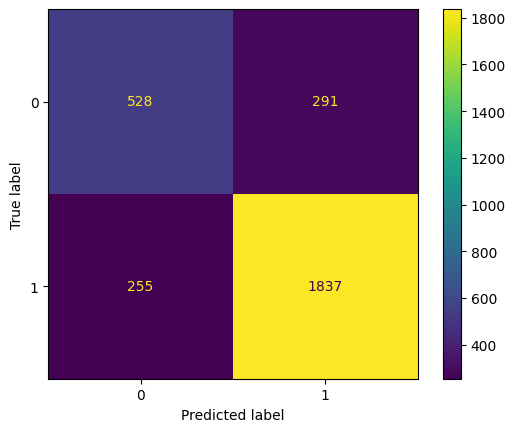

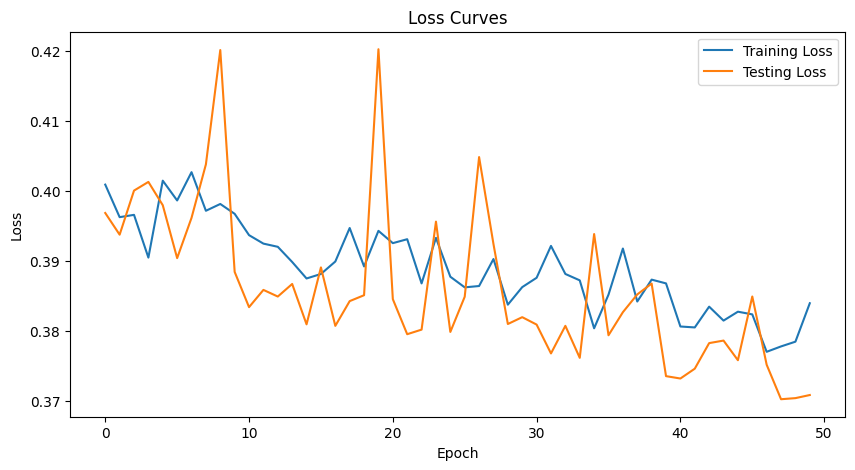

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.378 | Train Acc: 82.10% | Test NLL: 0.364 | Test Acc: 81.42%
Epoch 02 | Train NLL: 0.380 | Train Acc: 82.10% | Test NLL: 0.366 | Test Acc: 81.35%
Epoch 03 | Train NLL: 0.376 | Train Acc: 81.81% | Test NLL: 0.363 | Test Acc: 81.45%
Epoch 04 | Train NLL: 0.377 | Train Acc: 82.19% | Test NLL: 0.373 | Test Acc: 81.42%
Epoch 05 | Train NLL: 0.374 | Train Acc: 82.30% | Test NLL: 0.365 | Test Acc: 81.00%
Epoch 06 | Train NLL: 0.373 | Train Acc: 82.42% | Test NLL: 0.372 | Test Acc: 80.83%
Epoch 07 | Train NLL: 0.378 | Train Acc: 81.66% | Test NLL: 0.364 | Test Acc: 81.59%
Epoch 08 | Train NLL: 0.380 | Train Acc: 82.04% | Test NLL: 0.372 | Test Acc: 81.86%
Epoch 09 | Train NLL: 0.380 | Train Acc: 81.90% | Test NLL: 0.365 | Test Acc: 81.14%
Epoch 10 | Train NLL: 0.376 | Train Acc: 82.30% | Test NLL: 0.381 | Test Acc: 80.11%
Epoch 11 | Train NLL: 0.375 | Train Acc: 82.42% | Test NLL: 0.360 

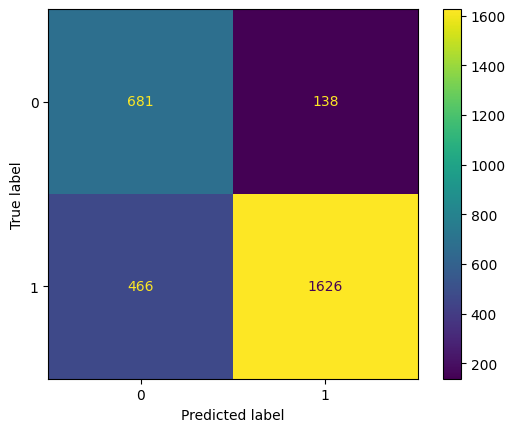

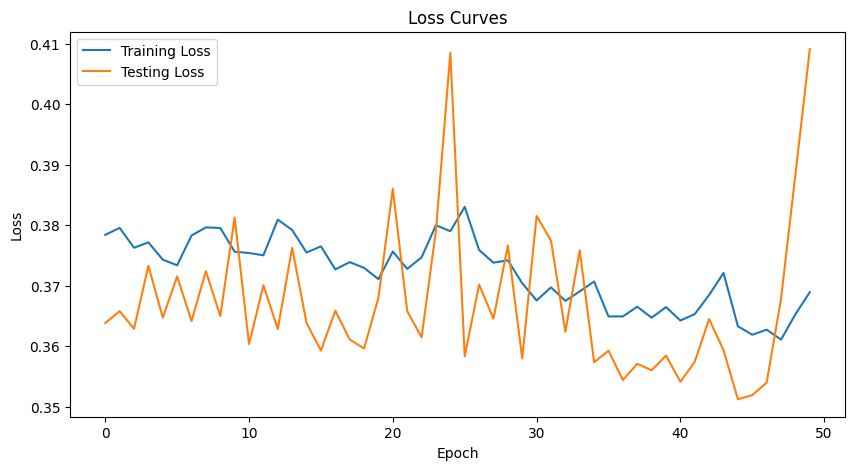

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.377 | Train Acc: 82.16% | Test NLL: 0.428 | Test Acc: 79.05%
Epoch 02 | Train NLL: 0.393 | Train Acc: 81.64% | Test NLL: 0.443 | Test Acc: 77.29%
Epoch 03 | Train NLL: 0.419 | Train Acc: 79.91% | Test NLL: 0.476 | Test Acc: 76.33%
Epoch 04 | Train NLL: 0.380 | Train Acc: 81.53% | Test NLL: 0.368 | Test Acc: 81.11%
Epoch 05 | Train NLL: 0.383 | Train Acc: 81.76% | Test NLL: 0.392 | Test Acc: 80.35%
Epoch 06 | Train NLL: 0.382 | Train Acc: 81.56% | Test NLL: 0.372 | Test Acc: 81.17%
Epoch 07 | Train NLL: 0.370 | Train Acc: 83.09% | Test NLL: 0.382 | Test Acc: 80.97%
Epoch 08 | Train NLL: 0.376 | Train Acc: 82.66% | Test NLL: 0.408 | Test Acc: 79.18%
Epoch 09 | Train NLL: 0.377 | Train Acc: 82.34% | Test NLL: 0.426 | Test Acc: 77.88%
Epoch 10 | Train NLL: 0.390 | Train Acc: 80.78% | Test NLL: 0.406 | Test Acc: 79.18%
Epoch 11 | Train NLL: 0.380 | Train Acc: 82.04% | Test NLL: 0.360 

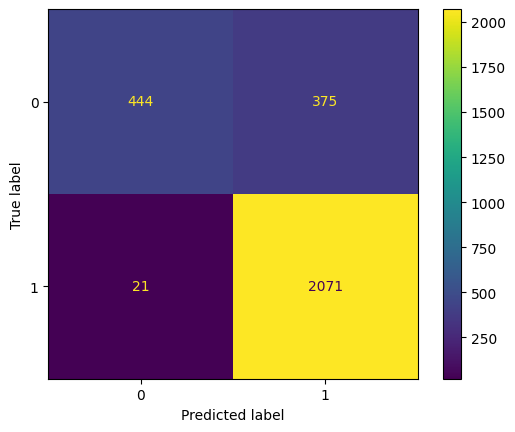

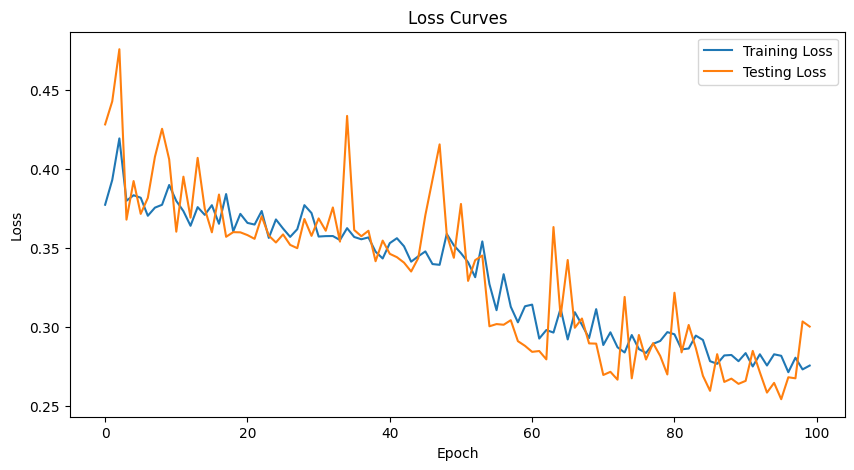

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.268 | Train Acc: 90.16% | Test NLL: 0.253 | Test Acc: 91.00%
Epoch 02 | Train NLL: 0.267 | Train Acc: 90.35% | Test NLL: 0.251 | Test Acc: 91.07%
Epoch 03 | Train NLL: 0.268 | Train Acc: 90.10% | Test NLL: 0.256 | Test Acc: 91.14%
Epoch 04 | Train NLL: 0.266 | Train Acc: 90.13% | Test NLL: 0.256 | Test Acc: 90.62%
Epoch 05 | Train NLL: 0.265 | Train Acc: 90.51% | Test NLL: 0.254 | Test Acc: 90.93%
Epoch 06 | Train NLL: 0.263 | Train Acc: 90.50% | Test NLL: 0.249 | Test Acc: 91.03%
Epoch 07 | Train NLL: 0.264 | Train Acc: 90.38% | Test NLL: 0.249 | Test Acc: 91.34%
Epoch 08 | Train NLL: 0.265 | Train Acc: 90.24% | Test NLL: 0.288 | Test Acc: 87.46%
Epoch 09 | Train NLL: 0.266 | Train Acc: 90.20% | Test NLL: 0.257 | Test Acc: 90.11%
Epoch 10 | Train NLL: 0.265 | Train Acc: 90.07% | Test NLL: 0.303 | Test Acc: 86.29%
Epoch 11 | Train NLL: 0.267 | Train Acc: 89.77% | Test NLL: 0.276

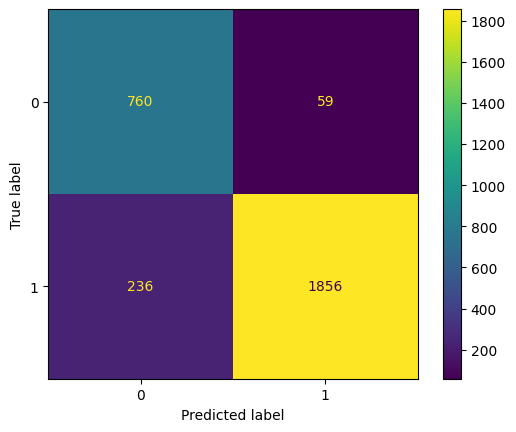

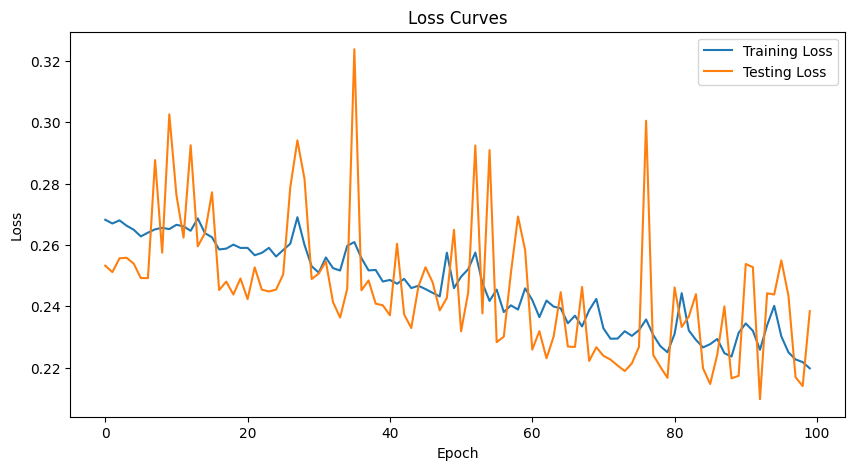

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.222 | Train Acc: 92.24% | Test NLL: 0.200 | Test Acc: 93.54%
Epoch 02 | Train NLL: 0.217 | Train Acc: 92.63% | Test NLL: 0.222 | Test Acc: 91.31%
Epoch 03 | Train NLL: 0.221 | Train Acc: 92.20% | Test NLL: 0.198 | Test Acc: 92.96%
Epoch 04 | Train NLL: 0.219 | Train Acc: 92.31% | Test NLL: 0.203 | Test Acc: 92.27%
Epoch 05 | Train NLL: 0.220 | Train Acc: 92.15% | Test NLL: 0.221 | Test Acc: 90.52%
Epoch 06 | Train NLL: 0.221 | Train Acc: 92.15% | Test NLL: 0.210 | Test Acc: 91.55%
Epoch 07 | Train NLL: 0.218 | Train Acc: 92.49% | Test NLL: 0.220 | Test Acc: 91.38%
Epoch 08 | Train NLL: 0.214 | Train Acc: 92.72% | Test NLL: 0.203 | Test Acc: 93.30%
Epoch 09 | Train NLL: 0.213 | Train Acc: 92.67% | Test NLL: 0.198 | Test Acc: 93.51%
Epoch 10 | Train NLL: 0.211 | Train Acc: 92.93% | Test NLL: 0.198 | Test Acc: 92.72%
Epoch 11 | Train NLL: 0.212 | Train Acc: 92.84% | Test NLL: 0.202

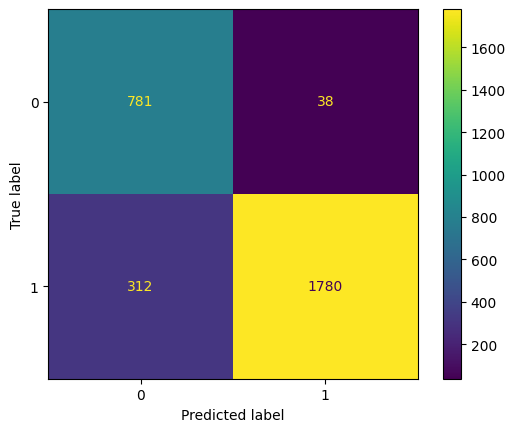

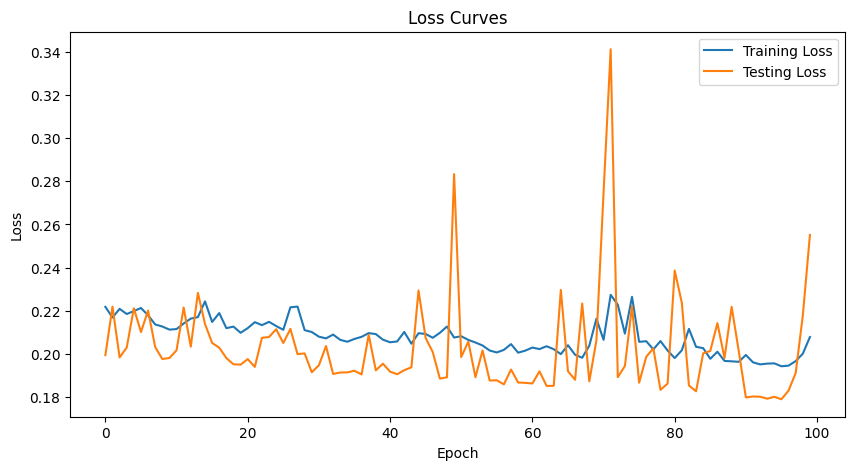

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.209 | Train Acc: 92.43% | Test NLL: 0.316 | Test Acc: 87.05%
Epoch 02 | Train NLL: 0.229 | Train Acc: 90.96% | Test NLL: 0.237 | Test Acc: 90.00%
Epoch 03 | Train NLL: 0.217 | Train Acc: 92.13% | Test NLL: 0.207 | Test Acc: 92.58%
Epoch 04 | Train NLL: 0.218 | Train Acc: 92.11% | Test NLL: 0.266 | Test Acc: 87.87%
Epoch 05 | Train NLL: 0.212 | Train Acc: 92.34% | Test NLL: 0.189 | Test Acc: 93.58%
Epoch 06 | Train NLL: 0.208 | Train Acc: 92.39% | Test NLL: 0.295 | Test Acc: 86.50%
Epoch 07 | Train NLL: 0.211 | Train Acc: 92.33% | Test NLL: 0.201 | Test Acc: 93.44%
Epoch 08 | Train NLL: 0.202 | Train Acc: 92.92% | Test NLL: 0.265 | Test Acc: 87.80%
Epoch 09 | Train NLL: 0.209 | Train Acc: 92.32% | Test NLL: 0.186 | Test Acc: 93.95%
Epoch 10 | Train NLL: 0.208 | Train Acc: 92.79% | Test NLL: 0.188 | Test Acc: 94.16%
Epoch 11 | Train NLL: 0.224 | Train Acc: 91.46% | Test NLL: 0.218 

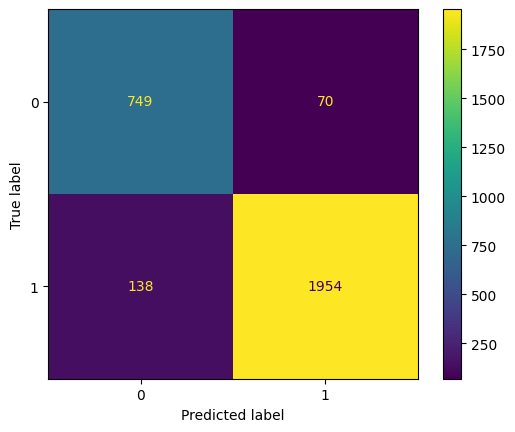

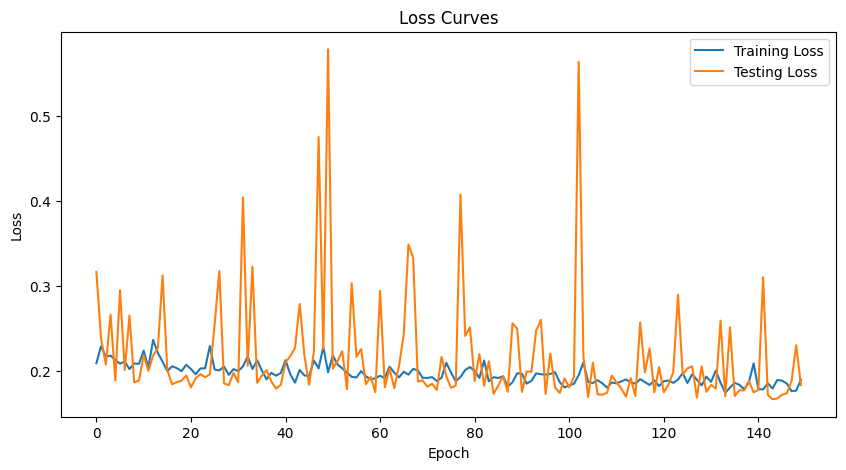

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.182 | Train Acc: 93.45% | Test NLL: 0.169 | Test Acc: 94.19%
Epoch 02 | Train NLL: 0.176 | Train Acc: 93.96% | Test NLL: 0.169 | Test Acc: 94.09%
Epoch 03 | Train NLL: 0.175 | Train Acc: 94.12% | Test NLL: 0.164 | Test Acc: 94.78%
Epoch 04 | Train NLL: 0.173 | Train Acc: 94.12% | Test NLL: 0.169 | Test Acc: 94.68%
Epoch 05 | Train NLL: 0.171 | Train Acc: 94.22% | Test NLL: 0.164 | Test Acc: 94.40%
Epoch 06 | Train NLL: 0.171 | Train Acc: 94.38% | Test NLL: 0.204 | Test Acc: 91.31%
Epoch 07 | Train NLL: 0.169 | Train Acc: 94.42% | Test NLL: 0.167 | Test Acc: 94.09%
Epoch 08 | Train NLL: 0.178 | Train Acc: 93.94% | Test NLL: 0.170 | Test Acc: 94.23%
Epoch 09 | Train NLL: 0.177 | Train Acc: 93.73% | Test NLL: 0.227 | Test Acc: 89.93%
Epoch 10 | Train NLL: 0.179 | Train Acc: 93.90% | Test NLL: 0.200 | Test Acc: 92.27%
Epoch 11 | Train NLL: 0.176 | Train Acc: 93.97% | Test NLL: 0.164

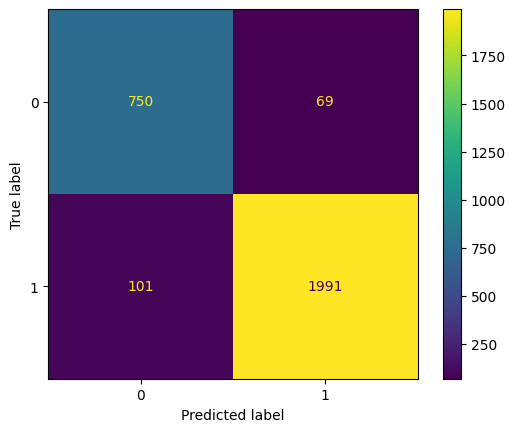

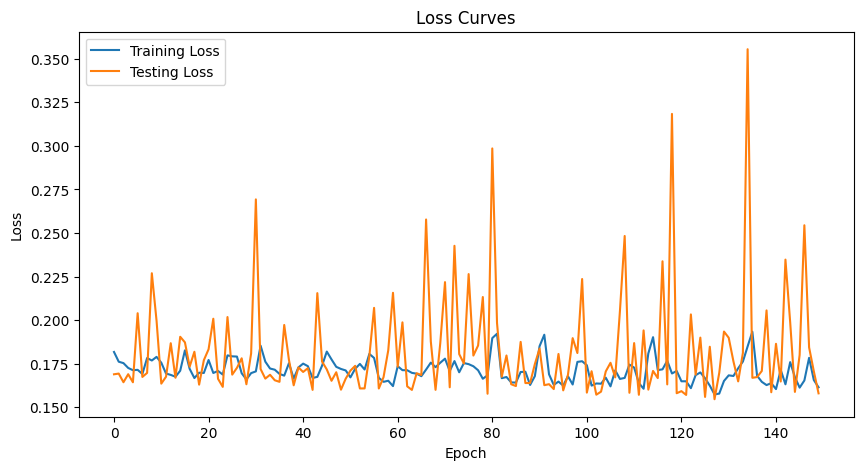

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.156 | Train Acc: 94.97% | Test NLL: 0.147 | Test Acc: 94.68%
Epoch 02 | Train NLL: 0.158 | Train Acc: 94.87% | Test NLL: 0.157 | Test Acc: 94.50%
Epoch 03 | Train NLL: 0.163 | Train Acc: 94.36% | Test NLL: 0.148 | Test Acc: 94.57%
Epoch 04 | Train NLL: 0.161 | Train Acc: 94.55% | Test NLL: 0.150 | Test Acc: 94.43%
Epoch 05 | Train NLL: 0.158 | Train Acc: 94.79% | Test NLL: 0.146 | Test Acc: 94.68%
Epoch 06 | Train NLL: 0.156 | Train Acc: 94.91% | Test NLL: 0.149 | Test Acc: 94.98%
Epoch 07 | Train NLL: 0.157 | Train Acc: 94.94% | Test NLL: 0.158 | Test Acc: 94.50%
Epoch 08 | Train NLL: 0.156 | Train Acc: 95.03% | Test NLL: 0.165 | Test Acc: 93.54%
Epoch 09 | Train NLL: 0.158 | Train Acc: 94.71% | Test NLL: 0.170 | Test Acc: 93.44%
Epoch 10 | Train NLL: 0.162 | Train Acc: 94.78% | Test NLL: 0.147 | Test Acc: 94.81%
Epoch 11 | Train NLL: 0.157 | Train Acc: 94.64% | Test NLL: 0.151

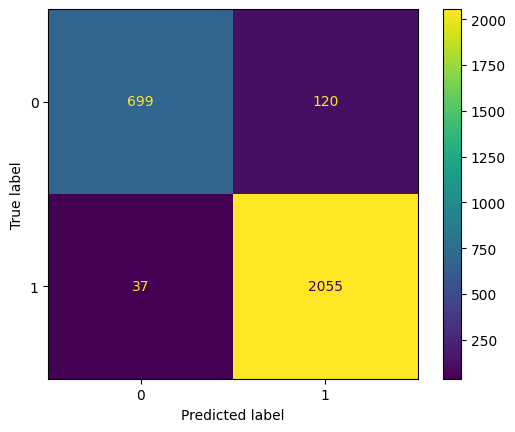

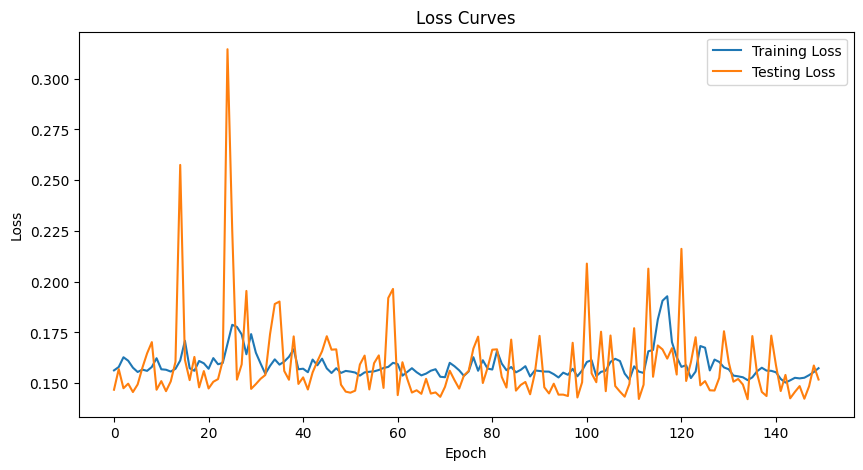

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.164 | Train Acc: 94.26% | Test NLL: 0.599 | Test Acc: 76.78%
Epoch 02 | Train NLL: 0.209 | Train Acc: 92.08% | Test NLL: 0.194 | Test Acc: 91.76%
Epoch 03 | Train NLL: 0.251 | Train Acc: 90.16% | Test NLL: 0.613 | Test Acc: 76.78%
Epoch 04 | Train NLL: 0.218 | Train Acc: 91.61% | Test NLL: 0.173 | Test Acc: 93.34%
Epoch 05 | Train NLL: 0.182 | Train Acc: 93.51% | Test NLL: 0.265 | Test Acc: 88.29%
Epoch 06 | Train NLL: 0.175 | Train Acc: 94.02% | Test NLL: 0.153 | Test Acc: 94.92%
Epoch 07 | Train NLL: 0.165 | Train Acc: 94.54% | Test NLL: 0.161 | Test Acc: 95.09%
Epoch 08 | Train NLL: 0.171 | Train Acc: 94.12% | Test NLL: 0.457 | Test Acc: 80.80%
Epoch 09 | Train NLL: 0.203 | Train Acc: 92.27% | Test NLL: 0.187 | Test Acc: 92.65%
Epoch 10 | Train NLL: 0.196 | Train Acc: 92.70% | Test NLL: 0.167 | Test Acc: 93.85%
Epoch 11 | Train NLL: 0.169 | Train Acc: 94.14% | Test NLL: 0.157 

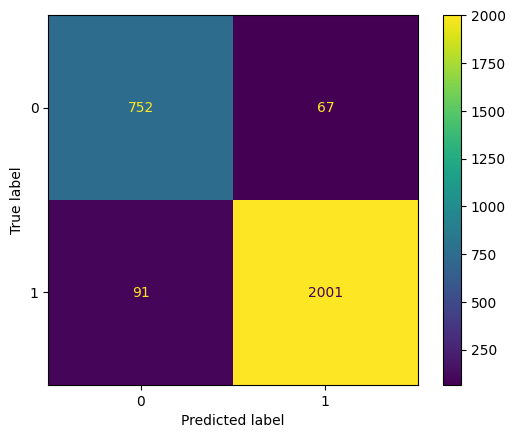

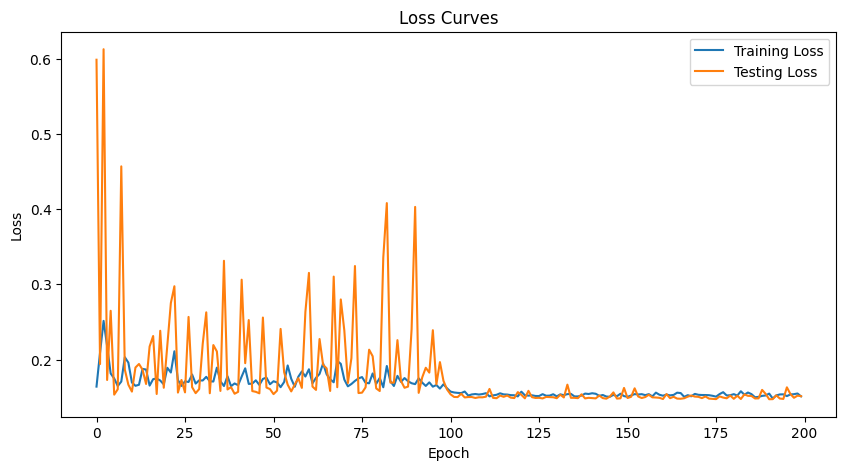

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.150 | Train Acc: 94.93% | Test NLL: 0.162 | Test Acc: 94.43%
Epoch 02 | Train NLL: 0.150 | Train Acc: 95.16% | Test NLL: 0.149 | Test Acc: 94.71%
Epoch 03 | Train NLL: 0.150 | Train Acc: 95.22% | Test NLL: 0.151 | Test Acc: 95.12%
Epoch 04 | Train NLL: 0.149 | Train Acc: 95.34% | Test NLL: 0.154 | Test Acc: 94.37%
Epoch 05 | Train NLL: 0.148 | Train Acc: 95.24% | Test NLL: 0.151 | Test Acc: 95.02%
Epoch 06 | Train NLL: 0.148 | Train Acc: 95.28% | Test NLL: 0.147 | Test Acc: 94.98%
Epoch 07 | Train NLL: 0.149 | Train Acc: 95.22% | Test NLL: 0.148 | Test Acc: 95.02%
Epoch 08 | Train NLL: 0.149 | Train Acc: 95.32% | Test NLL: 0.148 | Test Acc: 94.74%
Epoch 09 | Train NLL: 0.149 | Train Acc: 95.29% | Test NLL: 0.149 | Test Acc: 95.16%
Epoch 10 | Train NLL: 0.149 | Train Acc: 95.31% | Test NLL: 0.147 | Test Acc: 95.02%
Epoch 11 | Train NLL: 0.148 | Train Acc: 95.11% | Test NLL: 0.147

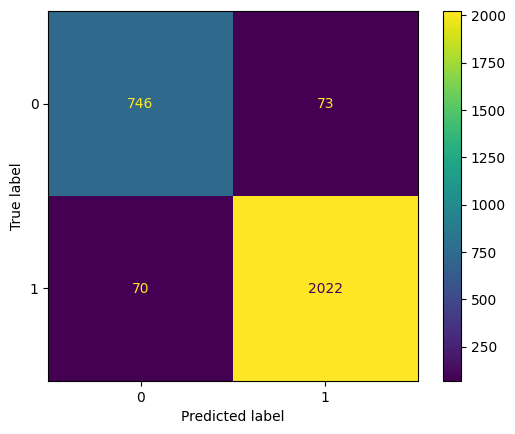

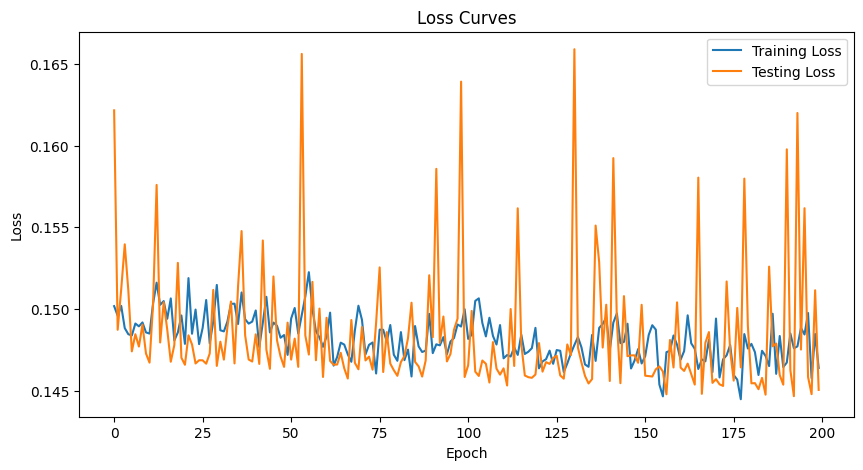

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.146 | Train Acc: 95.35% | Test NLL: 0.138 | Test Acc: 95.05%
Epoch 02 | Train NLL: 0.145 | Train Acc: 95.23% | Test NLL: 0.138 | Test Acc: 95.16%
Epoch 03 | Train NLL: 0.144 | Train Acc: 95.44% | Test NLL: 0.140 | Test Acc: 95.19%
Epoch 04 | Train NLL: 0.145 | Train Acc: 95.46% | Test NLL: 0.139 | Test Acc: 94.98%
Epoch 05 | Train NLL: 0.145 | Train Acc: 95.30% | Test NLL: 0.139 | Test Acc: 95.02%
Epoch 06 | Train NLL: 0.145 | Train Acc: 95.42% | Test NLL: 0.138 | Test Acc: 95.16%
Epoch 07 | Train NLL: 0.144 | Train Acc: 95.44% | Test NLL: 0.138 | Test Acc: 95.16%
Epoch 08 | Train NLL: 0.145 | Train Acc: 95.45% | Test NLL: 0.138 | Test Acc: 95.05%
Epoch 09 | Train NLL: 0.145 | Train Acc: 95.35% | Test NLL: 0.139 | Test Acc: 95.23%
Epoch 10 | Train NLL: 0.145 | Train Acc: 95.48% | Test NLL: 0.139 | Test Acc: 94.95%
Epoch 11 | Train NLL: 0.145 | Train Acc: 95.44% | Test NLL: 0.139

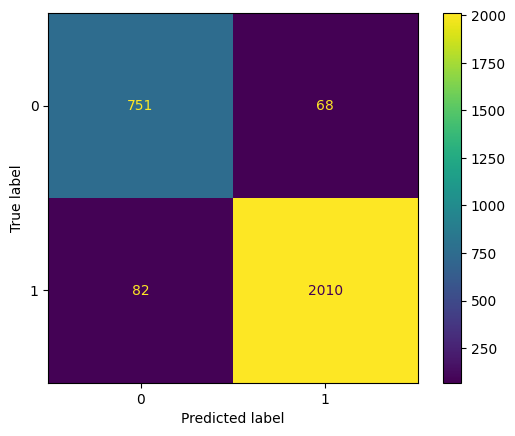

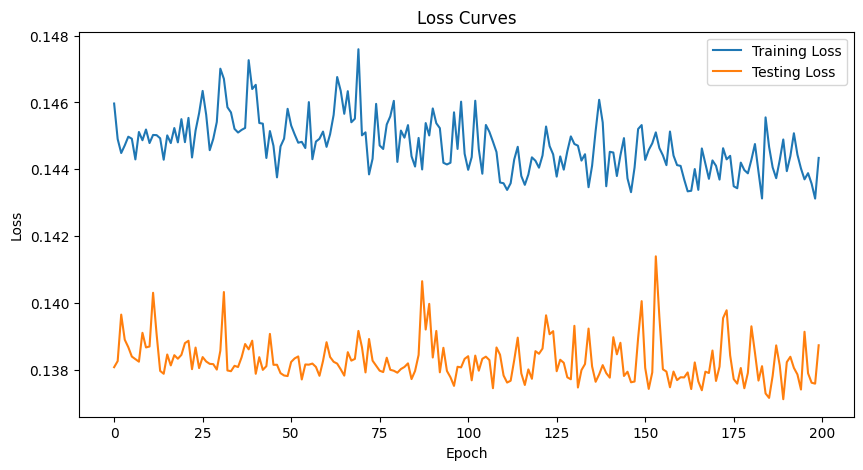

**************************************************



In [20]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=3,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=20,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(10,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(5,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
    (1): InceptionBlock(
      (bottleneck): Conv1dSamePadding(2, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1

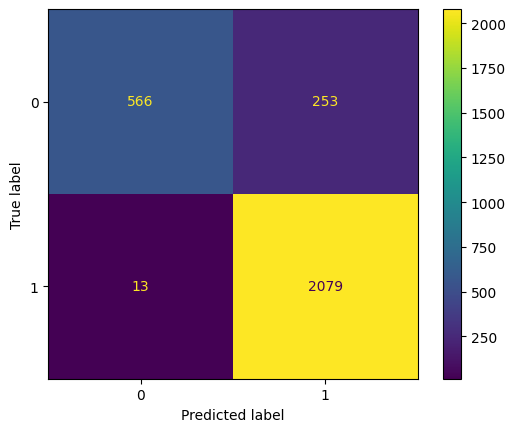

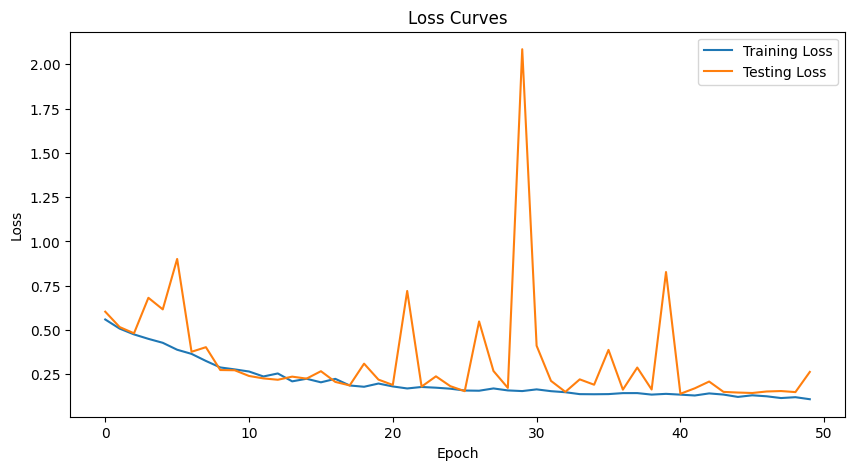

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.110 | Train Acc: 96.31% | Test NLL: 0.131 | Test Acc: 95.43%
Epoch 02 | Train NLL: 0.114 | Train Acc: 95.99% | Test NLL: 0.157 | Test Acc: 94.19%
Epoch 03 | Train NLL: 0.101 | Train Acc: 96.71% | Test NLL: 0.138 | Test Acc: 95.09%
Epoch 04 | Train NLL: 0.095 | Train Acc: 96.89% | Test NLL: 0.161 | Test Acc: 93.47%
Epoch 05 | Train NLL: 0.097 | Train Acc: 96.86% | Test NLL: 0.185 | Test Acc: 93.20%
Epoch 06 | Train NLL: 0.093 | Train Acc: 96.80% | Test NLL: 0.107 | Test Acc: 96.39%
Epoch 07 | Train NLL: 0.090 | Train Acc: 97.01% | Test NLL: 0.151 | Test Acc: 94.50%
Epoch 08 | Train NLL: 0.104 | Train Acc: 96.45% | Test NLL: 0.122 | Test Acc: 95.91%
Epoch 09 | Train NLL: 0.094 | Train Acc: 96.92% | Test NLL: 0.110 | Test Acc: 96.29%
Epoch 10 | Train NLL: 0.087 | Train Acc: 97.15% | Test NLL: 0.116 | Test Acc: 96.05%
Epoch 11 | Train NLL: 0.084 | Train Acc: 97.24% | Test NLL: 0.115 

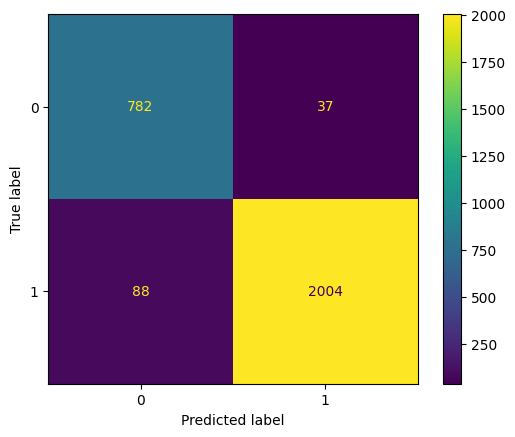

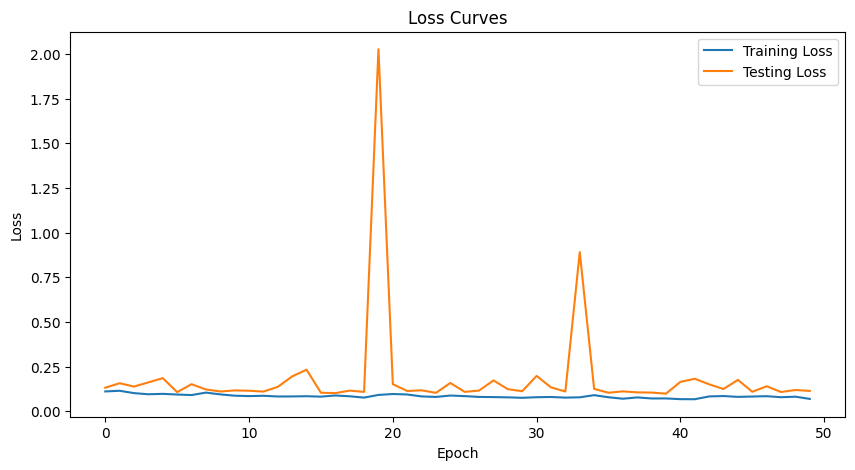

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.064 | Train Acc: 97.89% | Test NLL: 0.169 | Test Acc: 94.57%
Epoch 02 | Train NLL: 0.059 | Train Acc: 97.94% | Test NLL: 0.101 | Test Acc: 96.70%
Epoch 03 | Train NLL: 0.058 | Train Acc: 98.07% | Test NLL: 0.106 | Test Acc: 96.56%
Epoch 04 | Train NLL: 0.059 | Train Acc: 97.89% | Test NLL: 0.129 | Test Acc: 95.74%
Epoch 05 | Train NLL: 0.049 | Train Acc: 98.42% | Test NLL: 0.106 | Test Acc: 96.67%
Epoch 06 | Train NLL: 0.048 | Train Acc: 98.46% | Test NLL: 0.115 | Test Acc: 95.77%
Epoch 07 | Train NLL: 0.050 | Train Acc: 98.23% | Test NLL: 0.121 | Test Acc: 96.39%
Epoch 08 | Train NLL: 0.048 | Train Acc: 98.32% | Test NLL: 0.158 | Test Acc: 94.06%
Epoch 09 | Train NLL: 0.047 | Train Acc: 98.44% | Test NLL: 0.110 | Test Acc: 96.74%
Epoch 10 | Train NLL: 0.048 | Train Acc: 98.32% | Test NLL: 0.098 | Test Acc: 96.32%
Epoch 11 | Train NLL: 0.051 | Train Acc: 98.25% | Test NLL: 0.094 

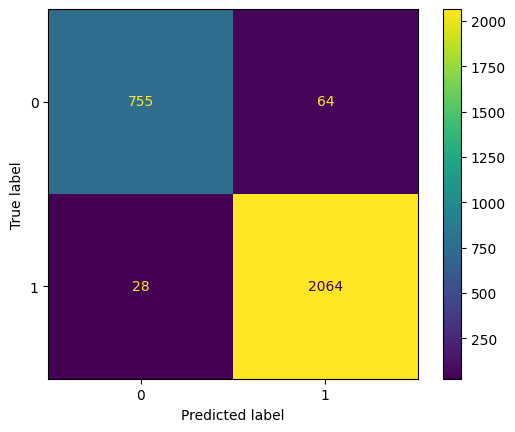

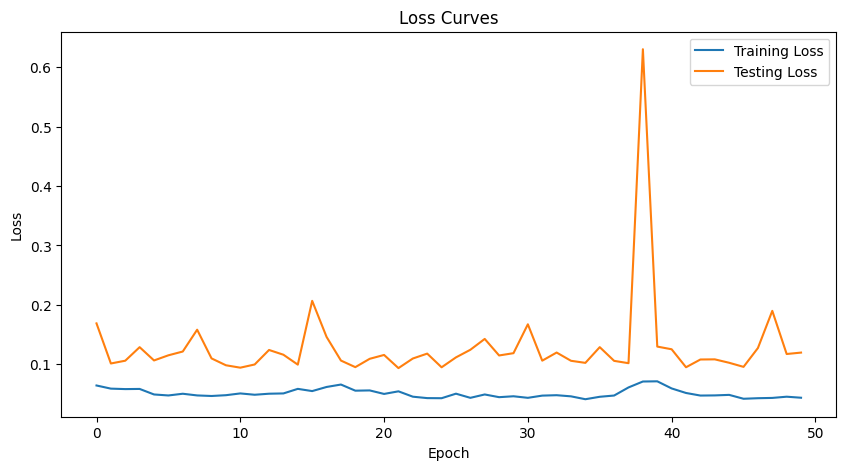

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.090 | Train Acc: 96.73% | Test NLL: 0.120 | Test Acc: 95.71%
Epoch 02 | Train NLL: 0.106 | Train Acc: 96.14% | Test NLL: 0.141 | Test Acc: 95.26%
Epoch 03 | Train NLL: 0.088 | Train Acc: 96.92% | Test NLL: 0.298 | Test Acc: 89.45%
Epoch 04 | Train NLL: 0.103 | Train Acc: 96.33% | Test NLL: 0.159 | Test Acc: 93.27%
Epoch 05 | Train NLL: 0.089 | Train Acc: 96.96% | Test NLL: 0.479 | Test Acc: 82.45%
Epoch 06 | Train NLL: 0.097 | Train Acc: 96.58% | Test NLL: 0.244 | Test Acc: 90.38%
Epoch 07 | Train NLL: 0.097 | Train Acc: 96.55% | Test NLL: 0.111 | Test Acc: 96.26%
Epoch 08 | Train NLL: 0.097 | Train Acc: 96.62% | Test NLL: 0.110 | Test Acc: 96.15%
Epoch 09 | Train NLL: 0.081 | Train Acc: 97.16% | Test NLL: 0.220 | Test Acc: 92.44%
Epoch 10 | Train NLL: 0.086 | Train Acc: 97.02% | Test NLL: 0.143 | Test Acc: 94.50%
Epoch 11 | Train NLL: 0.111 | Train Acc: 96.00% | Test NLL: 0.109 

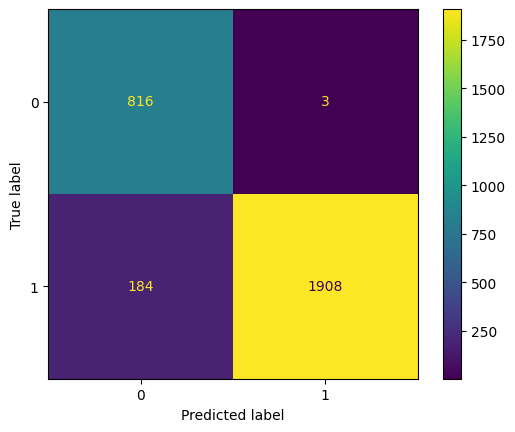

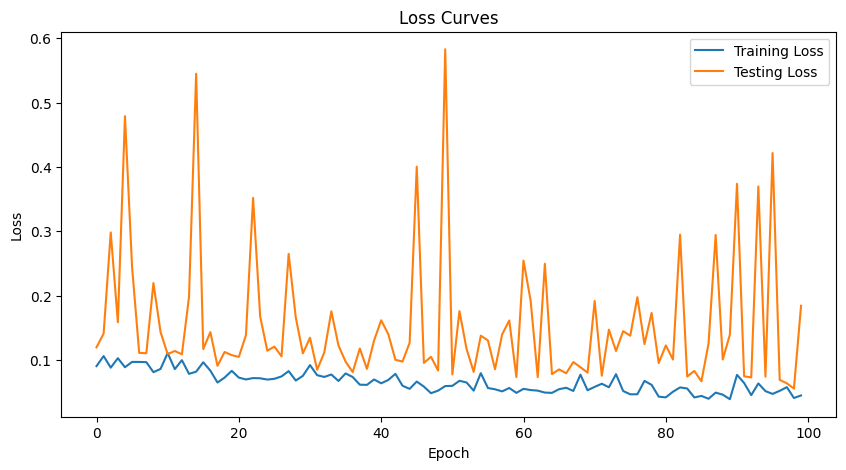

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.040 | Train Acc: 98.52% | Test NLL: 0.094 | Test Acc: 97.39%
Epoch 02 | Train NLL: 0.030 | Train Acc: 98.97% | Test NLL: 0.055 | Test Acc: 98.14%
Epoch 03 | Train NLL: 0.025 | Train Acc: 99.18% | Test NLL: 0.056 | Test Acc: 98.21%
Epoch 04 | Train NLL: 0.026 | Train Acc: 99.05% | Test NLL: 0.098 | Test Acc: 96.77%
Epoch 05 | Train NLL: 0.024 | Train Acc: 99.18% | Test NLL: 0.167 | Test Acc: 95.81%
Epoch 06 | Train NLL: 0.019 | Train Acc: 99.42% | Test NLL: 0.058 | Test Acc: 98.32%
Epoch 07 | Train NLL: 0.020 | Train Acc: 99.28% | Test NLL: 0.093 | Test Acc: 97.90%
Epoch 08 | Train NLL: 0.024 | Train Acc: 99.08% | Test NLL: 0.110 | Test Acc: 96.74%
Epoch 09 | Train NLL: 0.022 | Train Acc: 99.23% | Test NLL: 0.072 | Test Acc: 98.35%
Epoch 10 | Train NLL: 0.018 | Train Acc: 99.30% | Test NLL: 0.108 | Test Acc: 96.67%
Epoch 11 | Train NLL: 0.022 | Train Acc: 99.22% | Test NLL: 0.071

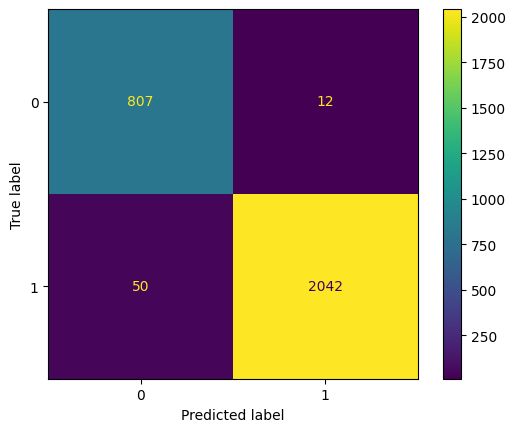

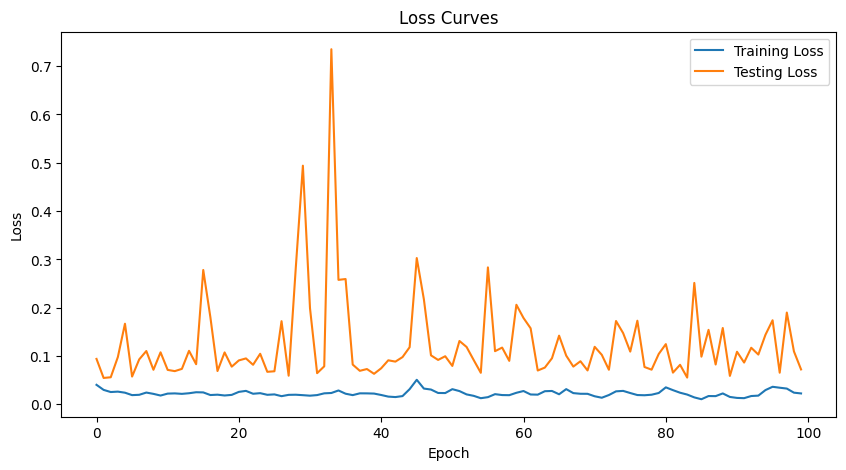

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.015 | Train Acc: 99.49% | Test NLL: 0.097 | Test Acc: 97.29%
Epoch 02 | Train NLL: 0.012 | Train Acc: 99.63% | Test NLL: 0.097 | Test Acc: 97.73%
Epoch 03 | Train NLL: 0.009 | Train Acc: 99.69% | Test NLL: 0.066 | Test Acc: 98.28%
Epoch 04 | Train NLL: 0.008 | Train Acc: 99.72% | Test NLL: 0.068 | Test Acc: 98.49%
Epoch 05 | Train NLL: 0.006 | Train Acc: 99.85% | Test NLL: 0.095 | Test Acc: 97.87%
Epoch 06 | Train NLL: 0.006 | Train Acc: 99.83% | Test NLL: 0.073 | Test Acc: 98.11%
Epoch 07 | Train NLL: 0.006 | Train Acc: 99.79% | Test NLL: 0.073 | Test Acc: 98.28%
Epoch 08 | Train NLL: 0.004 | Train Acc: 99.91% | Test NLL: 0.090 | Test Acc: 98.01%
Epoch 09 | Train NLL: 0.003 | Train Acc: 99.94% | Test NLL: 0.083 | Test Acc: 98.18%
Epoch 10 | Train NLL: 0.003 | Train Acc: 99.97% | Test NLL: 0.084 | Test Acc: 98.39%
Epoch 11 | Train NLL: 0.002 | Train Acc: 99.96% | Test NLL: 0.073

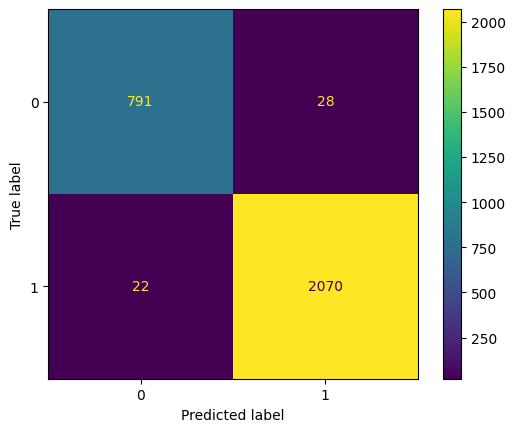

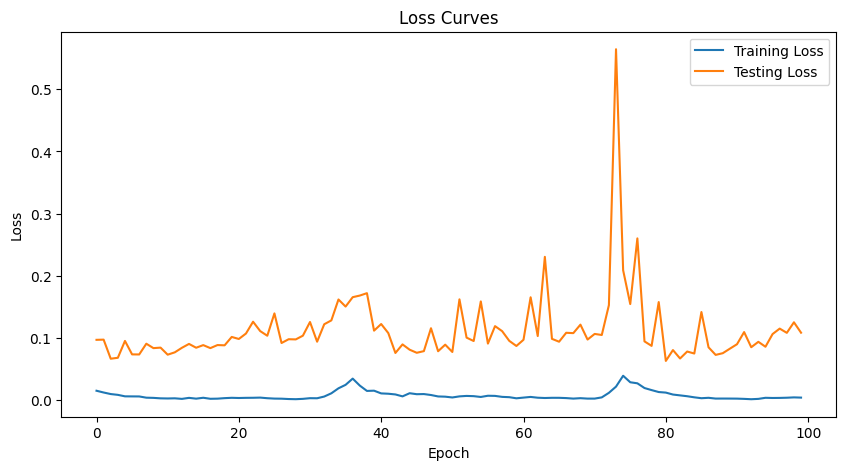

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.110 | Train Acc: 96.67% | Test NLL: 0.330 | Test Acc: 85.23%
Epoch 02 | Train NLL: 0.109 | Train Acc: 96.22% | Test NLL: 0.111 | Test Acc: 96.36%
Epoch 03 | Train NLL: 0.062 | Train Acc: 97.96% | Test NLL: 0.077 | Test Acc: 97.56%
Epoch 04 | Train NLL: 0.095 | Train Acc: 96.49% | Test NLL: 0.632 | Test Acc: 79.73%
Epoch 05 | Train NLL: 0.056 | Train Acc: 98.06% | Test NLL: 0.494 | Test Acc: 85.13%
Epoch 06 | Train NLL: 0.048 | Train Acc: 98.32% | Test NLL: 0.166 | Test Acc: 94.50%
Epoch 07 | Train NLL: 0.039 | Train Acc: 98.63% | Test NLL: 0.123 | Test Acc: 95.98%
Epoch 08 | Train NLL: 0.036 | Train Acc: 98.64% | Test NLL: 0.070 | Test Acc: 97.90%
Epoch 09 | Train NLL: 0.041 | Train Acc: 98.46% | Test NLL: 0.164 | Test Acc: 94.40%
Epoch 10 | Train NLL: 0.059 | Train Acc: 97.71% | Test NLL: 0.104 | Test Acc: 96.36%
Epoch 11 | Train NLL: 0.043 | Train Acc: 98.35% | Test NLL: 0.445 

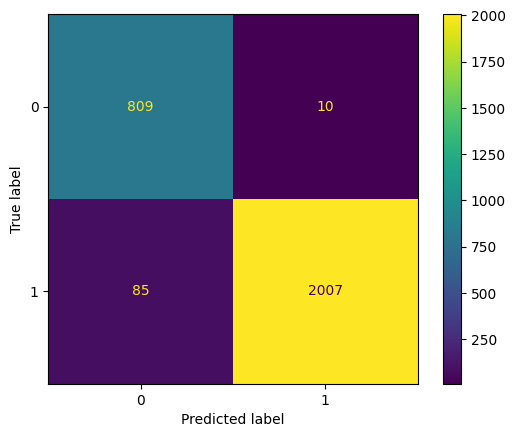

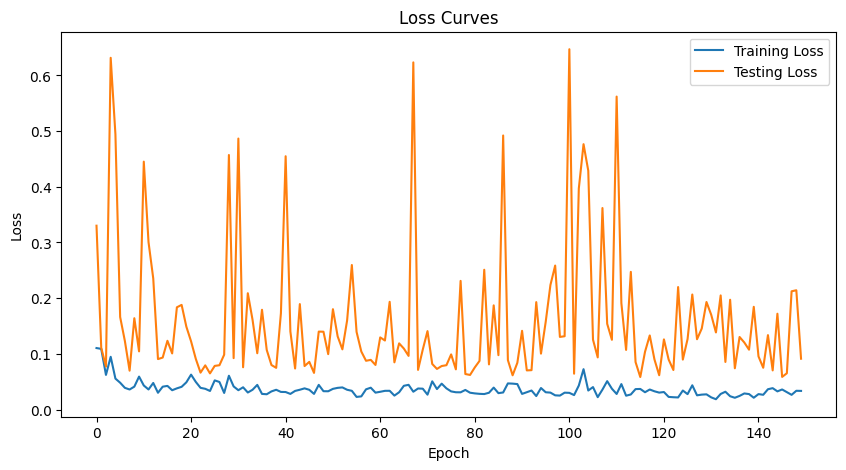

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.027 | Train Acc: 98.99% | Test NLL: 0.189 | Test Acc: 94.50%
Epoch 02 | Train NLL: 0.017 | Train Acc: 99.51% | Test NLL: 0.144 | Test Acc: 95.29%
Epoch 03 | Train NLL: 0.012 | Train Acc: 99.62% | Test NLL: 0.090 | Test Acc: 97.60%
Epoch 04 | Train NLL: 0.007 | Train Acc: 99.79% | Test NLL: 0.119 | Test Acc: 96.53%
Epoch 05 | Train NLL: 0.005 | Train Acc: 99.85% | Test NLL: 0.093 | Test Acc: 97.77%
Epoch 06 | Train NLL: 0.004 | Train Acc: 99.89% | Test NLL: 0.069 | Test Acc: 98.59%
Epoch 07 | Train NLL: 0.004 | Train Acc: 99.85% | Test NLL: 0.071 | Test Acc: 98.49%
Epoch 08 | Train NLL: 0.004 | Train Acc: 99.84% | Test NLL: 0.088 | Test Acc: 98.08%
Epoch 09 | Train NLL: 0.006 | Train Acc: 99.77% | Test NLL: 0.089 | Test Acc: 98.28%
Epoch 10 | Train NLL: 0.007 | Train Acc: 99.76% | Test NLL: 0.103 | Test Acc: 97.90%
Epoch 11 | Train NLL: 0.017 | Train Acc: 99.35% | Test NLL: 0.487

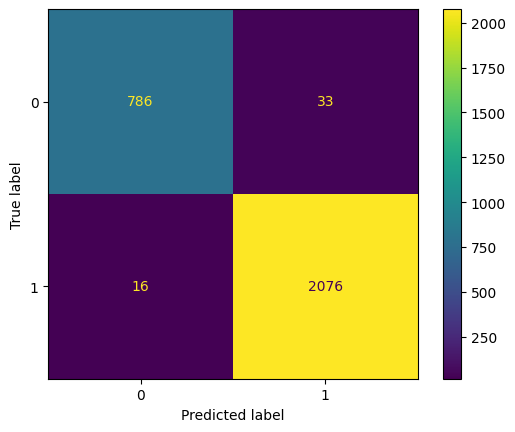

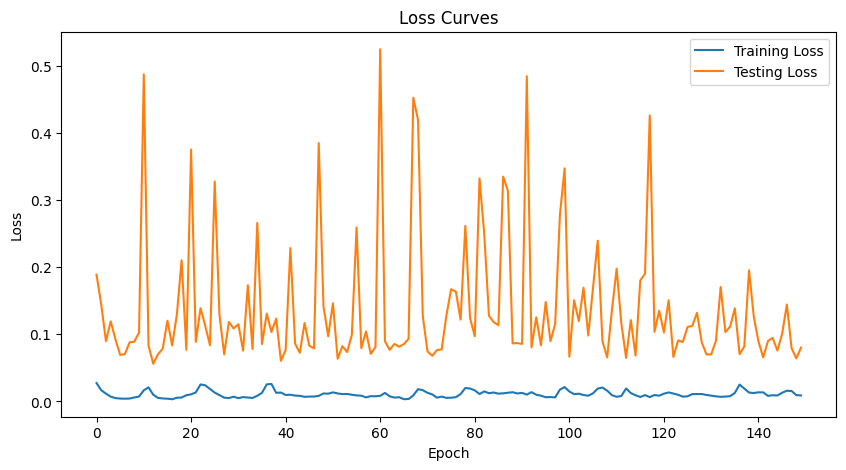

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.005 | Train Acc: 99.88% | Test NLL: 0.080 | Test Acc: 98.42%
Epoch 02 | Train NLL: 0.004 | Train Acc: 99.84% | Test NLL: 0.092 | Test Acc: 98.08%
Epoch 03 | Train NLL: 0.002 | Train Acc: 99.92% | Test NLL: 0.101 | Test Acc: 98.08%
Epoch 04 | Train NLL: 0.003 | Train Acc: 99.92% | Test NLL: 0.067 | Test Acc: 98.52%
Epoch 05 | Train NLL: 0.002 | Train Acc: 99.98% | Test NLL: 0.079 | Test Acc: 98.90%
Epoch 06 | Train NLL: 0.001 | Train Acc: 99.98% | Test NLL: 0.088 | Test Acc: 98.76%
Epoch 07 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.100 | Test Acc: 98.35%
Epoch 08 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.090 | Test Acc: 98.49%
Epoch 09 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.090 | Test Acc: 98.66%
Epoch 10 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.093 | Test Acc: 98.69%
Epoch 11 | Train NLL: 0.000 | Train Acc: 99.99% | Test NLL: 0

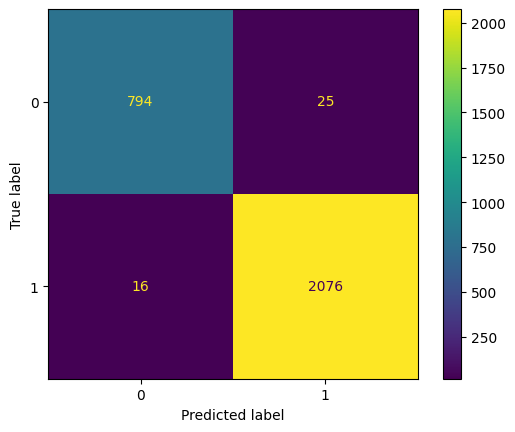

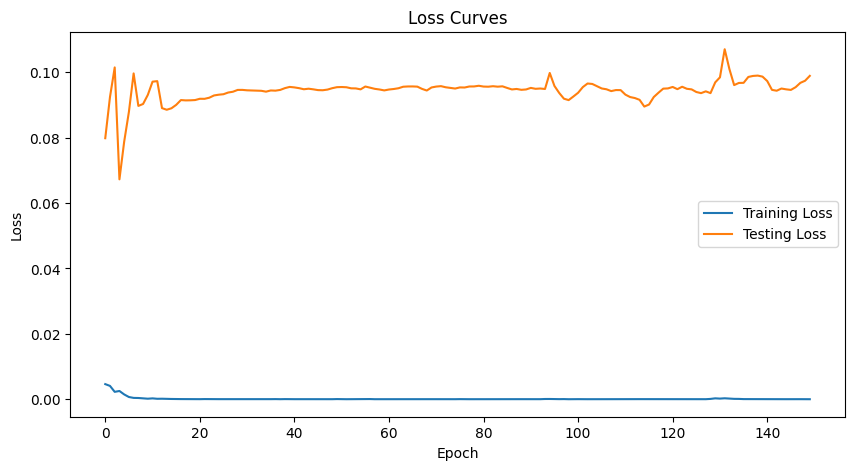

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.002 | Train Acc: 99.96% | Test NLL: 1.165 | Test Acc: 88.22%
Epoch 02 | Train NLL: 0.387 | Train Acc: 87.31% | Test NLL: 0.335 | Test Acc: 89.76%
Epoch 03 | Train NLL: 0.266 | Train Acc: 89.85% | Test NLL: 0.244 | Test Acc: 90.14%
Epoch 04 | Train NLL: 0.202 | Train Acc: 92.51% | Test NLL: 0.184 | Test Acc: 94.02%
Epoch 05 | Train NLL: 0.165 | Train Acc: 94.06% | Test NLL: 0.169 | Test Acc: 94.26%
Epoch 06 | Train NLL: 0.143 | Train Acc: 95.04% | Test NLL: 0.161 | Test Acc: 94.06%
Epoch 07 | Train NLL: 0.125 | Train Acc: 95.36% | Test NLL: 0.135 | Test Acc: 95.50%
Epoch 08 | Train NLL: 0.110 | Train Acc: 96.01% | Test NLL: 0.160 | Test Acc: 94.54%
Epoch 09 | Train NLL: 0.108 | Train Acc: 96.09% | Test NLL: 0.132 | Test Acc: 94.95%
Epoch 10 | Train NLL: 0.101 | Train Acc: 96.19% | Test NLL: 0.104 | Test Acc: 96.53%
Epoch 11 | Train NLL: 0.096 | Train Acc: 96.40% | Test NLL: 0.131 

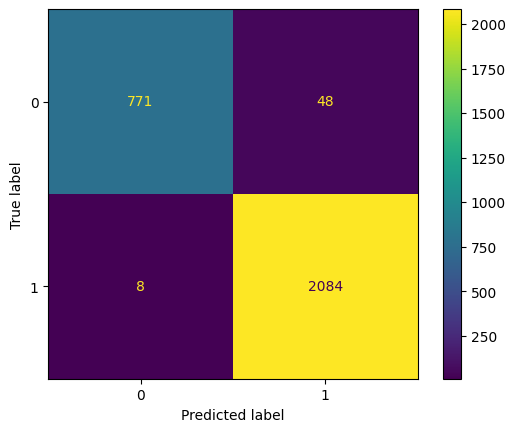

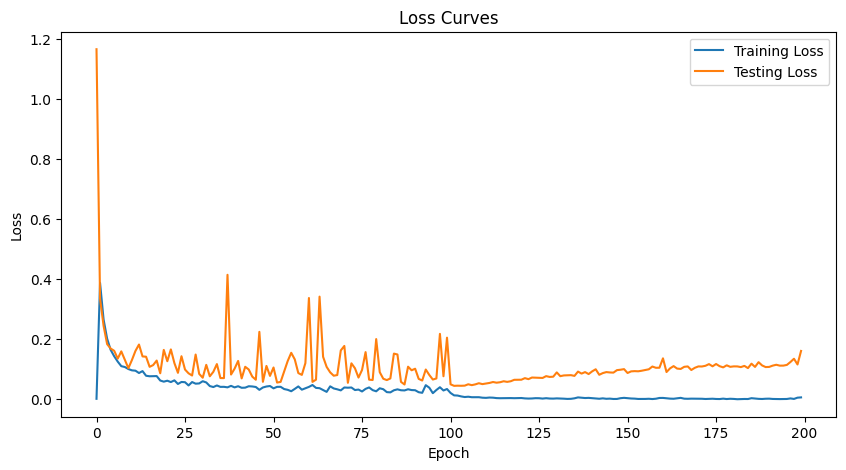

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.003 | Train Acc: 99.91% | Test NLL: 0.119 | Test Acc: 98.59%
Epoch 02 | Train NLL: 0.002 | Train Acc: 99.92% | Test NLL: 0.105 | Test Acc: 98.49%
Epoch 03 | Train NLL: 0.001 | Train Acc: 99.98% | Test NLL: 0.105 | Test Acc: 98.59%
Epoch 04 | Train NLL: 0.001 | Train Acc: 99.97% | Test NLL: 0.104 | Test Acc: 98.59%
Epoch 05 | Train NLL: 0.001 | Train Acc: 99.98% | Test NLL: 0.104 | Test Acc: 98.52%
Epoch 06 | Train NLL: 0.001 | Train Acc: 99.99% | Test NLL: 0.105 | Test Acc: 98.63%
Epoch 07 | Train NLL: 0.000 | Train Acc: 99.99% | Test NLL: 0.104 | Test Acc: 98.59%
Epoch 08 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.107 | Test Acc: 98.59%
Epoch 09 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.109 | Test Acc: 98.56%
Epoch 10 | Train NLL: 0.000 | Train Acc: 99.99% | Test NLL: 0.111 | Test Acc: 98.56%
Epoch 11 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.

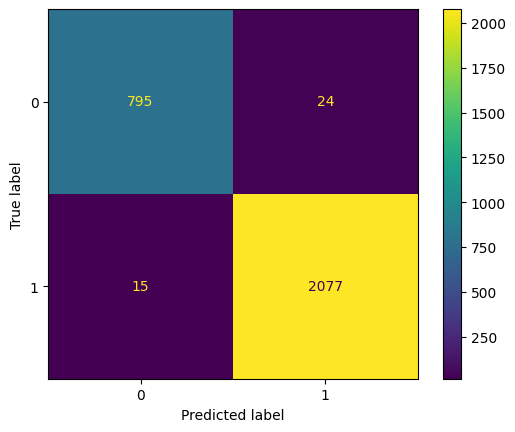

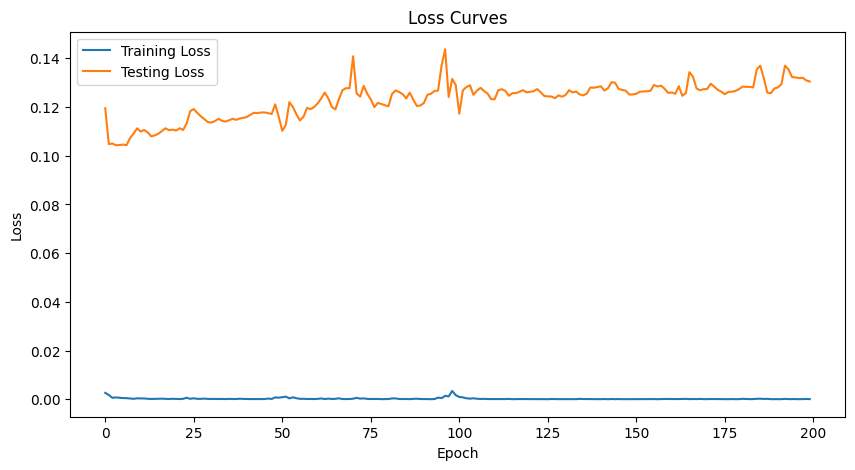

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.129 | Test Acc: 98.59%
Epoch 02 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.129 | Test Acc: 98.63%
Epoch 03 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.129 | Test Acc: 98.66%
Epoch 04 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 05 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 06 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 07 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 08 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 09 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.66%
Epoch 10 | Train NLL: 0.000 | Train Acc: 100.00% | Test NLL: 0.128 | Test Acc: 98.69%
Epoch 11 | Train NLL: 0.000 | Train Acc: 100.00% | Test

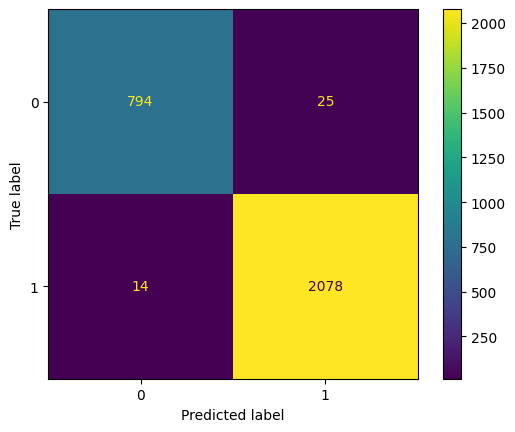

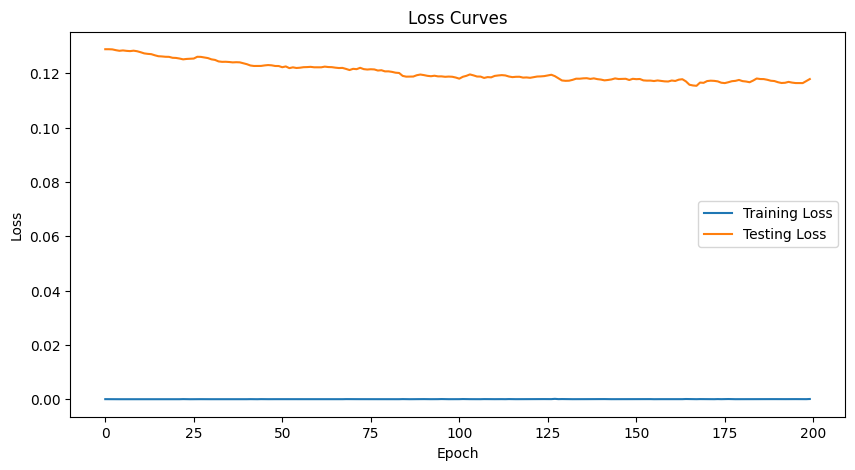

**************************************************



In [ ]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = InceptionModel(
    num_blocks=10,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=20,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

InceptionModel(
  (blocks): Sequential(
    (0): InceptionBlock(
      (bottleneck): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1,), bias=False)
        (1): Conv1dSamePadding(2, 2, kernel_size=(10,), stride=(1,), bias=False)
        (2): Conv1dSamePadding(2, 2, kernel_size=(5,), stride=(1,), bias=False)
      )
      (batchnorm): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 2, kernel_size=(1,), stride=(1,), bias=False)
        (1): BatchNorm1d(2, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU()
      )
    )
    (1): InceptionBlock(
      (bottleneck): Conv1dSamePadding(2, 2, kernel_size=(1,), stride=(1,), bias=False)
      (conv_layers): Sequential(
        (0): Conv1dSamePadding(2, 2, kernel_size=(20,), stride=(1

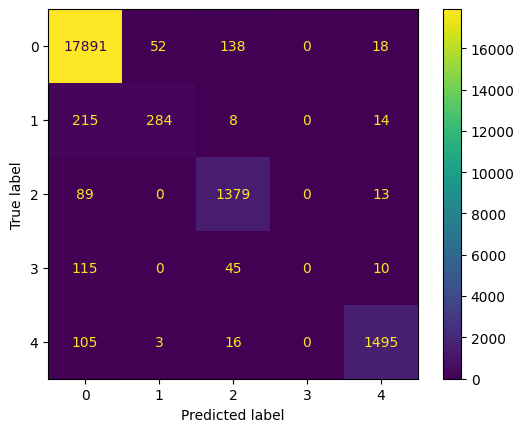

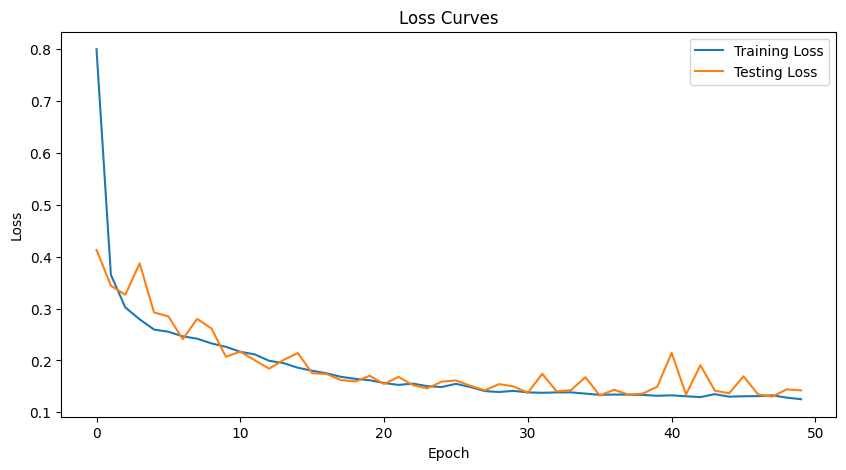

**************************************************

EPOCH : 50 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.118 | Train Acc: 96.74% | Test NLL: 0.122 | Test Acc: 96.60%
Epoch 02 | Train NLL: 0.114 | Train Acc: 96.78% | Test NLL: 0.116 | Test Acc: 96.77%
Epoch 03 | Train NLL: 0.116 | Train Acc: 96.76% | Test NLL: 0.127 | Test Acc: 96.46%
Epoch 04 | Train NLL: 0.116 | Train Acc: 96.77% | Test NLL: 0.121 | Test Acc: 96.56%
Epoch 05 | Train NLL: 0.117 | Train Acc: 96.71% | Test NLL: 0.123 | Test Acc: 96.48%
Epoch 06 | Train NLL: 0.115 | Train Acc: 96.76% | Test NLL: 0.121 | Test Acc: 96.60%
Epoch 07 | Train NLL: 0.114 | Train Acc: 96.79% | Test NLL: 0.114 | Test Acc: 96.77%
Epoch 08 | Train NLL: 0.114 | Train Acc: 96.78% | Test NLL: 0.123 | Test Acc: 96.59%
Epoch 09 | Train NLL: 0.116 | Train Acc: 96.76% | Test NLL: 0.117 | Test Acc: 96.78%
Epoch 10 | Train NLL: 0.117 | Train Acc: 96.72% | Test NLL: 0.126 | Test Acc: 96.42%
Epoch 11 | Train NLL: 0.115 | Train Acc: 96.73% | Test NLL: 0.121 

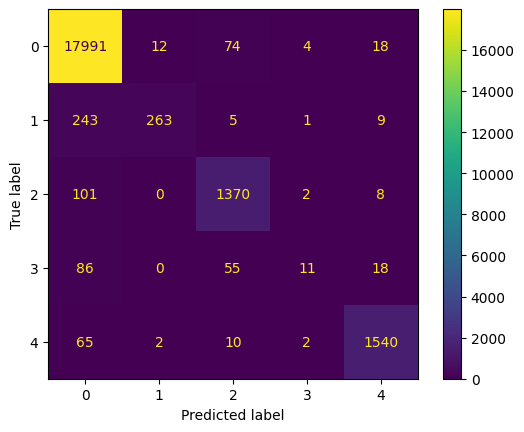

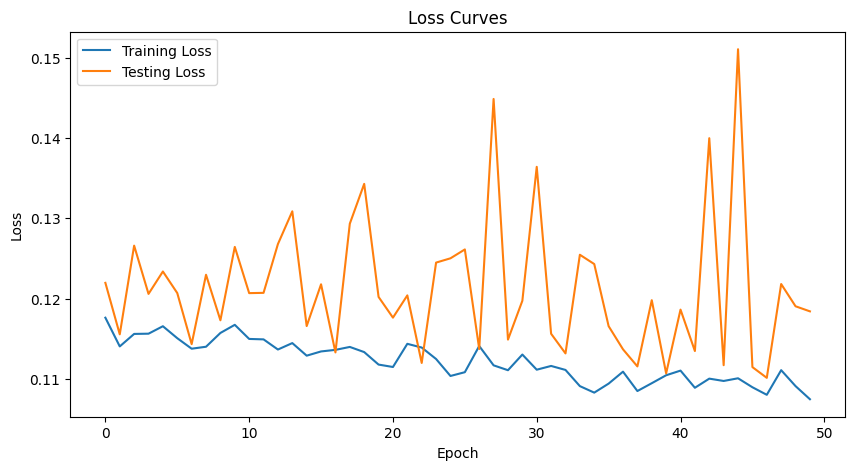

**************************************************

EPOCH : 50 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.100 | Train Acc: 97.16% | Test NLL: 0.106 | Test Acc: 97.03%
Epoch 02 | Train NLL: 0.098 | Train Acc: 97.19% | Test NLL: 0.106 | Test Acc: 96.96%
Epoch 03 | Train NLL: 0.098 | Train Acc: 97.18% | Test NLL: 0.106 | Test Acc: 97.02%
Epoch 04 | Train NLL: 0.099 | Train Acc: 97.19% | Test NLL: 0.107 | Test Acc: 97.01%
Epoch 05 | Train NLL: 0.098 | Train Acc: 97.21% | Test NLL: 0.105 | Test Acc: 97.00%
Epoch 06 | Train NLL: 0.099 | Train Acc: 97.20% | Test NLL: 0.107 | Test Acc: 96.99%
Epoch 07 | Train NLL: 0.098 | Train Acc: 97.19% | Test NLL: 0.118 | Test Acc: 96.88%
Epoch 08 | Train NLL: 0.100 | Train Acc: 97.14% | Test NLL: 0.112 | Test Acc: 96.98%
Epoch 09 | Train NLL: 0.100 | Train Acc: 97.17% | Test NLL: 0.114 | Test Acc: 96.93%
Epoch 10 | Train NLL: 0.099 | Train Acc: 97.21% | Test NLL: 0.119 | Test Acc: 96.63%
Epoch 11 | Train NLL: 0.103 | Train Acc: 97.08% | Test NLL: 0.106 

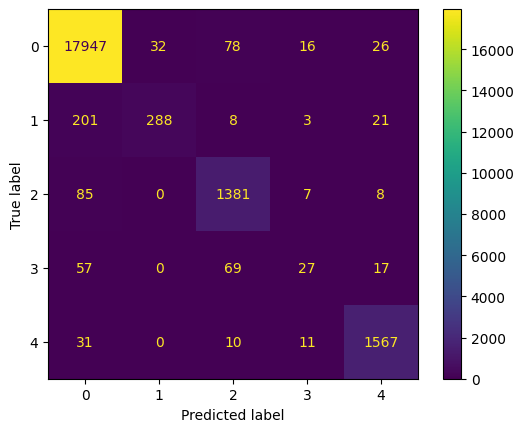

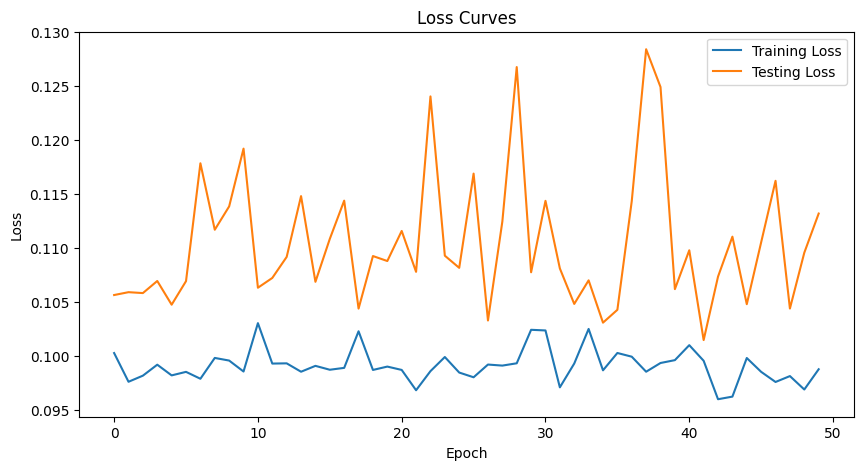

**************************************************

EPOCH : 100 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.130 | Train Acc: 96.36% | Test NLL: 0.139 | Test Acc: 96.24%
Epoch 02 | Train NLL: 0.120 | Train Acc: 96.67% | Test NLL: 0.127 | Test Acc: 96.40%
Epoch 03 | Train NLL: 0.122 | Train Acc: 96.63% | Test NLL: 0.122 | Test Acc: 96.78%
Epoch 04 | Train NLL: 0.122 | Train Acc: 96.65% | Test NLL: 0.180 | Test Acc: 94.40%
Epoch 05 | Train NLL: 0.119 | Train Acc: 96.68% | Test NLL: 0.121 | Test Acc: 96.77%
Epoch 06 | Train NLL: 0.117 | Train Acc: 96.69% | Test NLL: 0.133 | Test Acc: 96.09%
Epoch 07 | Train NLL: 0.118 | Train Acc: 96.70% | Test NLL: 0.143 | Test Acc: 96.16%
Epoch 08 | Train NLL: 0.117 | Train Acc: 96.70% | Test NLL: 0.119 | Test Acc: 96.57%
Epoch 09 | Train NLL: 0.119 | Train Acc: 96.64% | Test NLL: 0.136 | Test Acc: 96.45%
Epoch 10 | Train NLL: 0.115 | Train Acc: 96.80% | Test NLL: 0.134 | Test Acc: 96.34%
Epoch 11 | Train NLL: 0.116 | Train Acc: 96.78% | Test NLL: 0.124 

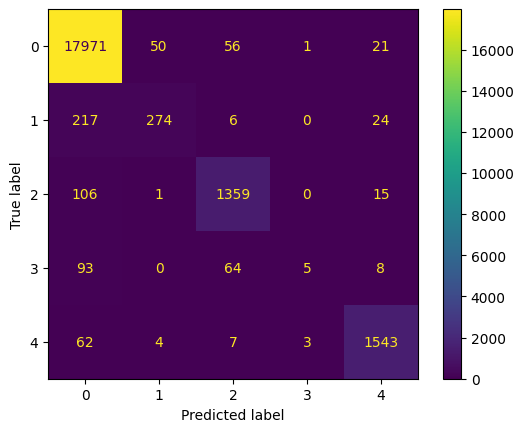

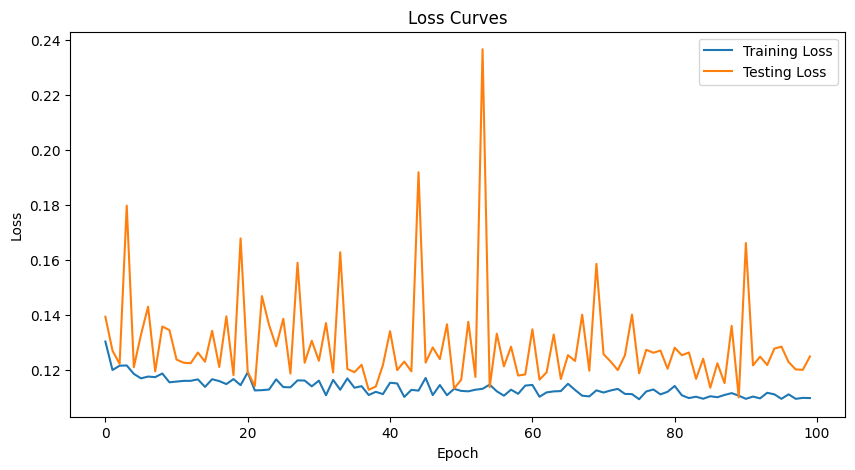

**************************************************

EPOCH : 100 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.099 | Train Acc: 97.12% | Test NLL: 0.125 | Test Acc: 96.41%
Epoch 02 | Train NLL: 0.097 | Train Acc: 97.17% | Test NLL: 0.108 | Test Acc: 97.01%
Epoch 03 | Train NLL: 0.098 | Train Acc: 97.21% | Test NLL: 0.110 | Test Acc: 97.04%
Epoch 04 | Train NLL: 0.098 | Train Acc: 97.21% | Test NLL: 0.106 | Test Acc: 96.99%
Epoch 05 | Train NLL: 0.097 | Train Acc: 97.20% | Test NLL: 0.119 | Test Acc: 96.72%
Epoch 06 | Train NLL: 0.098 | Train Acc: 97.16% | Test NLL: 0.101 | Test Acc: 97.15%
Epoch 07 | Train NLL: 0.096 | Train Acc: 97.19% | Test NLL: 0.109 | Test Acc: 96.90%
Epoch 08 | Train NLL: 0.098 | Train Acc: 97.21% | Test NLL: 0.144 | Test Acc: 96.10%
Epoch 09 | Train NLL: 0.097 | Train Acc: 97.23% | Test NLL: 0.105 | Test Acc: 97.11%
Epoch 10 | Train NLL: 0.097 | Train Acc: 97.21% | Test NLL: 0.104 | Test Acc: 96.99%
Epoch 11 | Train NLL: 0.097 | Train Acc: 97.19% | Test NLL: 0.110

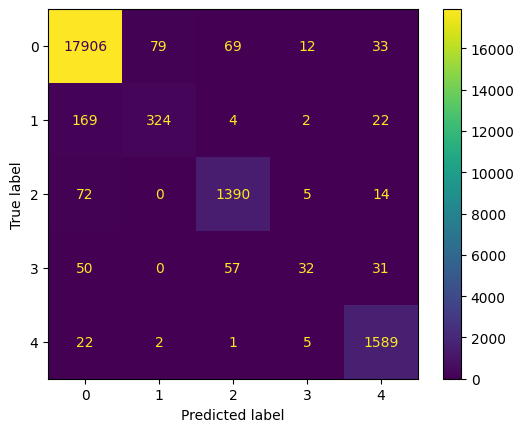

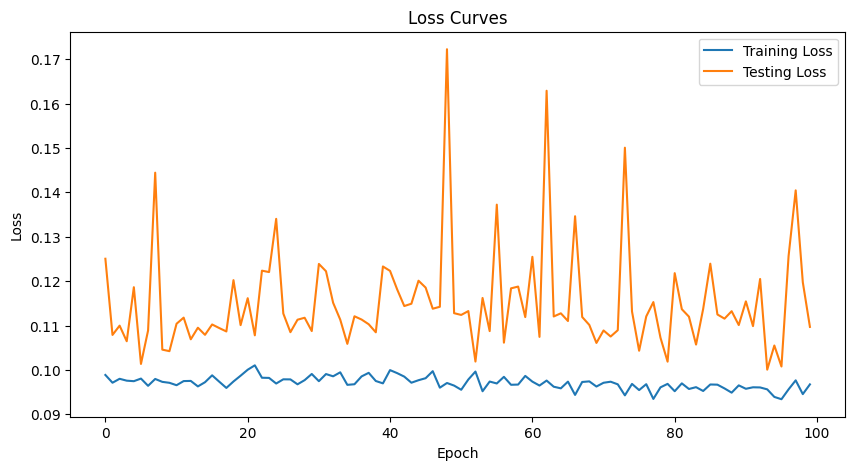

**************************************************

EPOCH : 100 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.090 | Train Acc: 97.41% | Test NLL: 0.099 | Test Acc: 97.25%
Epoch 02 | Train NLL: 0.087 | Train Acc: 97.45% | Test NLL: 0.097 | Test Acc: 97.34%
Epoch 03 | Train NLL: 0.085 | Train Acc: 97.54% | Test NLL: 0.104 | Test Acc: 97.17%
Epoch 04 | Train NLL: 0.086 | Train Acc: 97.49% | Test NLL: 0.103 | Test Acc: 97.19%
Epoch 05 | Train NLL: 0.086 | Train Acc: 97.47% | Test NLL: 0.098 | Test Acc: 97.33%
Epoch 06 | Train NLL: 0.086 | Train Acc: 97.47% | Test NLL: 0.098 | Test Acc: 97.30%
Epoch 07 | Train NLL: 0.085 | Train Acc: 97.50% | Test NLL: 0.109 | Test Acc: 97.18%
Epoch 08 | Train NLL: 0.086 | Train Acc: 97.51% | Test NLL: 0.100 | Test Acc: 97.28%
Epoch 09 | Train NLL: 0.085 | Train Acc: 97.53% | Test NLL: 0.101 | Test Acc: 97.29%
Epoch 10 | Train NLL: 0.088 | Train Acc: 97.42% | Test NLL: 0.104 | Test Acc: 97.09%
Epoch 11 | Train NLL: 0.085 | Train Acc: 97.50% | Test NLL: 0.100

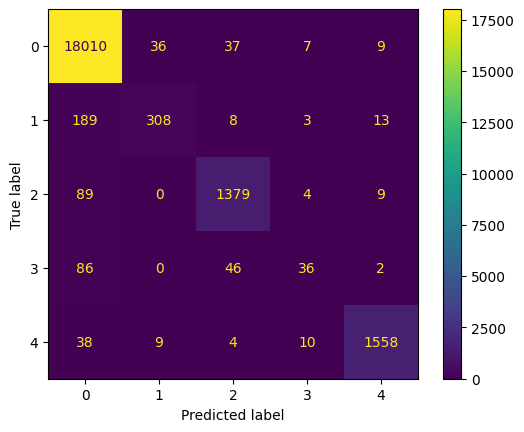

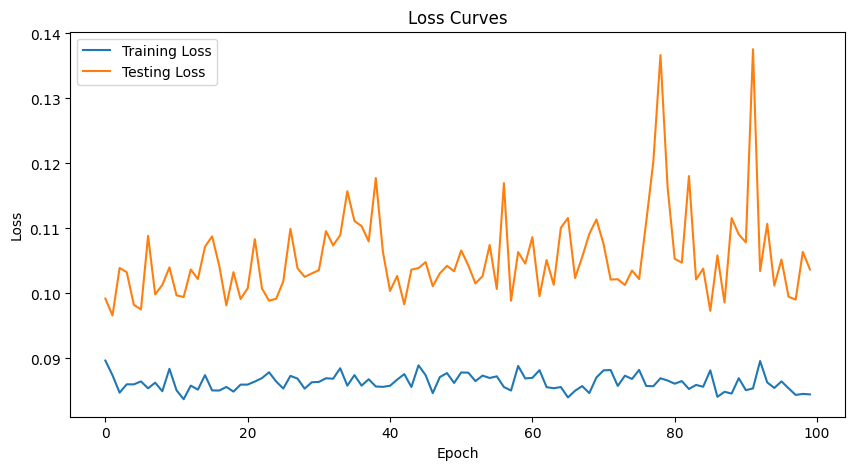

**************************************************

EPOCH : 150 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.121 | Train Acc: 96.61% | Test NLL: 0.118 | Test Acc: 96.71%
Epoch 02 | Train NLL: 0.117 | Train Acc: 96.70% | Test NLL: 0.121 | Test Acc: 96.64%
Epoch 03 | Train NLL: 0.110 | Train Acc: 96.83% | Test NLL: 0.120 | Test Acc: 96.53%
Epoch 04 | Train NLL: 0.110 | Train Acc: 96.86% | Test NLL: 0.113 | Test Acc: 97.01%
Epoch 05 | Train NLL: 0.107 | Train Acc: 96.92% | Test NLL: 0.123 | Test Acc: 96.51%
Epoch 06 | Train NLL: 0.106 | Train Acc: 96.96% | Test NLL: 0.118 | Test Acc: 96.81%
Epoch 07 | Train NLL: 0.110 | Train Acc: 96.86% | Test NLL: 0.122 | Test Acc: 96.75%
Epoch 08 | Train NLL: 0.109 | Train Acc: 96.91% | Test NLL: 0.112 | Test Acc: 96.93%
Epoch 09 | Train NLL: 0.105 | Train Acc: 97.05% | Test NLL: 0.110 | Test Acc: 97.07%
Epoch 10 | Train NLL: 0.107 | Train Acc: 96.92% | Test NLL: 0.120 | Test Acc: 96.91%
Epoch 11 | Train NLL: 0.107 | Train Acc: 96.95% | Test NLL: 0.128 

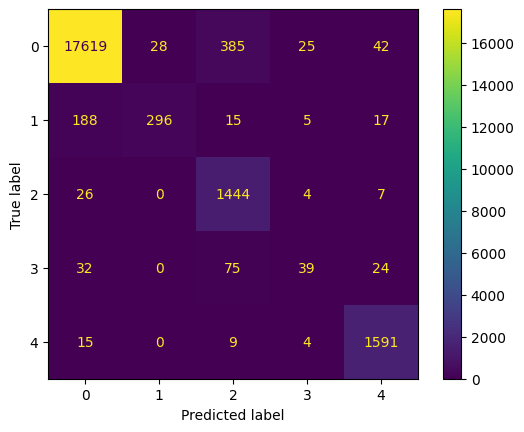

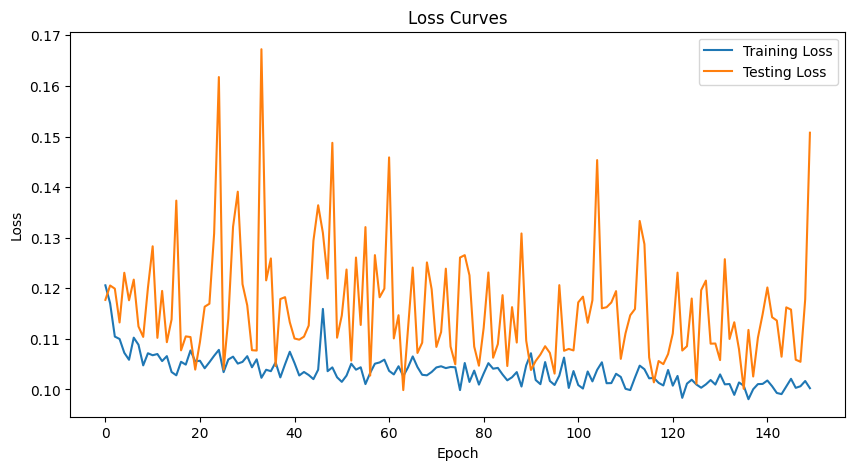

**************************************************

EPOCH : 150 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.097 | Train Acc: 97.21% | Test NLL: 0.102 | Test Acc: 97.07%
Epoch 02 | Train NLL: 0.087 | Train Acc: 97.48% | Test NLL: 0.094 | Test Acc: 97.39%
Epoch 03 | Train NLL: 0.088 | Train Acc: 97.48% | Test NLL: 0.104 | Test Acc: 97.09%
Epoch 04 | Train NLL: 0.086 | Train Acc: 97.51% | Test NLL: 0.098 | Test Acc: 97.29%
Epoch 05 | Train NLL: 0.087 | Train Acc: 97.51% | Test NLL: 0.093 | Test Acc: 97.44%
Epoch 06 | Train NLL: 0.087 | Train Acc: 97.52% | Test NLL: 0.116 | Test Acc: 96.79%
Epoch 07 | Train NLL: 0.088 | Train Acc: 97.50% | Test NLL: 0.096 | Test Acc: 97.35%
Epoch 08 | Train NLL: 0.087 | Train Acc: 97.51% | Test NLL: 0.110 | Test Acc: 97.18%
Epoch 09 | Train NLL: 0.087 | Train Acc: 97.54% | Test NLL: 0.103 | Test Acc: 97.36%
Epoch 10 | Train NLL: 0.090 | Train Acc: 97.45% | Test NLL: 0.109 | Test Acc: 96.93%
Epoch 11 | Train NLL: 0.089 | Train Acc: 97.47% | Test NLL: 0.102

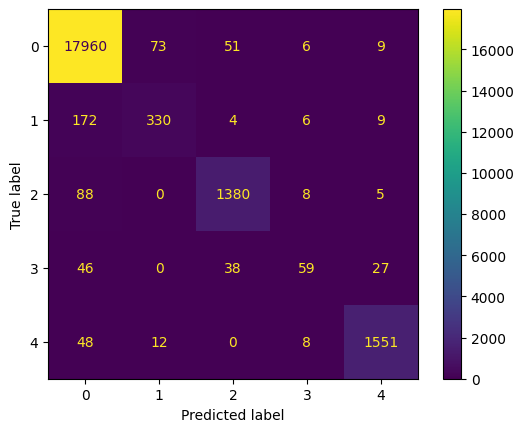

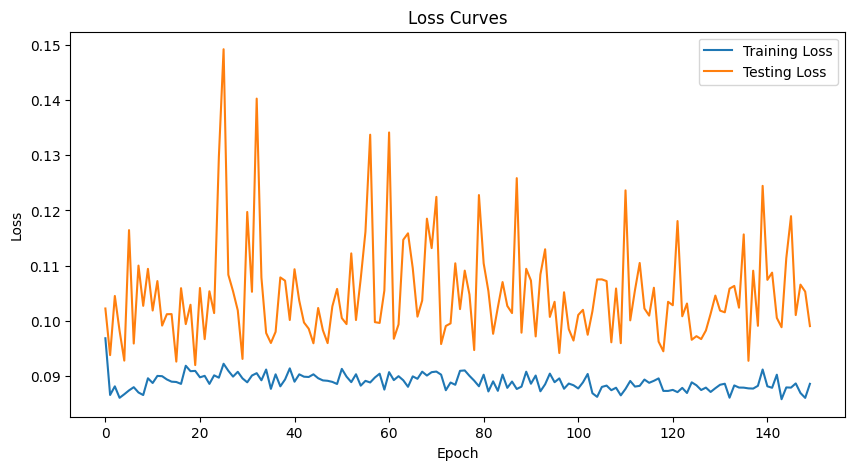

**************************************************

EPOCH : 150 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.079 | Train Acc: 97.71% | Test NLL: 0.092 | Test Acc: 97.49%
Epoch 02 | Train NLL: 0.079 | Train Acc: 97.75% | Test NLL: 0.095 | Test Acc: 97.43%
Epoch 03 | Train NLL: 0.079 | Train Acc: 97.74% | Test NLL: 0.092 | Test Acc: 97.57%
Epoch 04 | Train NLL: 0.076 | Train Acc: 97.80% | Test NLL: 0.096 | Test Acc: 97.46%
Epoch 05 | Train NLL: 0.079 | Train Acc: 97.73% | Test NLL: 0.094 | Test Acc: 97.44%
Epoch 06 | Train NLL: 0.079 | Train Acc: 97.72% | Test NLL: 0.094 | Test Acc: 97.50%
Epoch 07 | Train NLL: 0.077 | Train Acc: 97.78% | Test NLL: 0.093 | Test Acc: 97.60%
Epoch 08 | Train NLL: 0.078 | Train Acc: 97.72% | Test NLL: 0.093 | Test Acc: 97.62%
Epoch 09 | Train NLL: 0.077 | Train Acc: 97.78% | Test NLL: 0.094 | Test Acc: 97.50%
Epoch 10 | Train NLL: 0.079 | Train Acc: 97.76% | Test NLL: 0.092 | Test Acc: 97.58%
Epoch 11 | Train NLL: 0.078 | Train Acc: 97.78% | Test NLL: 0.095

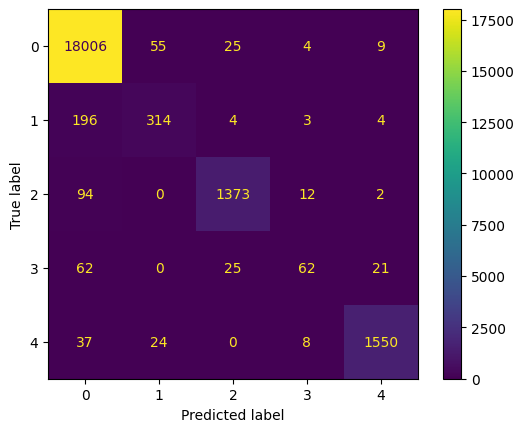

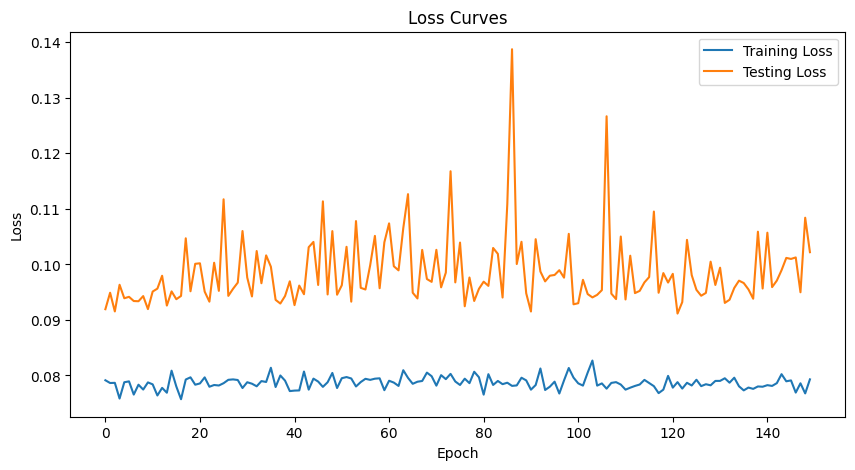

**************************************************

EPOCH : 200 & BATCH SIZE : 500

Epoch 01 | Train NLL: 0.111 | Train Acc: 96.87% | Test NLL: 0.109 | Test Acc: 96.88%
Epoch 02 | Train NLL: 0.104 | Train Acc: 97.01% | Test NLL: 0.111 | Test Acc: 96.84%
Epoch 03 | Train NLL: 0.103 | Train Acc: 97.03% | Test NLL: 0.115 | Test Acc: 96.91%
Epoch 04 | Train NLL: 0.104 | Train Acc: 97.01% | Test NLL: 0.104 | Test Acc: 97.01%
Epoch 05 | Train NLL: 0.102 | Train Acc: 97.03% | Test NLL: 0.146 | Test Acc: 96.35%
Epoch 06 | Train NLL: 0.102 | Train Acc: 97.09% | Test NLL: 0.104 | Test Acc: 97.04%
Epoch 07 | Train NLL: 0.100 | Train Acc: 97.09% | Test NLL: 0.120 | Test Acc: 96.83%
Epoch 08 | Train NLL: 0.102 | Train Acc: 97.04% | Test NLL: 0.115 | Test Acc: 96.87%
Epoch 09 | Train NLL: 0.097 | Train Acc: 97.17% | Test NLL: 0.120 | Test Acc: 96.89%
Epoch 10 | Train NLL: 0.097 | Train Acc: 97.15% | Test NLL: 0.115 | Test Acc: 96.78%
Epoch 11 | Train NLL: 0.099 | Train Acc: 97.08% | Test NLL: 0.111 

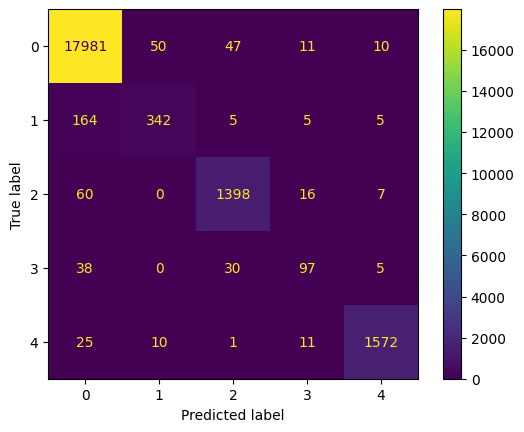

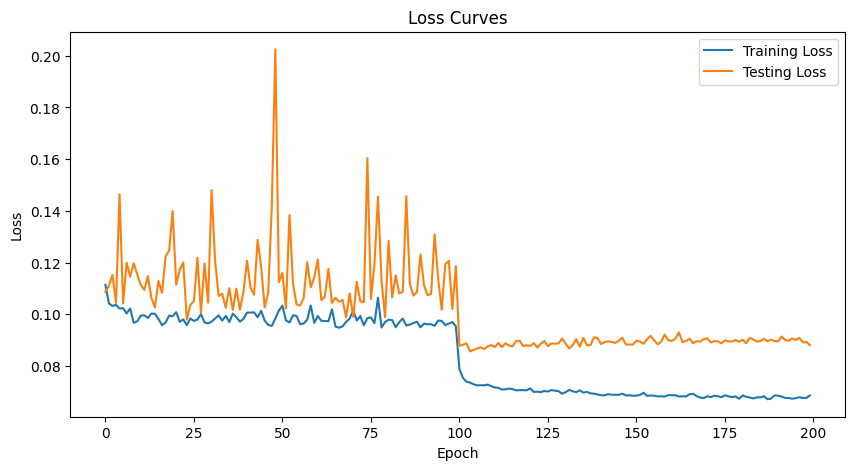

**************************************************

EPOCH : 200 & BATCH SIZE : 1000

Epoch 01 | Train NLL: 0.066 | Train Acc: 98.11% | Test NLL: 0.089 | Test Acc: 97.67%
Epoch 02 | Train NLL: 0.065 | Train Acc: 98.17% | Test NLL: 0.089 | Test Acc: 97.62%
Epoch 03 | Train NLL: 0.065 | Train Acc: 98.11% | Test NLL: 0.090 | Test Acc: 97.71%
Epoch 04 | Train NLL: 0.065 | Train Acc: 98.15% | Test NLL: 0.089 | Test Acc: 97.70%
Epoch 05 | Train NLL: 0.065 | Train Acc: 98.15% | Test NLL: 0.089 | Test Acc: 97.69%
Epoch 06 | Train NLL: 0.065 | Train Acc: 98.16% | Test NLL: 0.090 | Test Acc: 97.64%
Epoch 07 | Train NLL: 0.065 | Train Acc: 98.15% | Test NLL: 0.090 | Test Acc: 97.70%
Epoch 08 | Train NLL: 0.065 | Train Acc: 98.12% | Test NLL: 0.090 | Test Acc: 97.65%
Epoch 09 | Train NLL: 0.066 | Train Acc: 98.15% | Test NLL: 0.090 | Test Acc: 97.66%
Epoch 10 | Train NLL: 0.065 | Train Acc: 98.16% | Test NLL: 0.090 | Test Acc: 97.66%
Epoch 11 | Train NLL: 0.065 | Train Acc: 98.14% | Test NLL: 0.089

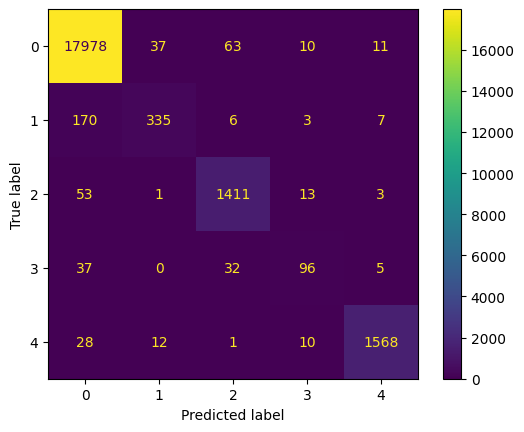

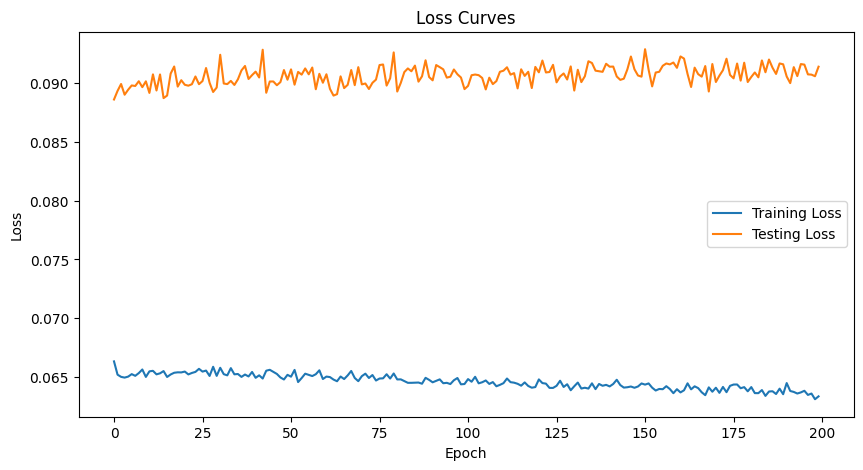

**************************************************

EPOCH : 200 & BATCH SIZE : 2000

Epoch 01 | Train NLL: 0.062 | Train Acc: 98.22% | Test NLL: 0.091 | Test Acc: 97.67%
Epoch 02 | Train NLL: 0.062 | Train Acc: 98.22% | Test NLL: 0.091 | Test Acc: 97.67%
Epoch 03 | Train NLL: 0.062 | Train Acc: 98.24% | Test NLL: 0.091 | Test Acc: 97.60%
Epoch 04 | Train NLL: 0.062 | Train Acc: 98.21% | Test NLL: 0.091 | Test Acc: 97.61%
Epoch 05 | Train NLL: 0.062 | Train Acc: 98.24% | Test NLL: 0.091 | Test Acc: 97.72%
Epoch 06 | Train NLL: 0.062 | Train Acc: 98.24% | Test NLL: 0.091 | Test Acc: 97.66%
Epoch 07 | Train NLL: 0.062 | Train Acc: 98.23% | Test NLL: 0.092 | Test Acc: 97.66%
Epoch 08 | Train NLL: 0.062 | Train Acc: 98.23% | Test NLL: 0.091 | Test Acc: 97.66%
Epoch 09 | Train NLL: 0.062 | Train Acc: 98.22% | Test NLL: 0.093 | Test Acc: 97.53%
Epoch 10 | Train NLL: 0.062 | Train Acc: 98.22% | Test NLL: 0.091 | Test Acc: 97.76%
Epoch 11 | Train NLL: 0.062 | Train Acc: 98.21% | Test NLL: 0.091

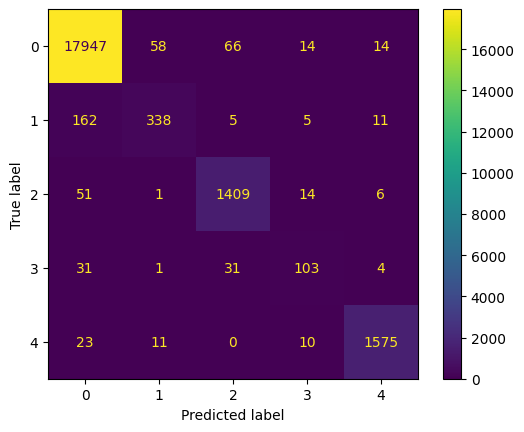

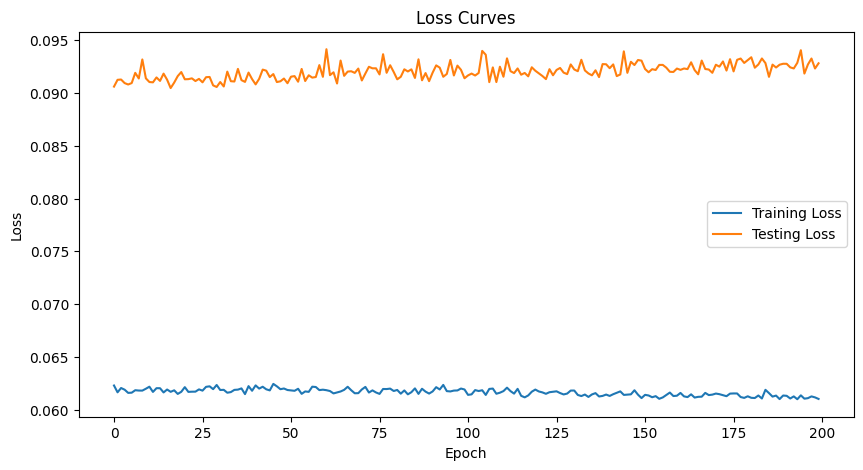

**************************************************



In [16]:
X_train = csr_matrix(X_mitbih_train.values)
T_train = y_mitbih_train.to_frame()
X_test = csr_matrix(X_mitbih_test.values)
T_test = y_mitbih_test.to_frame()

num_classes = 5

pytorchNet = InceptionModel(
    num_blocks=10,
    in_channels=1,
    out_channels=2,
    bottleneck_channels=2,
    kernel_sizes=20,
    use_residuals=True,
    num_pred_classes=num_classes,
)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=EPOCHS_NO, BATCH_SIZE=BATCH_SIZE)

ResNetBaseline(
  (layers): Sequential(
    (0): ResNetBlock(
      (layers): Sequential(
        (0): ConvBlock(
          (layers): Sequential(
            (0): Conv1dSamePadding(1, 64, kernel_size=(8,), stride=(1,))
            (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU()
          )
        )
        (1): ConvBlock(
          (layers): Sequential(
            (0): Conv1dSamePadding(64, 64, kernel_size=(5,), stride=(1,))
            (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU()
          )
        )
        (2): ConvBlock(
          (layers): Sequential(
            (0): Conv1dSamePadding(64, 64, kernel_size=(3,), stride=(1,))
            (1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): ReLU()
          )
        )
      )
      (residual): Sequential(
        (0): Conv1dSamePadding(1, 64, kernel_size=(1,)

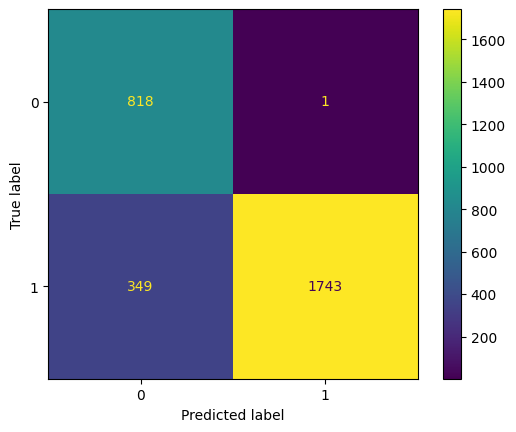

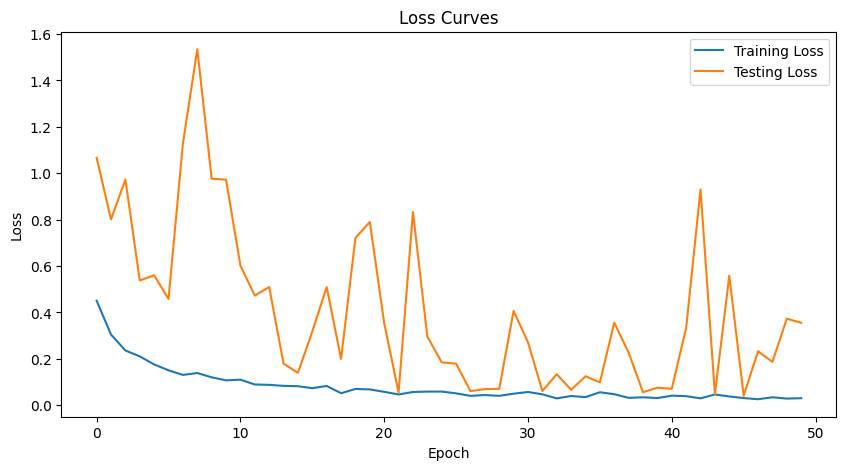

**************************************************



In [21]:
X_train = csr_matrix(X_ptbdb_train.values)
T_train = y_ptbdb_train.to_frame()
X_test = csr_matrix(X_ptbdb_test.values)
T_test = y_ptbdb_test.to_frame()

num_classes = 2

pytorchNet = ResNetBaseline(in_channels=1, num_pred_classes=num_classes)
pytorchNet = pytorchNet.to(device)

print(list(pytorchNet.modules())[0])

train_losses = []
test_losses = []

train_test_PyTorch_CNN(pytorchNet, nn.CrossEntropyLoss(), torch.optim.Adam(pytorchNet.parameters(), lr=0.005, weight_decay=1e-4),
    X_train, T_train, X_test, T_test, train_losses, test_losses, num_classes, EPOCHS_NO=[50], BATCH_SIZE=[100])